In [1]:
import numpy as np 
import pandas as pd
import os
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from sklearn.metrics import accuracy_score
from skimage import exposure

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Model
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Input
from tensorflow.keras.layers import Input, Dropout, Flatten, MaxPooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras.callbacks import ModelCheckpoint
import argparse
print(tf.config.list_physical_devices('GPU'))

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## Name of all traffic sign classes

In [2]:
#dictionary to label all traffic signs class.
classes = { 0:'Speed limit (20km/h)',
            1:'Speed limit (30km/h)', 
            2:'Speed limit (50km/h)', 
            3:'Speed limit (60km/h)', 
            4:'Speed limit (70km/h)', 
            5:'Speed limit (80km/h)', 
            6:'End of speed limit (80km/h)', 
            7:'Speed limit (100km/h)', 
            8:'Speed limit (120km/h)', 
            9:'No passing', 
            10:'No passing veh over 3.5 tons', 
            11:'Right-of-way at intersection', 
            12:'Priority road', 
            13:'Yield', 
            14:'Stop', 
            15:'No vehicles', 
            16:'Veh > 3.5 tons prohibited', 
            17:'No entry', 
            18:'General caution', 
            19:'Dangerous curve left', 
            20:'Dangerous curve right', 
            21:'Double curve', 
            22:'Bumpy road', 
            23:'Slippery road', 
            24:'Road narrows on the right', 
            25:'Road work', 
            26:'Traffic signals', 
            27:'Pedestrians', 
            28:'Children crossing', 
            29:'Bicycles crossing', 
            30:'Beware of ice/snow',
            31:'Wild animals crossing', 
            32:'End speed + passing limits', 
            33:'Turn right ahead', 
            34:'Turn left ahead', 
            35:'Ahead only', 
            36:'Go straight or right', 
            37:'Go straight or left', 
            38:'Keep right', 
            39:'Keep left', 
            40:'Roundabout mandatory', 
            41:'End of no passing', 
            42:'End no passing veh > 3.5 tons' }

## Read train images

In [3]:
train_imgs = []
train_labels = []
total_classes = 43
height = 64
width = 64
train_path = 'C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/' #directory from my laptop

for i in range(total_classes):
    path = train_path + str(i)
    print(path)
    images = os.listdir(path)  #get the list of all files in path
    for img in images:
        try:
            image = cv2.imread(path + '/' + img,)
            RGBimage = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image_fromarray = Image.fromarray(RGBimage, 'RGB') #numpy array to image object
            resize_image = image_fromarray.resize((height, width))
            train_imgs.append(np.array(resize_image))
            train_labels.append(i)
        except:
            print("Error - Image loading")

#Converting lists into numpy arrays
train_imgs = np.array(train_imgs)
train_labels = np.array(train_labels)

print(train_imgs.shape, train_labels.shape)

C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/0
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/1
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/2
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/3
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/4
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/5
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/6
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/7
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/8
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/9
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/10
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/11
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/12
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/13
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB/Train/14
C:/Users/Acer/Documents/FYP/1181100812_2021_Code/G

In [4]:
#shuffle train set
np.random.seed(42)
shuffle_indexes = np.arange(train_imgs.shape[0])
np.random.shuffle(shuffle_indexes)
train_imgs = train_imgs[shuffle_indexes]
train_labels = train_labels[shuffle_indexes]

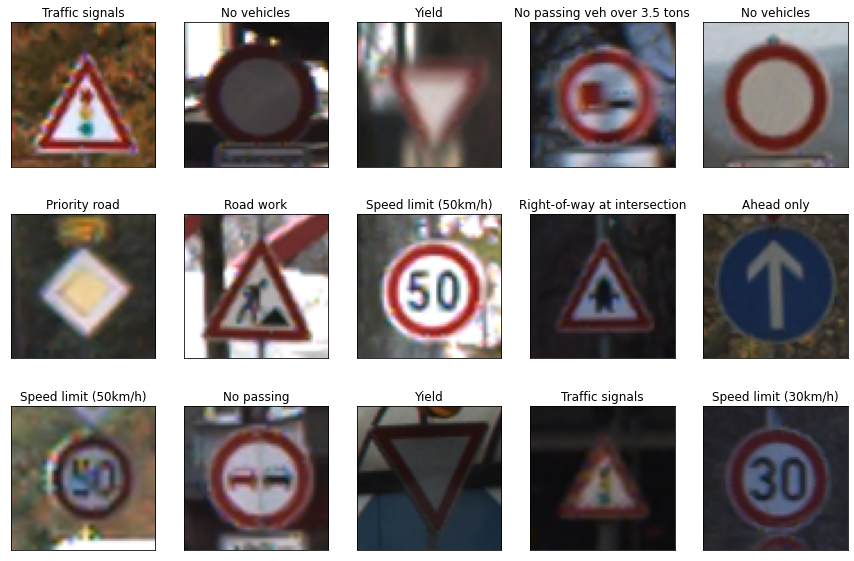

In [5]:
# lets look at some random images from train set
sample = plt.subplots(3,5, figsize=(15,10))
for i in range(15):
    plt.subplot(3,5,i+1) # Plot A Random Image
    plt.imshow(train_imgs[i])
    trainLabel = [*map(classes.get, train_labels)]
    plt.title(trainLabel[i])
    plt.xticks([]), plt.yticks([])
    
plt.show()

In [6]:
#enhance train set
train_img = []  #enhanced 
for i in range(train_imgs.shape[0]):
    enhance_image = exposure.equalize_adapthist(train_imgs[i], clip_limit=0.1)
    train_img.append(np.array(enhance_image))

train_img = np.array(train_img)

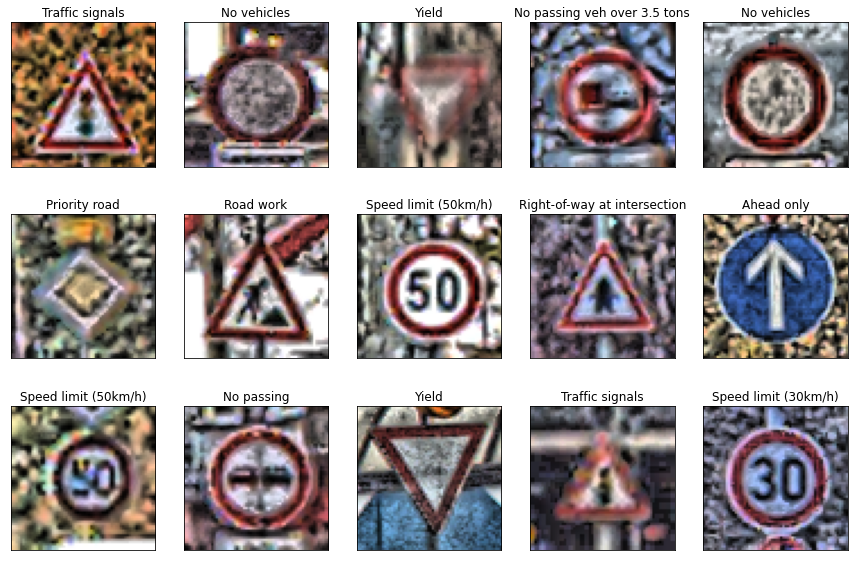

In [7]:
#After enhance (train set)
sample = plt.subplots(3,5, figsize=(15,10))
for i in range(15):
    plt.subplot(3,5,i+1) # Plot A Random Image
    plt.imshow(train_img[i])
    plt.title(trainLabel[i])
    plt.xticks([]), plt.yticks([])
    
plt.show()

## Read test images

In [8]:
base_path = "C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB"
test_csv = pd.read_csv(base_path + '/Test.csv')

test_id = test_csv["ClassId"].values
test_path = test_csv["Path"].values

test_labels = []
test_imgs = []

for i,j in enumerate(test_path):
    test_image = os.path.join("C:/Users/Acer/Documents/FYP/1181100812_2021_Code/GTSRB", j)
    try:
            image = cv2.imread(test_image)
            RGBimage = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            image_fromarray = Image.fromarray(RGBimage, 'RGB') #numpy array to image object
            resize_image = image_fromarray.resize((height, width))
            test_imgs.append(np.array(resize_image))
    except:
            print("Error - Image loading")

#Converting lists into numpy arrays    
test_imgs = np.array(test_imgs)
test_labels = np.array(test_id)

print(test_imgs.shape, test_labels.shape)

(12630, 64, 64, 3) (12630,)


In [9]:
#shuffle test set
np.random.seed(41)
shuffle_indexes = np.arange(test_imgs.shape[0])
np.random.shuffle(shuffle_indexes)
test_imgs = test_imgs[shuffle_indexes]
test_labels = test_labels[shuffle_indexes]

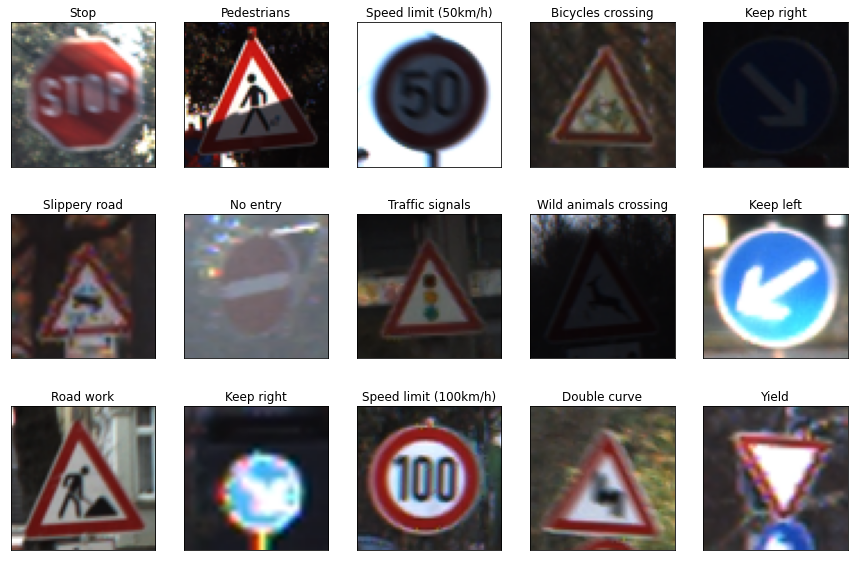

In [10]:
# lets look at some random images from test set
sample = plt.subplots(3,5, figsize=(15,10))
for i in range(15):
    plt.subplot(3,5,i+1) # Plot A Random Image
    plt.imshow(test_imgs[i])
    testLabel = [*map(classes.get, test_labels)]
    plt.title(testLabel[i])
    plt.xticks([]), plt.yticks([])
    
plt.show()

In [11]:
#enhance test set
test_img = []
for i in range(test_imgs.shape[0]):
    enhance_image1 = exposure.equalize_adapthist(test_imgs[i], clip_limit=0.1)
    test_img.append(np.array(enhance_image1))

test_img = np.array(test_img)

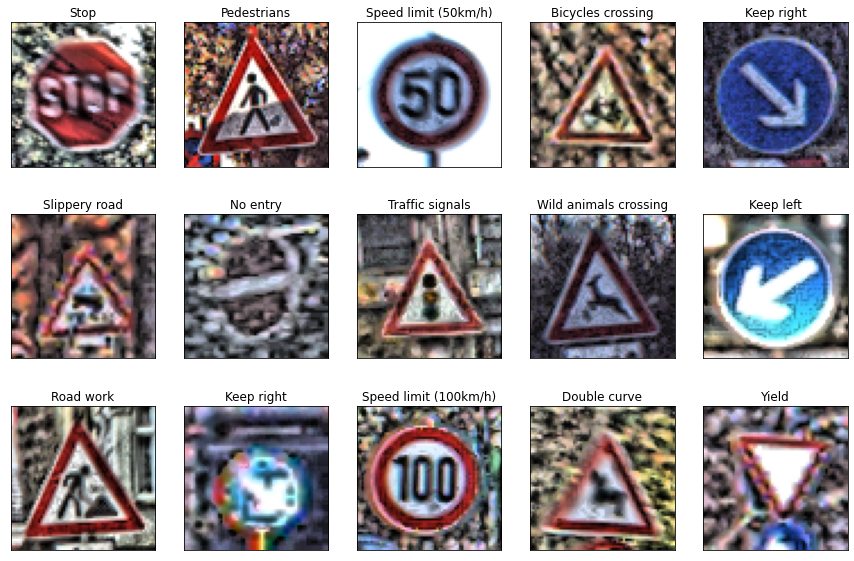

In [12]:
#After enhance (test set)
sample = plt.subplots(3,5, figsize=(15,10))
for i in range(15):
    plt.subplot(3,5,i+1) # Plot A Random Image
    plt.imshow(test_img[i])
    testLabel = [*map(classes.get, test_labels)]
    plt.title(testLabel[i])
    plt.xticks([]), plt.yticks([])
    
plt.show()

In [13]:
#split the no enhanced images
X_train, X_valid, y_train, y_valid = train_test_split(train_imgs, train_labels, test_size=0.15, random_state=1, shuffle=True)

#Converting the labels into one hot encoding
y_train = to_categorical(y_train, total_classes)
y_valid = to_categorical(y_valid, total_classes)
test_labels = to_categorical(test_labels, total_classes)
print(y_train.shape)
print(y_valid.shape)
print(test_labels.shape)

(33327, 43)
(5882, 43)
(12630, 43)


In [14]:
#split enhanced images
train_img = train_img.astype("float32")
test_img = test_img.astype("float32")
X_train1, X_valid1, y_train1, y_valid1 = train_test_split(train_img, train_labels, test_size=0.15, random_state=1, shuffle=True)

#Converting the labels into one hot encoding
y_train1 = to_categorical(y_train1, total_classes)
y_valid1 = to_categorical(y_valid1, total_classes)
print(y_train1.shape)
print(y_valid1.shape)
print(test_labels.shape)

(33327, 43)
(5882, 43)
(12630, 43)


In [15]:
aug = ImageDataGenerator(  #not applying horizontal or vertical flips here as traffic signs in the wild will not be flipped
rotation_range=25,
zoom_range=0.15,
width_shift_range=0.2,
height_shift_range=0.2,
shear_range=0.15,
horizontal_flip=False,
vertical_flip=False,
fill_mode="nearest")


## Build and train model with images that haven't been enhanced

In [16]:
epoch = 40
bs = 48

tf.random.set_seed(40) # set.seed function helps reuse same set of random variables

# create the base pre-trained model
base_model = VGG19(weights="imagenet", include_top=False,input_tensor=Input(shape=(64, 64, 3)))

x = base_model.output
x = Flatten(name="flatten")(x)
x = Dense(4096, activation="relu")(x)
x = Dense(43, activation="softmax")(x)

model = Model(inputs=base_model.input, outputs=x)

for layer in model.layers[:12]:
   layer.trainable = False
for layer in model.layers[12:]:
   layer.trainable = True
    
for layer in model.layers:
    print(layer, layer.trainable)

<keras.engine.input_layer.InputLayer object at 0x000001E73530D160> False
<keras.layers.convolutional.Conv2D object at 0x000001E777F2EBB0> False
<keras.layers.convolutional.Conv2D object at 0x000001E777F9D1F0> False
<keras.layers.pooling.MaxPooling2D object at 0x000001E778406A00> False
<keras.layers.convolutional.Conv2D object at 0x000001E7784359A0> False
<keras.layers.convolutional.Conv2D object at 0x000001E7784354C0> False
<keras.layers.pooling.MaxPooling2D object at 0x000001E77843CA30> False
<keras.layers.convolutional.Conv2D object at 0x000001E77843C1F0> False
<keras.layers.convolutional.Conv2D object at 0x000001E778441550> False
<keras.layers.convolutional.Conv2D object at 0x000001E77843CEE0> False
<keras.layers.convolutional.Conv2D object at 0x000001E77844B070> False
<keras.layers.pooling.MaxPooling2D object at 0x000001E77844B790> False
<keras.layers.convolutional.Conv2D object at 0x000001E77844BD60> True
<keras.layers.convolutional.Conv2D object at 0x000001E778456310> True
<keras

In [17]:
opt = Adam(lr=1e-4)

model.compile(optimizer=opt, loss='categorical_crossentropy',metrics=["accuracy"])
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0     

C:\Users\Acer\anaconda3\envs\vip\lib\site-packages\keras\optimizer_v2\optimizer_v2.py:355: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(


In [18]:
# calculate the total number of images in each class and initialize a dictionary to store the class weights
classTotals = y_train.sum(axis=0)
classWeight = dict()

# loop over all classes and calculate the class weight
for i in range(0, len(classTotals)):
    classWeight[i] = classTotals.max() / classTotals[i]

filepath = "modelBefore/saved-model-{epoch:02d}-{val_loss:.4f}.hdf5"
keras_callbacks   = [
    ModelCheckpoint(filepath, monitor='val_loss', save_best_only=True)]
history = model.fit(aug.flow(X_train, y_train, batch_size=bs), steps_per_epoch=X_train.shape[0] // bs, epochs=epoch, 
                    validation_data=(X_valid, y_valid), verbose = 1, callbacks=[keras_callbacks],class_weight=classWeight)
model.save("modelBefore/saved-model.hdf5")

Epoch 1/40
694/694 [==============================] - 77s 99ms/step - loss: 3.6542 - accuracy: 0.5377 - val_loss: 0.5058 - val_accuracy: 0.8429
Epoch 2/40
694/694 [==============================] - 64s 93ms/step - loss: 0.9070 - accuracy: 0.8736 - val_loss: 0.1270 - val_accuracy: 0.9604
Epoch 3/40
694/694 [==============================] - 64s 93ms/step - loss: 0.4327 - accuracy: 0.9364 - val_loss: 0.3765 - val_accuracy: 0.9099
Epoch 4/40
694/694 [==============================] - 64s 93ms/step - loss: 0.4756 - accuracy: 0.9430 - val_loss: 0.1942 - val_accuracy: 0.9577
Epoch 5/40
694/694 [==============================] - 64s 93ms/step - loss: 0.3545 - accuracy: 0.9578 - val_loss: 0.0464 - val_accuracy: 0.9859
Epoch 6/40
694/694 [==============================] - 64s 93ms/step - loss: 0.2982 - accuracy: 0.9597 - val_loss: 0.0736 - val_accuracy: 0.9847
Epoch 7/40
694/694 [==============================] - 65s 93ms/step - loss: 0.3657 - accuracy: 0.9614 - val_loss: 0.0379 - val_accuracy:

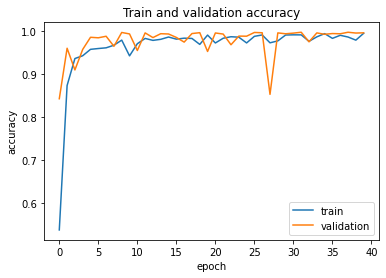

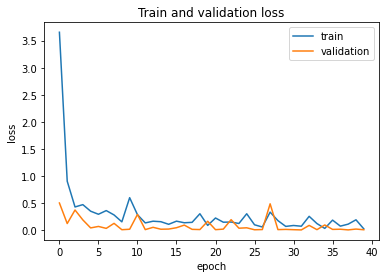

In [19]:
# accuracy plot 
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Train and validation accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='lower right')
plt.show()

# loss plot
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Train and validation loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper right')
plt.show()

In [20]:
model = tf.keras.models.load_model('modelBefore/saved-model-32-0.0094.hdf5')

In [21]:
loss, accuracy = model.evaluate(test_imgs,test_labels)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

395/395 [==============================] - 13s 34ms/step - loss: 0.2525 - accuracy: 0.9727
Test accuracy : 0.9726840853691101
Test loss : 0.252521276473999


In [22]:
prob = model.predict(test_imgs)
predictions = np.argmax(prob, axis=-1)
predictions

array([14, 26,  2, ..., 25,  5, 10], dtype=int64)

In [23]:
test_labels.argmax(axis=1)

array([14, 27,  2, ..., 25,  5, 10], dtype=int64)

In [24]:
correct = np.where(predictions == test_labels.argmax(axis=1))[0]
print("No of correct prediction = {}/{}".format(len(correct),12630))

No of correct prediction = 12285/12630


Original label:Stop, Prediction :Stop, confidence : 1.000


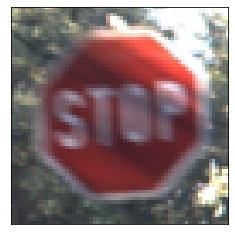

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


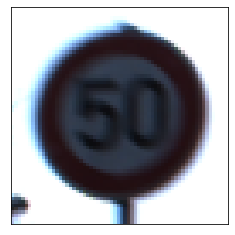

Original label:Bicycles crossing, Prediction :Bicycles crossing, confidence : 1.000


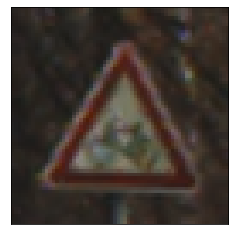

Original label:Keep right, Prediction :Keep right, confidence : 1.000


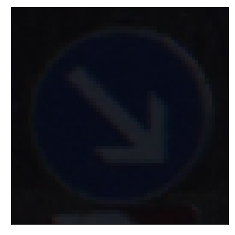

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


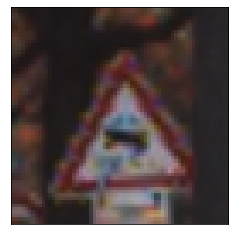

Original label:No entry, Prediction :No entry, confidence : 1.000


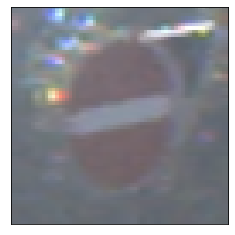

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


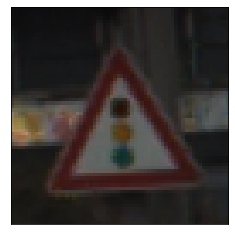

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


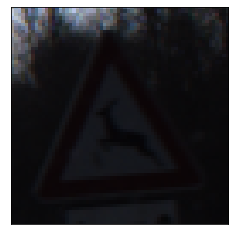

Original label:Keep left, Prediction :Keep left, confidence : 1.000


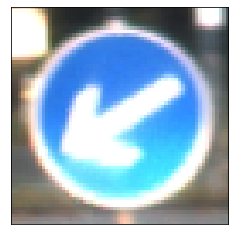

Original label:Road work, Prediction :Road work, confidence : 1.000


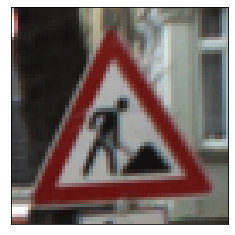

Original label:Keep right, Prediction :Keep right, confidence : 0.361


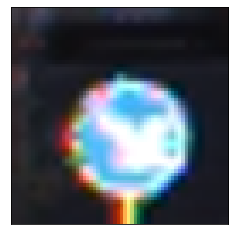

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


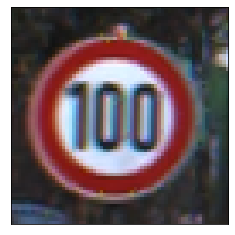

Original label:Double curve, Prediction :Double curve, confidence : 1.000


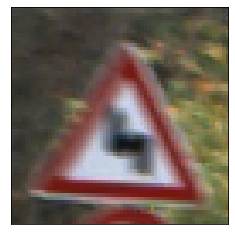

Original label:Yield, Prediction :Yield, confidence : 1.000


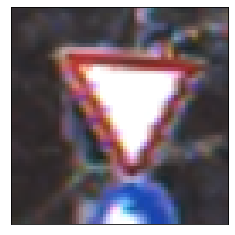

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


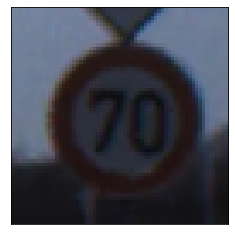

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


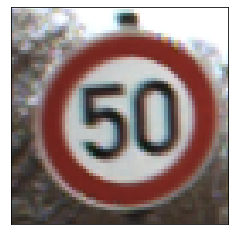

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 1.000


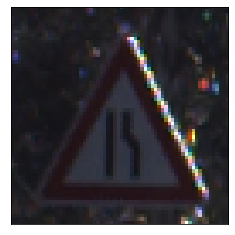

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


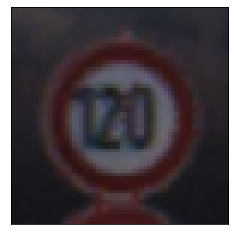

Original label:General caution, Prediction :General caution, confidence : 1.000


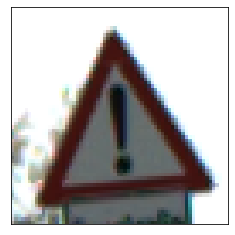

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


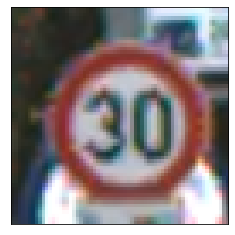

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


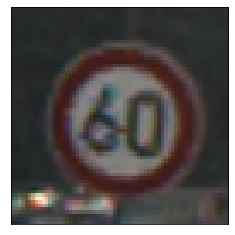

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


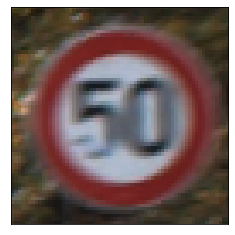

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


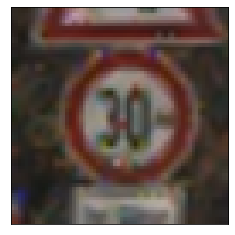

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


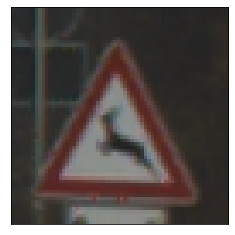

Original label:General caution, Prediction :General caution, confidence : 1.000


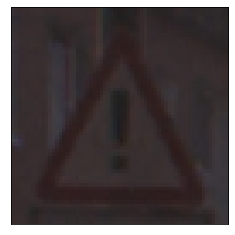

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


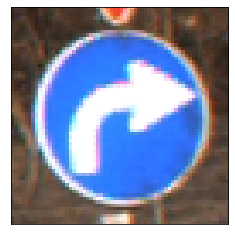

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


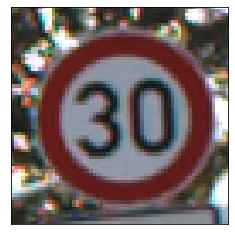

Original label:Keep right, Prediction :Keep right, confidence : 1.000


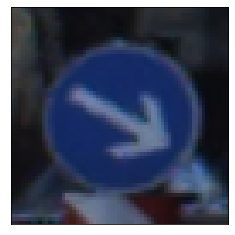

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


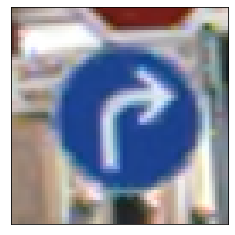

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


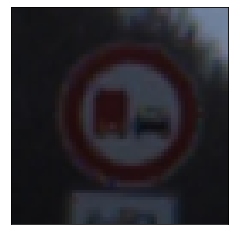

Original label:Priority road, Prediction :Priority road, confidence : 1.000


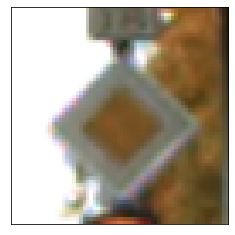

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


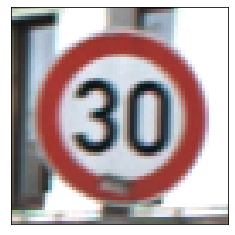

Original label:Bumpy road, Prediction :Bumpy road, confidence : 1.000


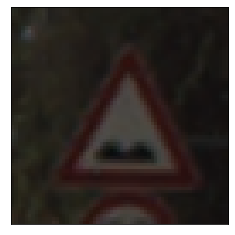

Original label:Road work, Prediction :Road work, confidence : 1.000


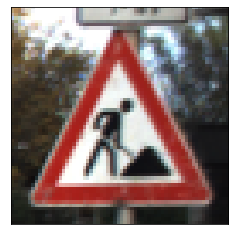

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


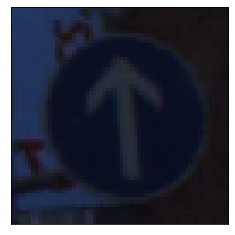

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


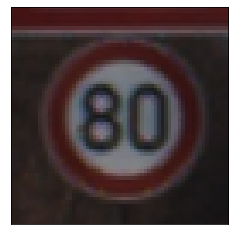

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


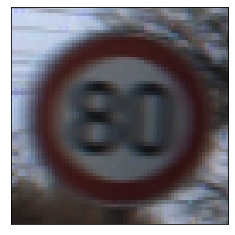

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


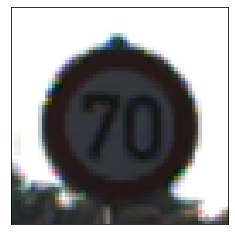

Original label:No passing, Prediction :No passing, confidence : 1.000


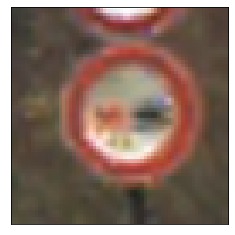

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


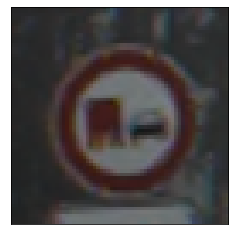

Original label:Roundabout mandatory, Prediction :Roundabout mandatory, confidence : 1.000


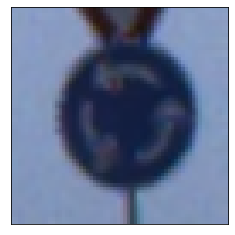

Original label:End of speed limit (80km/h), Prediction :End of speed limit (80km/h), confidence : 1.000


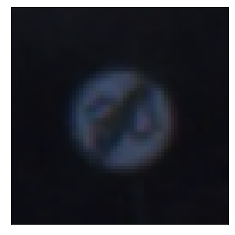

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


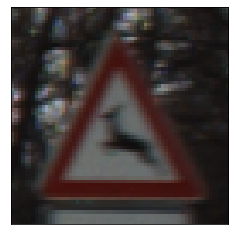

Original label:Veh > 3.5 tons prohibited, Prediction :Veh > 3.5 tons prohibited, confidence : 1.000


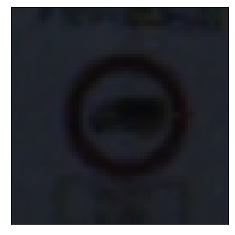

Original label:Double curve, Prediction :Double curve, confidence : 1.000


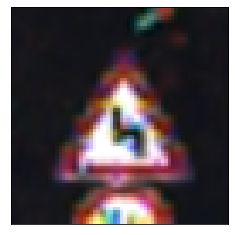

Original label:Priority road, Prediction :Priority road, confidence : 1.000


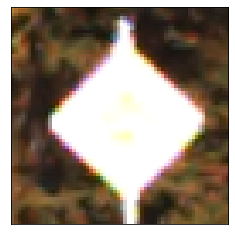

Original label:No passing, Prediction :No passing, confidence : 1.000


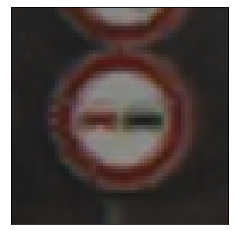

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


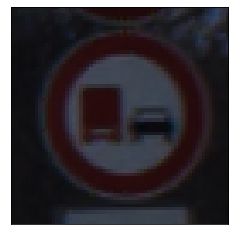

Original label:Yield, Prediction :Yield, confidence : 1.000


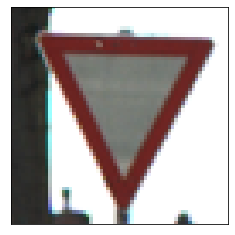

Original label:Road work, Prediction :Road work, confidence : 1.000


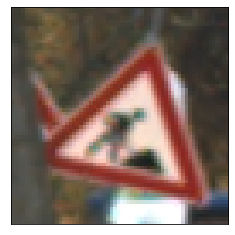

Original label:Stop, Prediction :Stop, confidence : 1.000


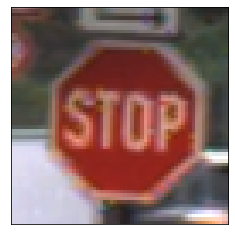

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


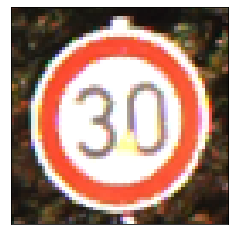

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


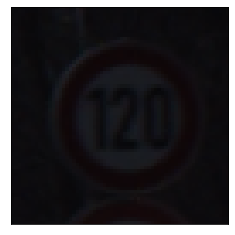

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


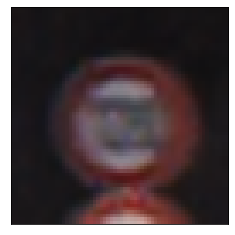

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 1.000


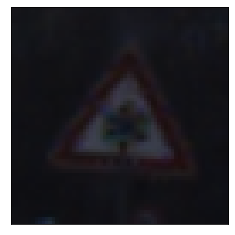

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 1.000


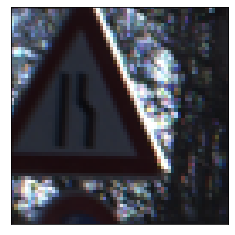

Original label:General caution, Prediction :General caution, confidence : 1.000


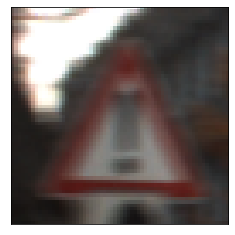

Original label:Yield, Prediction :Yield, confidence : 1.000


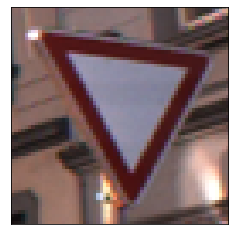

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


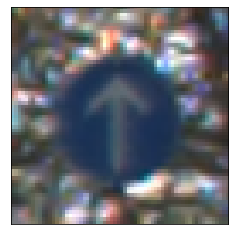

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


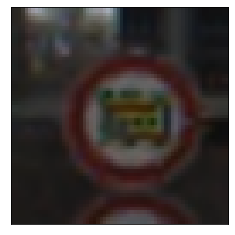

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


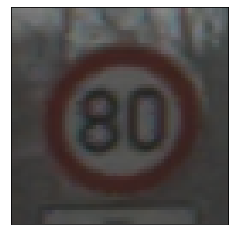

Original label:Road work, Prediction :Road work, confidence : 1.000


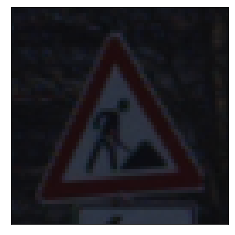

Original label:Priority road, Prediction :Priority road, confidence : 1.000


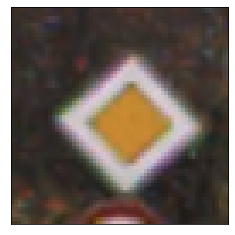

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 0.998


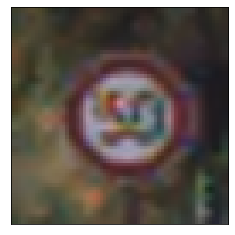

Original label:Turn left ahead, Prediction :Turn left ahead, confidence : 1.000


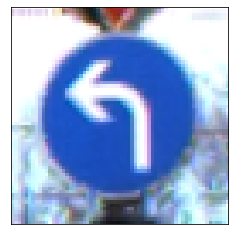

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


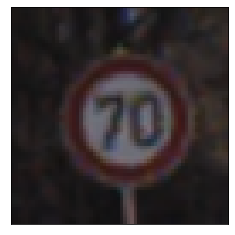

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


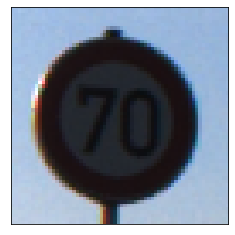

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


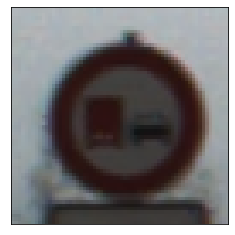

Original label:Keep left, Prediction :Keep left, confidence : 1.000


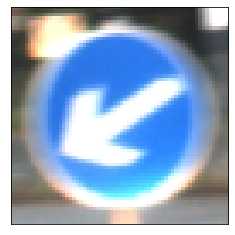

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 0.995


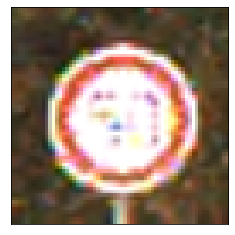

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


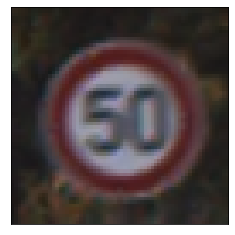

Original label:Yield, Prediction :Yield, confidence : 1.000


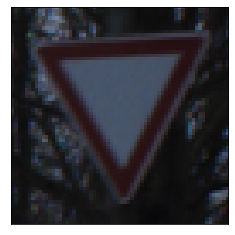

Original label:Priority road, Prediction :Priority road, confidence : 1.000


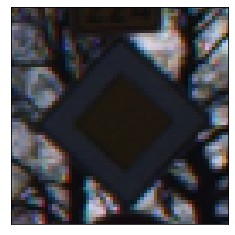

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


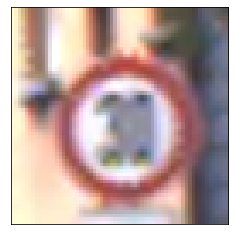

Original label:Road work, Prediction :Road work, confidence : 0.722


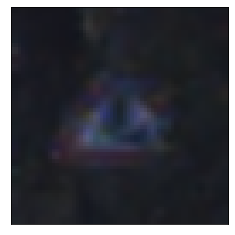

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


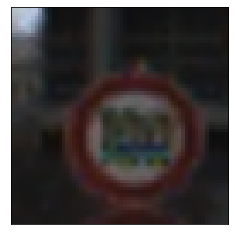

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


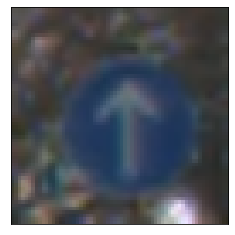

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


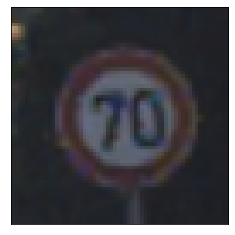

Original label:No passing, Prediction :No passing, confidence : 1.000


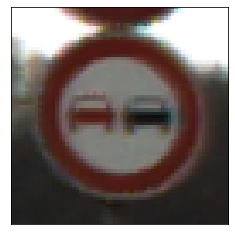

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


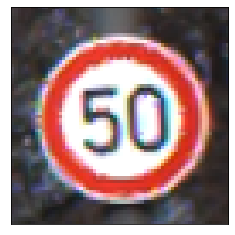

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


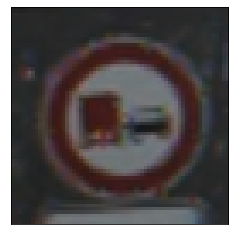

Original label:Keep right, Prediction :Keep right, confidence : 1.000


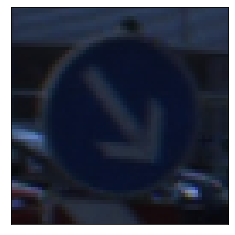

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


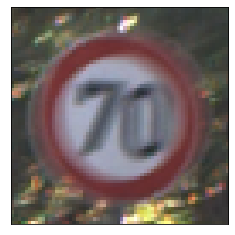

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


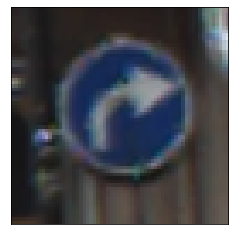

Original label:No entry, Prediction :No entry, confidence : 1.000


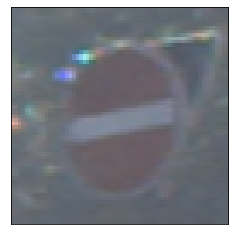

Original label:Veh > 3.5 tons prohibited, Prediction :Veh > 3.5 tons prohibited, confidence : 1.000


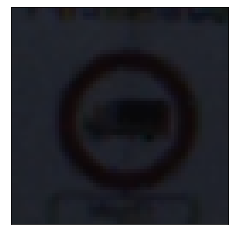

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


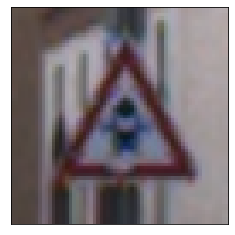

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


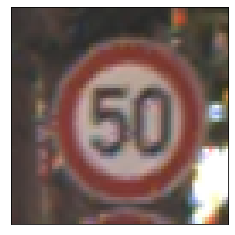

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


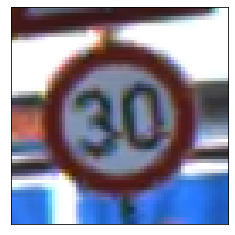

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


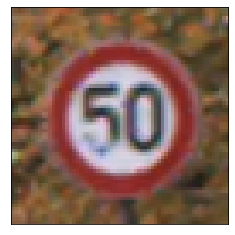

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 0.902


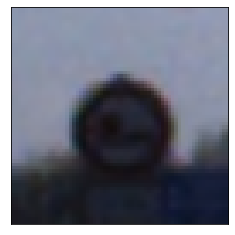

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


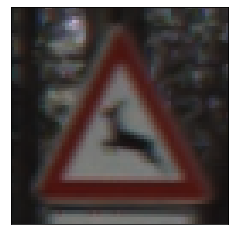

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


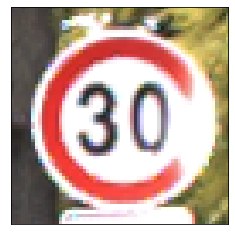

Original label:General caution, Prediction :General caution, confidence : 1.000


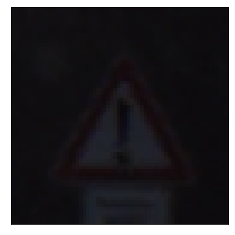

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


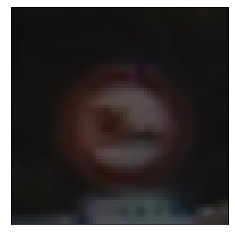

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


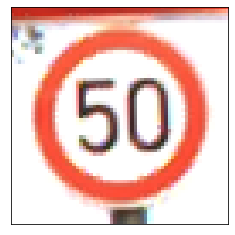

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


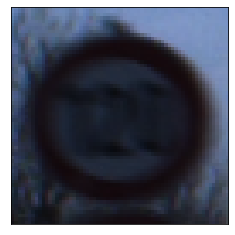

Original label:Bicycles crossing, Prediction :Bicycles crossing, confidence : 1.000


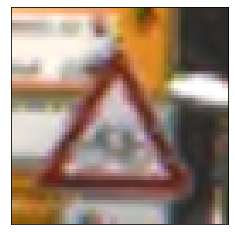

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


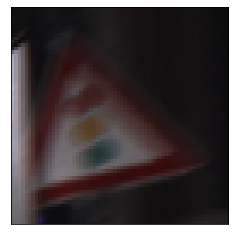

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


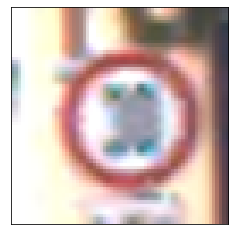

Original label:Stop, Prediction :Stop, confidence : 1.000


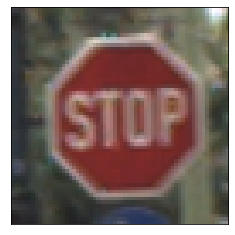

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


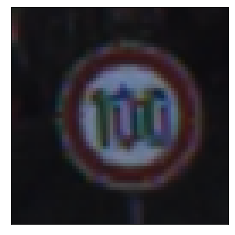

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


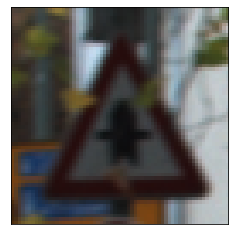

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


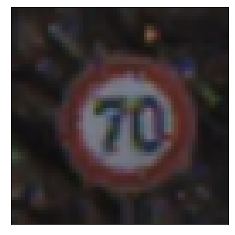

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


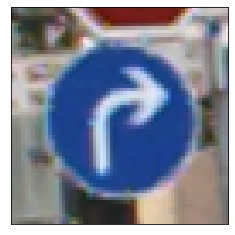

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


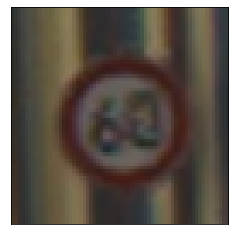

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


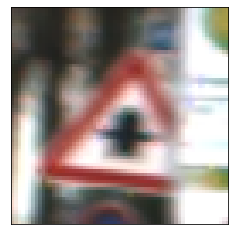

Original label:Stop, Prediction :Stop, confidence : 1.000


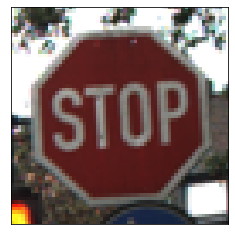

Original label:Priority road, Prediction :Priority road, confidence : 1.000


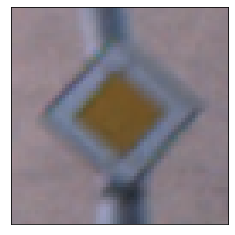

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.972


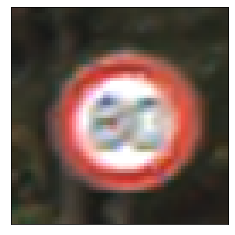

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 1.000


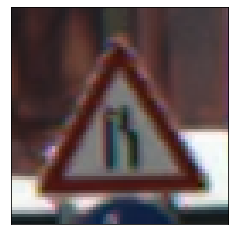

Original label:Keep right, Prediction :Keep right, confidence : 1.000


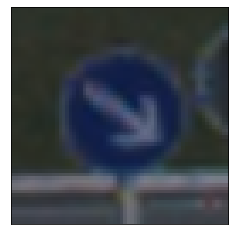

Original label:Road work, Prediction :Road work, confidence : 1.000


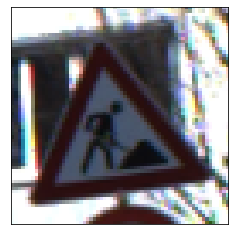

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


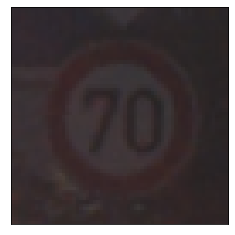

Original label:Keep left, Prediction :Keep left, confidence : 1.000


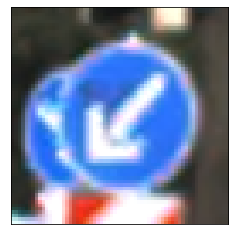

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


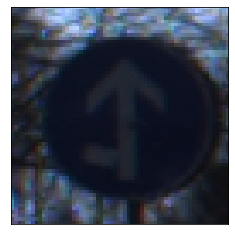

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


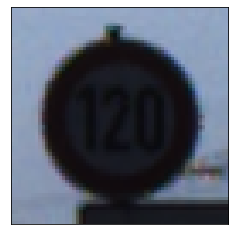

Original label:Yield, Prediction :Yield, confidence : 1.000


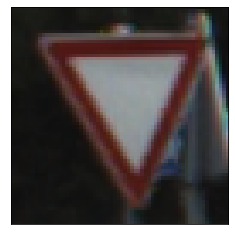

Original label:Road work, Prediction :Road work, confidence : 1.000


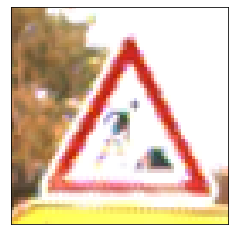

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


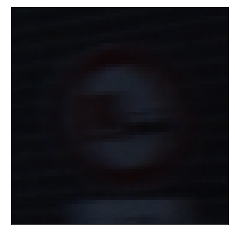

Original label:End of no passing, Prediction :End of no passing, confidence : 1.000


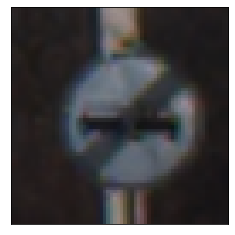

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


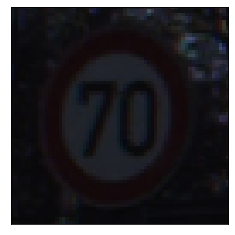

Original label:Yield, Prediction :Yield, confidence : 1.000


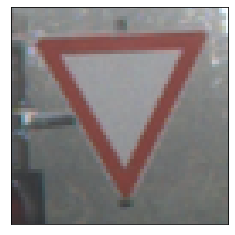

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


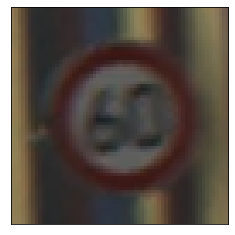

Original label:Keep right, Prediction :Keep right, confidence : 1.000


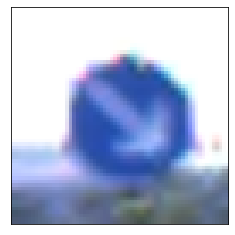

Original label:End of speed limit (80km/h), Prediction :End of speed limit (80km/h), confidence : 1.000


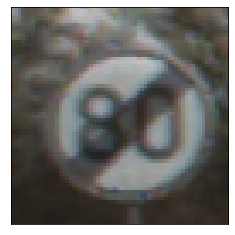

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


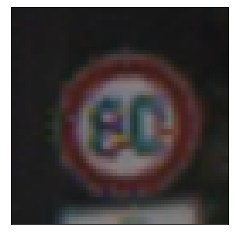

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


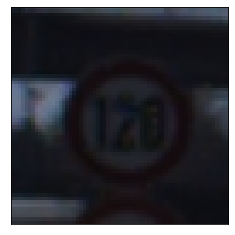

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


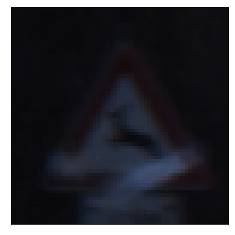

Original label:Stop, Prediction :Stop, confidence : 1.000


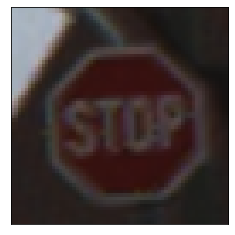

Original label:Road work, Prediction :Road work, confidence : 1.000


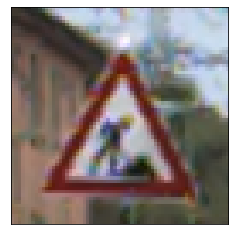

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


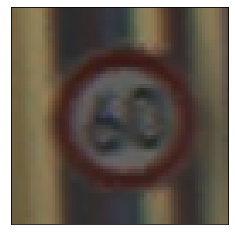

Original label:Priority road, Prediction :Priority road, confidence : 1.000


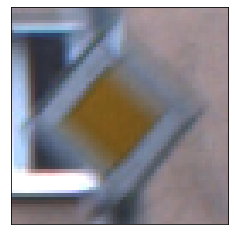

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


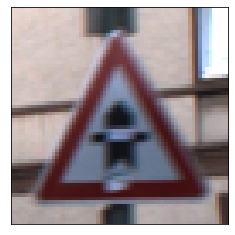

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


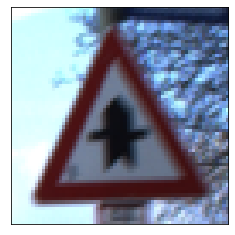

Original label:Yield, Prediction :Yield, confidence : 1.000


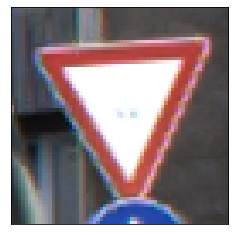

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


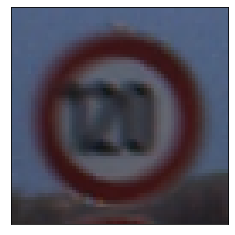

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


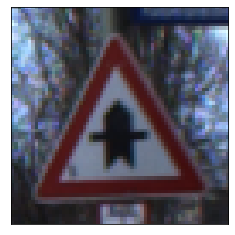

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 1.000


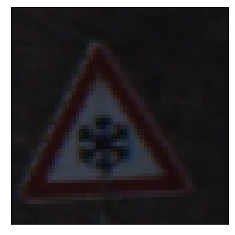

Original label:Priority road, Prediction :Priority road, confidence : 1.000


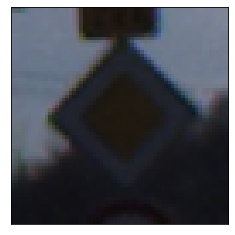

Original label:Dangerous curve left, Prediction :Dangerous curve left, confidence : 1.000


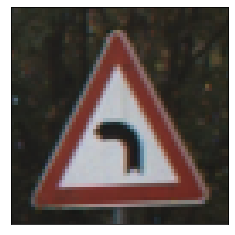

Original label:Keep right, Prediction :Keep right, confidence : 1.000


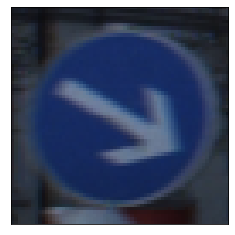

Original label:Yield, Prediction :Yield, confidence : 1.000


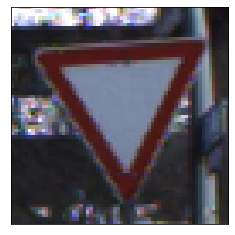

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


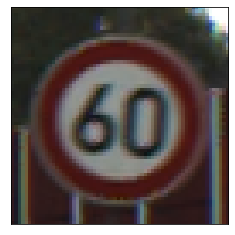

Original label:Yield, Prediction :Yield, confidence : 1.000


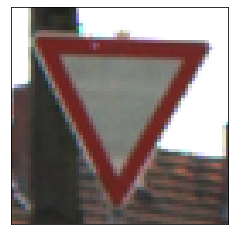

Original label:No entry, Prediction :No entry, confidence : 1.000


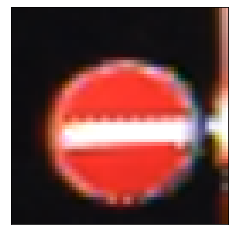

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


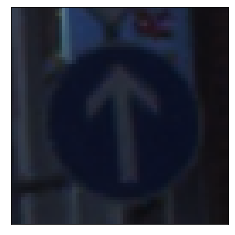

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


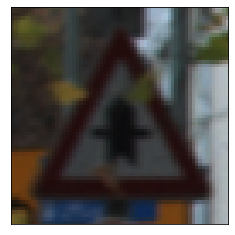

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


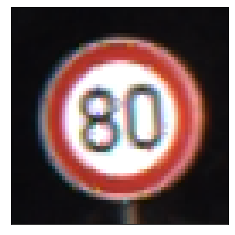

Original label:No vehicles, Prediction :No vehicles, confidence : 1.000


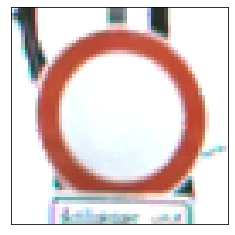

Original label:Keep right, Prediction :Keep right, confidence : 1.000


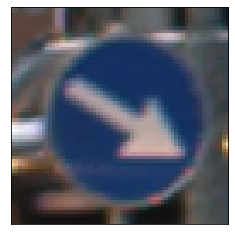

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


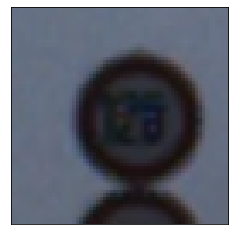

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


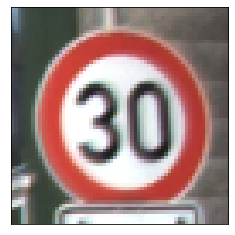

Original label:Dangerous curve left, Prediction :Dangerous curve left, confidence : 1.000


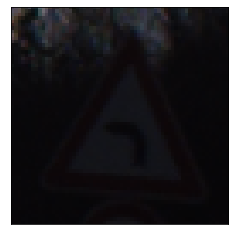

Original label:Yield, Prediction :Yield, confidence : 1.000


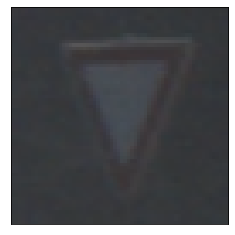

Original label:Keep right, Prediction :Keep right, confidence : 0.991


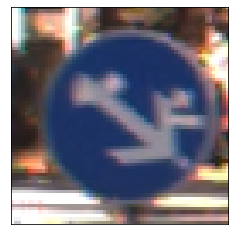

Original label:Keep right, Prediction :Keep right, confidence : 0.961


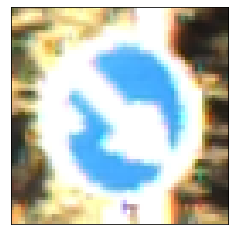

Original label:Speed limit (20km/h), Prediction :Speed limit (20km/h), confidence : 1.000


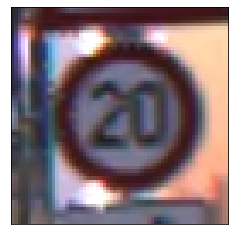

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


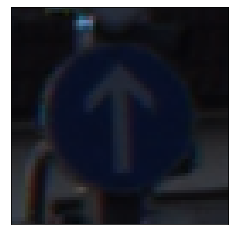

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


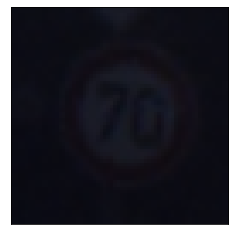

Original label:Priority road, Prediction :Priority road, confidence : 1.000


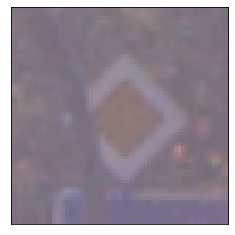

Original label:Yield, Prediction :Yield, confidence : 1.000


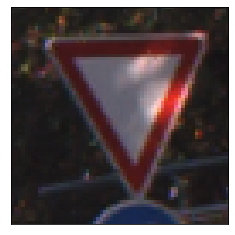

Original label:Double curve, Prediction :Double curve, confidence : 1.000


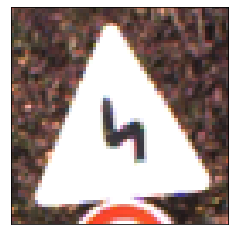

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


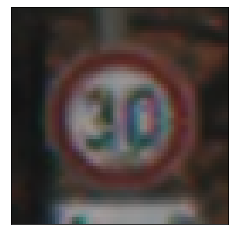

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


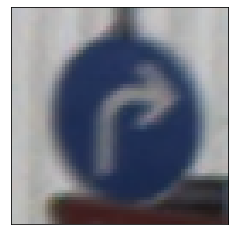

Original label:Turn left ahead, Prediction :Turn left ahead, confidence : 1.000


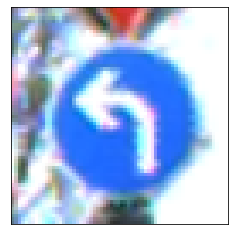

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


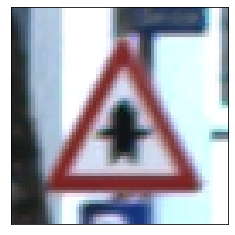

Original label:Priority road, Prediction :Priority road, confidence : 1.000


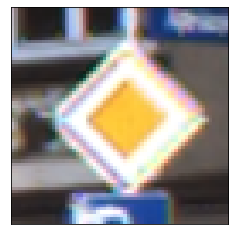

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


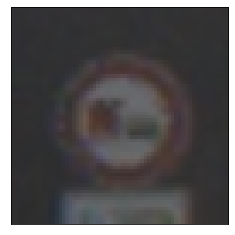

Original label:Yield, Prediction :Yield, confidence : 1.000


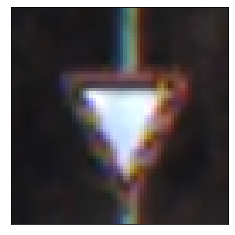

Original label:Yield, Prediction :Yield, confidence : 1.000


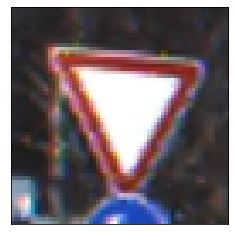

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


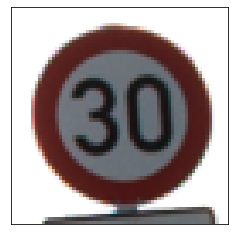

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


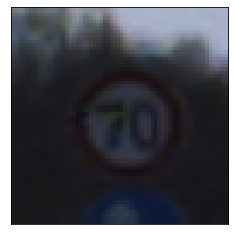

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


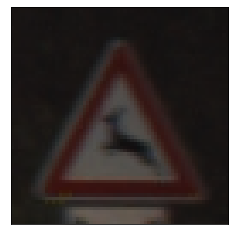

Original label:No entry, Prediction :No entry, confidence : 1.000


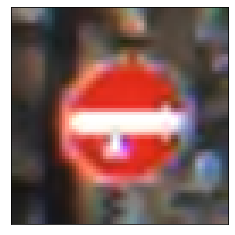

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


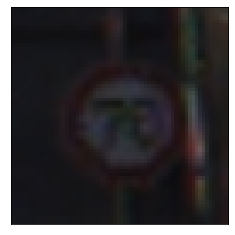

Original label:Yield, Prediction :Yield, confidence : 1.000


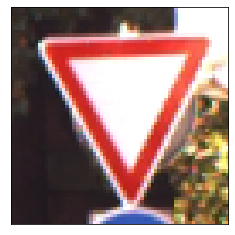

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


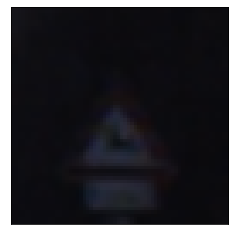

Original label:Road work, Prediction :Road work, confidence : 1.000


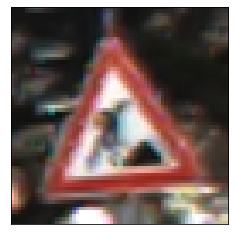

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


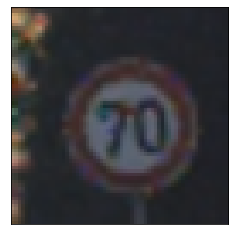

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


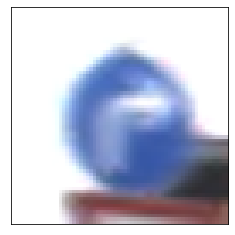

Original label:Go straight or right, Prediction :Go straight or right, confidence : 1.000


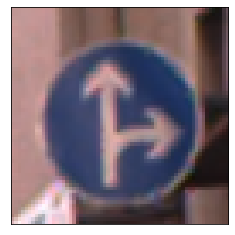

Original label:Dangerous curve left, Prediction :Dangerous curve left, confidence : 1.000


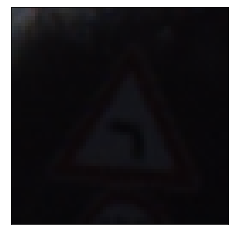

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


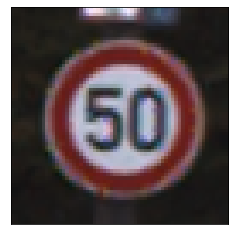

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


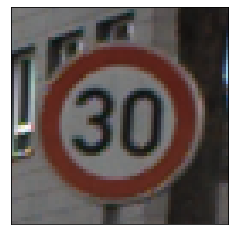

Original label:Keep left, Prediction :Keep left, confidence : 1.000


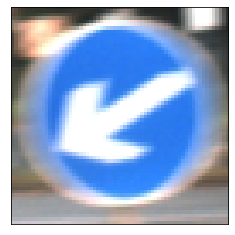

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


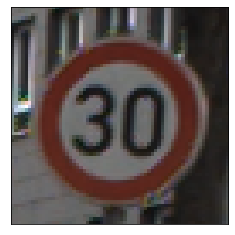

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


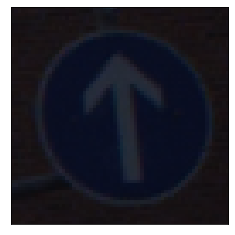

Original label:Keep right, Prediction :Keep right, confidence : 1.000


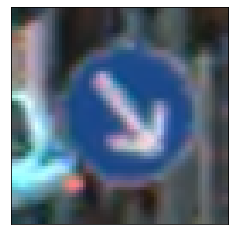

Original label:Keep right, Prediction :Keep right, confidence : 1.000


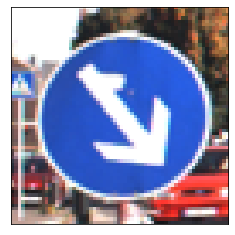

Original label:Bumpy road, Prediction :Bumpy road, confidence : 1.000


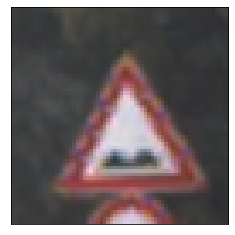

Original label:Yield, Prediction :Yield, confidence : 1.000


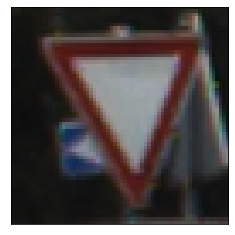

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


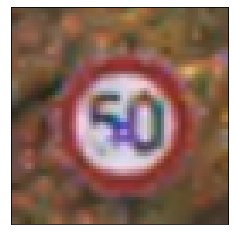

Original label:No entry, Prediction :No entry, confidence : 1.000


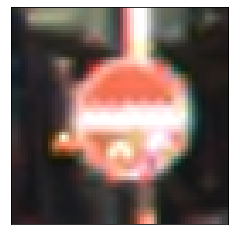

Original label:Priority road, Prediction :Priority road, confidence : 1.000


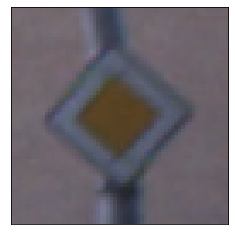

Original label:Keep right, Prediction :Keep right, confidence : 1.000


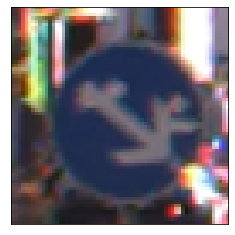

Original label:Yield, Prediction :Yield, confidence : 1.000


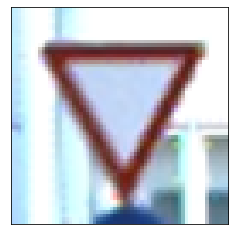

Original label:No passing, Prediction :No passing, confidence : 1.000


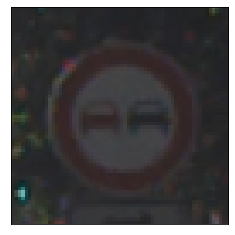

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


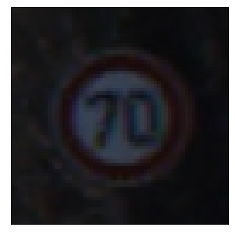

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


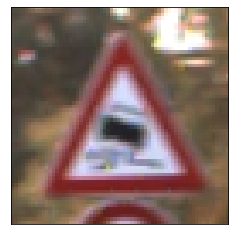

Original label:Stop, Prediction :Stop, confidence : 1.000


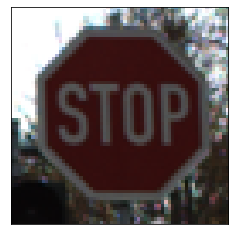

Original label:End no passing veh > 3.5 tons, Prediction :End no passing veh > 3.5 tons, confidence : 1.000


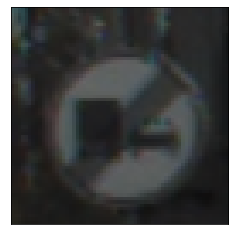

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


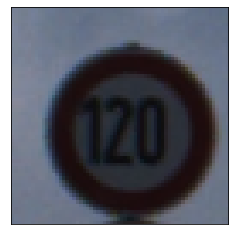

Original label:Yield, Prediction :Yield, confidence : 1.000


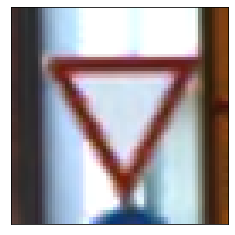

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


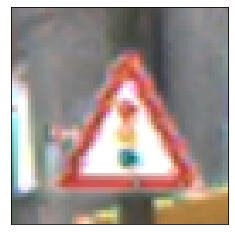

Original label:Priority road, Prediction :Priority road, confidence : 1.000


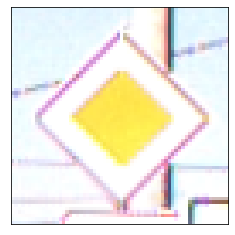

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


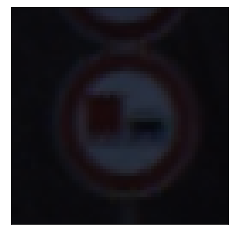

Original label:Stop, Prediction :Stop, confidence : 1.000


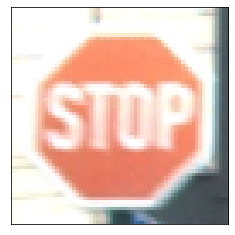

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


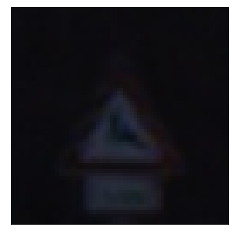

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


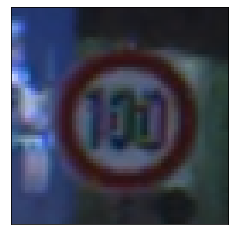

Original label:Go straight or right, Prediction :Go straight or right, confidence : 1.000


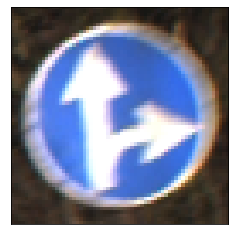

Original label:Go straight or right, Prediction :Go straight or right, confidence : 1.000


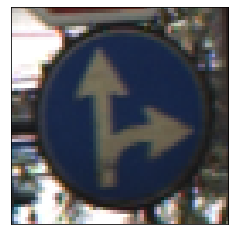

Original label:Bicycles crossing, Prediction :Bicycles crossing, confidence : 1.000


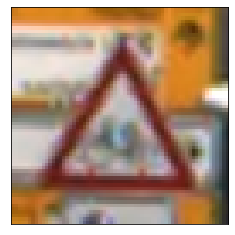

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


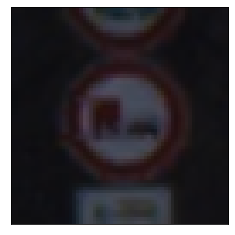

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


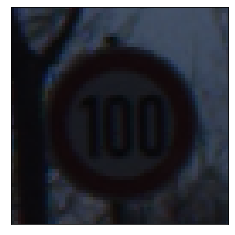

Original label:Keep right, Prediction :Keep right, confidence : 1.000


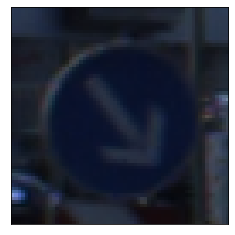

Original label:General caution, Prediction :General caution, confidence : 1.000


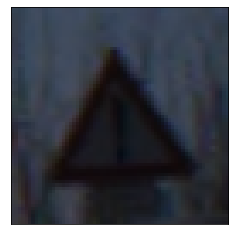

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


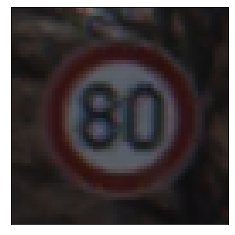

Original label:No entry, Prediction :No entry, confidence : 1.000


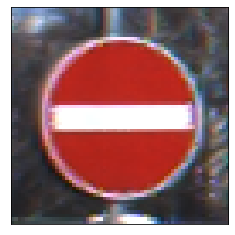

Original label:Yield, Prediction :Yield, confidence : 1.000


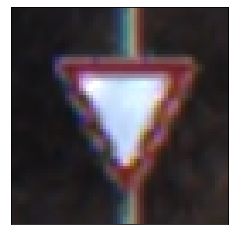

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


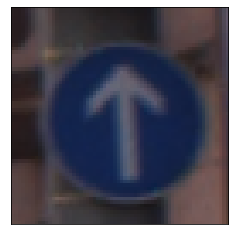

Original label:End of speed limit (80km/h), Prediction :End of speed limit (80km/h), confidence : 1.000


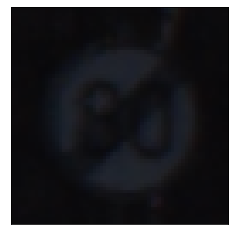

Original label:Road work, Prediction :Road work, confidence : 1.000


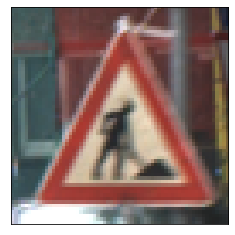

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


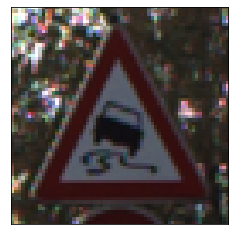

Original label:Priority road, Prediction :Priority road, confidence : 1.000


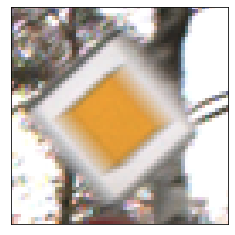

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


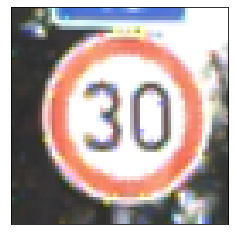

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


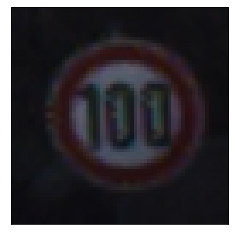

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 0.995


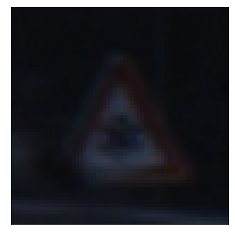

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


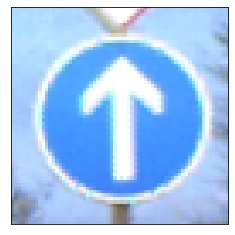

Original label:Stop, Prediction :Stop, confidence : 1.000


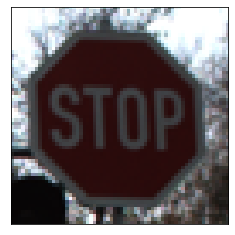

Original label:Yield, Prediction :Yield, confidence : 1.000


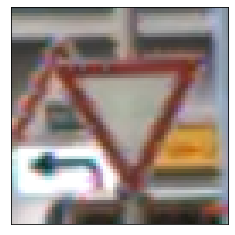

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


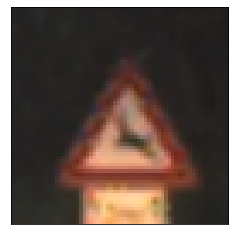

Original label:No passing, Prediction :No passing, confidence : 1.000


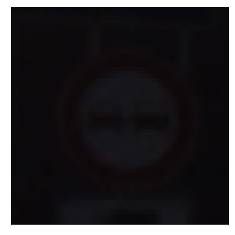

Original label:No passing, Prediction :No passing, confidence : 1.000


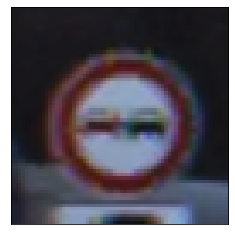

Original label:Children crossing, Prediction :Children crossing, confidence : 0.980


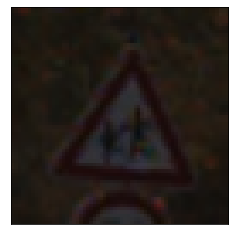

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


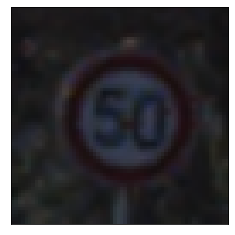

Original label:Priority road, Prediction :Priority road, confidence : 1.000


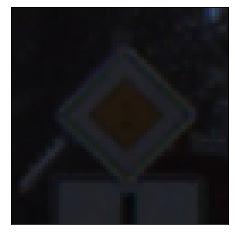

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


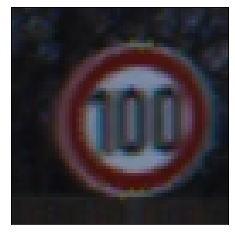

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


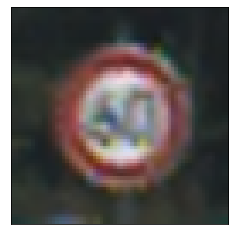

Original label:No entry, Prediction :No entry, confidence : 1.000


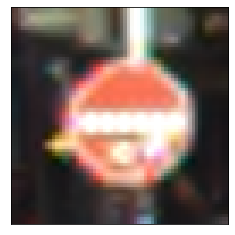

Original label:Children crossing, Prediction :Children crossing, confidence : 0.998


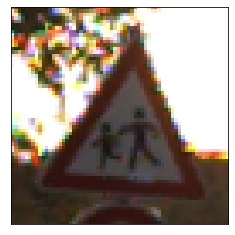

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


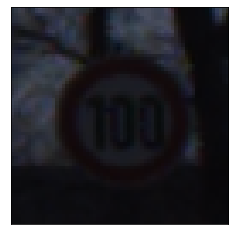

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


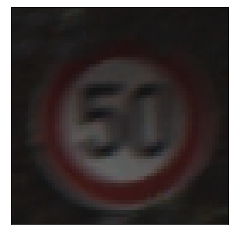

Original label:Dangerous curve right, Prediction :Dangerous curve right, confidence : 1.000


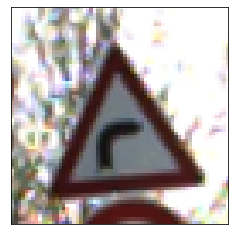

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


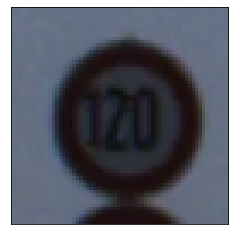

Original label:General caution, Prediction :General caution, confidence : 1.000


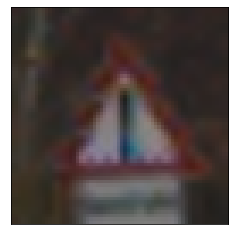

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


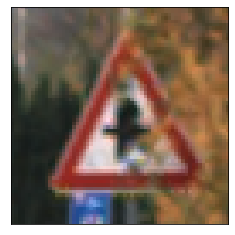

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


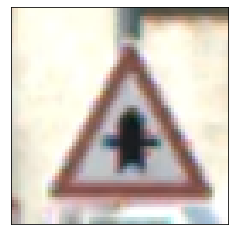

Original label:Stop, Prediction :Stop, confidence : 1.000


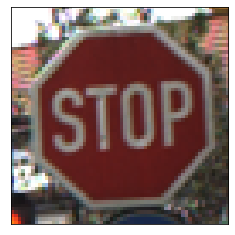

Original label:Priority road, Prediction :Priority road, confidence : 1.000


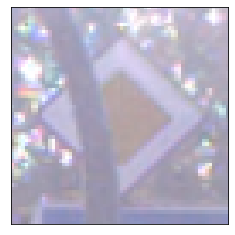

Original label:Turn left ahead, Prediction :Turn left ahead, confidence : 1.000


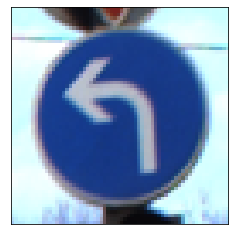

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.972


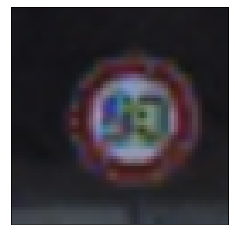

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


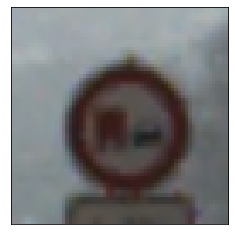

Original label:Yield, Prediction :Yield, confidence : 1.000


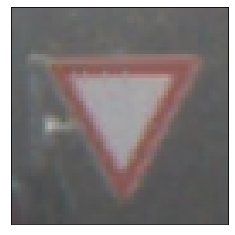

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


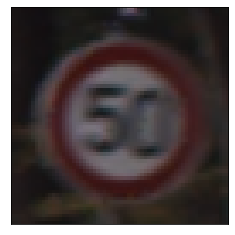

Original label:Yield, Prediction :Yield, confidence : 1.000


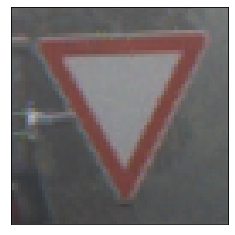

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


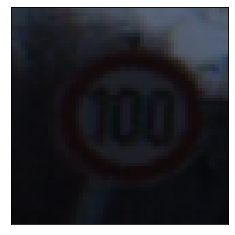

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


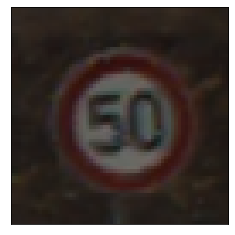

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


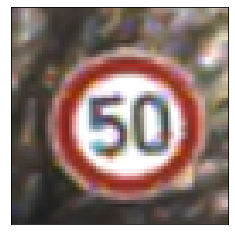

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


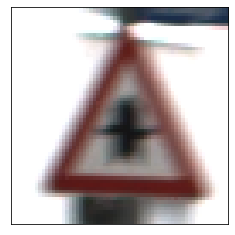

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


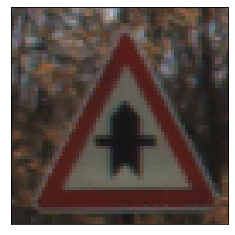

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


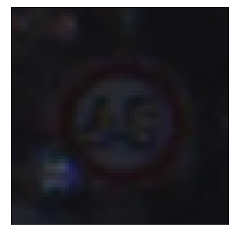

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


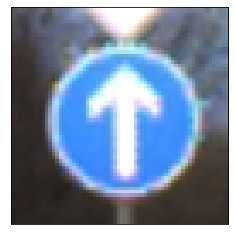

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


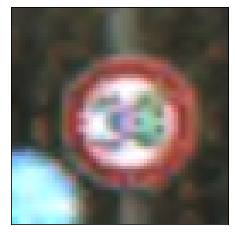

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


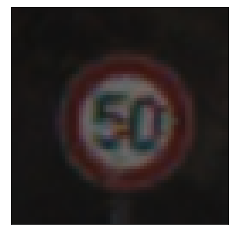

Original label:General caution, Prediction :General caution, confidence : 1.000


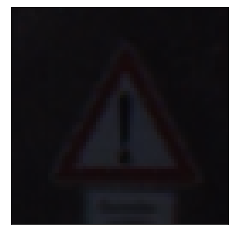

Original label:Stop, Prediction :Stop, confidence : 1.000


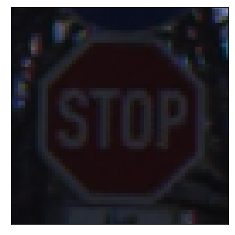

Original label:Bicycles crossing, Prediction :Bicycles crossing, confidence : 1.000


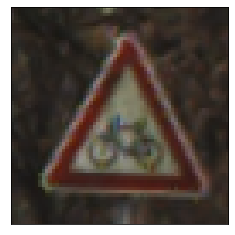

Original label:No passing, Prediction :No passing, confidence : 1.000


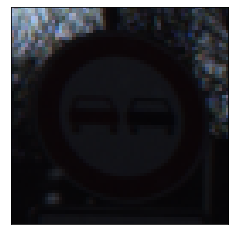

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


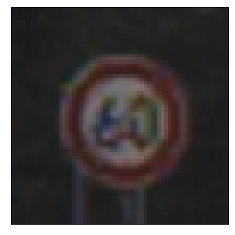

Original label:Yield, Prediction :Yield, confidence : 1.000


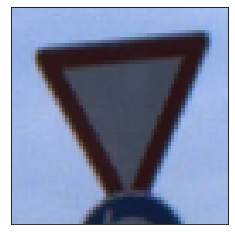

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


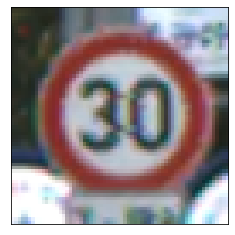

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


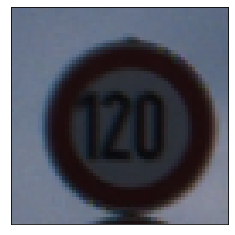

Original label:Go straight or right, Prediction :Go straight or right, confidence : 1.000


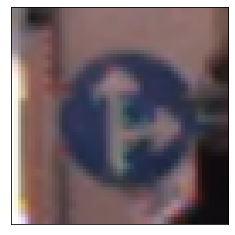

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


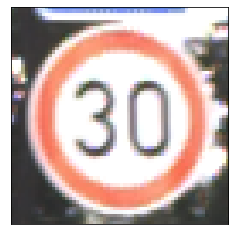

Original label:Double curve, Prediction :Double curve, confidence : 1.000


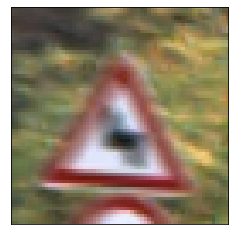

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


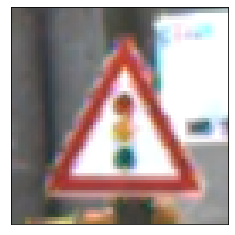

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


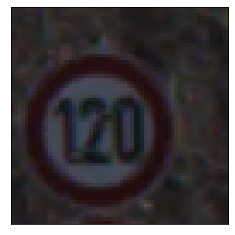

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


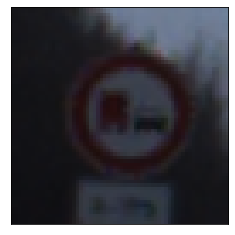

Original label:No passing, Prediction :No passing, confidence : 1.000


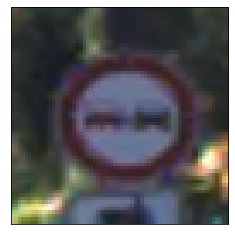

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


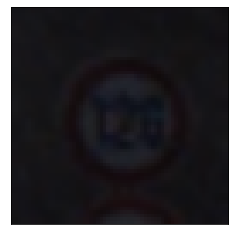

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


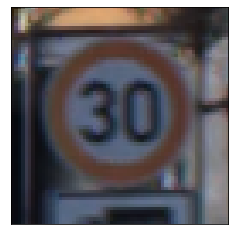

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


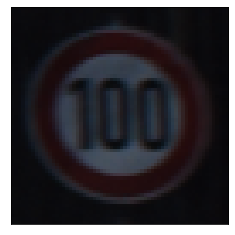

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


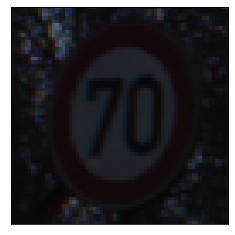

Original label:End of no passing, Prediction :End of no passing, confidence : 1.000


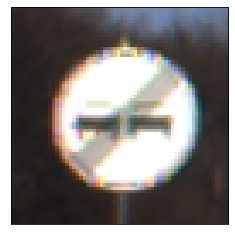

Original label:No passing, Prediction :No passing, confidence : 1.000


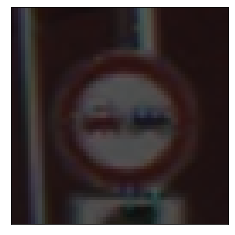

Original label:Yield, Prediction :Yield, confidence : 1.000


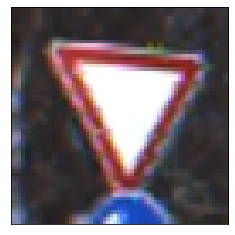

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


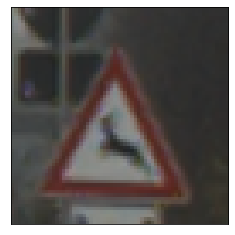

Original label:Keep right, Prediction :Keep right, confidence : 1.000


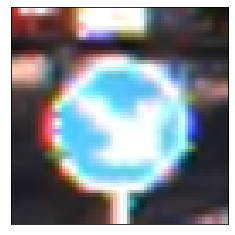

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 0.999


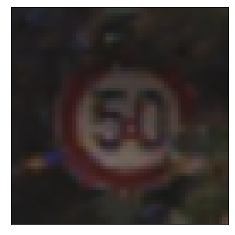

Original label:Road work, Prediction :Road work, confidence : 1.000


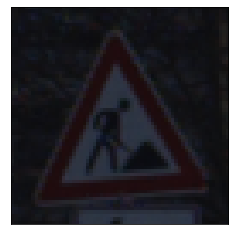

Original label:Priority road, Prediction :Priority road, confidence : 1.000


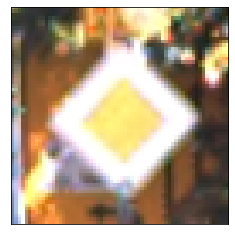

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 1.000


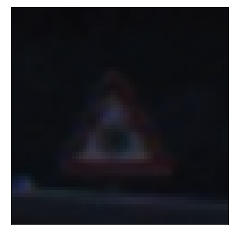

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


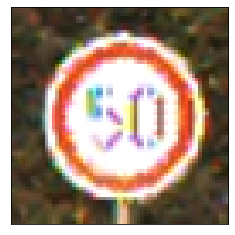

Original label:Yield, Prediction :Yield, confidence : 1.000


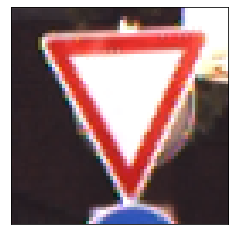

Original label:No passing, Prediction :No passing, confidence : 1.000


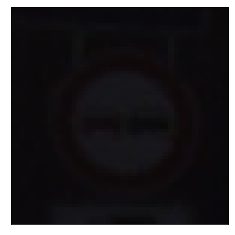

Original label:Stop, Prediction :Stop, confidence : 1.000


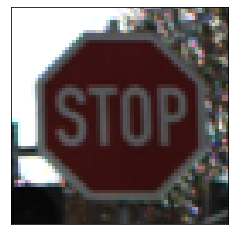

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


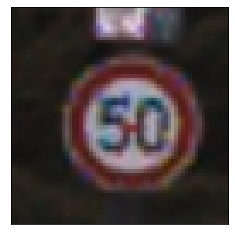

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


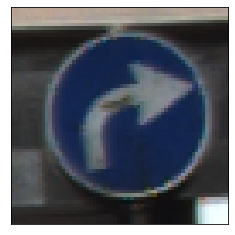

Original label:Dangerous curve right, Prediction :Dangerous curve right, confidence : 1.000


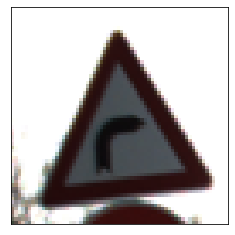

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


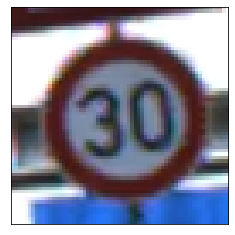

Original label:General caution, Prediction :General caution, confidence : 0.953


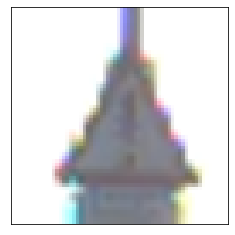

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


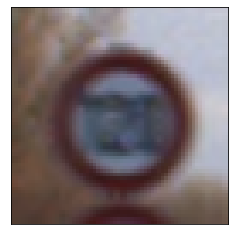

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


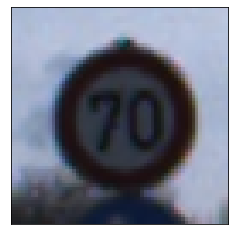

Original label:Yield, Prediction :Yield, confidence : 1.000


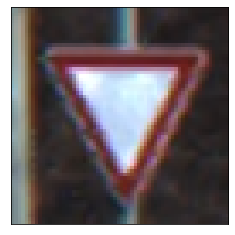

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


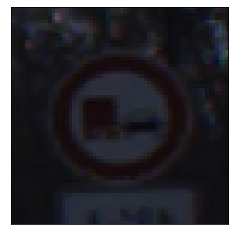

Original label:Speed limit (20km/h), Prediction :Speed limit (20km/h), confidence : 1.000


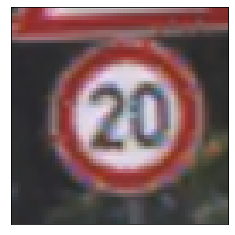

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


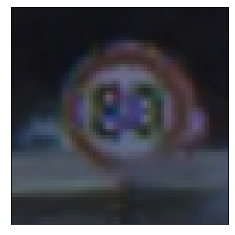

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


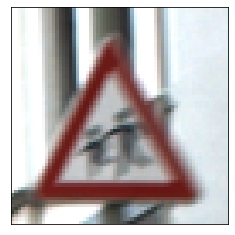

Original label:Priority road, Prediction :Priority road, confidence : 1.000


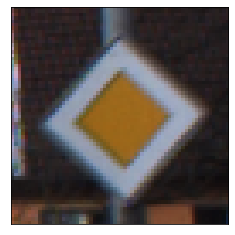

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


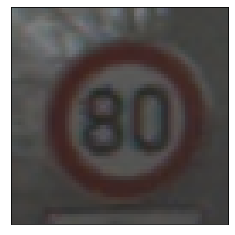

Original label:Road work, Prediction :Road work, confidence : 1.000


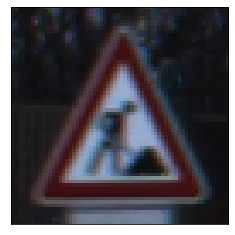

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


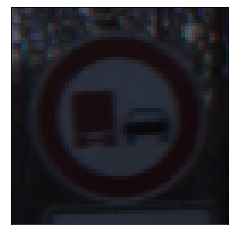

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


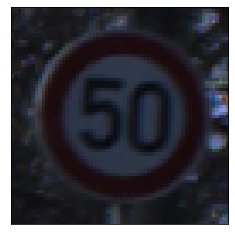

Original label:Priority road, Prediction :Priority road, confidence : 1.000


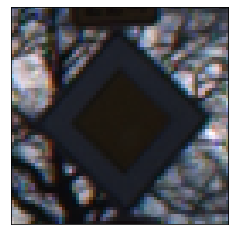

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


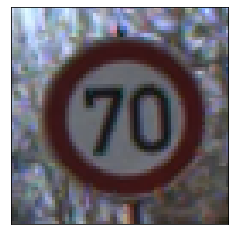

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


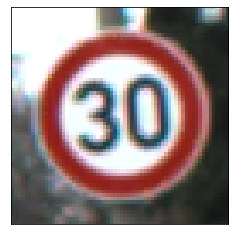

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


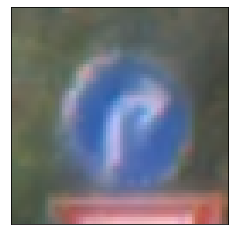

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


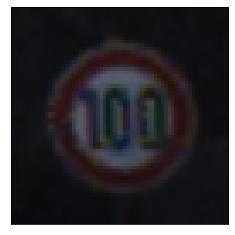

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


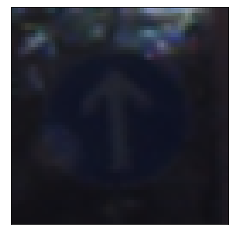

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


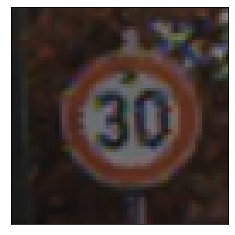

Original label:Priority road, Prediction :Priority road, confidence : 1.000


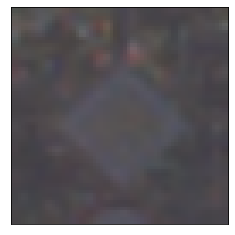

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


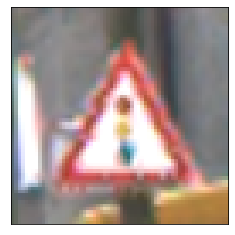

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


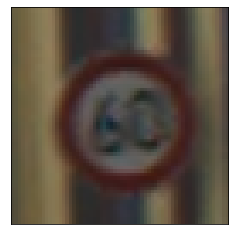

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


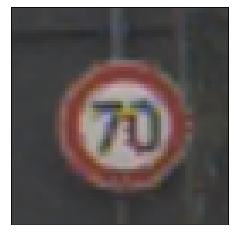

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


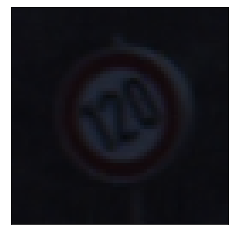

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


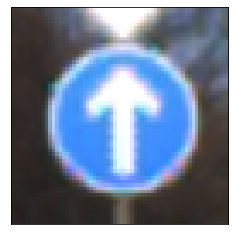

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


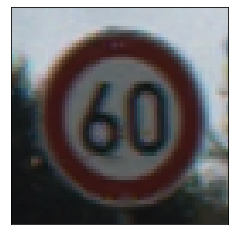

Original label:Pedestrians, Prediction :Pedestrians, confidence : 1.000


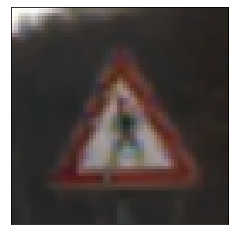

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


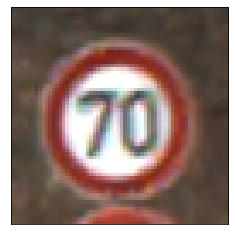

Original label:Keep right, Prediction :Keep right, confidence : 1.000


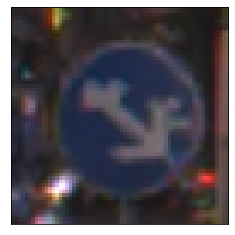

Original label:No entry, Prediction :No entry, confidence : 1.000


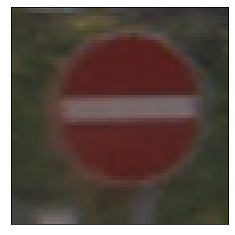

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


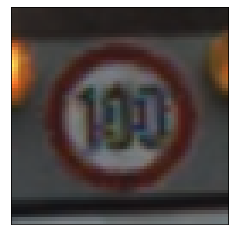

Original label:No entry, Prediction :No entry, confidence : 1.000


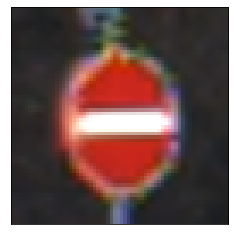

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


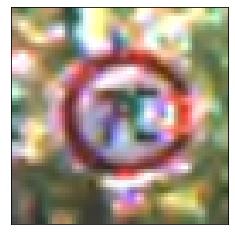

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


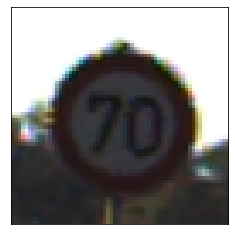

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


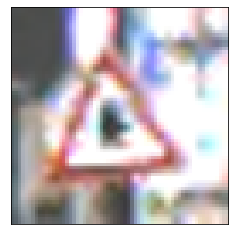

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


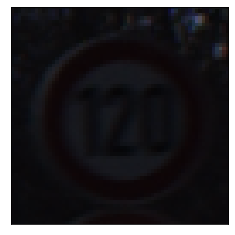

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


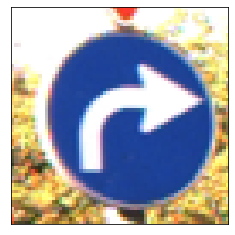

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


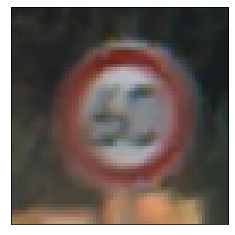

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


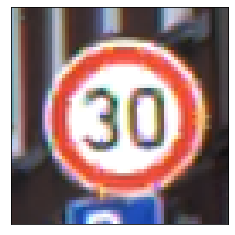

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


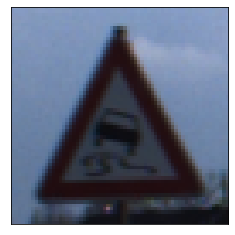

Original label:Bumpy road, Prediction :Bumpy road, confidence : 1.000


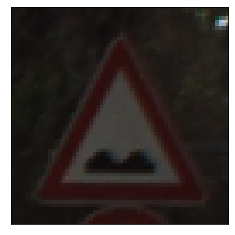

Original label:Stop, Prediction :Stop, confidence : 1.000


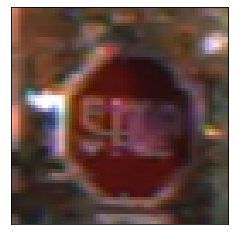

Original label:Go straight or right, Prediction :Go straight or right, confidence : 1.000


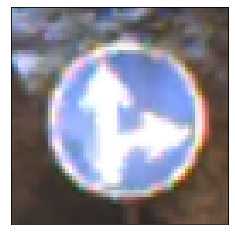

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


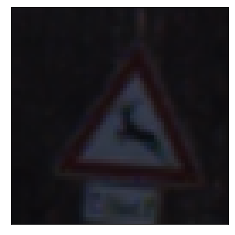

Original label:No passing, Prediction :No passing, confidence : 1.000


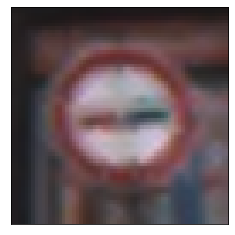

Original label:Turn left ahead, Prediction :Turn left ahead, confidence : 1.000


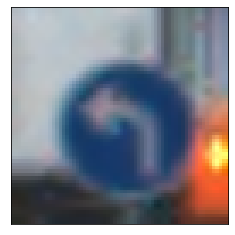

Original label:Road work, Prediction :Road work, confidence : 1.000


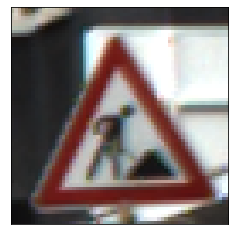

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


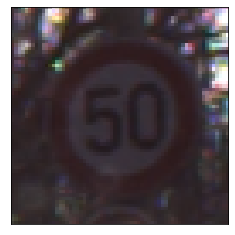

Original label:Keep right, Prediction :Keep right, confidence : 0.641


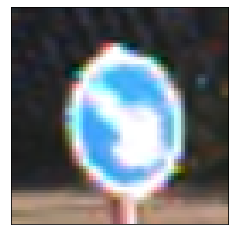

Original label:No passing, Prediction :No passing, confidence : 1.000


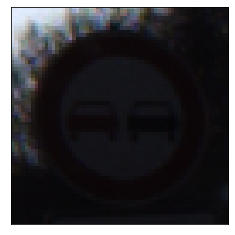

Original label:General caution, Prediction :General caution, confidence : 1.000


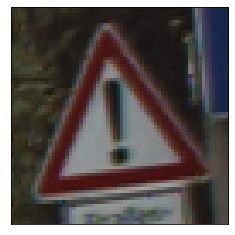

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 1.000


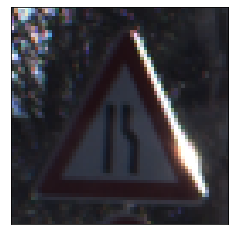

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


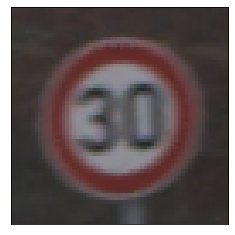

Original label:End no passing veh > 3.5 tons, Prediction :End no passing veh > 3.5 tons, confidence : 1.000


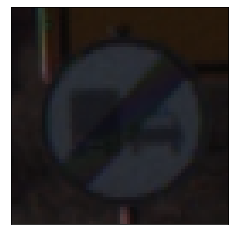

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


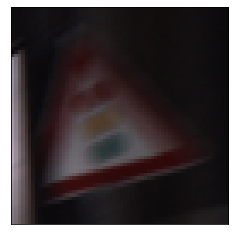

Original label:Keep right, Prediction :Keep right, confidence : 1.000


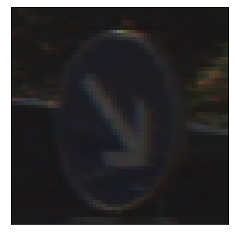

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


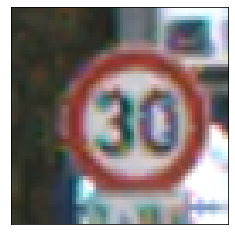

Original label:General caution, Prediction :General caution, confidence : 1.000


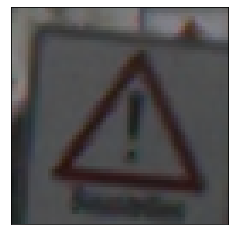

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


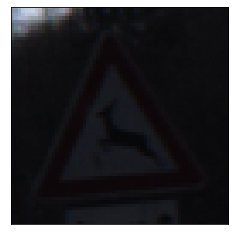

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 1.000


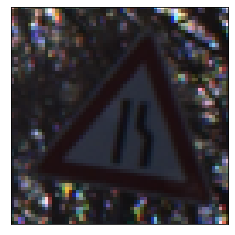

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


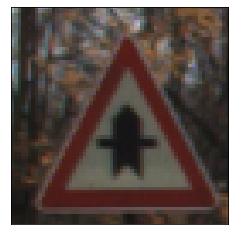

Original label:Priority road, Prediction :Priority road, confidence : 1.000


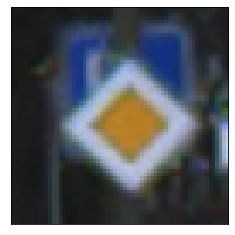

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


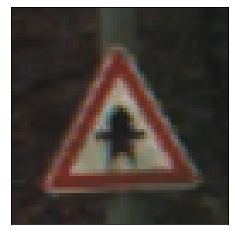

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


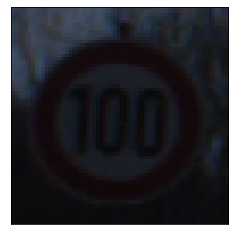

Original label:Yield, Prediction :Yield, confidence : 1.000


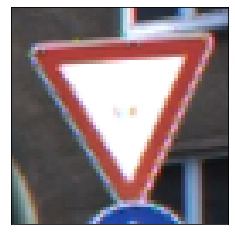

Original label:No passing, Prediction :No passing, confidence : 1.000


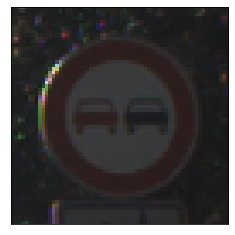

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


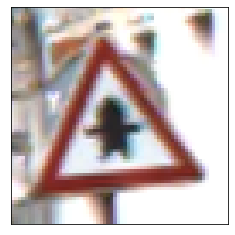

Original label:Priority road, Prediction :Priority road, confidence : 1.000


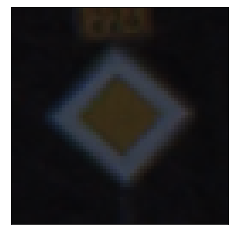

Original label:Stop, Prediction :Stop, confidence : 1.000


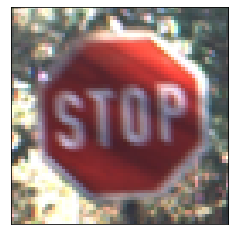

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


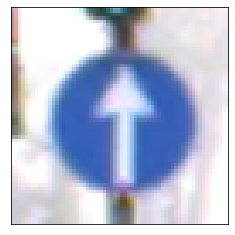

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 1.000


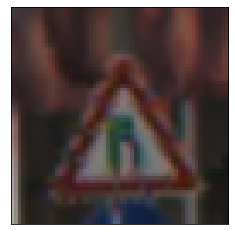

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


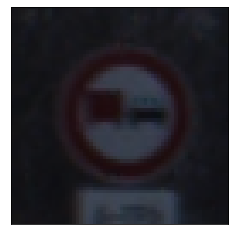

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


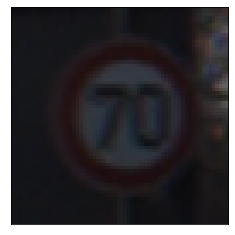

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


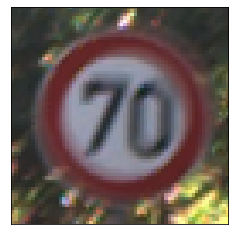

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


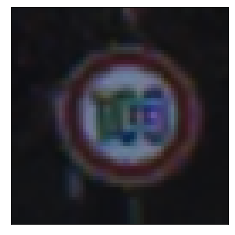

Original label:Yield, Prediction :Yield, confidence : 1.000


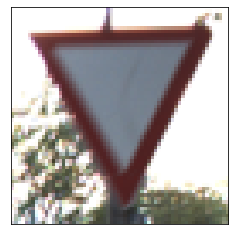

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


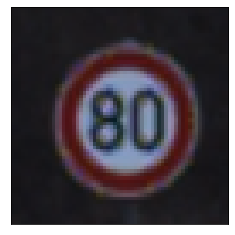

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


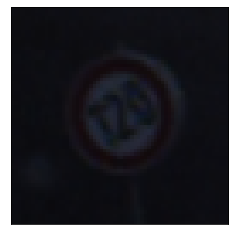

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 0.971


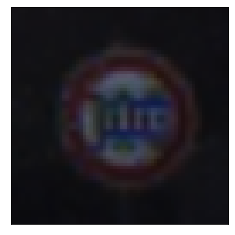

Original label:Priority road, Prediction :Priority road, confidence : 1.000


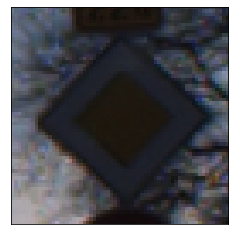

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


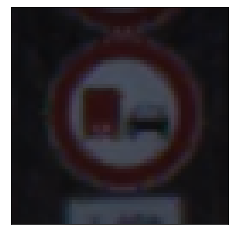

Original label:No passing, Prediction :No passing, confidence : 1.000


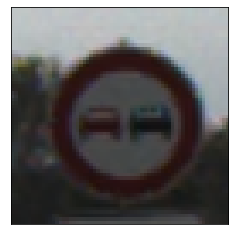

Original label:No vehicles, Prediction :No vehicles, confidence : 1.000


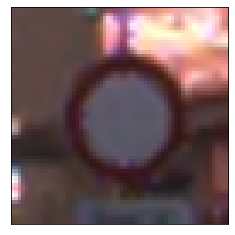

Original label:No vehicles, Prediction :No vehicles, confidence : 1.000


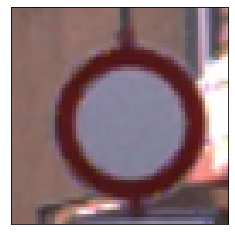

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


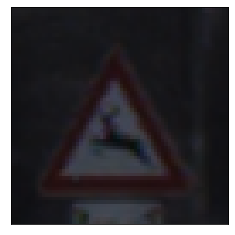

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


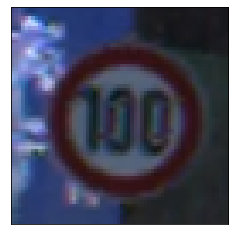

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


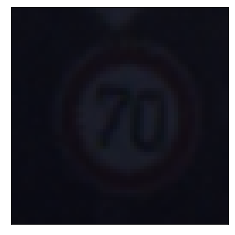

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.975


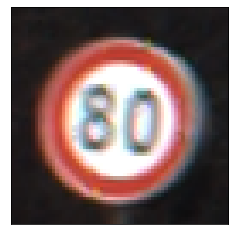

Original label:General caution, Prediction :General caution, confidence : 1.000


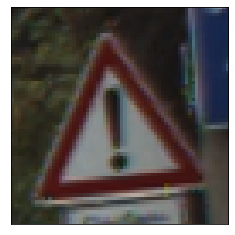

Original label:Keep right, Prediction :Keep right, confidence : 1.000


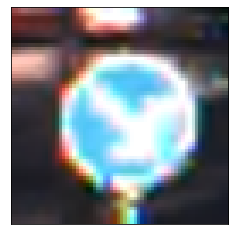

Original label:No vehicles, Prediction :No vehicles, confidence : 1.000


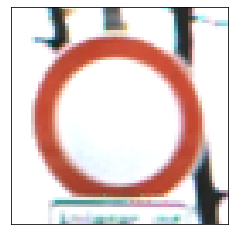

Original label:Yield, Prediction :Yield, confidence : 1.000


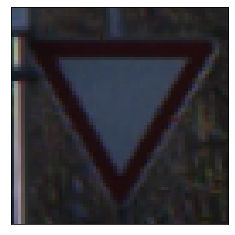

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


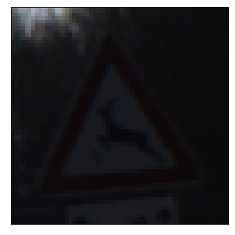

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.751


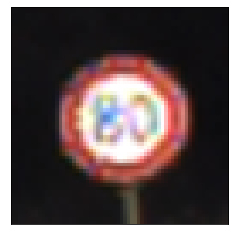

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


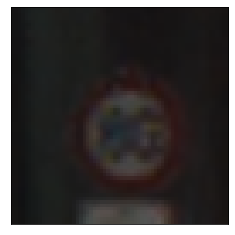

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


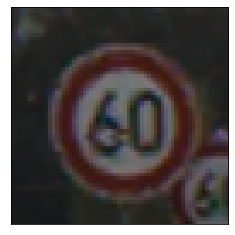

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


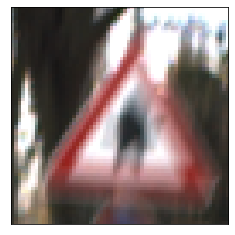

Original label:Keep right, Prediction :Keep right, confidence : 1.000


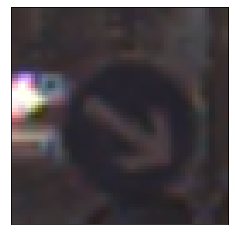

Original label:Yield, Prediction :Yield, confidence : 1.000


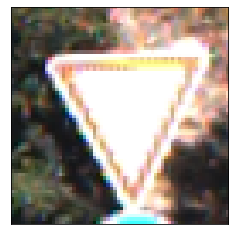

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


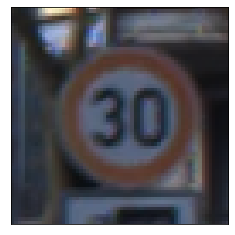

Original label:General caution, Prediction :General caution, confidence : 1.000


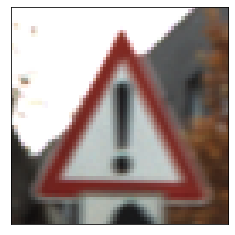

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


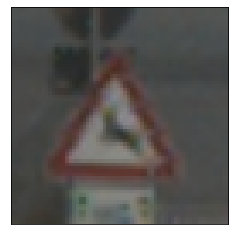

Original label:No vehicles, Prediction :No vehicles, confidence : 1.000


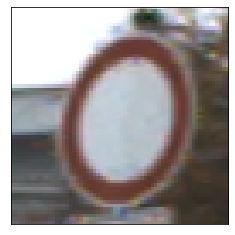

Original label:Bicycles crossing, Prediction :Bicycles crossing, confidence : 1.000


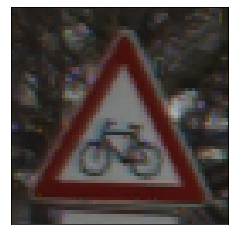

Original label:Yield, Prediction :Yield, confidence : 1.000


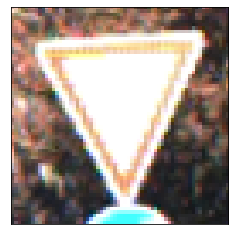

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


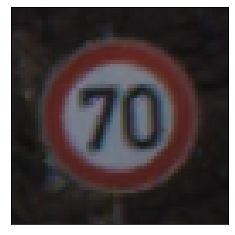

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


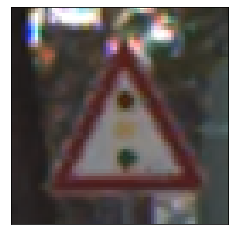

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


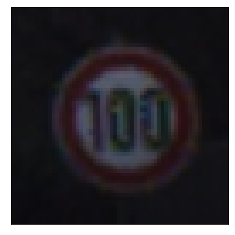

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


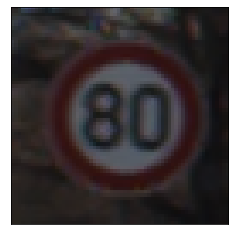

Original label:General caution, Prediction :General caution, confidence : 1.000


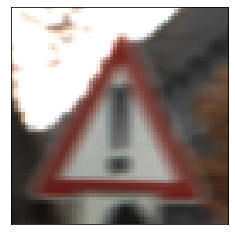

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


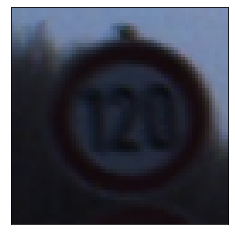

Original label:Stop, Prediction :Stop, confidence : 1.000


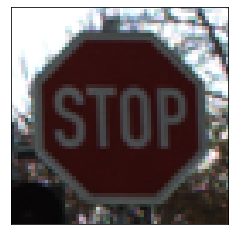

Original label:Bumpy road, Prediction :Bumpy road, confidence : 1.000


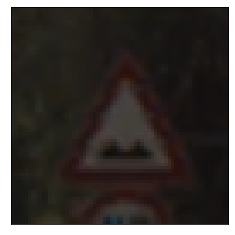

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


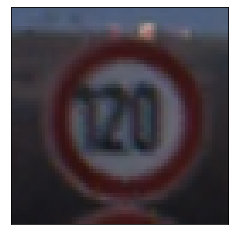

Original label:Stop, Prediction :Stop, confidence : 1.000


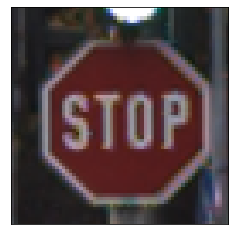

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


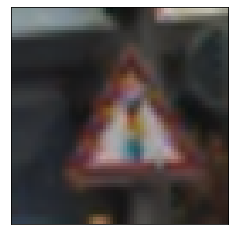

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


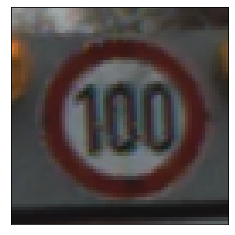

Original label:Yield, Prediction :Yield, confidence : 1.000


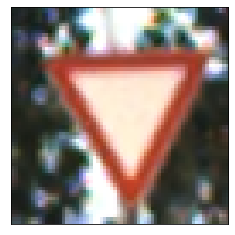

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


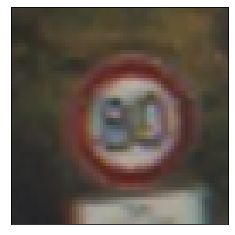

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


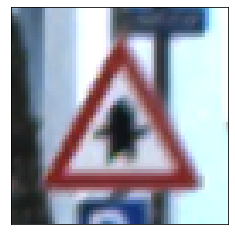

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 0.994


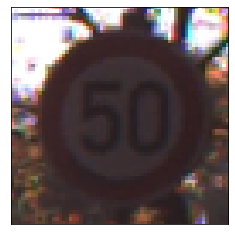

Original label:Roundabout mandatory, Prediction :Roundabout mandatory, confidence : 1.000


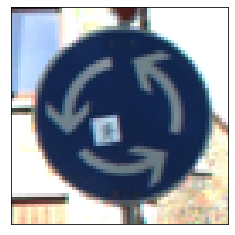

Original label:Veh > 3.5 tons prohibited, Prediction :Veh > 3.5 tons prohibited, confidence : 1.000


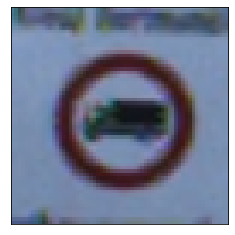

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


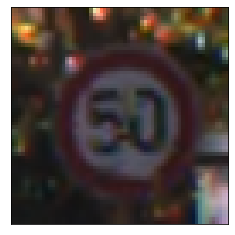

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


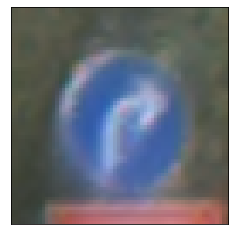

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


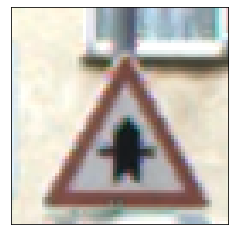

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


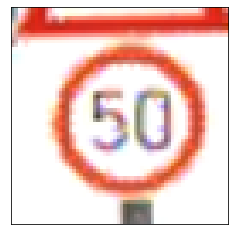

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


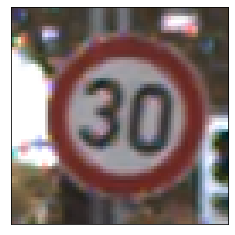

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


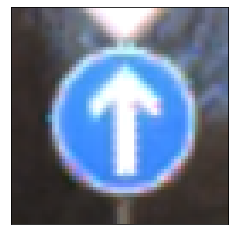

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


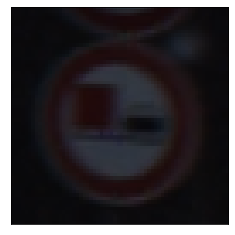

Original label:Yield, Prediction :Yield, confidence : 1.000


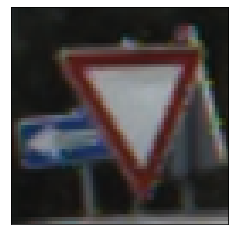

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


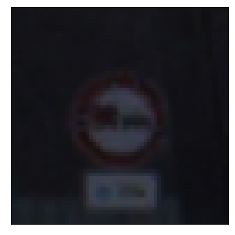

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


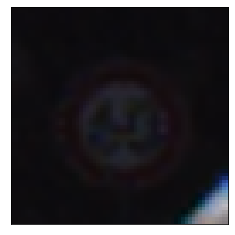

Original label:Go straight or left, Prediction :Go straight or left, confidence : 1.000


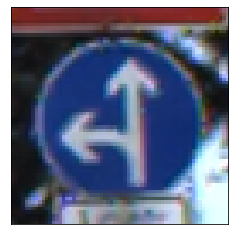

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


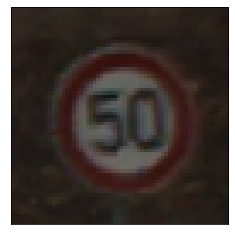

Original label:Priority road, Prediction :Priority road, confidence : 1.000


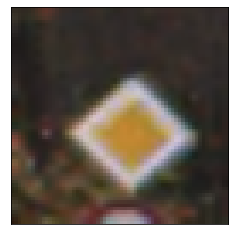

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


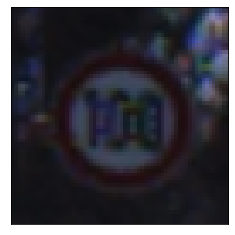

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


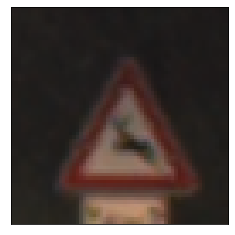

Original label:Pedestrians, Prediction :Pedestrians, confidence : 1.000


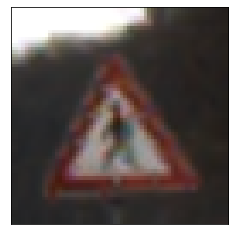

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


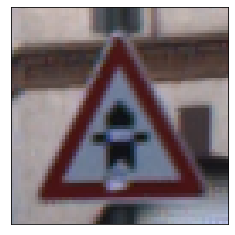

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


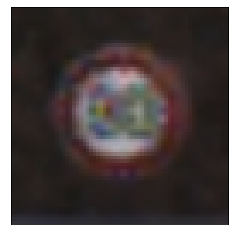

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


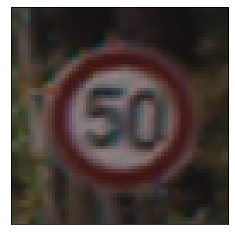

Original label:Road work, Prediction :Road work, confidence : 1.000


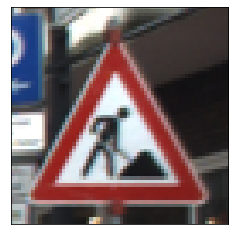

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


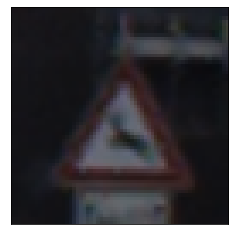

Original label:Priority road, Prediction :Priority road, confidence : 1.000


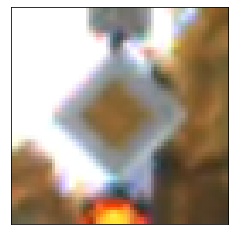

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


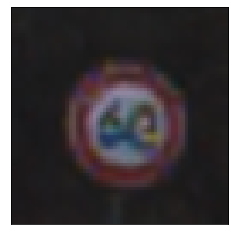

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


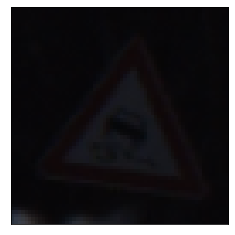

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


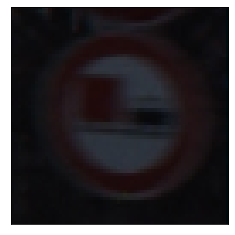

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


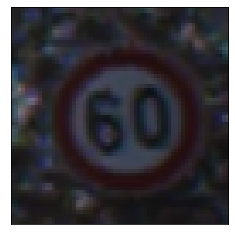

Original label:Go straight or left, Prediction :Go straight or left, confidence : 1.000


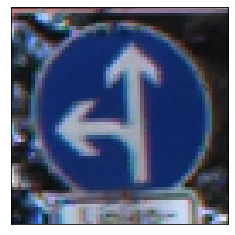

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


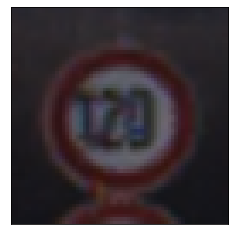

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


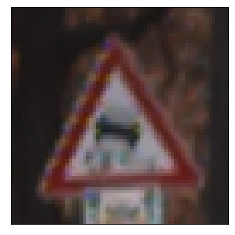

Original label:Road work, Prediction :Road work, confidence : 1.000


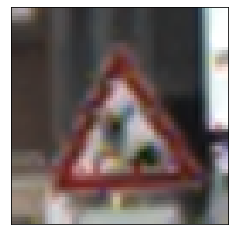

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 1.000


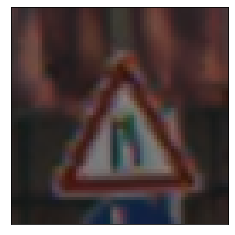

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


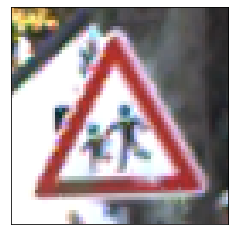

Original label:Road work, Prediction :Road work, confidence : 1.000


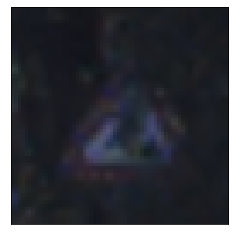

Original label:No passing, Prediction :No passing, confidence : 1.000


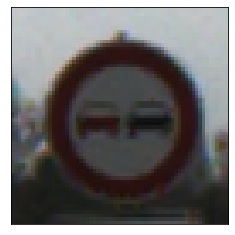

Original label:Road work, Prediction :Road work, confidence : 1.000


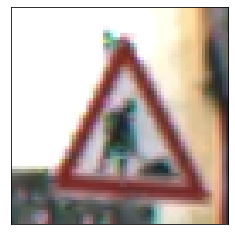

Original label:Road work, Prediction :Road work, confidence : 1.000


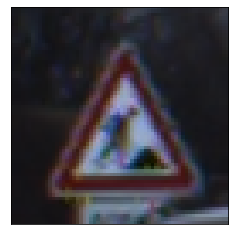

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


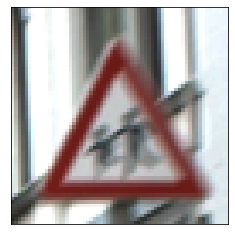

Original label:Dangerous curve left, Prediction :Dangerous curve left, confidence : 1.000


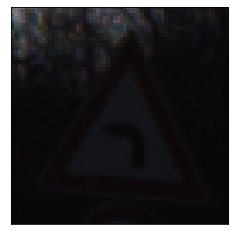

Original label:Road work, Prediction :Road work, confidence : 1.000


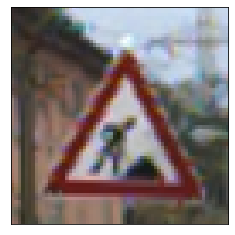

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 1.000


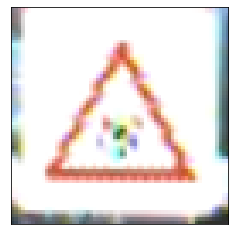

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


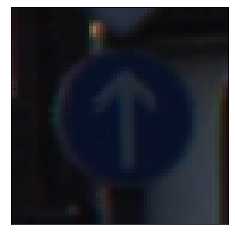

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


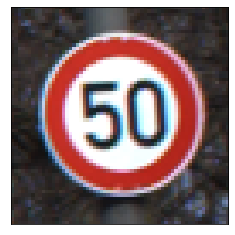

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


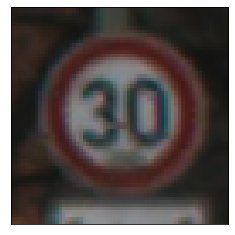

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


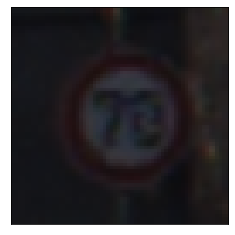

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


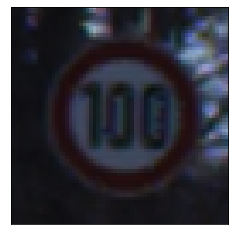

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


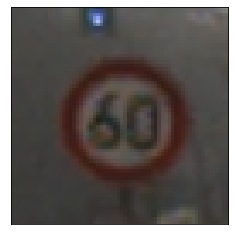

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


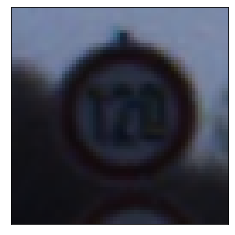

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


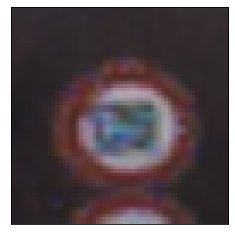

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


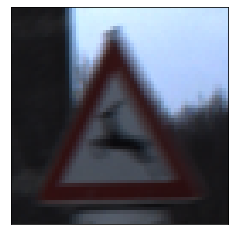

Original label:Keep right, Prediction :Keep right, confidence : 1.000


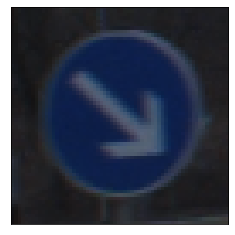

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


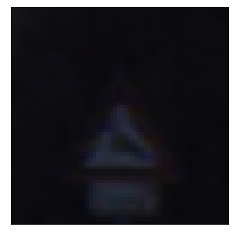

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


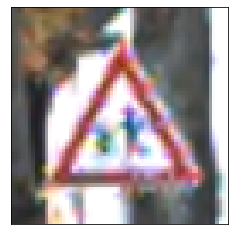

Original label:Stop, Prediction :Stop, confidence : 1.000


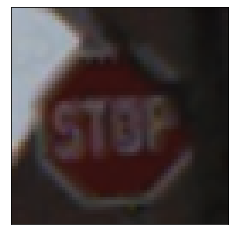

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


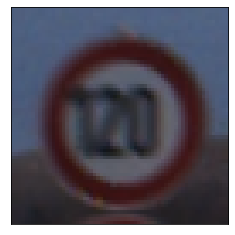

Original label:Keep right, Prediction :Keep right, confidence : 1.000


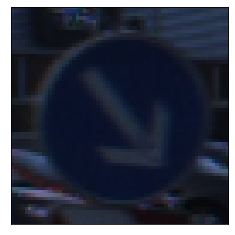

Original label:No passing, Prediction :No passing, confidence : 1.000


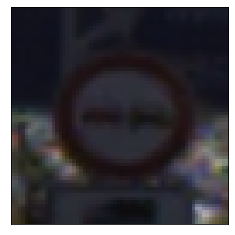

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


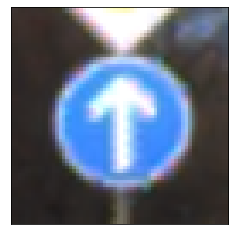

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


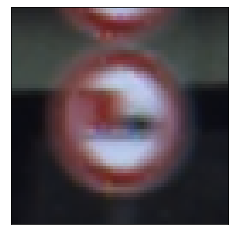

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


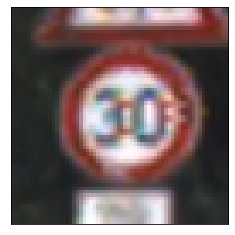

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


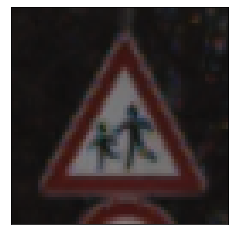

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


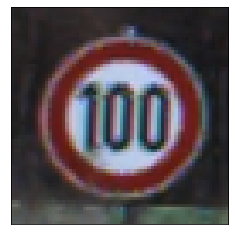

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


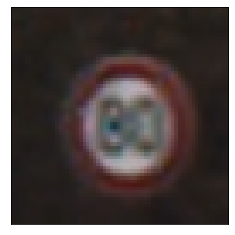

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


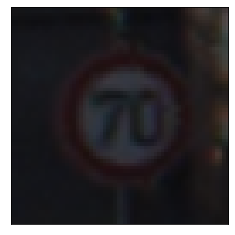

Original label:Priority road, Prediction :Priority road, confidence : 1.000


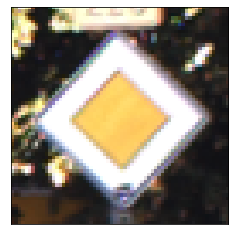

Original label:Road work, Prediction :Road work, confidence : 1.000


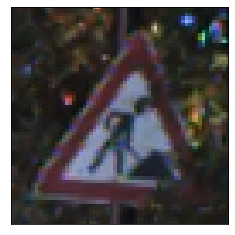

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


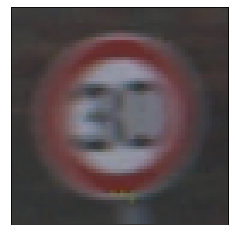

Original label:Priority road, Prediction :Priority road, confidence : 1.000


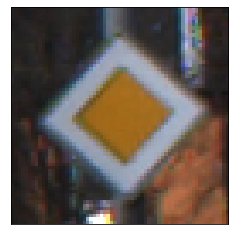

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


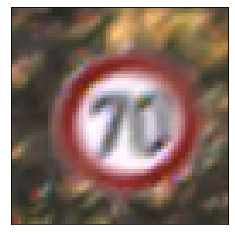

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 1.000


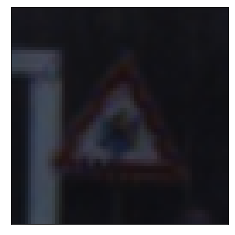

Original label:Road work, Prediction :Road work, confidence : 1.000


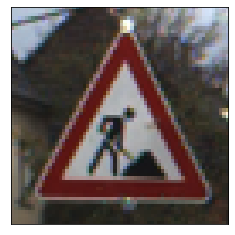

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


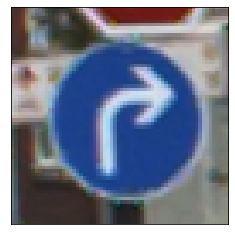

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


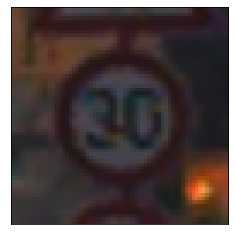

Original label:Pedestrians, Prediction :Pedestrians, confidence : 1.000


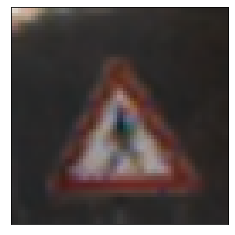

Original label:Yield, Prediction :Yield, confidence : 1.000


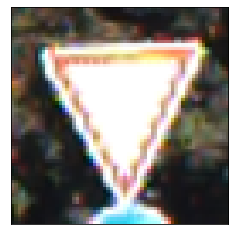

Original label:End of speed limit (80km/h), Prediction :End of speed limit (80km/h), confidence : 1.000


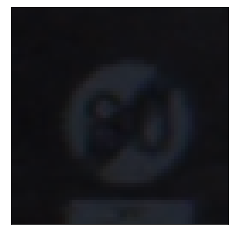

In [25]:
# Find the some images that were predicted correctly and who the images along with the predicted class
for i in range(500):
    pred_class = np.argmax(prob[correct[i]])
    pred_label = classes[pred_class]
    
    print('Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        list(classes.values())[test_labels.argmax(axis=1)[correct[i]]],
        pred_label,
        prob[correct[i]][pred_class]))
    
    plt.imshow(test_imgs[correct[i]])
    plt.xticks([]),plt.yticks([])
    plt.show()

In [26]:
errors = np.where(predictions != test_labels.argmax(axis=1))[0]
print("No of errors = {}/{}".format(len(errors),12630))

No of errors = 345/12630


Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.370


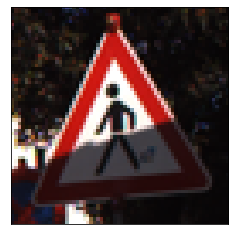

Original label:End of no passing, Prediction :End speed + passing limits, confidence : 0.519


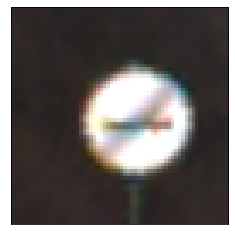

Original label:Speed limit (50km/h), Prediction :Speed limit (30km/h), confidence : 0.996


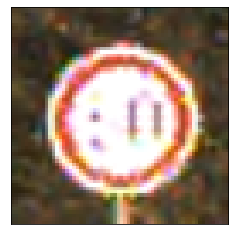

Original label:Road work, Prediction :Right-of-way at intersection, confidence : 0.490


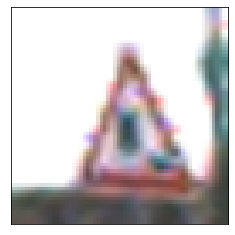

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.976


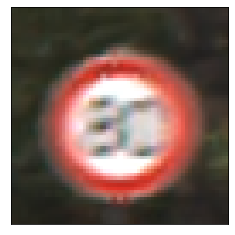

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.998


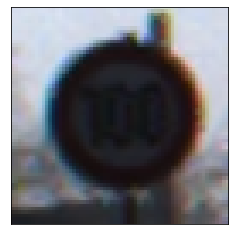

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


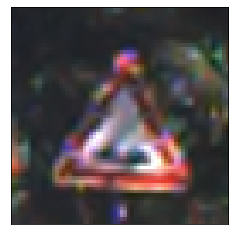

Original label:Speed limit (120km/h), Prediction :Speed limit (60km/h), confidence : 0.997


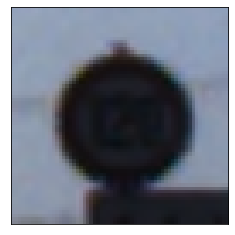

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


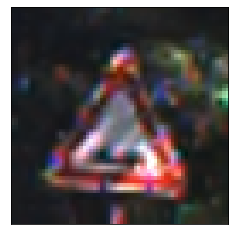

Original label:Ahead only, Prediction :Turn right ahead, confidence : 0.472


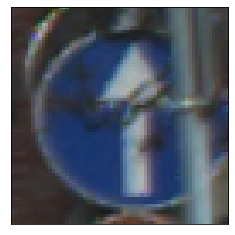

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.990


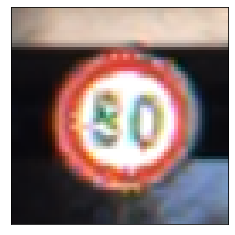

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.995


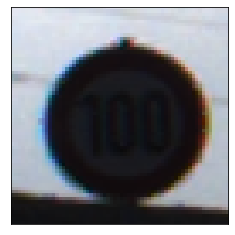

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.998


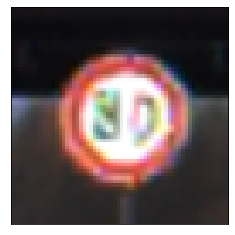

Original label:Speed limit (50km/h), Prediction :Speed limit (30km/h), confidence : 0.949


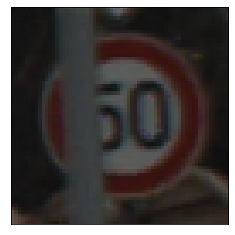

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.683


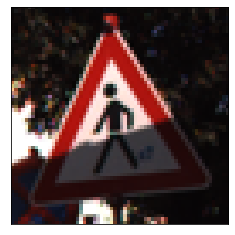

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.866


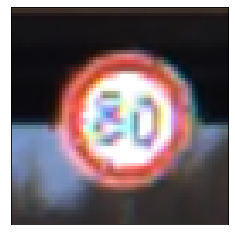

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.872


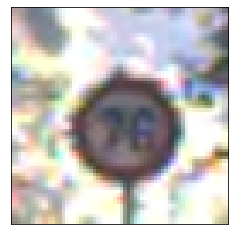

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.575


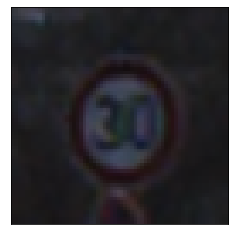

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.906


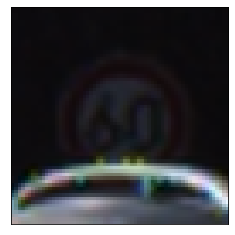

Original label:Speed limit (100km/h), Prediction :Speed limit (80km/h), confidence : 0.987


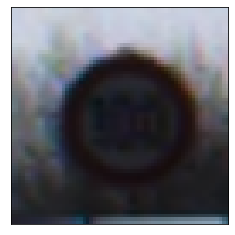

Original label:Priority road, Prediction :Yield, confidence : 1.000


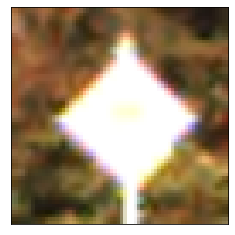

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.304


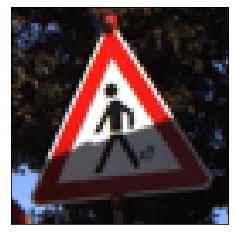

Original label:Roundabout mandatory, Prediction :Wild animals crossing, confidence : 0.279


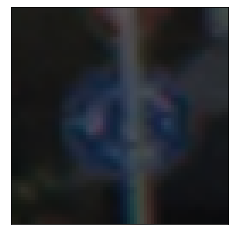

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.979


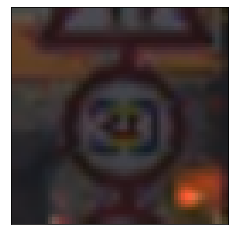

Original label:General caution, Prediction :Traffic signals, confidence : 1.000


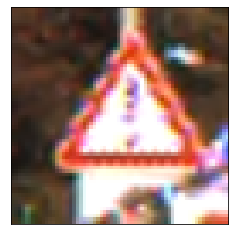

Original label:Speed limit (120km/h), Prediction :Speed limit (60km/h), confidence : 0.931


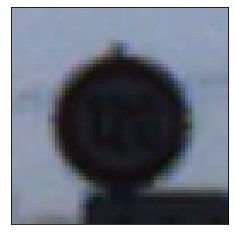

Original label:Ahead only, Prediction :Speed limit (60km/h), confidence : 0.788


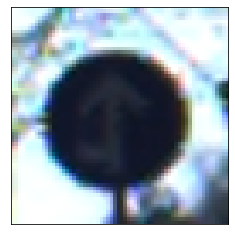

Original label:Ahead only, Prediction :Speed limit (60km/h), confidence : 0.306


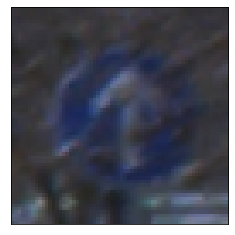

Original label:Speed limit (120km/h), Prediction :Speed limit (60km/h), confidence : 0.956


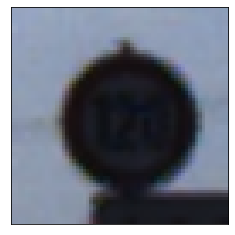

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.514


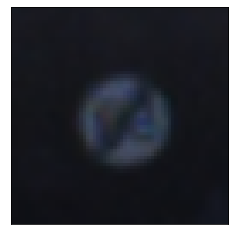

Original label:Speed limit (80km/h), Prediction :Speed limit (30km/h), confidence : 0.996


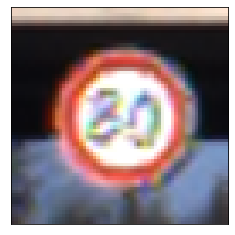

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.797


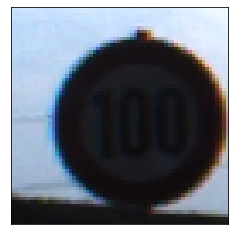

Original label:Speed limit (80km/h), Prediction :Speed limit (120km/h), confidence : 0.995


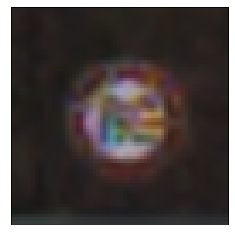

Original label:Bumpy road, Prediction :Road work, confidence : 0.999


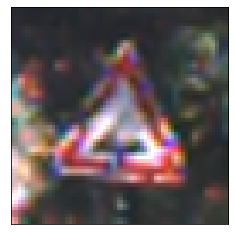

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.659


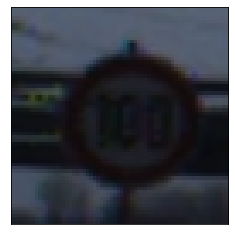

Original label:Priority road, Prediction :Yield, confidence : 1.000


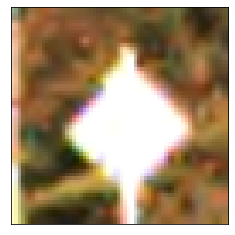

Original label:Speed limit (50km/h), Prediction :Speed limit (60km/h), confidence : 0.537


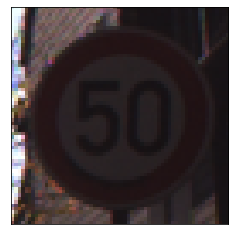

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


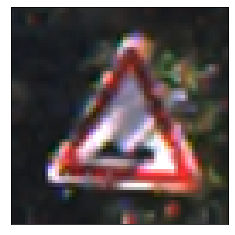

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.924


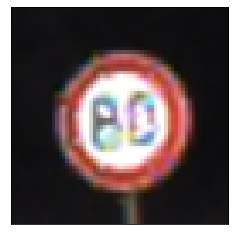

Original label:General caution, Prediction :Dangerous curve right, confidence : 0.994


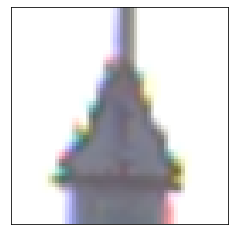

Original label:End of speed limit (80km/h), Prediction :Road work, confidence : 0.278


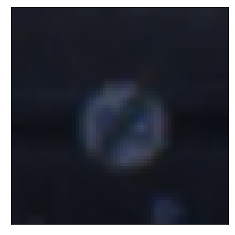

Original label:Road work, Prediction :Right-of-way at intersection, confidence : 0.505


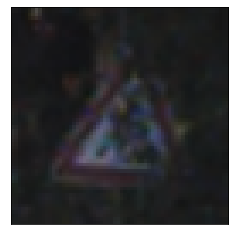

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 0.999


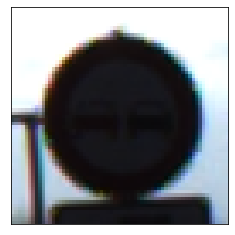

Original label:Pedestrians, Prediction :Dangerous curve right, confidence : 0.676


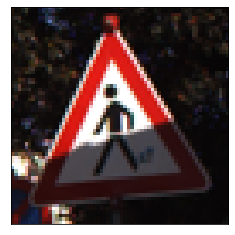

Original label:Speed limit (120km/h), Prediction :Speed limit (70km/h), confidence : 1.000


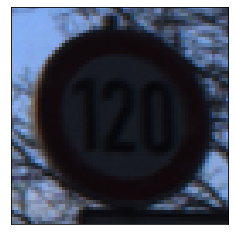

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 1.000


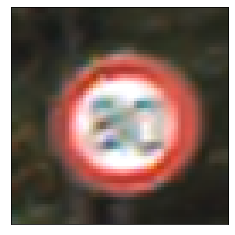

Original label:General caution, Prediction :Right-of-way at intersection, confidence : 0.350


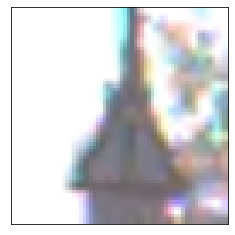

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.707


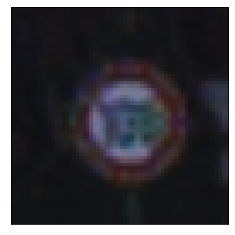

Original label:End of speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.325


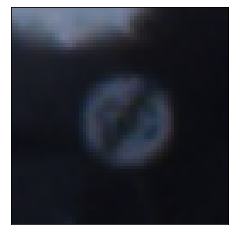

Original label:Beware of ice/snow, Prediction :Slippery road, confidence : 0.591


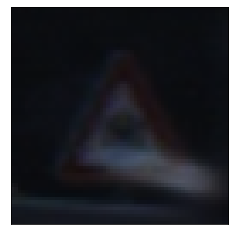

Original label:Ahead only, Prediction :No vehicles, confidence : 0.926


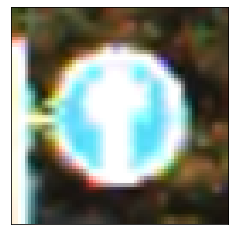

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.996


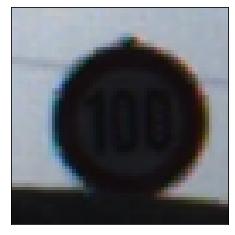

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.979


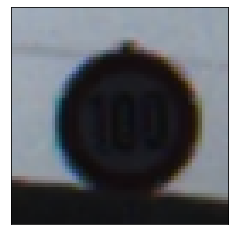

Original label:Beware of ice/snow, Prediction :Right-of-way at intersection, confidence : 0.536


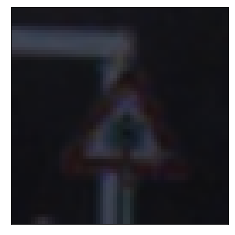

Original label:Speed limit (50km/h), Prediction :Speed limit (60km/h), confidence : 0.856


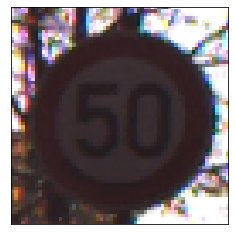

Original label:General caution, Prediction :Traffic signals, confidence : 0.999


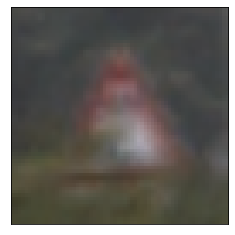

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.997


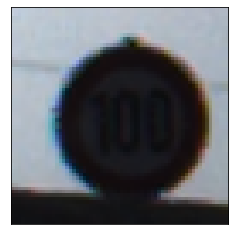

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.999


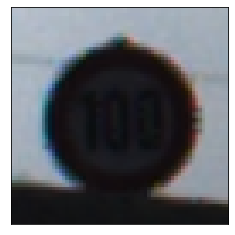

Original label:Pedestrians, Prediction :Dangerous curve right, confidence : 0.292


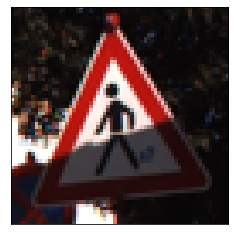

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


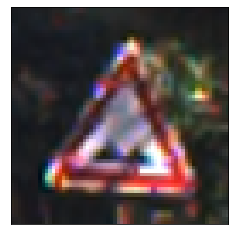

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.841


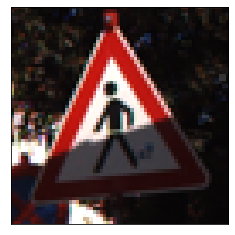

Original label:Ahead only, Prediction :No vehicles, confidence : 0.295


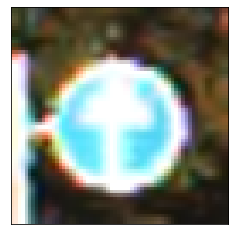

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 1.000


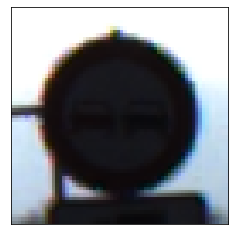

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 0.833


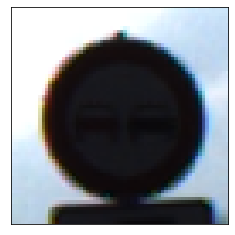

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.998


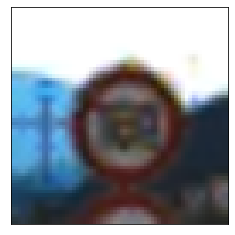

Original label:Keep right, Prediction :Go straight or right, confidence : 0.999


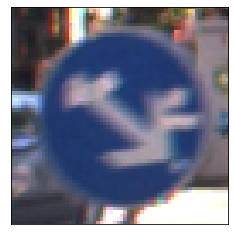

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 0.870


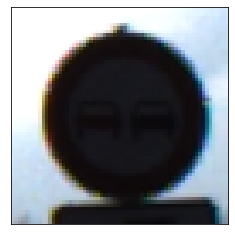

Original label:Speed limit (50km/h), Prediction :Speed limit (70km/h), confidence : 1.000


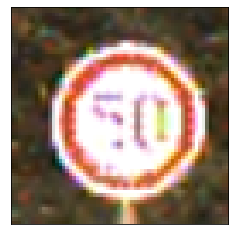

Original label:Keep right, Prediction :Turn left ahead, confidence : 0.868


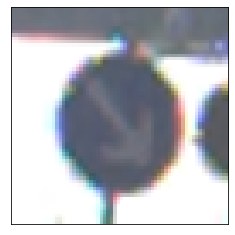

Original label:Ahead only, Prediction :No vehicles, confidence : 1.000


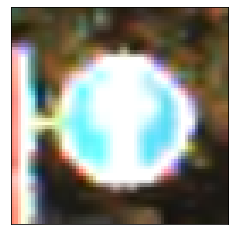

Original label:End of speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.639


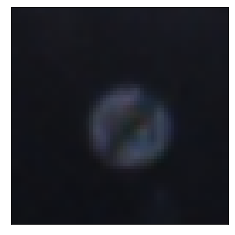

Original label:Roundabout mandatory, Prediction :Turn left ahead, confidence : 0.435


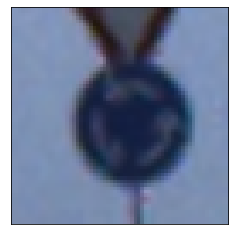

Original label:Keep right, Prediction :End speed + passing limits, confidence : 0.356


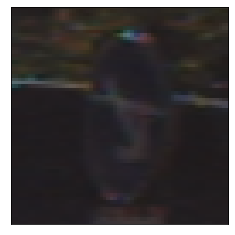

Original label:General caution, Prediction :Wild animals crossing, confidence : 0.986


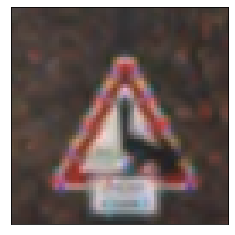

Original label:Roundabout mandatory, Prediction :Turn left ahead, confidence : 0.192


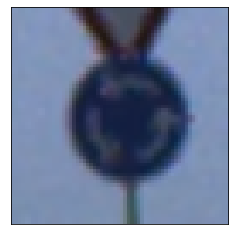

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.282


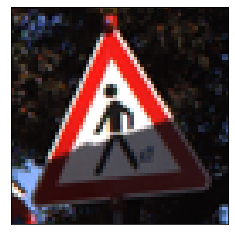

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.953


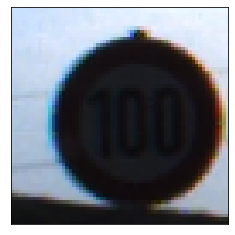

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.419


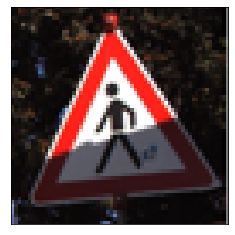

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.480


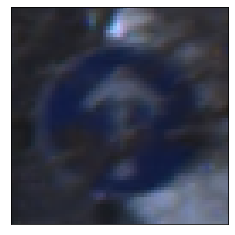

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.682


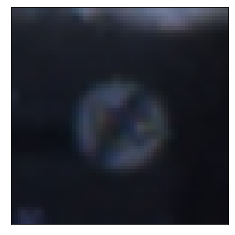

Original label:General caution, Prediction :Wild animals crossing, confidence : 1.000


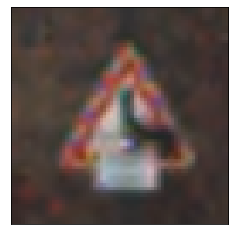

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.982


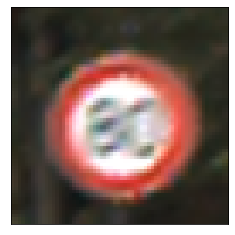

Original label:No entry, Prediction :No passing, confidence : 1.000


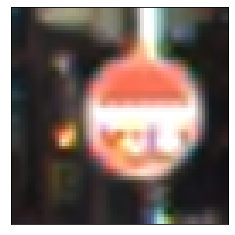

Original label:Roundabout mandatory, Prediction :Turn left ahead, confidence : 0.715


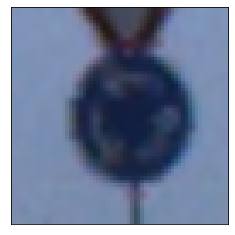

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.684


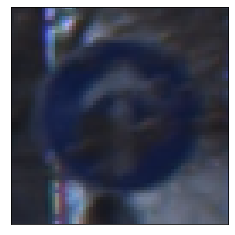

Original label:End of speed limit (80km/h), Prediction :Wild animals crossing, confidence : 0.424


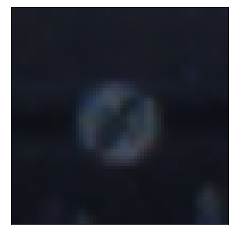

Original label:Pedestrians, Prediction :Right-of-way at intersection, confidence : 0.231


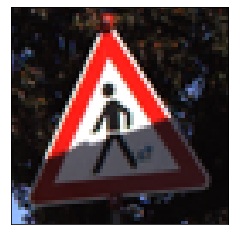

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.998


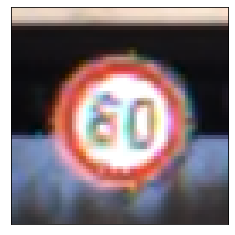

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.893


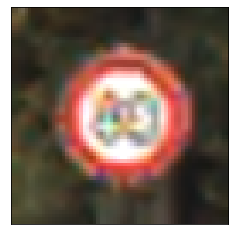

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.984


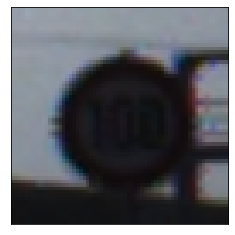

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.672


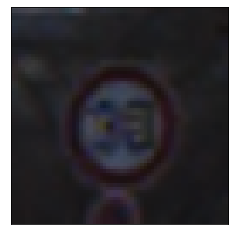

Original label:End of speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.474


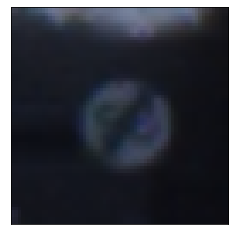

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.993


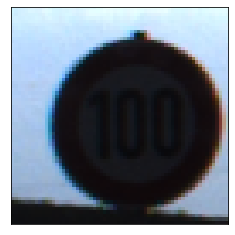

Original label:Pedestrians, Prediction :General caution, confidence : 0.479


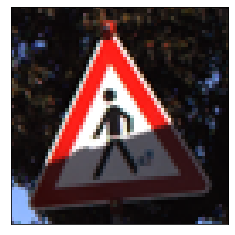

Original label:Right-of-way at intersection, Prediction :Pedestrians, confidence : 0.520


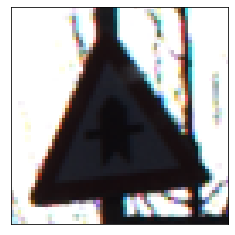

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 1.000


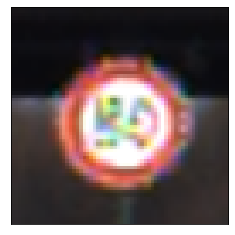

Original label:End of speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.520


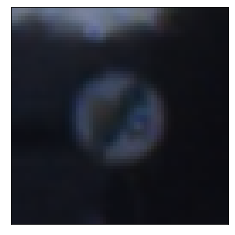

Original label:General caution, Prediction :Pedestrians, confidence : 0.993


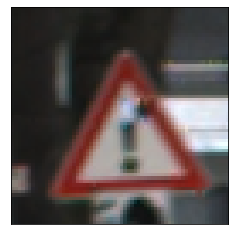

Original label:Bumpy road, Prediction :Bicycles crossing, confidence : 0.592


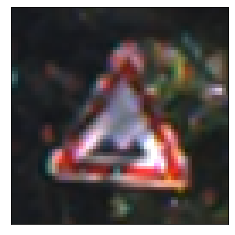

Original label:Keep right, Prediction :Go straight or right, confidence : 0.989


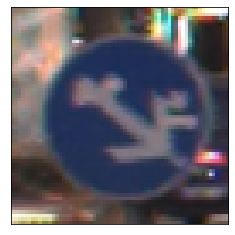

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


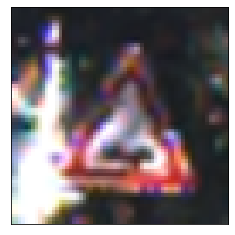

Original label:Ahead only, Prediction :Speed limit (60km/h), confidence : 0.426


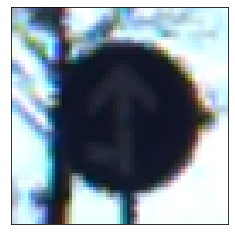

Original label:Speed limit (120km/h), Prediction :Speed limit (70km/h), confidence : 0.775


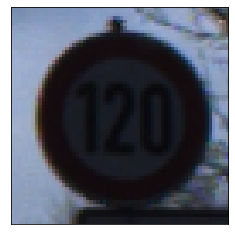

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 0.958


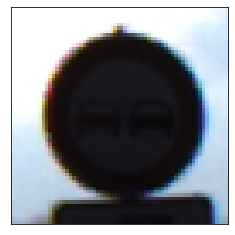

Original label:End of no passing, Prediction :No passing, confidence : 0.873


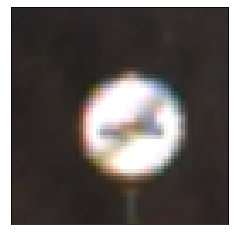

Original label:End of speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.615


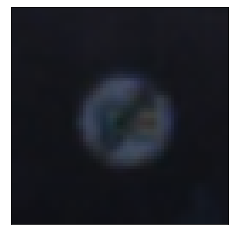

Original label:Keep right, Prediction :Yield, confidence : 0.999


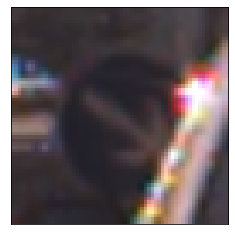

Original label:Ahead only, Prediction :Speed limit (60km/h), confidence : 0.719


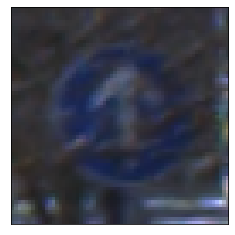

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.980


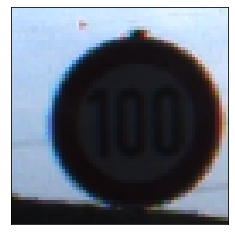

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.997


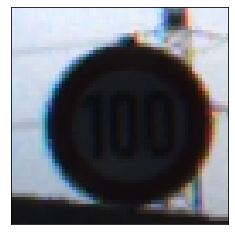

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.891


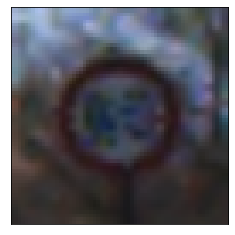

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.673


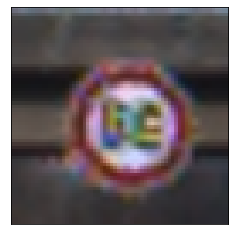

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.997


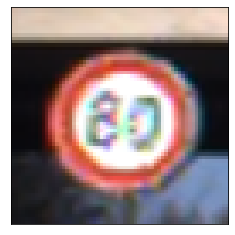

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.992


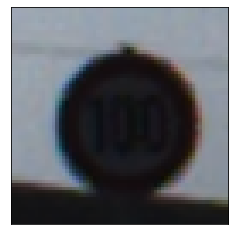

Original label:General caution, Prediction :Traffic signals, confidence : 0.984


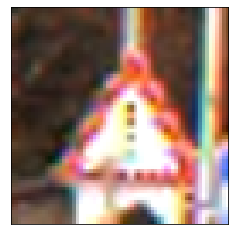

Original label:Speed limit (80km/h), Prediction :Speed limit (30km/h), confidence : 0.782


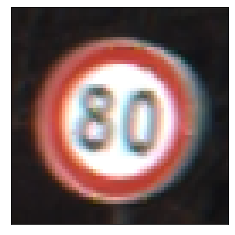

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 1.000


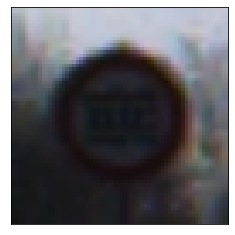

Original label:Keep right, Prediction :Go straight or left, confidence : 0.394


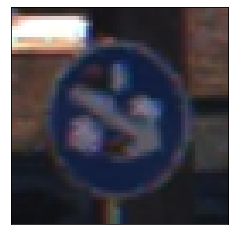

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.565


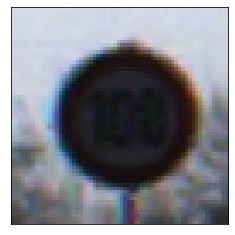

Original label:Ahead only, Prediction :Speed limit (60km/h), confidence : 0.388


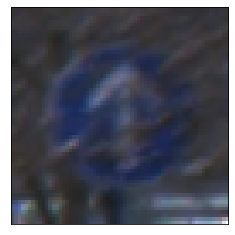

Original label:Speed limit (80km/h), Prediction :Speed limit (120km/h), confidence : 0.981


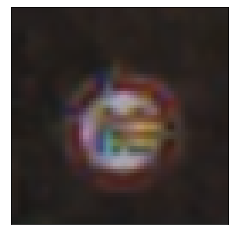

Original label:Speed limit (70km/h), Prediction :Speed limit (20km/h), confidence : 0.774


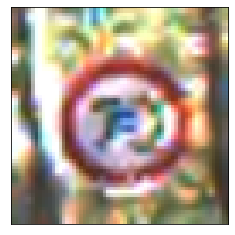

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.990


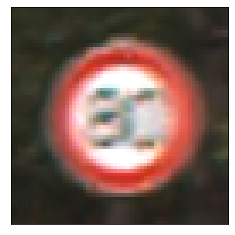

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 0.995


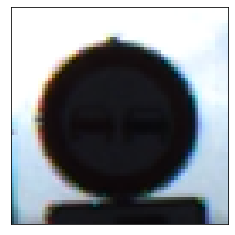

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


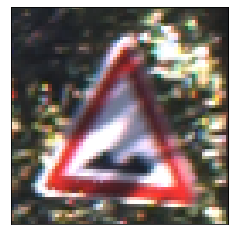

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.983


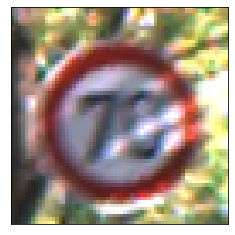

Original label:General caution, Prediction :Wild animals crossing, confidence : 0.568


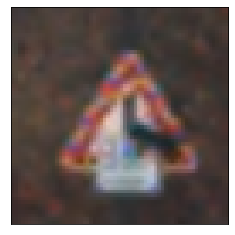

Original label:Speed limit (80km/h), Prediction :Speed limit (120km/h), confidence : 0.616


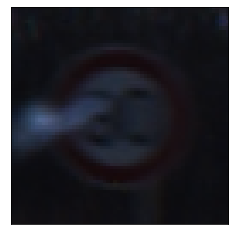

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.747


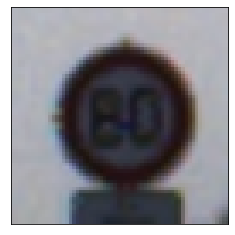

Original label:Speed limit (100km/h), Prediction :Speed limit (60km/h), confidence : 0.549


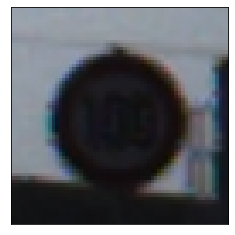

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.999


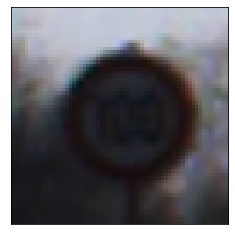

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


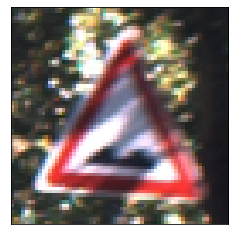

Original label:Speed limit (80km/h), Prediction :Speed limit (120km/h), confidence : 0.542


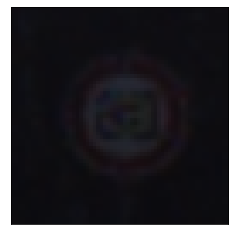

Original label:Keep right, Prediction :Go straight or right, confidence : 1.000


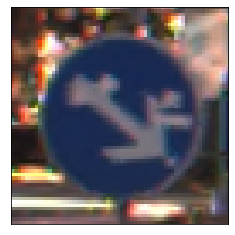

Original label:General caution, Prediction :Wild animals crossing, confidence : 1.000


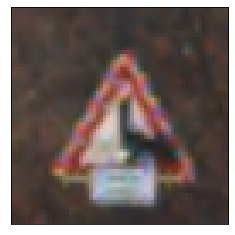

Original label:Pedestrians, Prediction :Dangerous curve right, confidence : 0.415


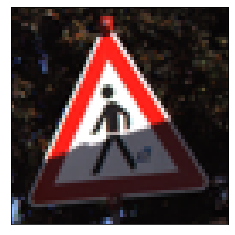

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.720


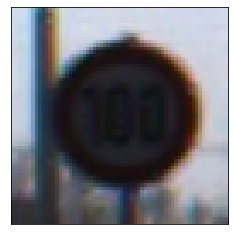

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.346


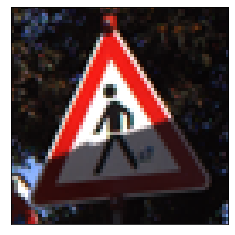

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.771


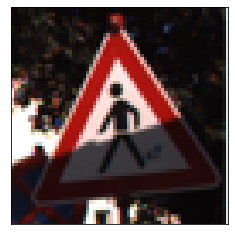

Original label:Speed limit (70km/h), Prediction :Speed limit (100km/h), confidence : 0.698


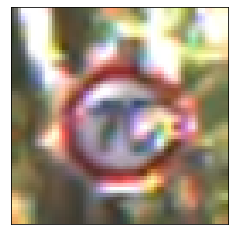

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.989


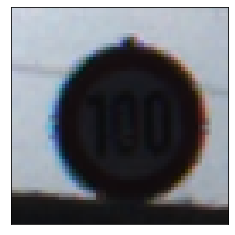

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 0.808


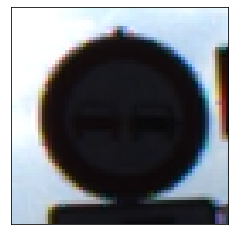

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.905


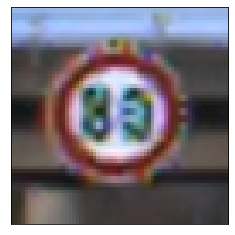

Original label:Speed limit (70km/h), Prediction :Speed limit (60km/h), confidence : 0.949


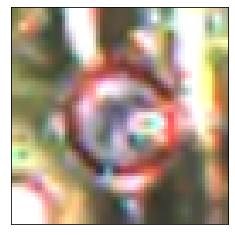

Original label:Speed limit (50km/h), Prediction :Speed limit (30km/h), confidence : 0.806


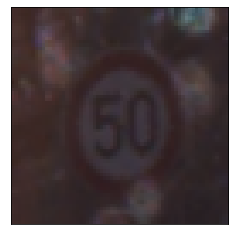

Original label:Pedestrians, Prediction :Dangerous curve right, confidence : 0.460


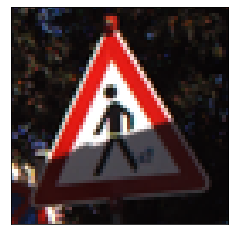

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.983


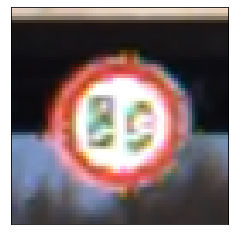

Original label:Speed limit (80km/h), Prediction :No passing veh over 3.5 tons, confidence : 0.967


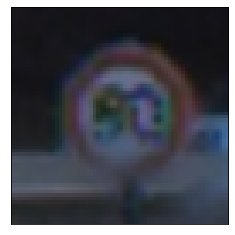

Original label:Speed limit (50km/h), Prediction :Speed limit (60km/h), confidence : 0.715


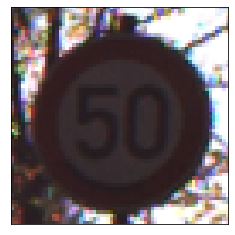

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


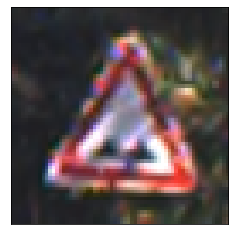

Original label:Beware of ice/snow, Prediction :Children crossing, confidence : 0.982


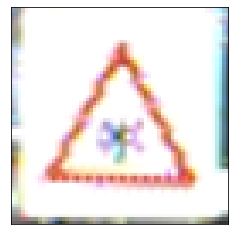

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.755


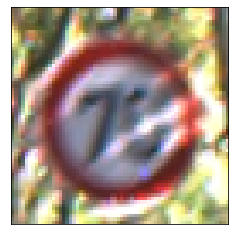

Original label:Bumpy road, Prediction :Bicycles crossing, confidence : 0.479


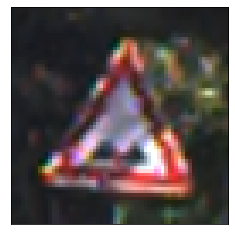

Original label:Speed limit (80km/h), Prediction :Speed limit (120km/h), confidence : 0.893


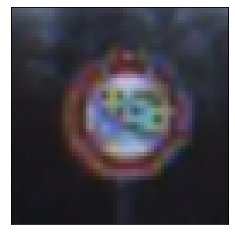

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 1.000


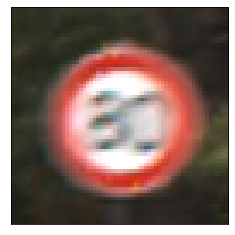

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


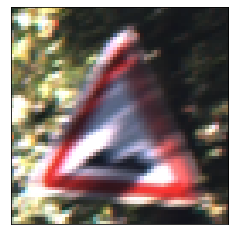

Original label:Speed limit (50km/h), Prediction :Speed limit (60km/h), confidence : 0.559


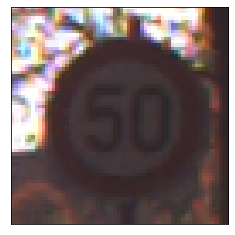

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.751


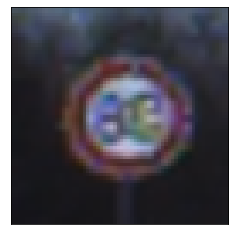

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.772


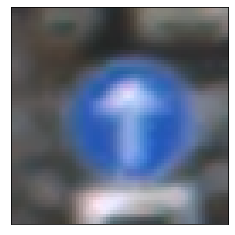

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.961


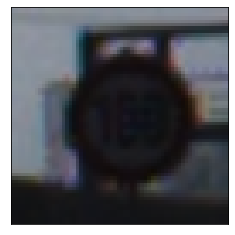

Original label:Speed limit (70km/h), Prediction :Speed limit (30km/h), confidence : 0.452


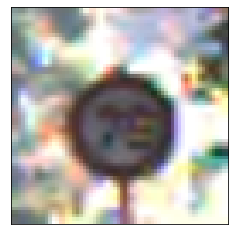

Original label:Road work, Prediction :General caution, confidence : 1.000


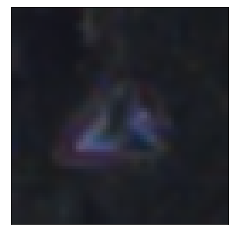

Original label:Speed limit (50km/h), Prediction :Speed limit (30km/h), confidence : 0.923


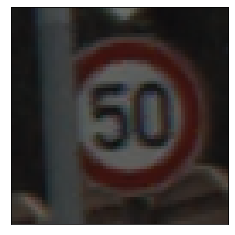

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.992


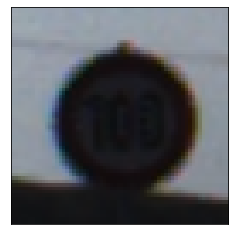

Original label:Beware of ice/snow, Prediction :Right-of-way at intersection, confidence : 0.998


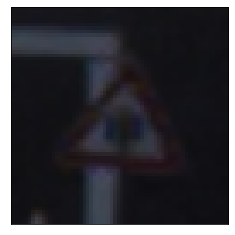

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.887


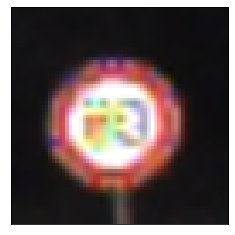

Original label:End of speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.613


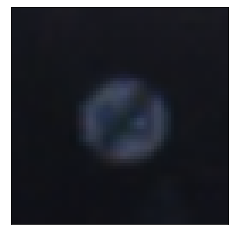

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.972


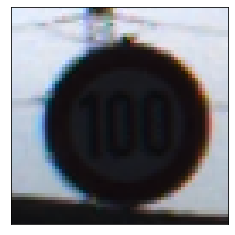

Original label:General caution, Prediction :Traffic signals, confidence : 0.969


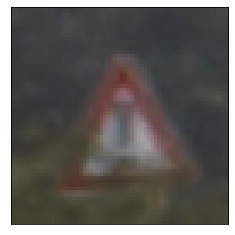

Original label:Bumpy road, Prediction :Bicycles crossing, confidence : 0.386


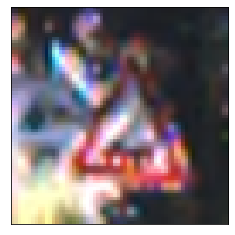

Original label:Speed limit (70km/h), Prediction :Speed limit (80km/h), confidence : 0.451


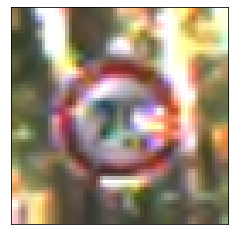

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.992


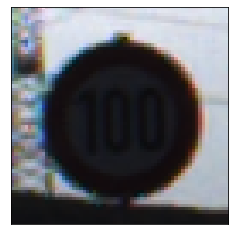

Original label:Speed limit (70km/h), Prediction :Speed limit (50km/h), confidence : 0.605


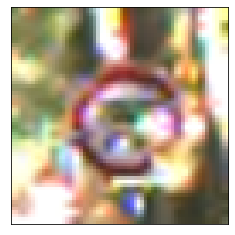

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.908


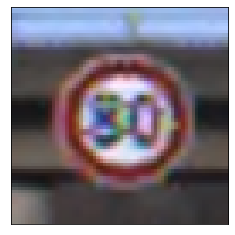

Original label:General caution, Prediction :Wild animals crossing, confidence : 1.000


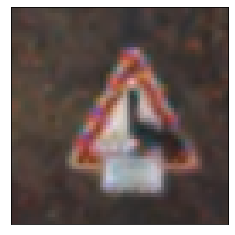

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.956


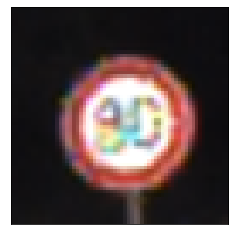

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.950


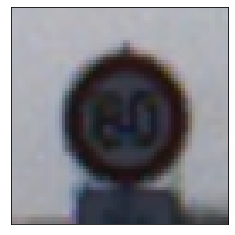

Original label:General caution, Prediction :Wild animals crossing, confidence : 0.989


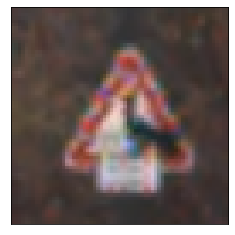

Original label:Keep right, Prediction :Turn left ahead, confidence : 0.694


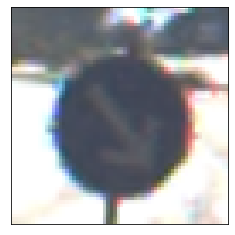

Original label:Roundabout mandatory, Prediction :Go straight or right, confidence : 0.994


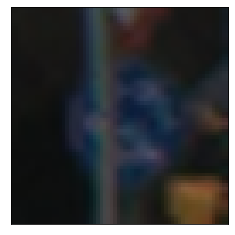

Original label:Road narrows on the right, Prediction :Priority road, confidence : 0.467


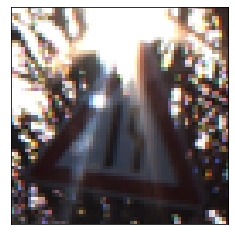

Original label:General caution, Prediction :Dangerous curve right, confidence : 0.981


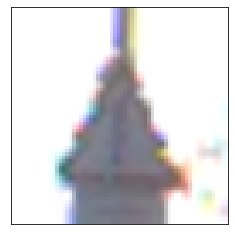

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.936


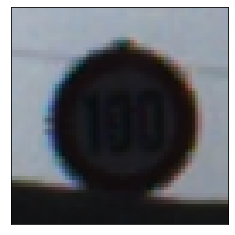

Original label:General caution, Prediction :Dangerous curve right, confidence : 0.699


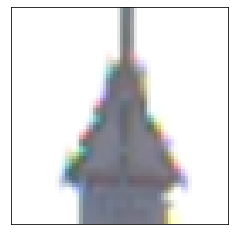

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.998


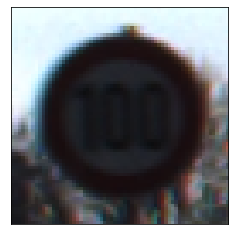

Original label:General caution, Prediction :Pedestrians, confidence : 0.698


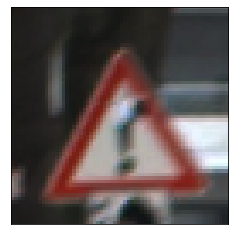

Original label:General caution, Prediction :Pedestrians, confidence : 0.633


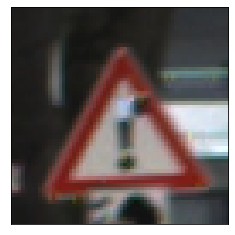

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.999


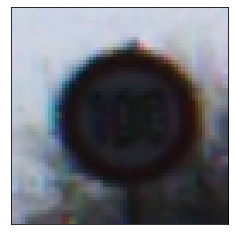

Original label:Keep left, Prediction :End speed + passing limits, confidence : 0.497


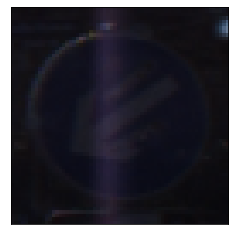

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.837


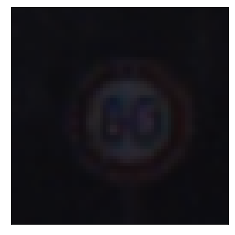

Original label:General caution, Prediction :Wild animals crossing, confidence : 1.000


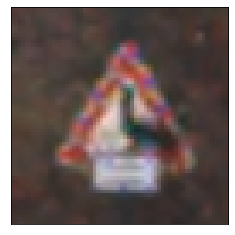

Original label:Speed limit (20km/h), Prediction :Speed limit (120km/h), confidence : 0.427


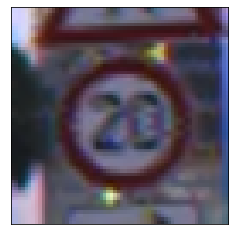

Original label:Speed limit (80km/h), Prediction :Speed limit (30km/h), confidence : 0.518


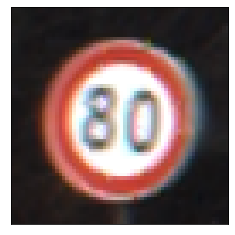

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.798


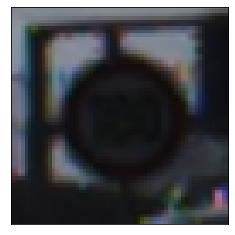

Original label:Speed limit (50km/h), Prediction :Speed limit (30km/h), confidence : 0.997


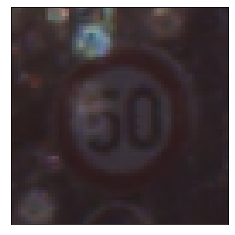

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.668


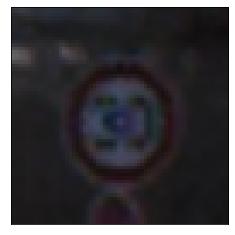

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.718


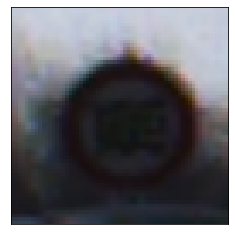

Original label:Keep right, Prediction :Go straight or right, confidence : 1.000


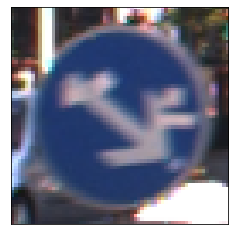

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.990


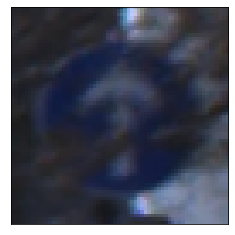

Original label:Keep right, Prediction :Turn left ahead, confidence : 0.564


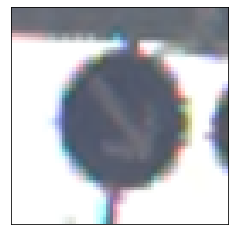

Original label:Priority road, Prediction :Yield, confidence : 1.000


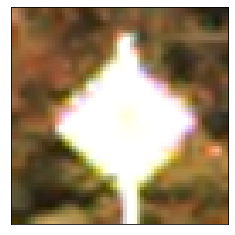

Original label:Speed limit (120km/h), Prediction :Speed limit (70km/h), confidence : 0.981


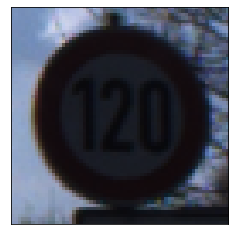

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


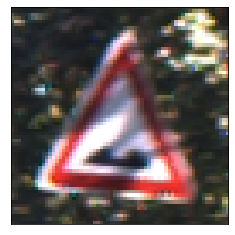

Original label:Ahead only, Prediction :No vehicles, confidence : 0.423


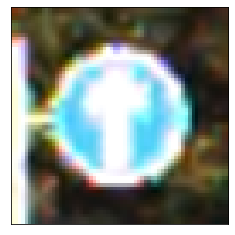

Original label:Beware of ice/snow, Prediction :Right-of-way at intersection, confidence : 1.000


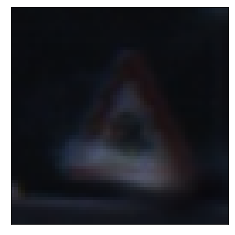

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.905


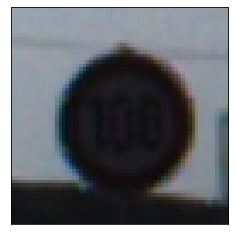

Original label:Keep right, Prediction :Go straight or right, confidence : 1.000


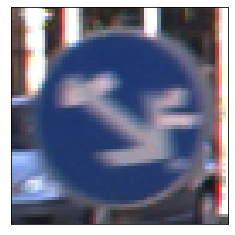

Original label:Roundabout mandatory, Prediction :Turn left ahead, confidence : 0.509


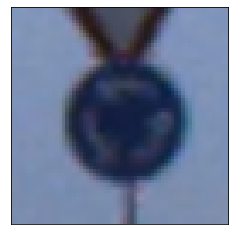

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.985


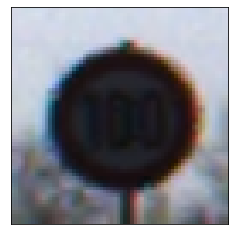

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.987


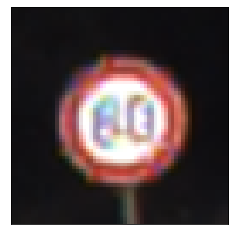

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.298


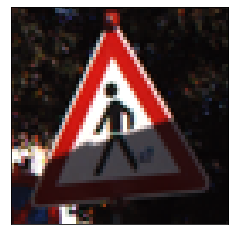

Original label:Pedestrians, Prediction :Dangerous curve right, confidence : 0.255


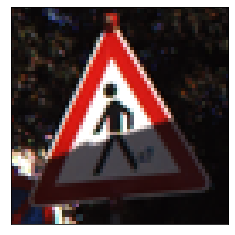

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.508


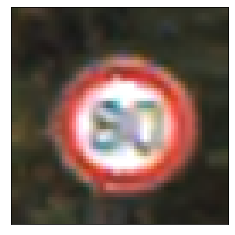

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 1.000


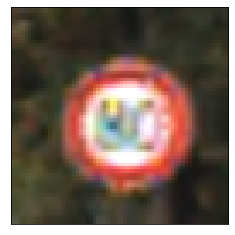

Original label:Roundabout mandatory, Prediction :Turn left ahead, confidence : 0.751


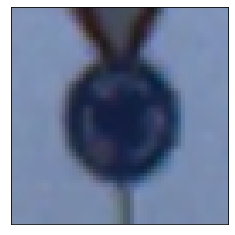

Original label:General caution, Prediction :Road work, confidence : 0.758


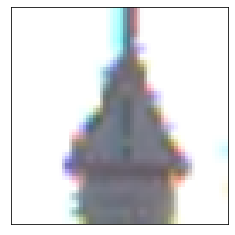

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.907


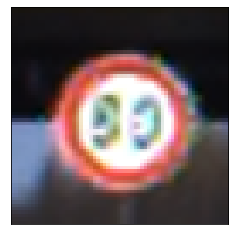

Original label:Priority road, Prediction :Yield, confidence : 1.000


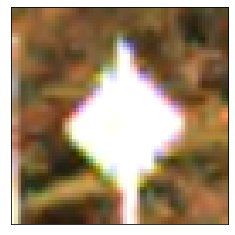

Original label:Pedestrians, Prediction :Dangerous curve right, confidence : 0.543


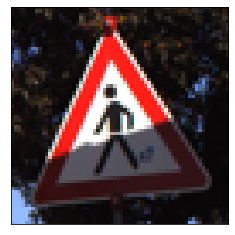

Original label:Speed limit (70km/h), Prediction :Speed limit (20km/h), confidence : 0.910


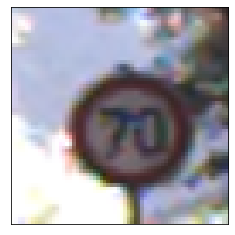

Original label:End of speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.629


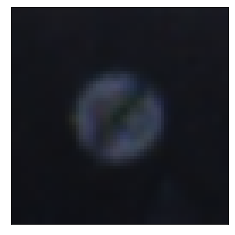

Original label:General caution, Prediction :Ahead only, confidence : 0.275


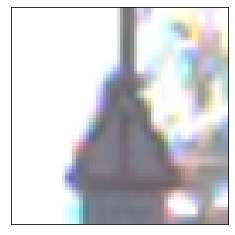

Original label:Speed limit (100km/h), Prediction :Speed limit (60km/h), confidence : 0.760


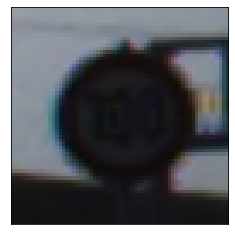

Original label:Speed limit (120km/h), Prediction :Speed limit (70km/h), confidence : 1.000


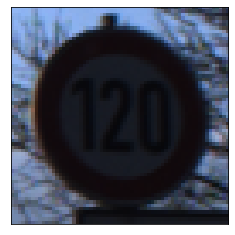

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.418


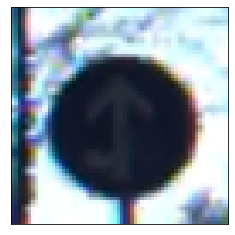

Original label:Keep right, Prediction :Go straight or right, confidence : 0.514


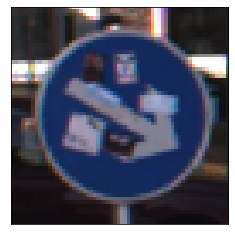

Original label:Roundabout mandatory, Prediction :Keep right, confidence : 0.382


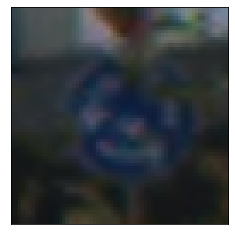

Original label:Traffic signals, Prediction :Road work, confidence : 0.653


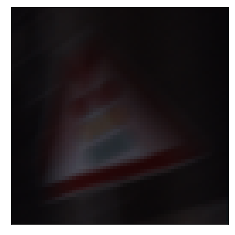

Original label:Ahead only, Prediction :No vehicles, confidence : 0.980


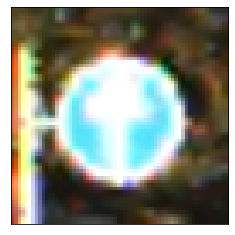

Original label:Keep right, Prediction :Go straight or right, confidence : 0.996


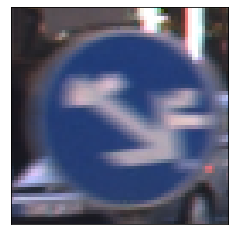

Original label:Roundabout mandatory, Prediction :Turn left ahead, confidence : 0.820


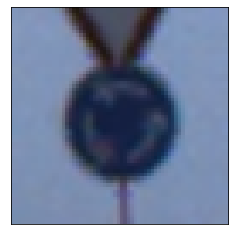

Original label:Speed limit (20km/h), Prediction :Speed limit (120km/h), confidence : 0.965


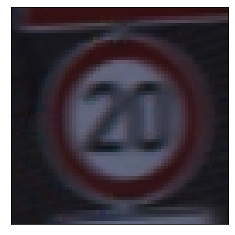

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.618


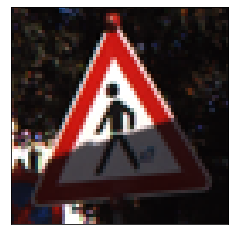

Original label:Speed limit (70km/h), Prediction :No passing, confidence : 0.581


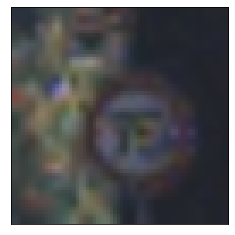

Original label:Speed limit (70km/h), Prediction :Road work, confidence : 1.000


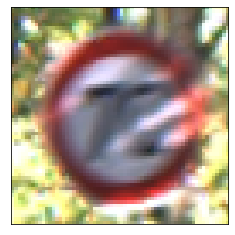

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.999


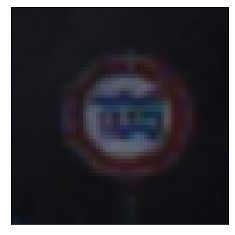

Original label:No entry, Prediction :No passing, confidence : 1.000


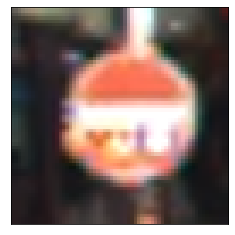

Original label:Pedestrians, Prediction :Dangerous curve right, confidence : 0.290


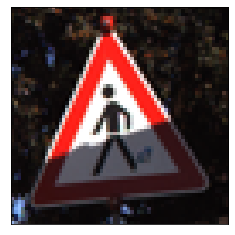

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 1.000


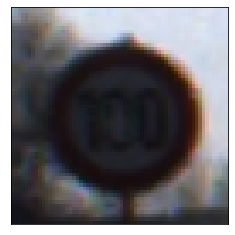

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 1.000


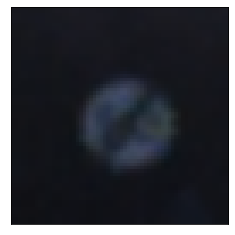

Original label:Wild animals crossing, Prediction :Dangerous curve right, confidence : 1.000


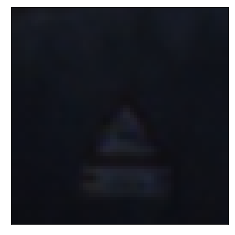

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.981


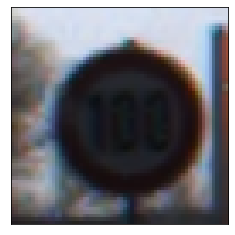

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.900


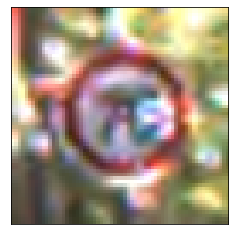

Original label:Speed limit (70km/h), Prediction :Road work, confidence : 0.996


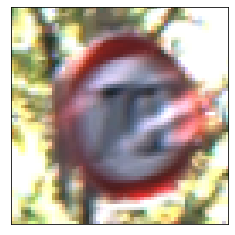

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.351


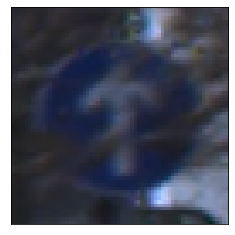

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.631


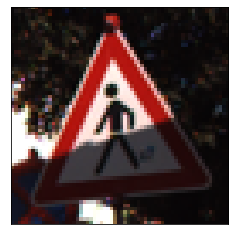

Original label:Road work, Prediction :Wild animals crossing, confidence : 0.440


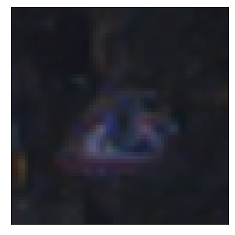

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.996


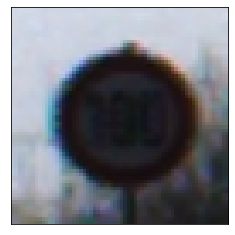

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 0.883


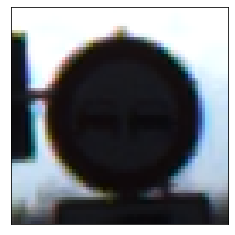

Original label:Pedestrians, Prediction :Dangerous curve right, confidence : 0.280


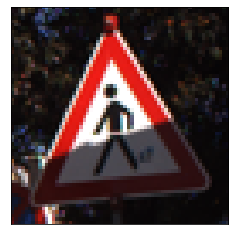

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.979


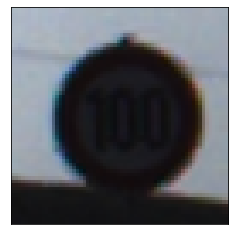

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.239


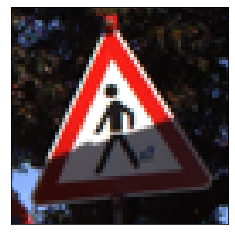

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.998


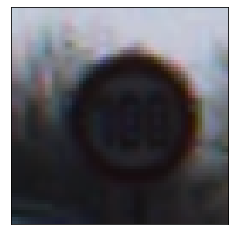

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.258


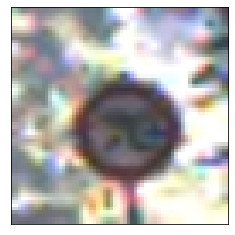

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.986


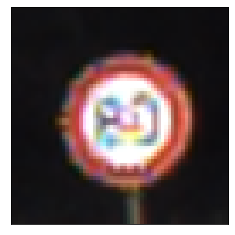

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.987


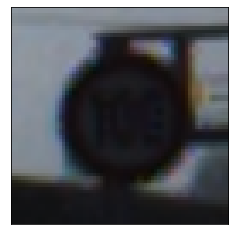

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 0.700


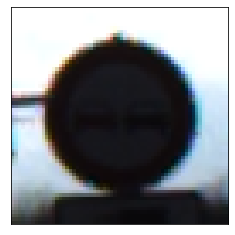

Original label:Ahead only, Prediction :Go straight or right, confidence : 0.271


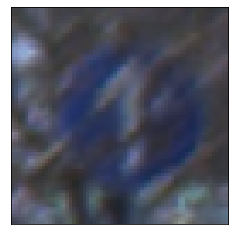

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.861


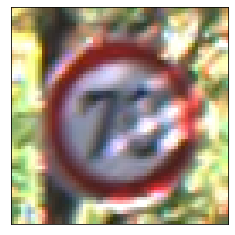

Original label:Traffic signals, Prediction :Road work, confidence : 0.510


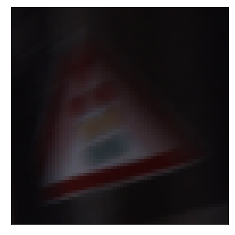

Original label:Children crossing, Prediction :Slippery road, confidence : 1.000


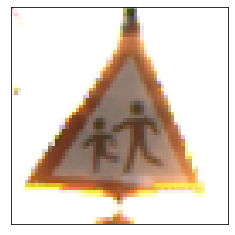

Original label:Speed limit (60km/h), Prediction :No passing veh over 3.5 tons, confidence : 0.996


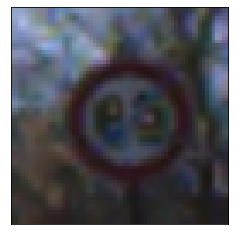

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 1.000


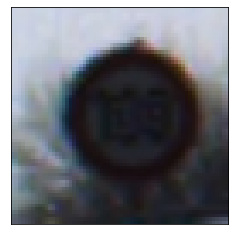

Original label:Speed limit (70km/h), Prediction :Speed limit (30km/h), confidence : 0.914


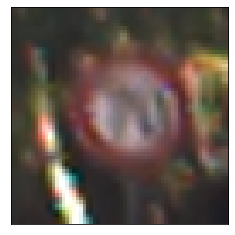

Original label:Ahead only, Prediction :Speed limit (60km/h), confidence : 0.435


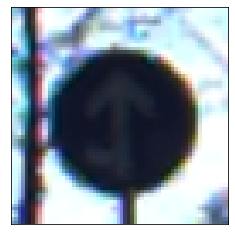

Original label:Pedestrians, Prediction :Right-of-way at intersection, confidence : 0.320


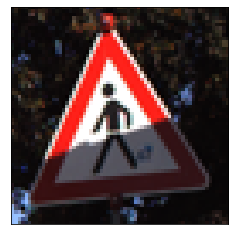

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.989


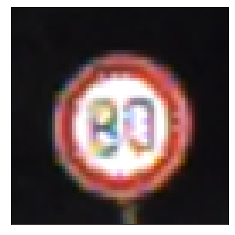

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.834


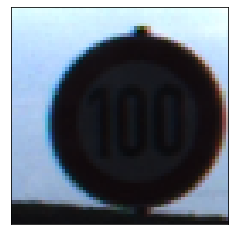

Original label:Slippery road, Prediction :Dangerous curve right, confidence : 1.000


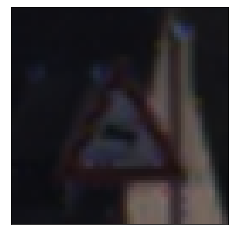

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 1.000


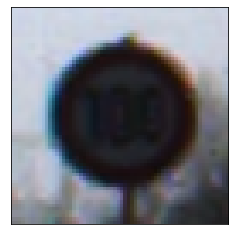

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


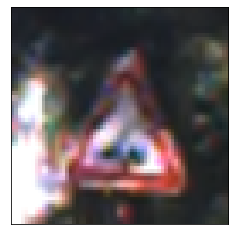

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 0.628


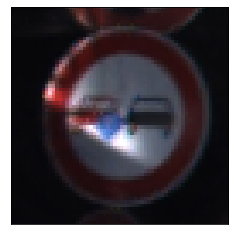

Original label:Speed limit (60km/h), Prediction :Speed limit (50km/h), confidence : 0.959


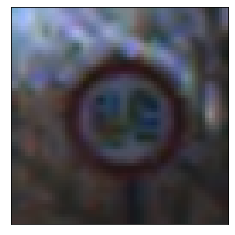

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.985


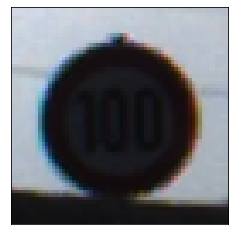

Original label:Ahead only, Prediction :No vehicles, confidence : 0.329


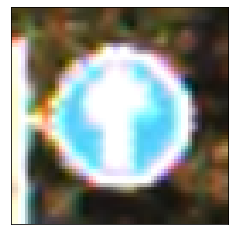

Original label:Go straight or left, Prediction :Road work, confidence : 0.303


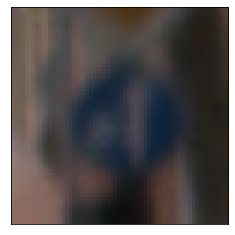

Original label:Roundabout mandatory, Prediction :Wild animals crossing, confidence : 0.216


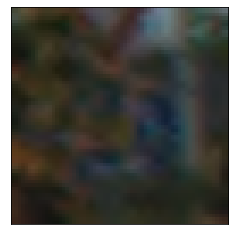

Original label:General caution, Prediction :Wild animals crossing, confidence : 1.000


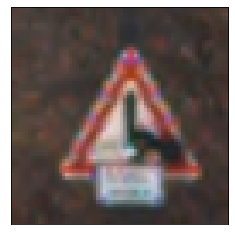

Original label:End of speed limit (80km/h), Prediction :Wild animals crossing, confidence : 0.808


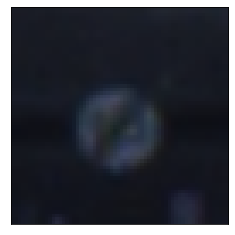

Original label:Speed limit (50km/h), Prediction :Speed limit (60km/h), confidence : 0.858


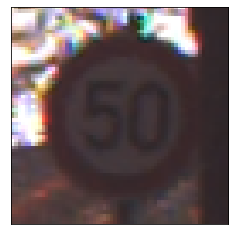

Original label:Speed limit (70km/h), Prediction :Turn right ahead, confidence : 0.999


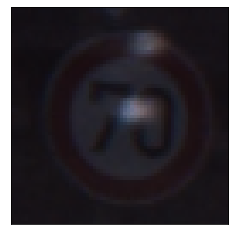

Original label:Speed limit (100km/h), Prediction :Speed limit (80km/h), confidence : 0.769


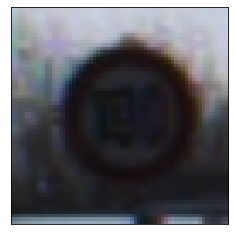

Original label:General caution, Prediction :Dangerous curve right, confidence : 0.672


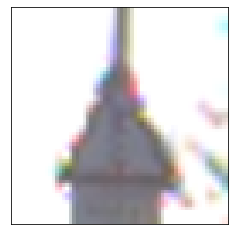

Original label:Ahead only, Prediction :Yield, confidence : 0.684


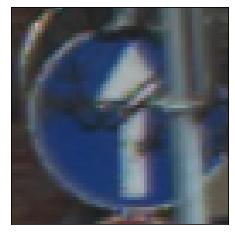

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.970


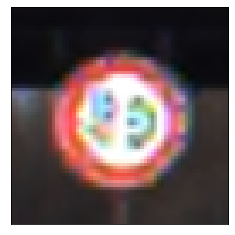

Original label:Keep right, Prediction :Go straight or right, confidence : 1.000


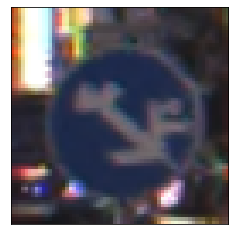

Original label:General caution, Prediction :Keep right, confidence : 0.211


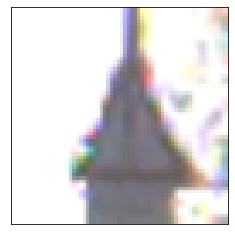

Original label:Pedestrians, Prediction :Dangerous curve right, confidence : 0.958


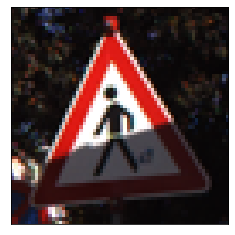

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.995


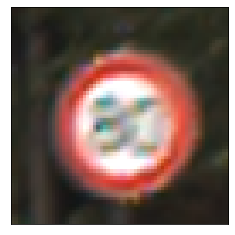

Original label:Pedestrians, Prediction :Dangerous curve right, confidence : 0.514


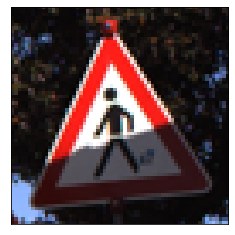

Original label:Keep right, Prediction :Go straight or right, confidence : 0.910


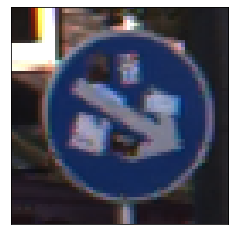

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.818


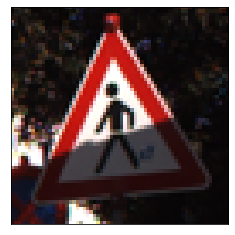

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.311


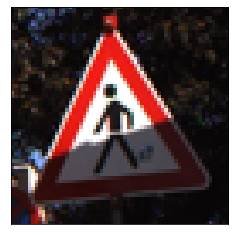

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.857


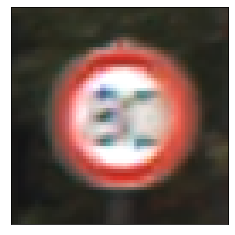

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.975


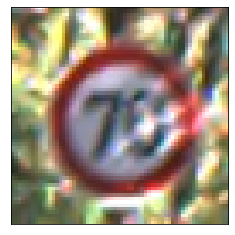

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.992


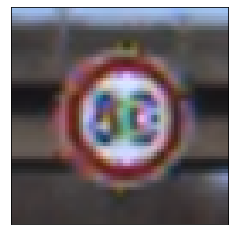

Original label:Speed limit (70km/h), Prediction :Speed limit (100km/h), confidence : 0.952


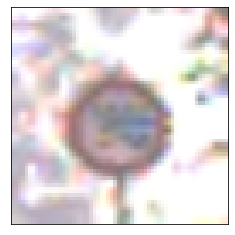

Original label:Keep right, Prediction :Go straight or right, confidence : 0.626


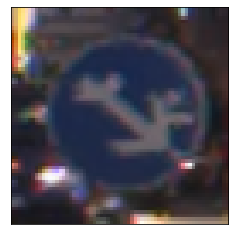

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.998


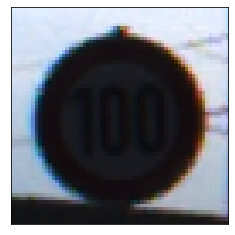

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 1.000


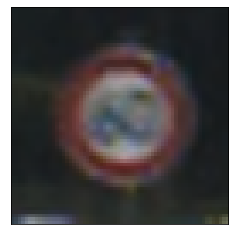

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.999


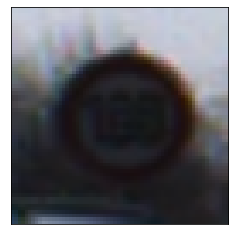

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.717


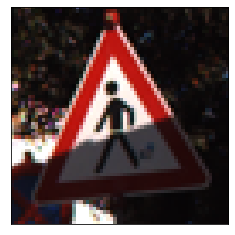

Original label:No vehicles, Prediction :Yield, confidence : 1.000


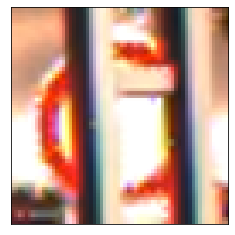

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.990


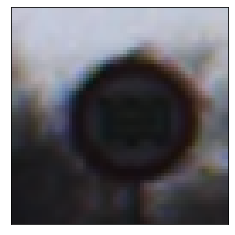

Original label:Priority road, Prediction :Yield, confidence : 1.000


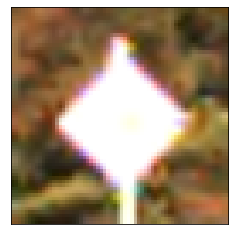

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.418


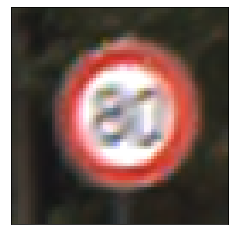

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


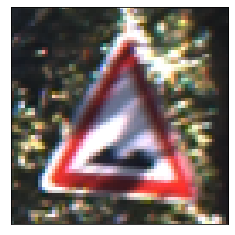

Original label:General caution, Prediction :Wild animals crossing, confidence : 1.000


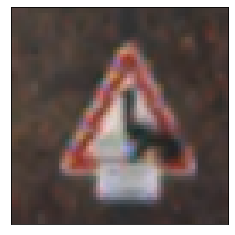

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.837


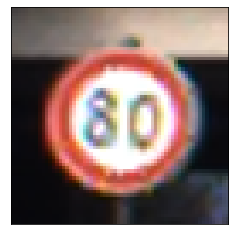

Original label:Priority road, Prediction :Yield, confidence : 1.000


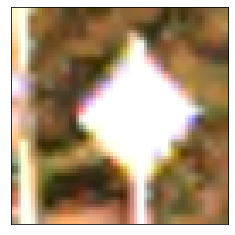

Original label:Speed limit (70km/h), Prediction :Road work, confidence : 1.000


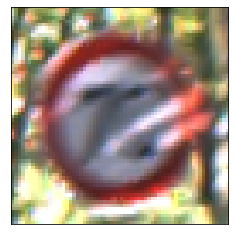

Original label:Keep right, Prediction :Go straight or right, confidence : 1.000


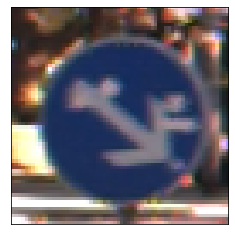

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.826


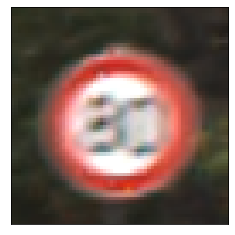

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.952


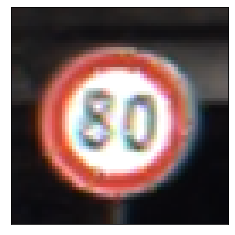

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.855


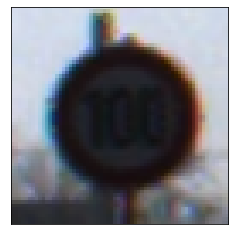

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.309


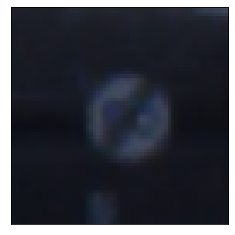

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


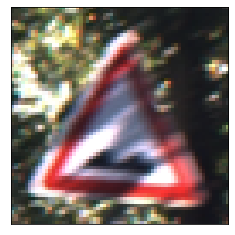

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.986


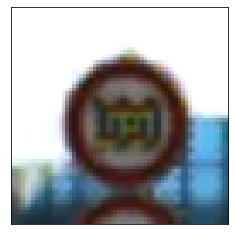

Original label:Pedestrians, Prediction :Traffic signals, confidence : 0.570


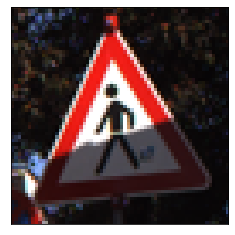

Original label:Wild animals crossing, Prediction :Dangerous curve right, confidence : 1.000


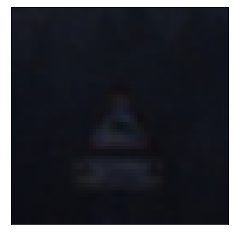

Original label:General caution, Prediction :Wild animals crossing, confidence : 1.000


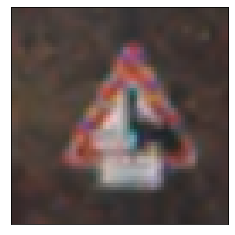

Original label:Speed limit (30km/h), Prediction :Speed limit (120km/h), confidence : 0.671


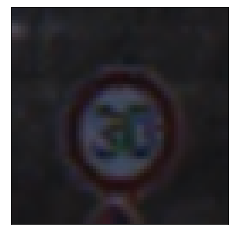

Original label:Slippery road, Prediction :Dangerous curve right, confidence : 0.636


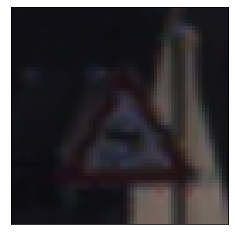

Original label:Priority road, Prediction :Yield, confidence : 1.000


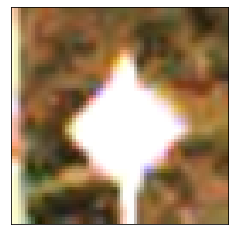

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.999


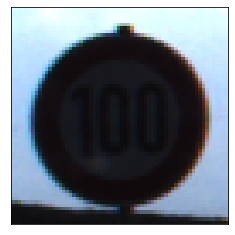

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.464


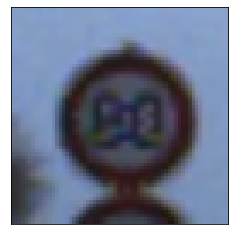

Original label:Speed limit (30km/h), Prediction :Speed limit (60km/h), confidence : 0.843


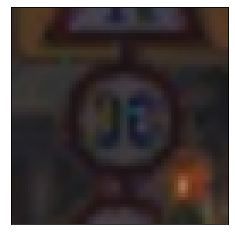

Original label:Beware of ice/snow, Prediction :Right-of-way at intersection, confidence : 1.000


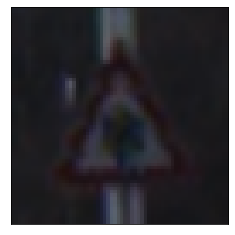

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 0.682


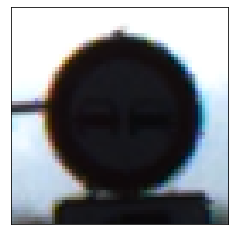

Original label:No entry, Prediction :No passing, confidence : 1.000


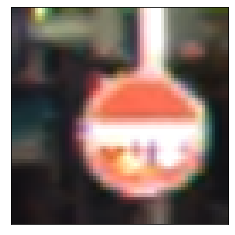

Original label:Speed limit (70km/h), Prediction :Road work, confidence : 1.000


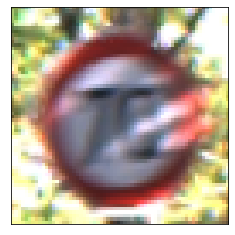

Original label:Pedestrians, Prediction :Dangerous curve right, confidence : 0.632


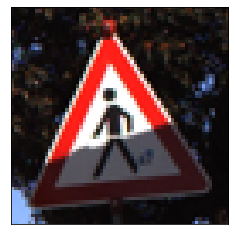

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.687


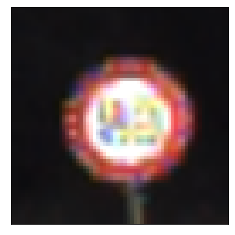

Original label:Speed limit (120km/h), Prediction :Speed limit (60km/h), confidence : 0.999


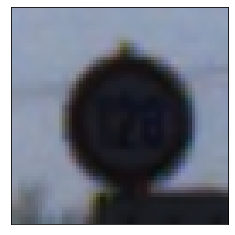

Original label:Speed limit (70km/h), Prediction :Road work, confidence : 1.000


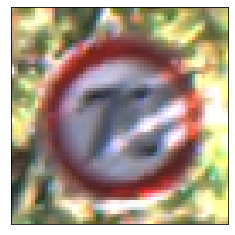

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


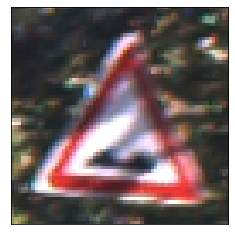

Original label:End of speed limit (80km/h), Prediction :Beware of ice/snow, confidence : 0.371


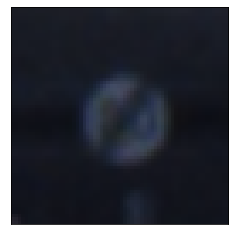

Original label:Keep right, Prediction :Go straight or right, confidence : 1.000


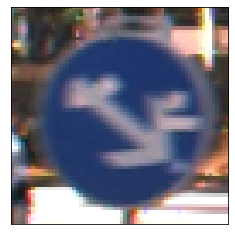

Original label:Speed limit (60km/h), Prediction :Turn right ahead, confidence : 0.492


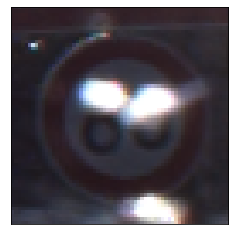

Original label:No passing, Prediction :Speed limit (60km/h), confidence : 0.858


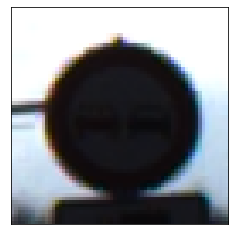

Original label:General caution, Prediction :Wild animals crossing, confidence : 1.000


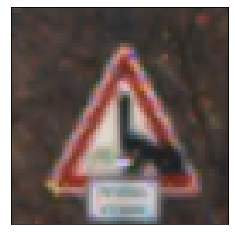

Original label:Road work, Prediction :Roundabout mandatory, confidence : 0.241


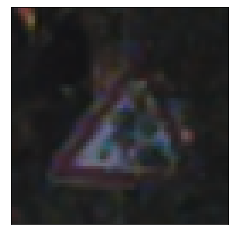

Original label:Speed limit (120km/h), Prediction :Speed limit (60km/h), confidence : 0.928


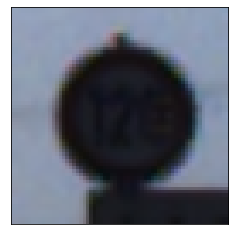

Original label:Speed limit (70km/h), Prediction :Dangerous curve right, confidence : 1.000


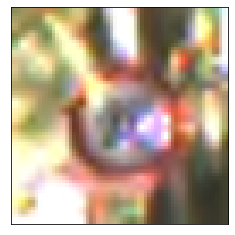

Original label:Speed limit (100km/h), Prediction :Speed limit (60km/h), confidence : 0.981


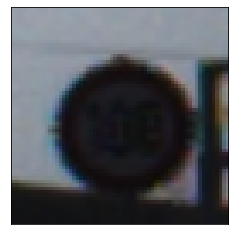

In [27]:
# Find the images that were predicted wrongly and who the images along with the predicted class

for i in range(len(errors)):
    pred_class = np.argmax(prob[errors[i]])
    pred_label = classes[pred_class]
    
    print('Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        list(classes.values())[test_labels.argmax(axis=1)[errors[i]]],
        pred_label,
        prob[errors[i]][pred_class]))
    
    plt.imshow(test_imgs[errors[i]])
    plt.xticks([]),plt.yticks([])
    plt.show()

In [28]:
print(classification_report(test_labels.argmax(axis=1),prob.argmax(axis=1), target_names=classes.values()))

                               precision    recall  f1-score   support

         Speed limit (20km/h)       0.97      0.97      0.97        60
         Speed limit (30km/h)       0.99      0.99      0.99       720
         Speed limit (50km/h)       0.96      0.99      0.97       750
         Speed limit (60km/h)       0.90      0.99      0.94       450
         Speed limit (70km/h)       0.99      0.96      0.98       660
         Speed limit (80km/h)       0.98      0.92      0.95       630
  End of speed limit (80km/h)       1.00      0.90      0.95       150
        Speed limit (100km/h)       0.99      0.88      0.93       450
        Speed limit (120km/h)       0.87      0.98      0.92       450
                   No passing       0.99      0.97      0.98       480
 No passing veh over 3.5 tons       1.00      1.00      1.00       660
 Right-of-way at intersection       0.98      1.00      0.99       420
                Priority road       1.00      0.99      0.99       690
     

## Build and train model with images that have enhanced

In [29]:
tf.random.set_seed(41) # set.seed function helps reuse same set of random variables

# create the base pre-trained model
base_model = VGG19(weights="imagenet", include_top=False,input_tensor=Input(shape=(64, 64, 3)))

x = base_model.output
x = Flatten(name="flatten")(x)
x = Dense(4096, activation="relu")(x)
x = Dense(43, activation="softmax")(x)

models = Model(inputs=base_model.input, outputs=x)

for layer in models.layers[:12]:
   layer.trainable = False
for layer in models.layers[12:]:
   layer.trainable = True
    
for layer in models.layers:
    print(layer, layer.trainable)

<keras.engine.input_layer.InputLayer object at 0x000001E8EC91A580> False
<keras.layers.convolutional.Conv2D object at 0x000001E7353D8AF0> False
<keras.layers.convolutional.Conv2D object at 0x000001E75C1335B0> False
<keras.layers.pooling.MaxPooling2D object at 0x000001E75C168880> False
<keras.layers.convolutional.Conv2D object at 0x000001E75C168430> False
<keras.layers.convolutional.Conv2D object at 0x000001E8EC916610> False
<keras.layers.pooling.MaxPooling2D object at 0x000001E933A1B6D0> False
<keras.layers.convolutional.Conv2D object at 0x000001E75C168280> False
<keras.layers.convolutional.Conv2D object at 0x000001E75C0400A0> False
<keras.layers.convolutional.Conv2D object at 0x000001E75C040E20> False
<keras.layers.convolutional.Conv2D object at 0x000001E75BA68E20> False
<keras.layers.pooling.MaxPooling2D object at 0x000001E75BA18B50> False
<keras.layers.convolutional.Conv2D object at 0x000001E75BA189D0> True
<keras.layers.convolutional.Conv2D object at 0x000001E75BD4EB80> True
<keras

In [30]:
opt = Adam(lr=1e-4)

models.compile(optimizer=opt, loss='categorical_crossentropy',metrics=["accuracy"])
models.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0   

C:\Users\Acer\anaconda3\envs\vip\lib\site-packages\keras\optimizer_v2\optimizer_v2.py:355: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(


In [31]:
from tensorflow.keras.callbacks import ModelCheckpoint

# calculate the total number of images in each class and
# initialize a dictionary to store the class weights
classTotals = y_train1.sum(axis=0)
classWeight = dict()
# loop over all classes and calculate the class weight
for i in range(0, len(classTotals)):
    classWeight[i] = classTotals.max() / classTotals[i]

filepath = "modelAfter/saved-model-{epoch:02d}-{val_loss:.4f}.hdf5"
keras_callbacks   = [
    ModelCheckpoint(filepath, monitor='val_loss', save_best_only=True)]
history1 = models.fit(aug.flow(X_train1, y_train1, batch_size=bs), steps_per_epoch=X_train1.shape[0] // bs, epochs=epoch, validation_data=(X_valid1, y_valid1), verbose = 1, callbacks=[keras_callbacks],class_weight=classWeight)

Epoch 1/40
694/694 [==============================] - 66s 94ms/step - loss: 2.7589 - accuracy: 0.6250 - val_loss: 0.3851 - val_accuracy: 0.8669
Epoch 2/40
694/694 [==============================] - 65s 93ms/step - loss: 0.6365 - accuracy: 0.9050 - val_loss: 0.1269 - val_accuracy: 0.9541
Epoch 3/40
694/694 [==============================] - 65s 93ms/step - loss: 0.4109 - accuracy: 0.9366 - val_loss: 0.2684 - val_accuracy: 0.9515
Epoch 4/40
694/694 [==============================] - 65s 94ms/step - loss: 0.3250 - accuracy: 0.9524 - val_loss: 0.0691 - val_accuracy: 0.9760
Epoch 5/40
694/694 [==============================] - 65s 93ms/step - loss: 0.2670 - accuracy: 0.9624 - val_loss: 0.0624 - val_accuracy: 0.9828
Epoch 6/40
694/694 [==============================] - 65s 93ms/step - loss: 0.2996 - accuracy: 0.9621 - val_loss: 0.1547 - val_accuracy: 0.9568
Epoch 7/40
694/694 [==============================] - 65s 93ms/step - loss: 0.2303 - accuracy: 0.9681 - val_loss: 0.0392 - val_accuracy:

In [32]:
models.save("modelAfter/saved-model.hdf5")

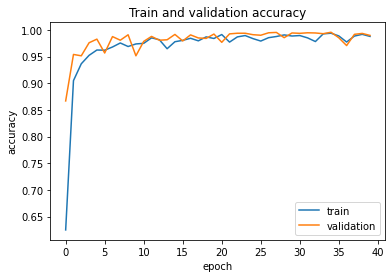

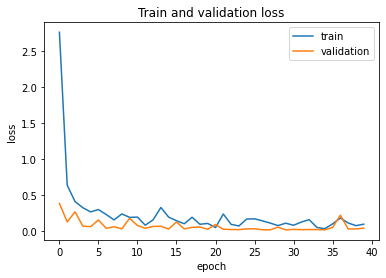

In [33]:
# accuracy plot 
plt.plot(history1.history['accuracy'])
plt.plot(history1.history['val_accuracy'])
plt.title('Train and validation accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='lower right')
plt.show()

# loss plot
plt.plot(history1.history['loss'])
plt.plot(history1.history['val_loss'])
plt.title('Train and validation loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper right')
plt.show()

In [16]:
models = tf.keras.models.load_model('modelAfter\saved-model-30-0.0170.hdf5')

In [17]:
loss, accuracy = models.evaluate(test_img,test_labels)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

395/395 [==============================] - 20s 33ms/step - loss: 0.1262 - accuracy: 0.9747
Test accuracy : 0.9747426509857178
Test loss : 0.12619750201702118


In [18]:
prob1 = models.predict(test_img)
predictions1 = np.argmax(prob1, axis=-1)
predictions1

array([14, 27,  2, ..., 25,  5, 10], dtype=int64)

In [19]:
test_labels.argmax(axis=1)

array([14, 27,  2, ..., 25,  5, 10], dtype=int64)

In [20]:
correct1 = np.where(predictions1 == test_labels.argmax(axis=1))[0]
print("No of correct predictions = {}/{}".format(len(correct1),12630))

No of correct predictions = 12311/12630


Original label:Stop, Prediction :Stop, confidence : 1.000


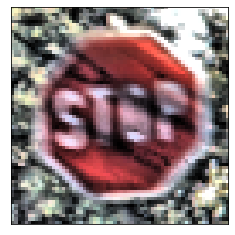

Original label:Pedestrians, Prediction :Pedestrians, confidence : 0.842


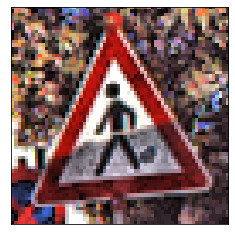

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


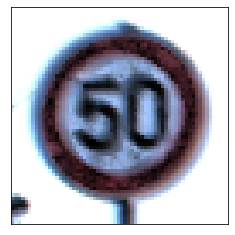

Original label:Bicycles crossing, Prediction :Bicycles crossing, confidence : 1.000


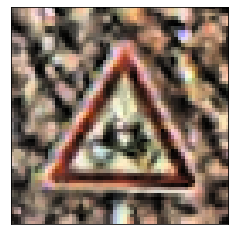

Original label:Keep right, Prediction :Keep right, confidence : 1.000


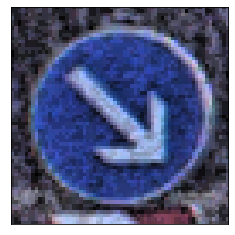

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


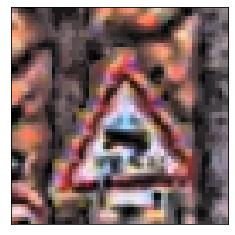

Original label:No entry, Prediction :No entry, confidence : 0.997


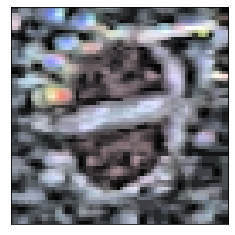

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


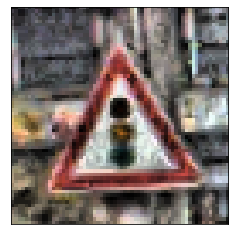

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


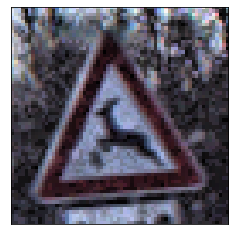

Original label:Keep left, Prediction :Keep left, confidence : 1.000


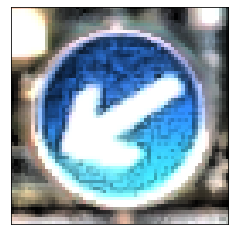

Original label:Road work, Prediction :Road work, confidence : 1.000


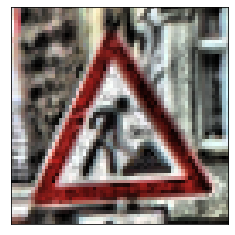

Original label:Keep right, Prediction :Keep right, confidence : 0.669


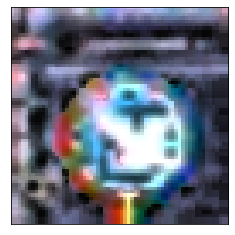

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


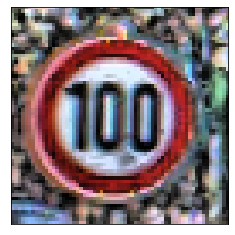

Original label:Double curve, Prediction :Double curve, confidence : 0.885


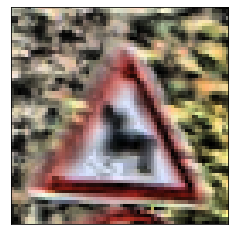

Original label:Yield, Prediction :Yield, confidence : 1.000


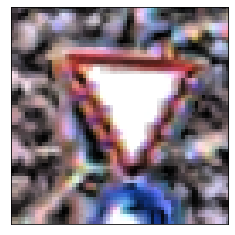

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


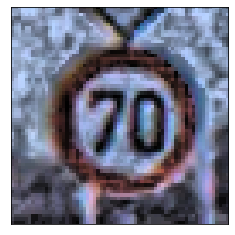

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


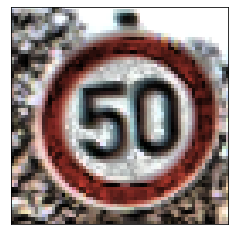

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 0.999


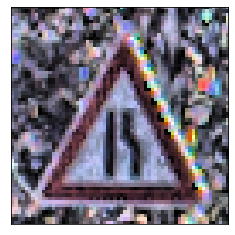

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


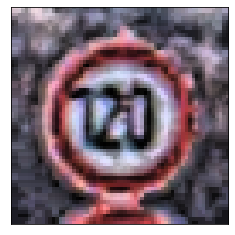

Original label:General caution, Prediction :General caution, confidence : 1.000


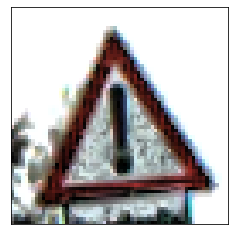

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


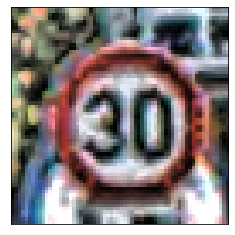

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


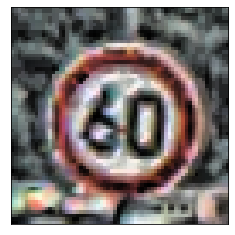

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


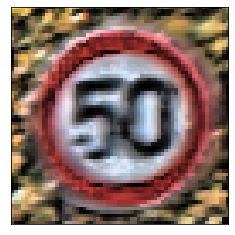

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


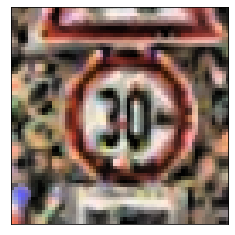

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


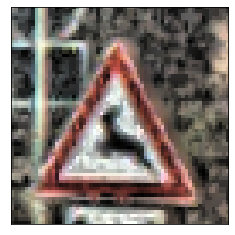

Original label:General caution, Prediction :General caution, confidence : 1.000


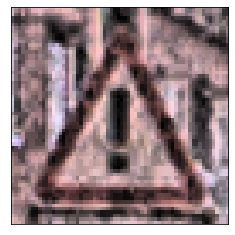

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


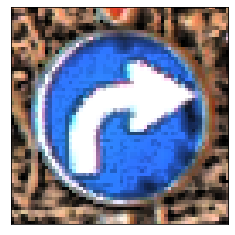

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


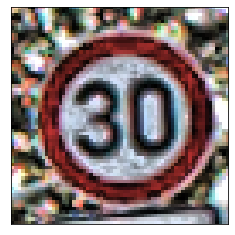

Original label:Keep right, Prediction :Keep right, confidence : 1.000


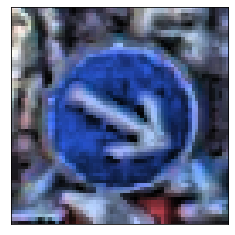

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


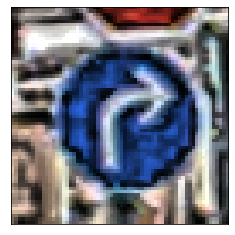

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


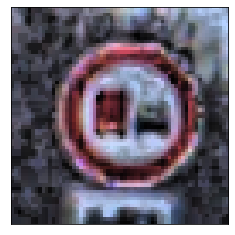

Original label:Priority road, Prediction :Priority road, confidence : 1.000


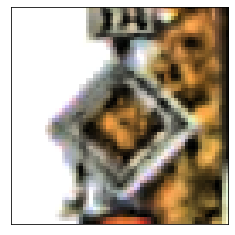

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


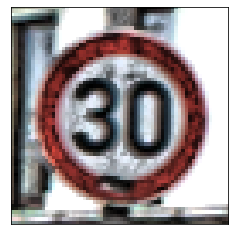

Original label:Bumpy road, Prediction :Bumpy road, confidence : 1.000


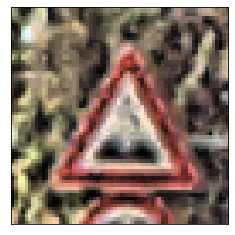

Original label:Road work, Prediction :Road work, confidence : 1.000


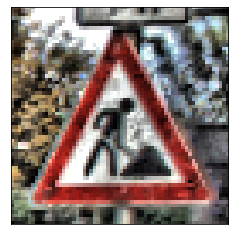

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


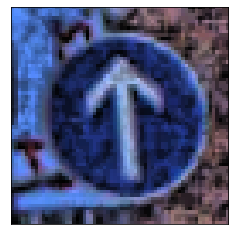

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


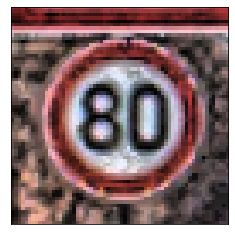

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


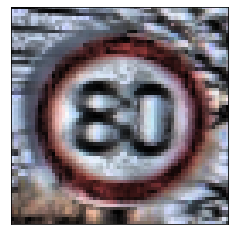

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


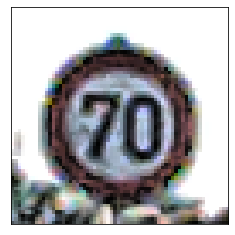

Original label:No passing, Prediction :No passing, confidence : 0.997


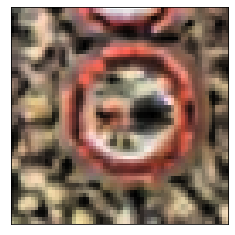

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


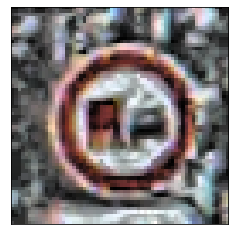

Original label:Roundabout mandatory, Prediction :Roundabout mandatory, confidence : 1.000


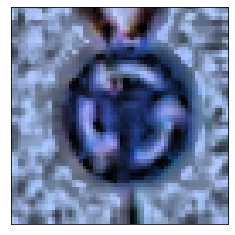

Original label:End of no passing, Prediction :End of no passing, confidence : 0.998


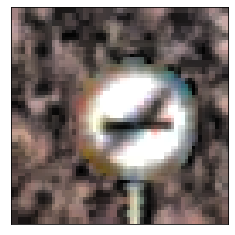

Original label:End of speed limit (80km/h), Prediction :End of speed limit (80km/h), confidence : 1.000


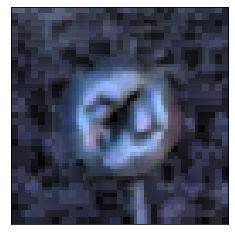

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


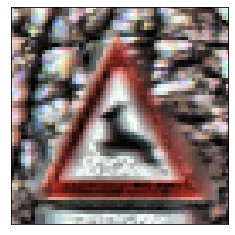

Original label:Veh > 3.5 tons prohibited, Prediction :Veh > 3.5 tons prohibited, confidence : 1.000


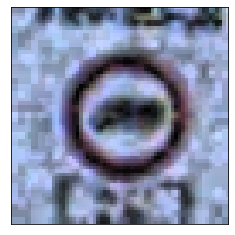

Original label:Double curve, Prediction :Double curve, confidence : 1.000


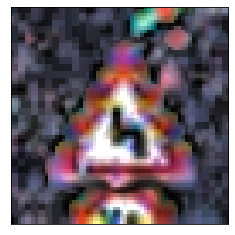

Original label:No passing, Prediction :No passing, confidence : 1.000


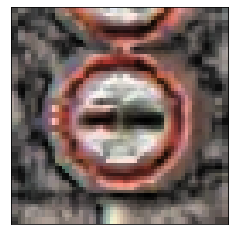

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


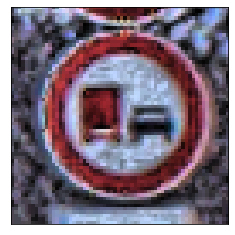

Original label:Yield, Prediction :Yield, confidence : 1.000


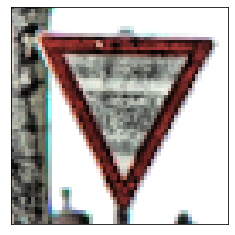

Original label:Road work, Prediction :Road work, confidence : 1.000


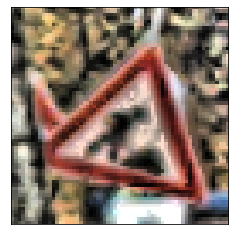

Original label:Stop, Prediction :Stop, confidence : 1.000


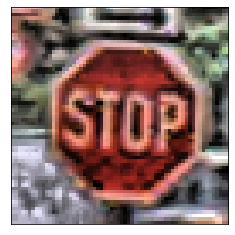

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


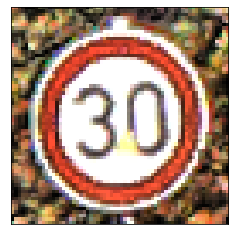

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


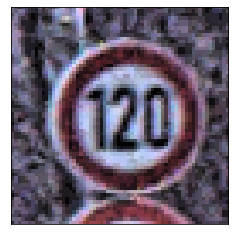

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


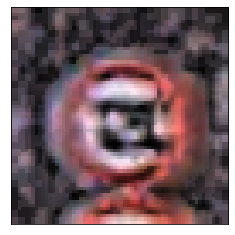

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 1.000


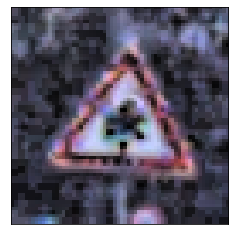

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 0.997


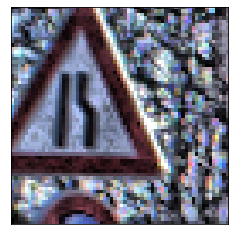

Original label:General caution, Prediction :General caution, confidence : 1.000


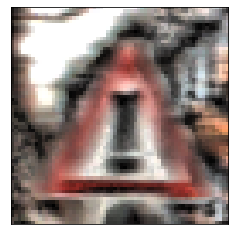

Original label:Yield, Prediction :Yield, confidence : 1.000


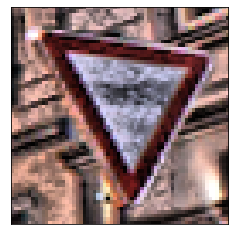

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 0.984


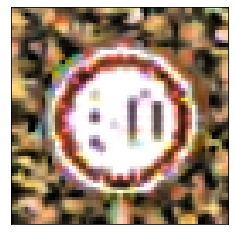

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


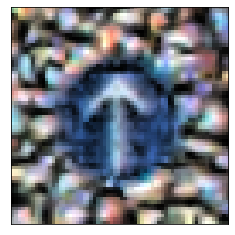

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


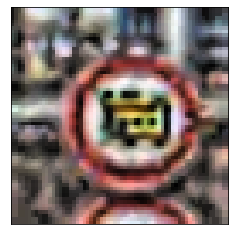

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


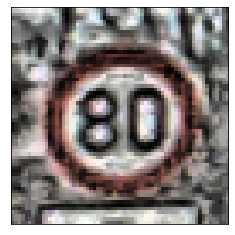

Original label:Road work, Prediction :Road work, confidence : 1.000


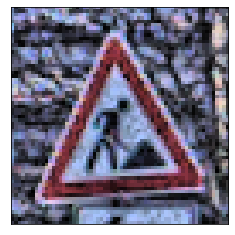

Original label:Priority road, Prediction :Priority road, confidence : 1.000


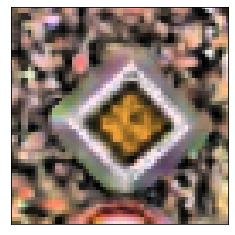

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


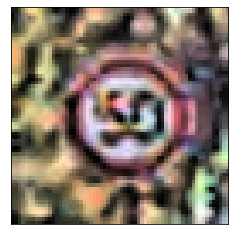

Original label:Turn left ahead, Prediction :Turn left ahead, confidence : 1.000


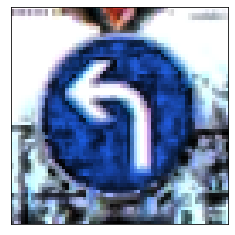

Original label:Road work, Prediction :Road work, confidence : 0.967


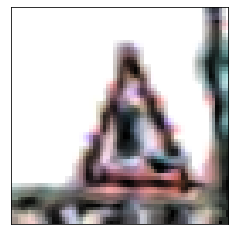

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


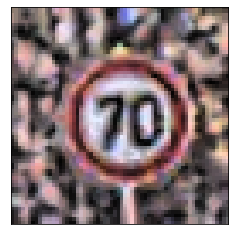

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 0.998


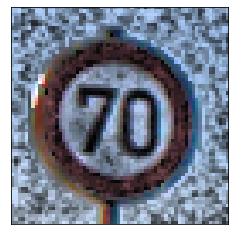

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


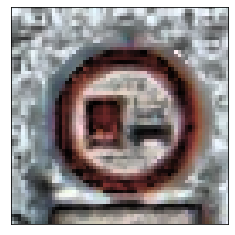

Original label:Keep left, Prediction :Keep left, confidence : 1.000


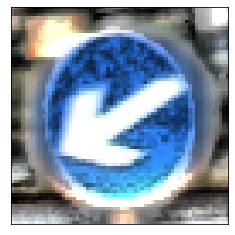

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


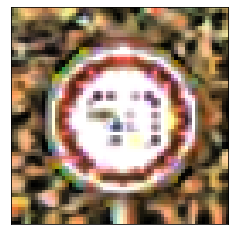

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


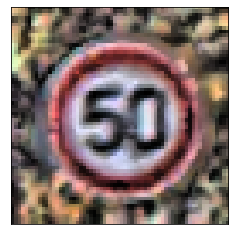

Original label:Yield, Prediction :Yield, confidence : 1.000


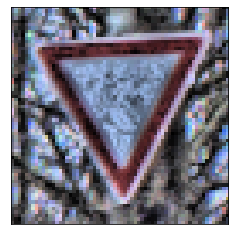

Original label:Priority road, Prediction :Priority road, confidence : 1.000


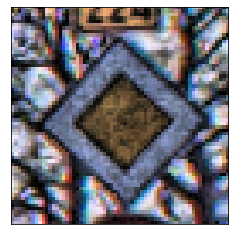

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 0.800


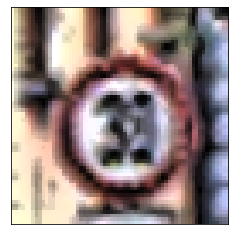

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 0.999


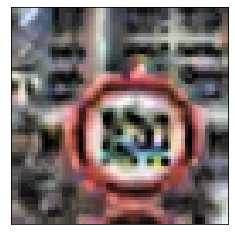

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


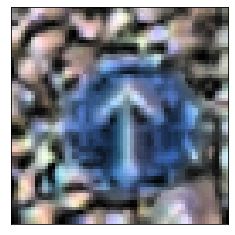

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


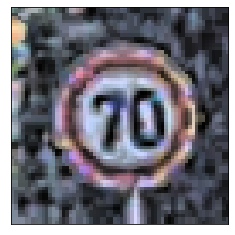

Original label:No passing, Prediction :No passing, confidence : 1.000


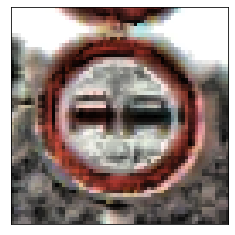

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


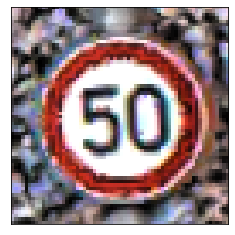

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


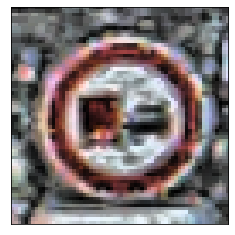

Original label:Keep right, Prediction :Keep right, confidence : 1.000


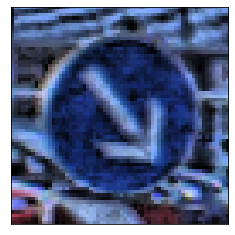

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


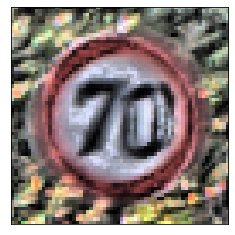

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


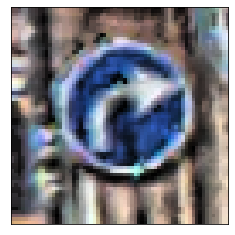

Original label:No entry, Prediction :No entry, confidence : 1.000


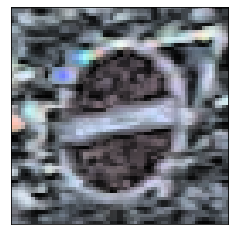

Original label:Veh > 3.5 tons prohibited, Prediction :Veh > 3.5 tons prohibited, confidence : 1.000


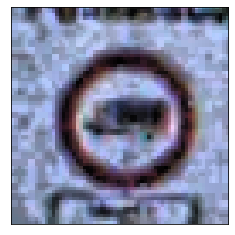

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


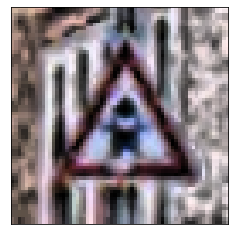

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


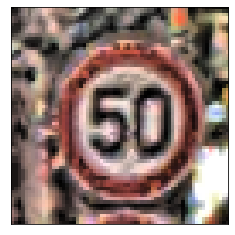

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 0.998


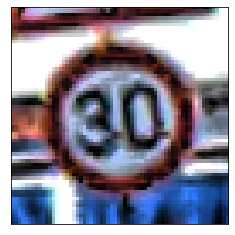

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


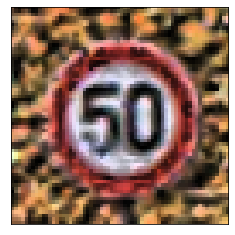

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 0.964


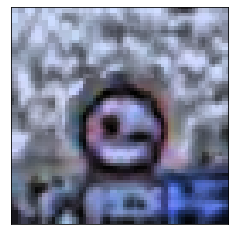

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


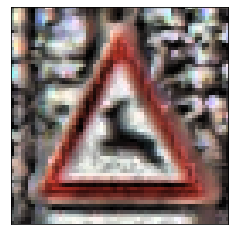

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


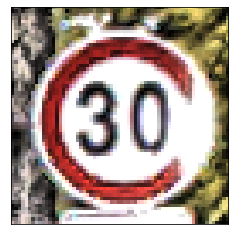

Original label:General caution, Prediction :General caution, confidence : 1.000


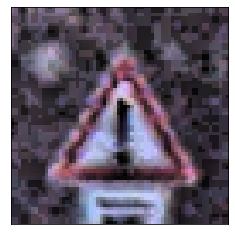

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


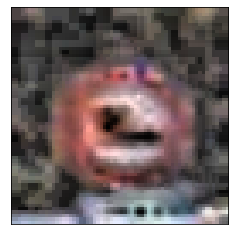

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


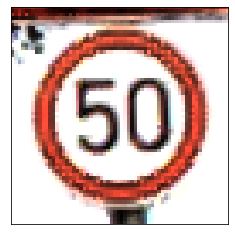

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 0.998


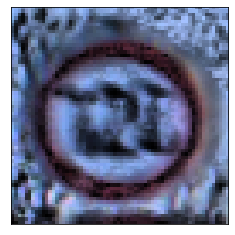

Original label:Bicycles crossing, Prediction :Bicycles crossing, confidence : 1.000


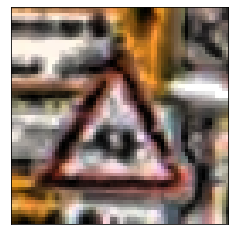

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


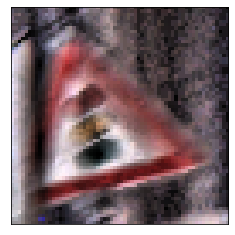

Original label:Stop, Prediction :Stop, confidence : 1.000


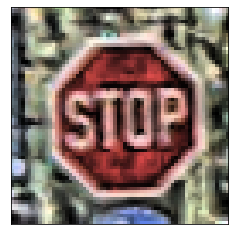

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


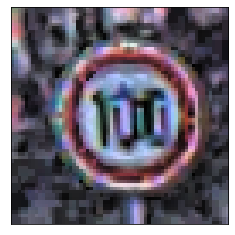

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


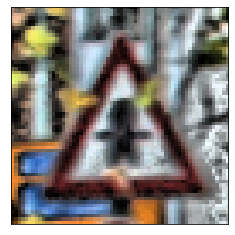

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


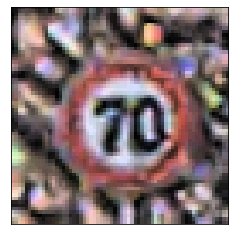

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


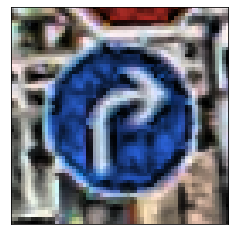

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 0.999


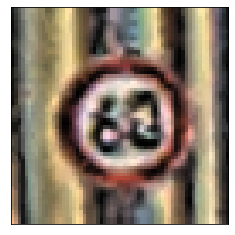

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


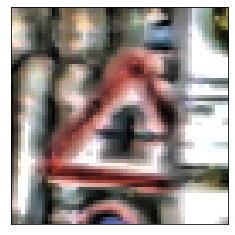

Original label:Stop, Prediction :Stop, confidence : 1.000


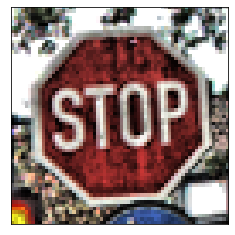

Original label:Priority road, Prediction :Priority road, confidence : 1.000


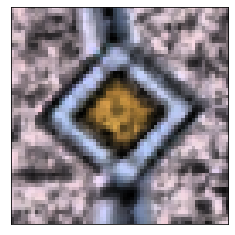

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.976


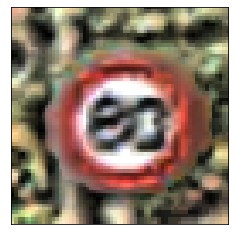

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 1.000


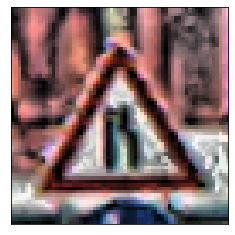

Original label:Keep right, Prediction :Keep right, confidence : 1.000


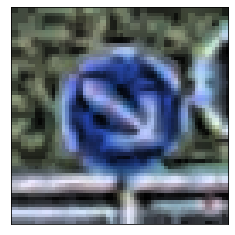

Original label:Road work, Prediction :Road work, confidence : 1.000


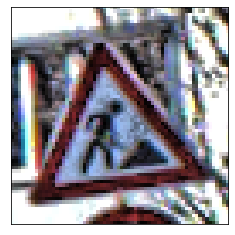

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


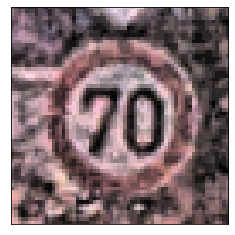

Original label:Keep left, Prediction :Keep left, confidence : 1.000


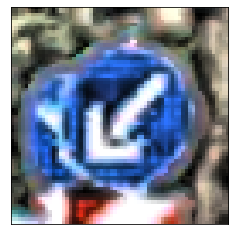

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


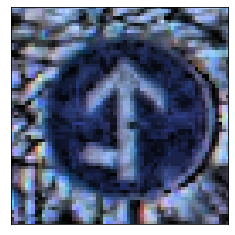

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.875


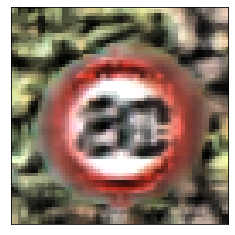

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


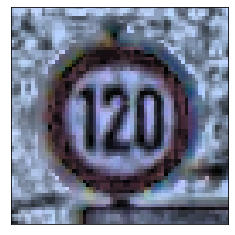

Original label:Yield, Prediction :Yield, confidence : 1.000


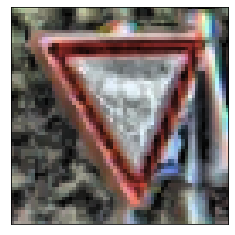

Original label:Road work, Prediction :Road work, confidence : 1.000


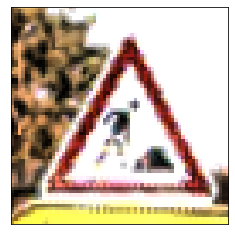

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


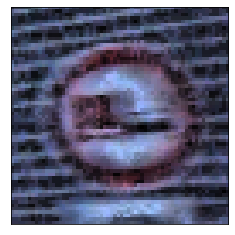

Original label:End of no passing, Prediction :End of no passing, confidence : 1.000


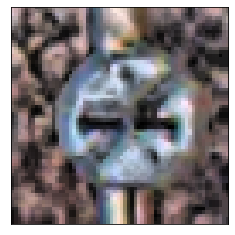

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


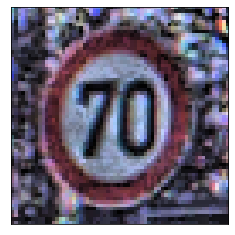

Original label:Yield, Prediction :Yield, confidence : 1.000


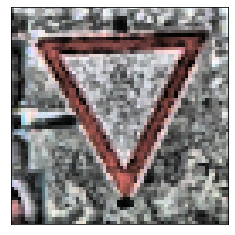

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


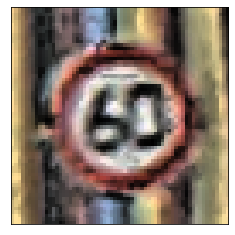

Original label:Keep right, Prediction :Keep right, confidence : 1.000


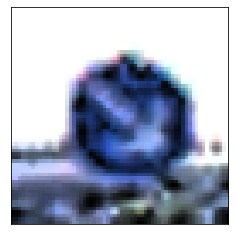

Original label:End of speed limit (80km/h), Prediction :End of speed limit (80km/h), confidence : 1.000


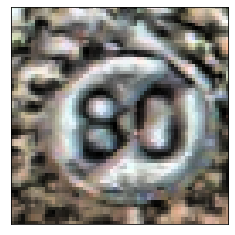

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.996


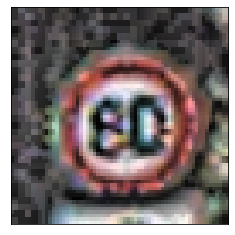

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


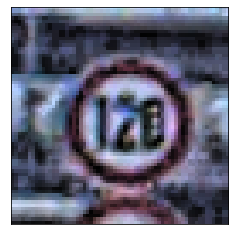

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


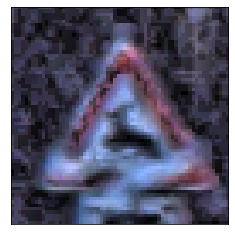

Original label:Stop, Prediction :Stop, confidence : 1.000


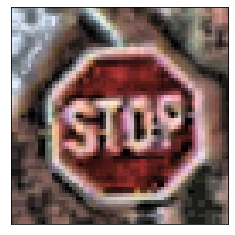

Original label:Road work, Prediction :Road work, confidence : 1.000


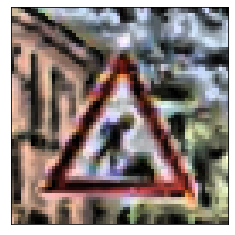

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


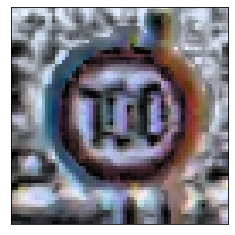

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


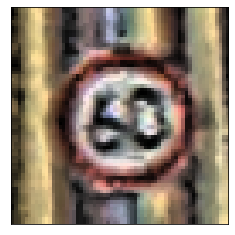

Original label:Priority road, Prediction :Priority road, confidence : 1.000


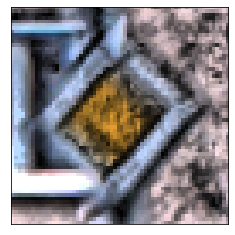

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 0.998


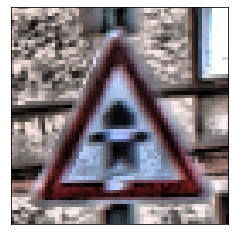

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


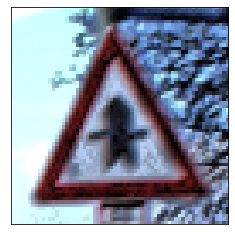

Original label:Yield, Prediction :Yield, confidence : 1.000


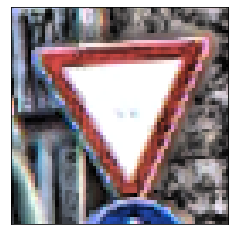

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


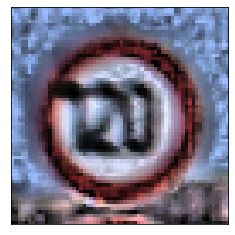

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


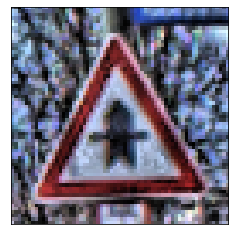

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 1.000


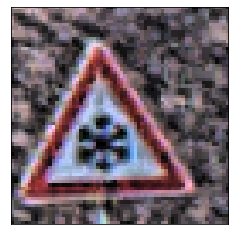

Original label:Priority road, Prediction :Priority road, confidence : 1.000


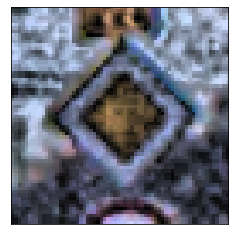

Original label:Dangerous curve left, Prediction :Dangerous curve left, confidence : 1.000


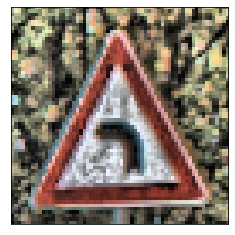

Original label:Keep right, Prediction :Keep right, confidence : 1.000


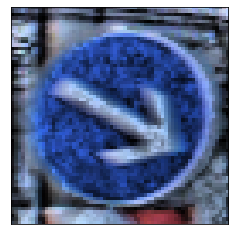

Original label:Yield, Prediction :Yield, confidence : 1.000


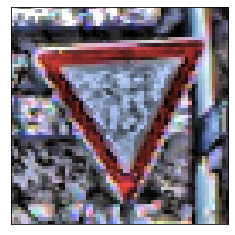

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


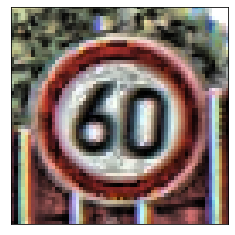

Original label:Yield, Prediction :Yield, confidence : 1.000


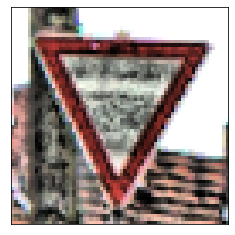

Original label:No entry, Prediction :No entry, confidence : 1.000


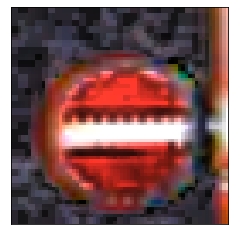

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


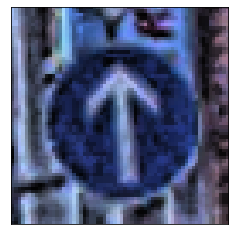

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


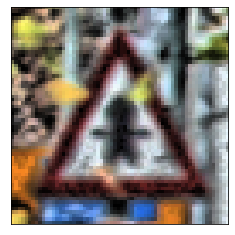

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


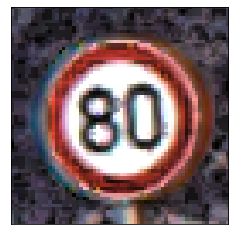

Original label:No vehicles, Prediction :No vehicles, confidence : 1.000


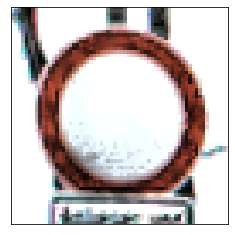

Original label:Keep right, Prediction :Keep right, confidence : 1.000


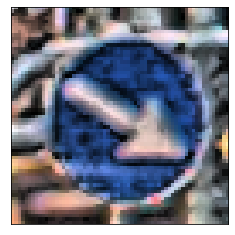

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


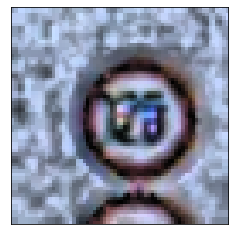

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


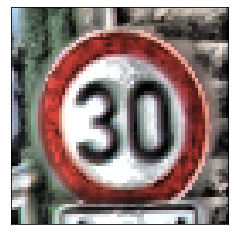

Original label:Dangerous curve left, Prediction :Dangerous curve left, confidence : 1.000


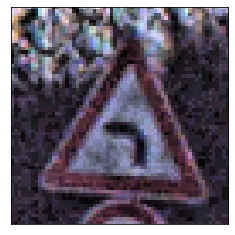

Original label:Yield, Prediction :Yield, confidence : 1.000


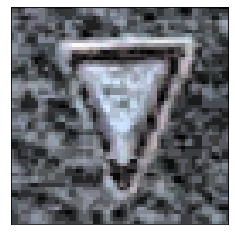

Original label:Keep right, Prediction :Keep right, confidence : 1.000


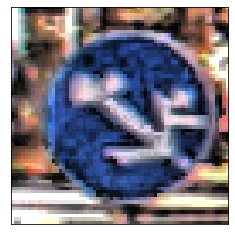

Original label:Keep right, Prediction :Keep right, confidence : 1.000


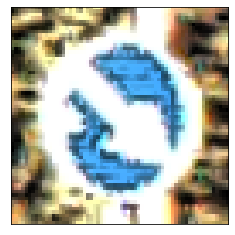

Original label:Speed limit (20km/h), Prediction :Speed limit (20km/h), confidence : 0.994


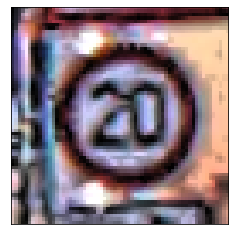

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


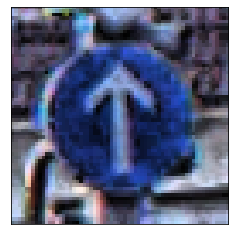

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


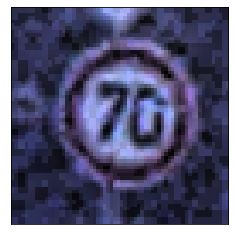

Original label:Priority road, Prediction :Priority road, confidence : 1.000


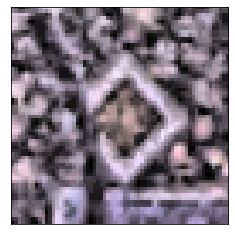

Original label:Yield, Prediction :Yield, confidence : 1.000


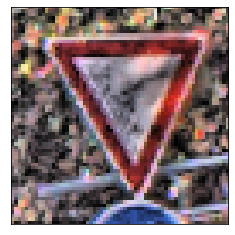

Original label:Double curve, Prediction :Double curve, confidence : 0.998


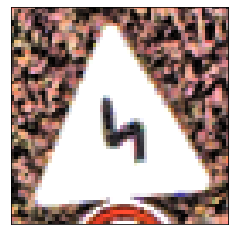

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


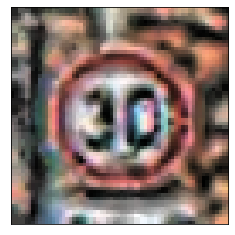

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


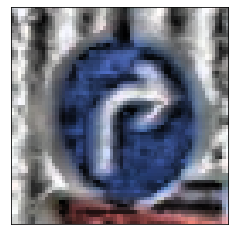

Original label:Turn left ahead, Prediction :Turn left ahead, confidence : 1.000


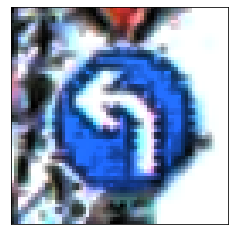

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


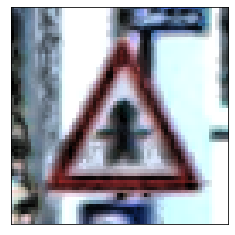

Original label:Priority road, Prediction :Priority road, confidence : 1.000


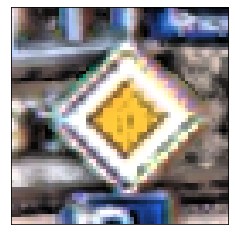

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 0.998


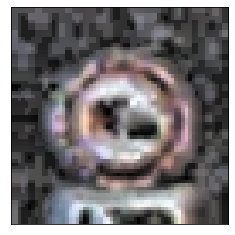

Original label:Yield, Prediction :Yield, confidence : 1.000


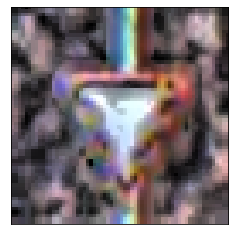

Original label:Yield, Prediction :Yield, confidence : 1.000


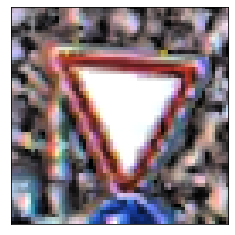

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


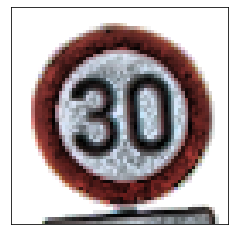

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 0.999


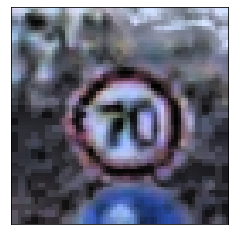

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


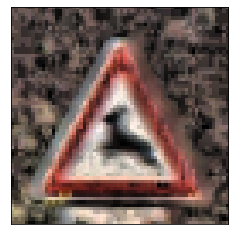

Original label:No entry, Prediction :No entry, confidence : 1.000


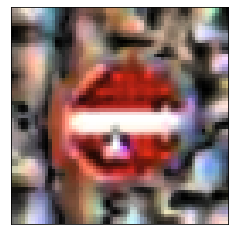

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


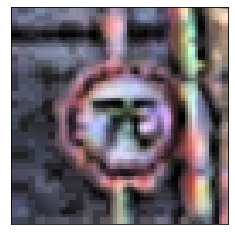

Original label:Yield, Prediction :Yield, confidence : 1.000


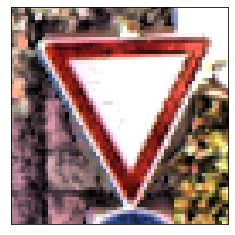

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


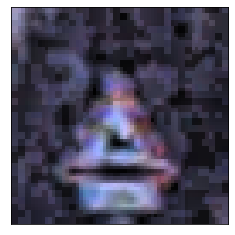

Original label:Road work, Prediction :Road work, confidence : 1.000


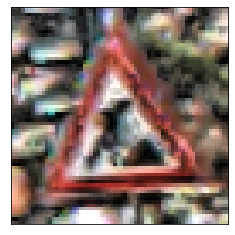

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


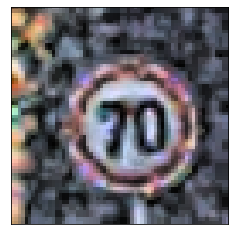

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


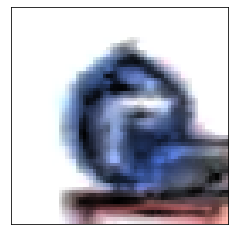

Original label:Go straight or right, Prediction :Go straight or right, confidence : 1.000


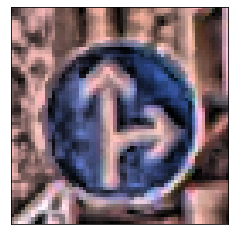

Original label:Dangerous curve left, Prediction :Dangerous curve left, confidence : 1.000


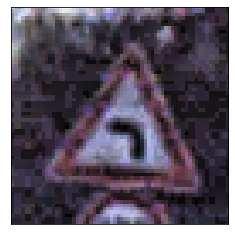

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


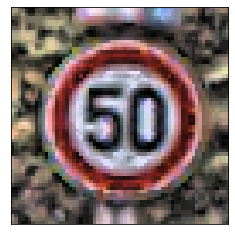

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


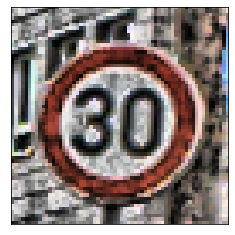

Original label:Keep left, Prediction :Keep left, confidence : 1.000


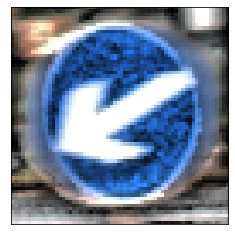

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


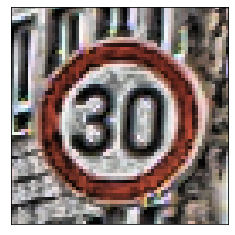

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


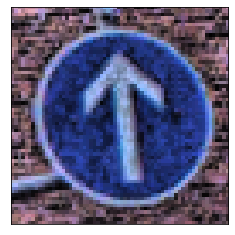

Original label:Keep right, Prediction :Keep right, confidence : 1.000


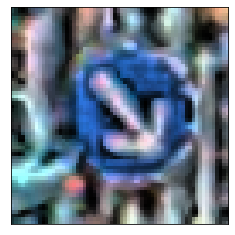

Original label:Keep right, Prediction :Keep right, confidence : 1.000


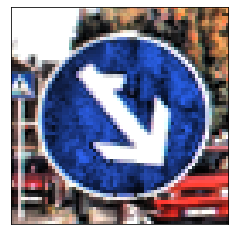

Original label:Bumpy road, Prediction :Bumpy road, confidence : 1.000


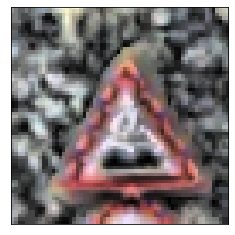

Original label:Yield, Prediction :Yield, confidence : 1.000


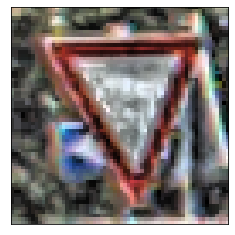

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


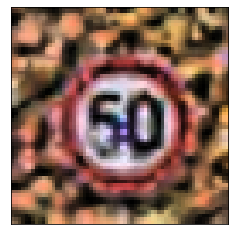

Original label:No entry, Prediction :No entry, confidence : 1.000


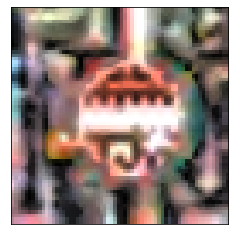

Original label:Priority road, Prediction :Priority road, confidence : 1.000


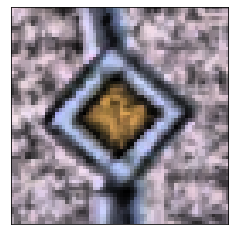

Original label:Keep right, Prediction :Keep right, confidence : 1.000


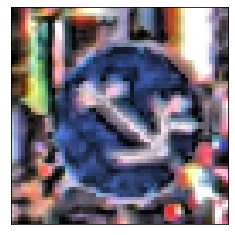

Original label:Yield, Prediction :Yield, confidence : 1.000


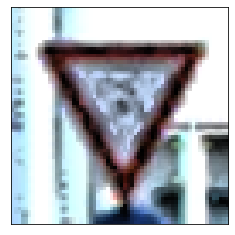

Original label:No passing, Prediction :No passing, confidence : 1.000


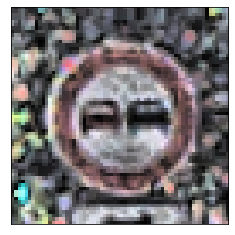

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


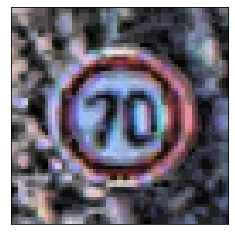

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


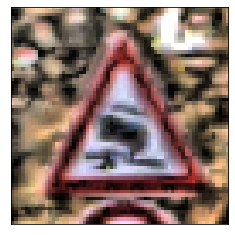

Original label:Stop, Prediction :Stop, confidence : 1.000


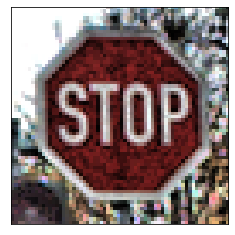

Original label:End no passing veh > 3.5 tons, Prediction :End no passing veh > 3.5 tons, confidence : 1.000


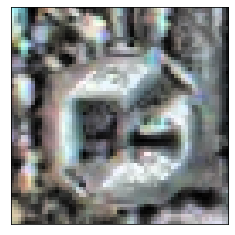

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


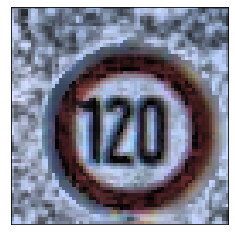

Original label:Yield, Prediction :Yield, confidence : 1.000


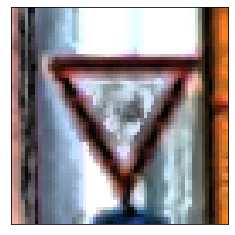

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


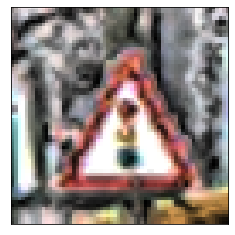

Original label:Priority road, Prediction :Priority road, confidence : 1.000


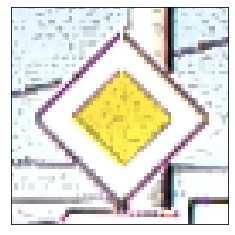

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


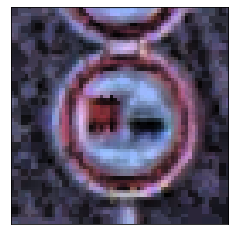

Original label:Stop, Prediction :Stop, confidence : 1.000


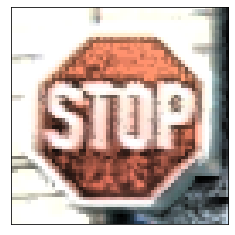

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


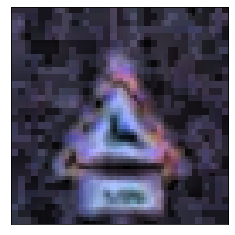

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


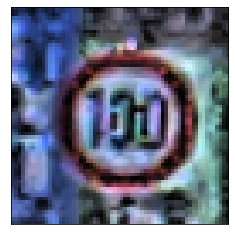

Original label:Go straight or right, Prediction :Go straight or right, confidence : 1.000


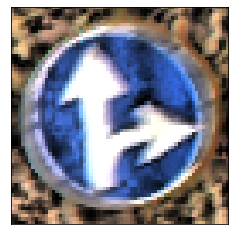

Original label:Go straight or right, Prediction :Go straight or right, confidence : 1.000


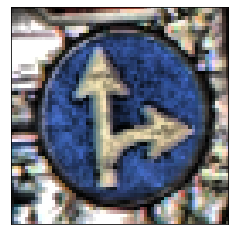

Original label:Bicycles crossing, Prediction :Bicycles crossing, confidence : 1.000


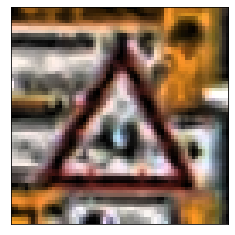

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 0.998


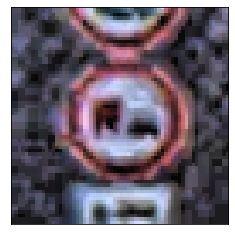

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


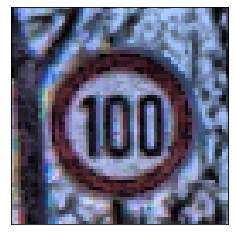

Original label:Keep right, Prediction :Keep right, confidence : 1.000


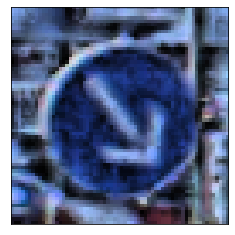

Original label:General caution, Prediction :General caution, confidence : 1.000


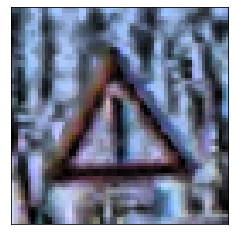

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


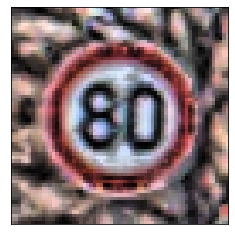

Original label:No entry, Prediction :No entry, confidence : 1.000


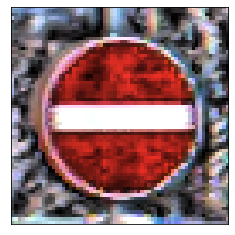

Original label:Yield, Prediction :Yield, confidence : 1.000


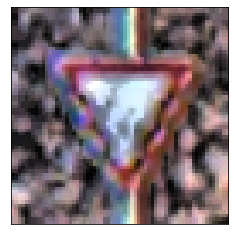

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


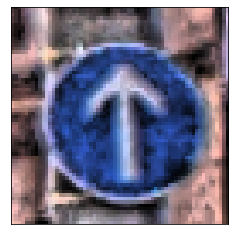

Original label:End of speed limit (80km/h), Prediction :End of speed limit (80km/h), confidence : 1.000


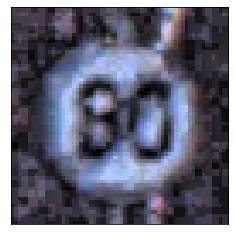

Original label:Road work, Prediction :Road work, confidence : 1.000


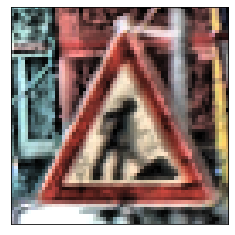

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


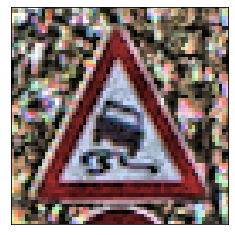

Original label:Priority road, Prediction :Priority road, confidence : 1.000


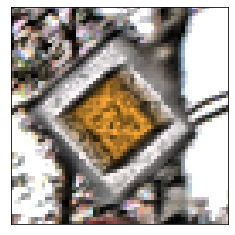

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


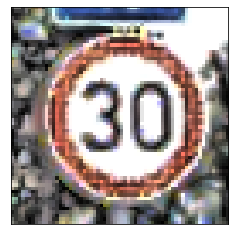

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


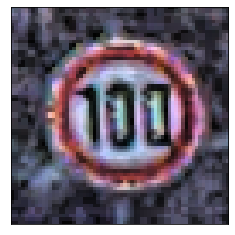

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 0.999


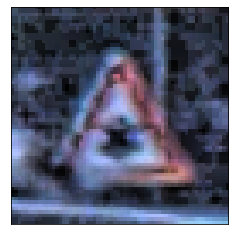

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


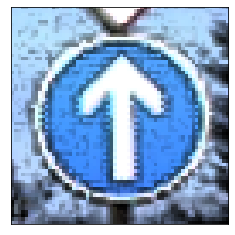

Original label:Stop, Prediction :Stop, confidence : 1.000


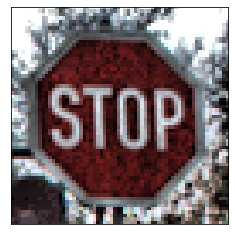

Original label:Yield, Prediction :Yield, confidence : 1.000


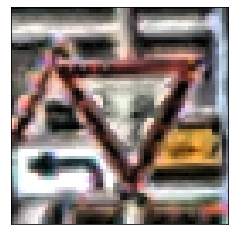

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


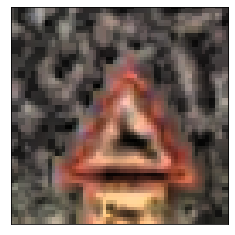

Original label:No passing, Prediction :No passing, confidence : 1.000


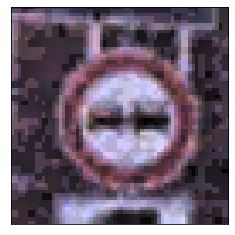

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


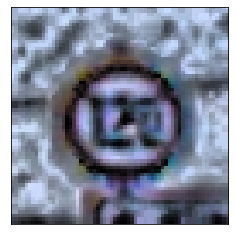

Original label:No passing, Prediction :No passing, confidence : 1.000


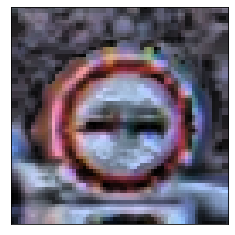

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


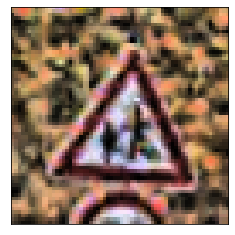

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


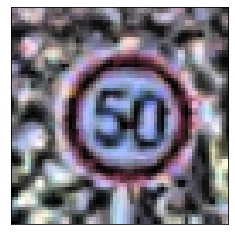

Original label:Priority road, Prediction :Priority road, confidence : 1.000


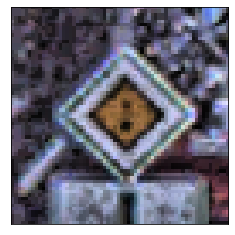

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


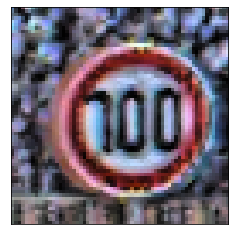

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 0.999


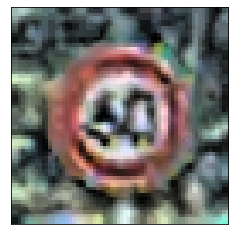

Original label:No entry, Prediction :No entry, confidence : 0.999


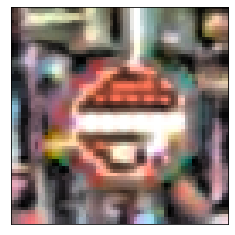

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


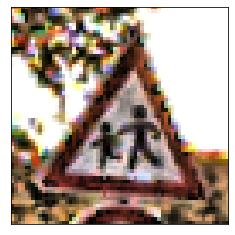

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


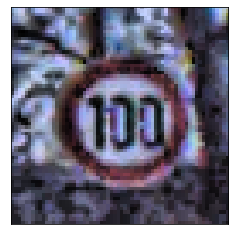

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


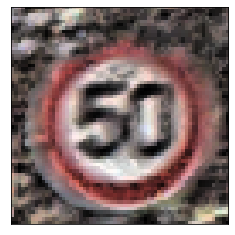

Original label:Dangerous curve right, Prediction :Dangerous curve right, confidence : 1.000


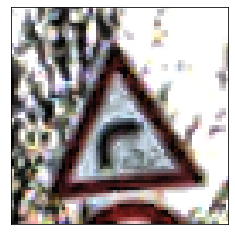

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


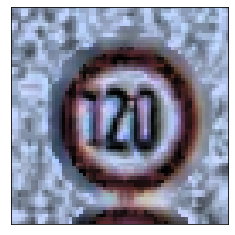

Original label:General caution, Prediction :General caution, confidence : 1.000


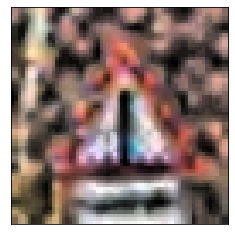

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


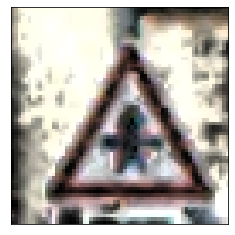

Original label:Stop, Prediction :Stop, confidence : 1.000


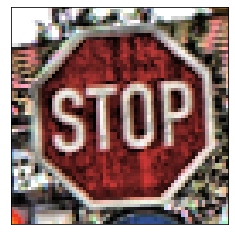

Original label:Priority road, Prediction :Priority road, confidence : 0.899


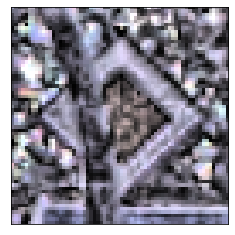

Original label:Turn left ahead, Prediction :Turn left ahead, confidence : 1.000


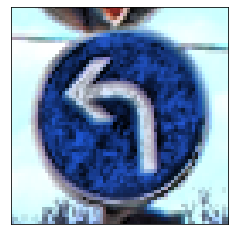

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.998


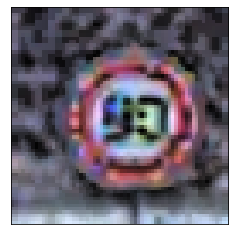

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


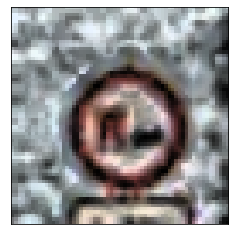

Original label:Yield, Prediction :Yield, confidence : 1.000


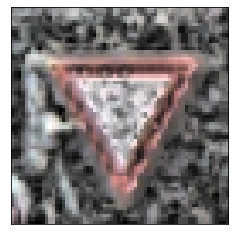

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


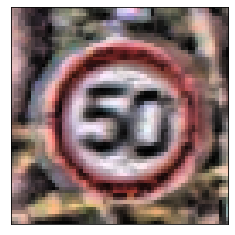

Original label:Yield, Prediction :Yield, confidence : 1.000


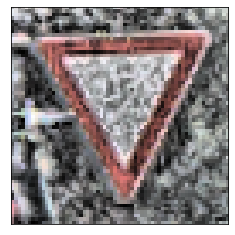

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


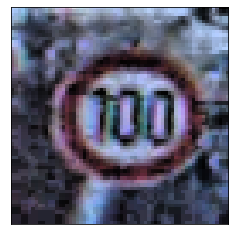

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


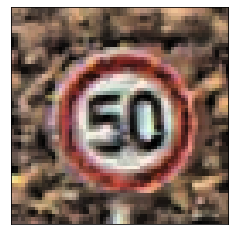

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


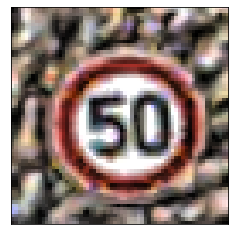

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


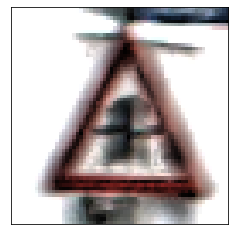

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


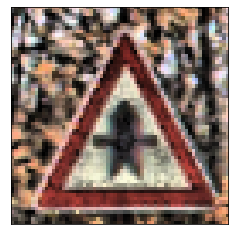

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 0.999


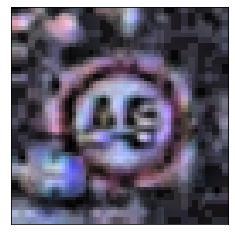

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


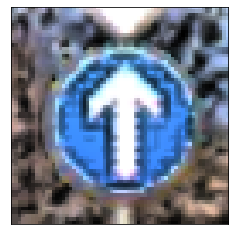

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


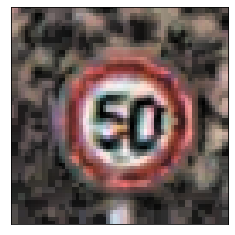

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.959


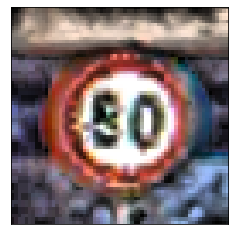

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


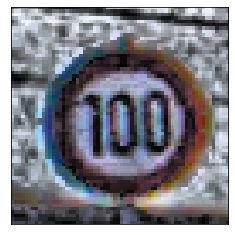

Original label:General caution, Prediction :General caution, confidence : 1.000


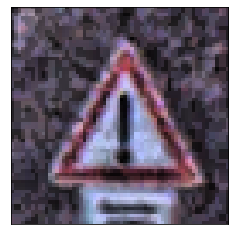

Original label:Stop, Prediction :Stop, confidence : 1.000


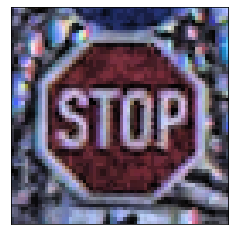

Original label:Bicycles crossing, Prediction :Bicycles crossing, confidence : 1.000


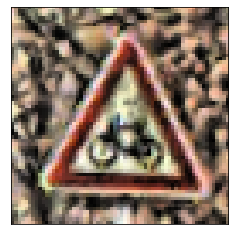

Original label:No passing, Prediction :No passing, confidence : 1.000


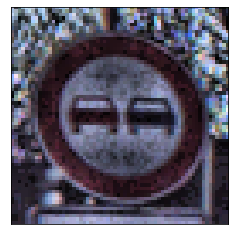

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 0.995


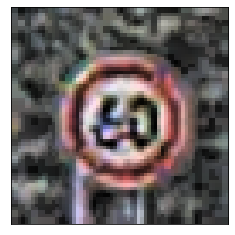

Original label:Yield, Prediction :Yield, confidence : 1.000


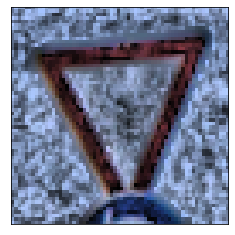

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


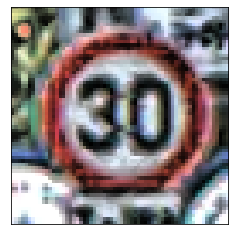

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


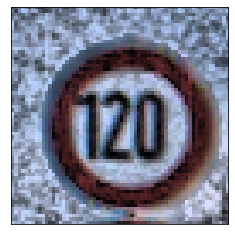

Original label:Go straight or right, Prediction :Go straight or right, confidence : 1.000


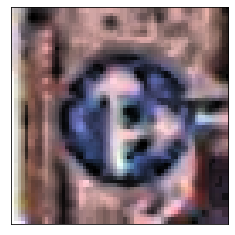

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


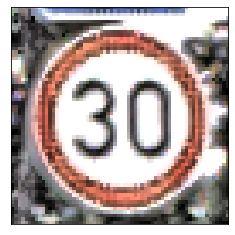

Original label:Double curve, Prediction :Double curve, confidence : 0.983


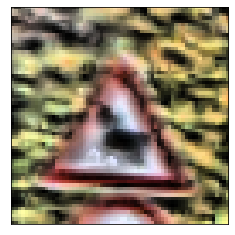

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


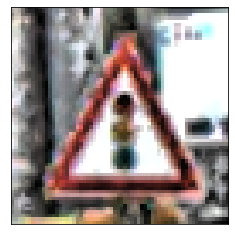

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


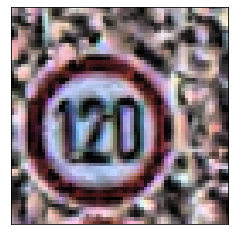

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


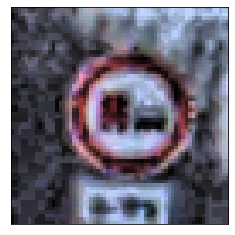

Original label:No passing, Prediction :No passing, confidence : 1.000


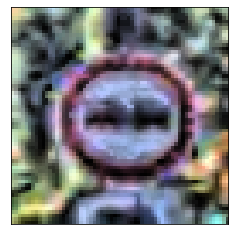

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


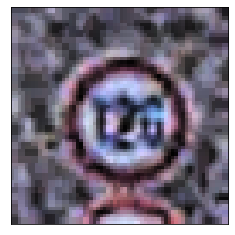

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


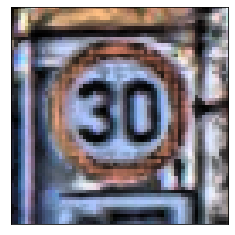

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


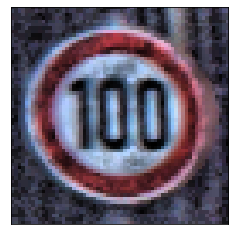

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


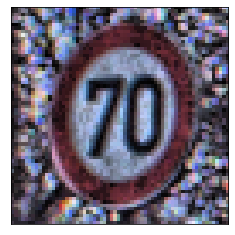

Original label:End of no passing, Prediction :End of no passing, confidence : 1.000


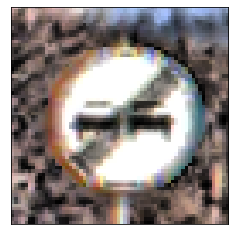

Original label:No passing, Prediction :No passing, confidence : 1.000


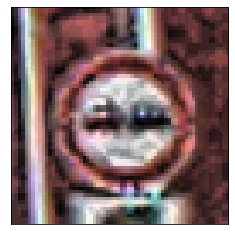

Original label:Yield, Prediction :Yield, confidence : 1.000


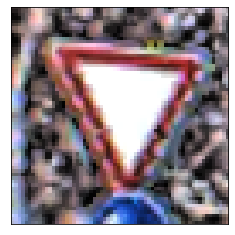

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


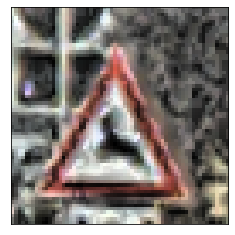

Original label:Keep right, Prediction :Keep right, confidence : 1.000


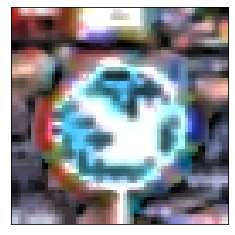

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 0.999


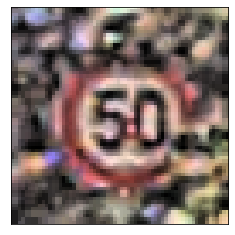

Original label:Road work, Prediction :Road work, confidence : 1.000


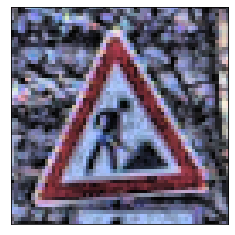

Original label:Priority road, Prediction :Priority road, confidence : 1.000


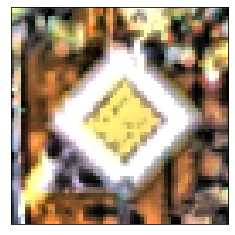

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 0.969


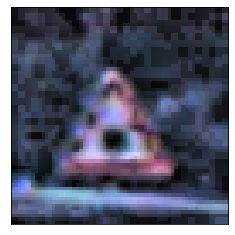

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


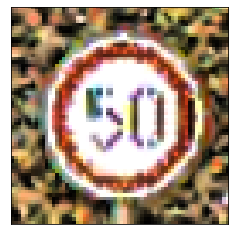

Original label:Yield, Prediction :Yield, confidence : 1.000


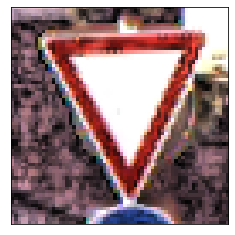

Original label:No passing, Prediction :No passing, confidence : 1.000


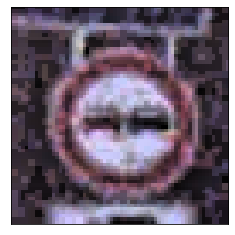

Original label:Stop, Prediction :Stop, confidence : 1.000


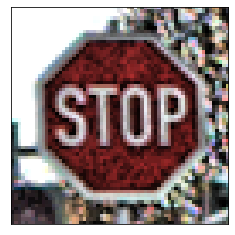

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.835


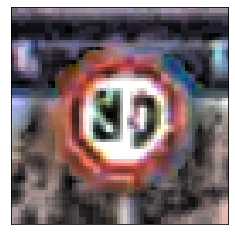

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


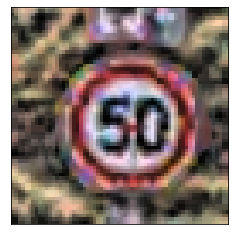

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


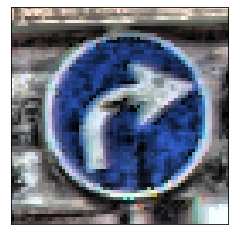

Original label:Dangerous curve right, Prediction :Dangerous curve right, confidence : 1.000


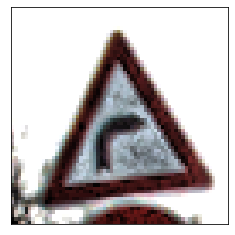

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


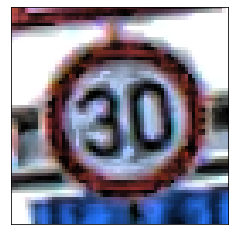

Original label:General caution, Prediction :General caution, confidence : 0.999


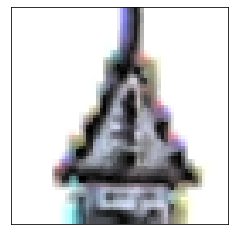

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


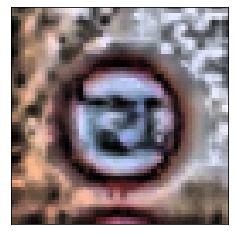

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 0.998


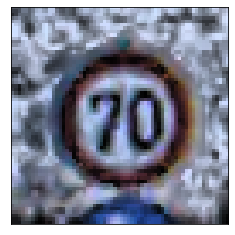

Original label:Yield, Prediction :Yield, confidence : 1.000


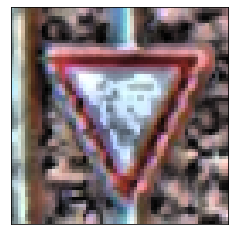

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 0.999


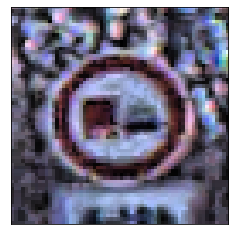

Original label:Speed limit (20km/h), Prediction :Speed limit (20km/h), confidence : 1.000


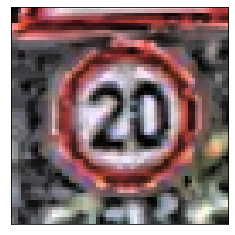

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.983


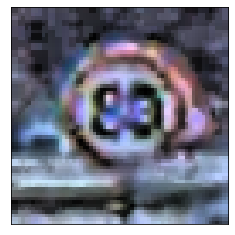

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


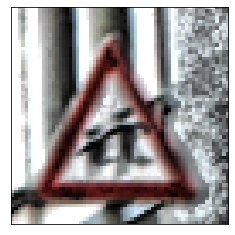

Original label:Priority road, Prediction :Priority road, confidence : 1.000


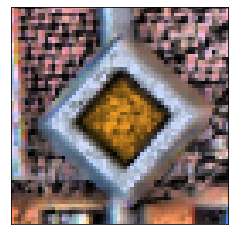

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


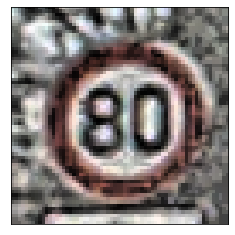

Original label:Road work, Prediction :Road work, confidence : 1.000


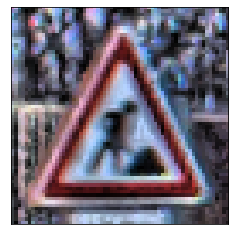

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


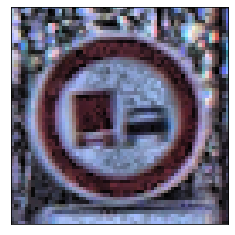

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


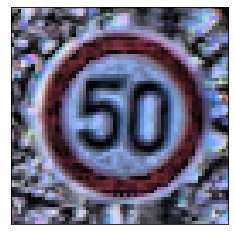

Original label:Priority road, Prediction :Priority road, confidence : 1.000


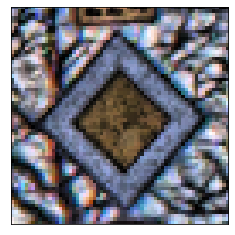

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


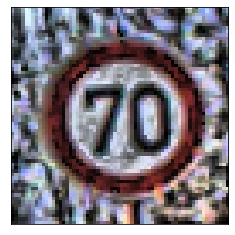

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


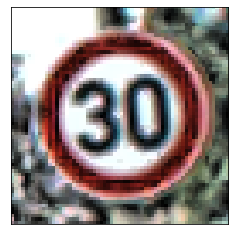

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


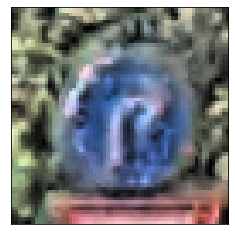

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


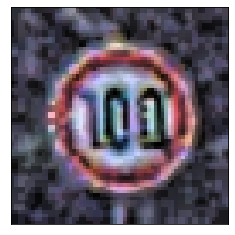

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


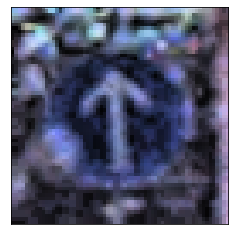

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


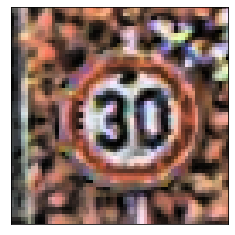

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


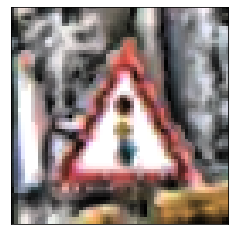

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


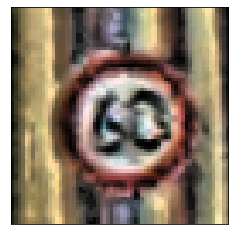

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


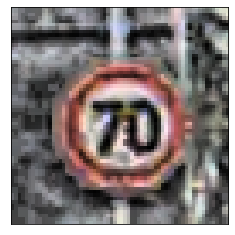

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


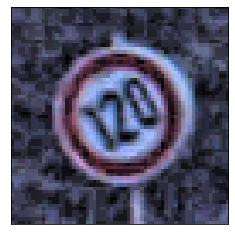

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


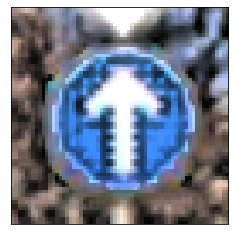

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


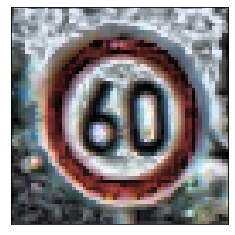

Original label:Pedestrians, Prediction :Pedestrians, confidence : 0.990


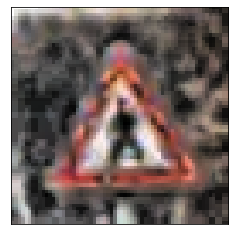

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


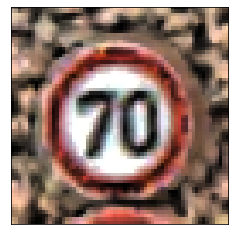

Original label:Keep right, Prediction :Keep right, confidence : 1.000


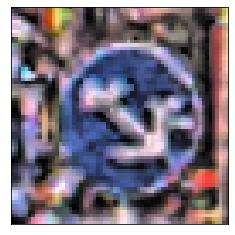

Original label:No entry, Prediction :No entry, confidence : 1.000


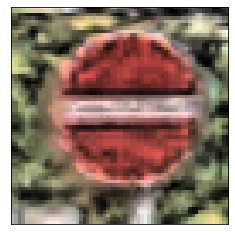

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


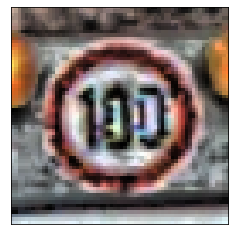

Original label:No entry, Prediction :No entry, confidence : 1.000


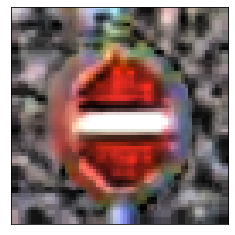

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 0.999


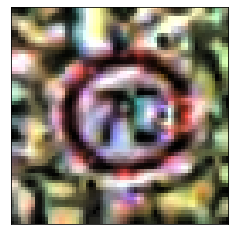

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


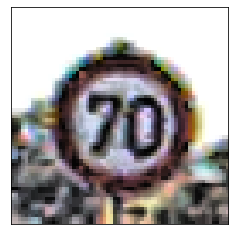

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


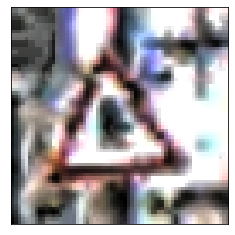

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


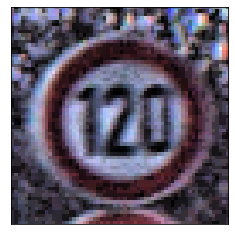

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


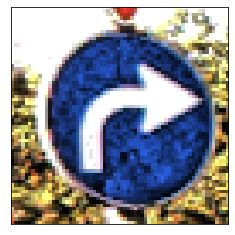

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


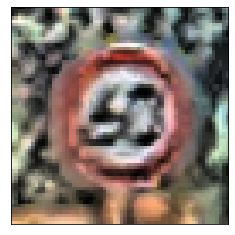

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


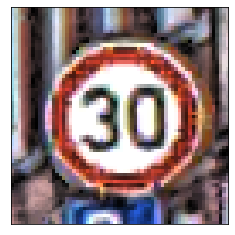

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


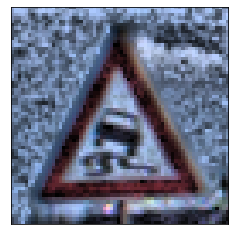

Original label:Bumpy road, Prediction :Bumpy road, confidence : 1.000


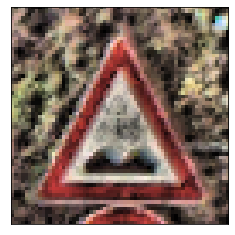

Original label:Stop, Prediction :Stop, confidence : 1.000


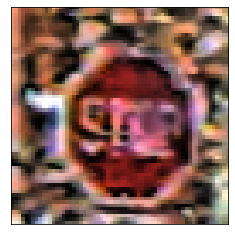

Original label:Go straight or right, Prediction :Go straight or right, confidence : 1.000


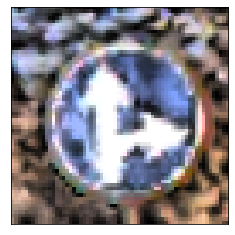

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


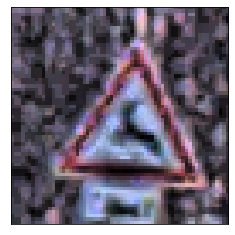

Original label:No passing, Prediction :No passing, confidence : 1.000


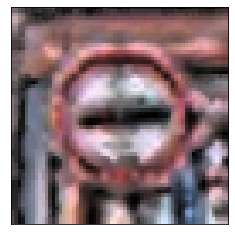

Original label:Turn left ahead, Prediction :Turn left ahead, confidence : 1.000


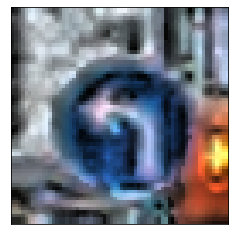

Original label:Road work, Prediction :Road work, confidence : 1.000


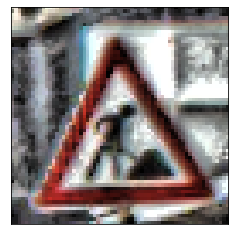

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


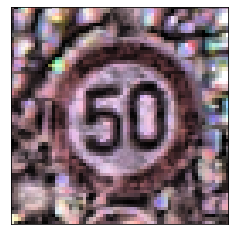

Original label:Keep right, Prediction :Keep right, confidence : 0.999


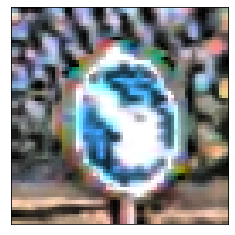

Original label:No passing, Prediction :No passing, confidence : 1.000


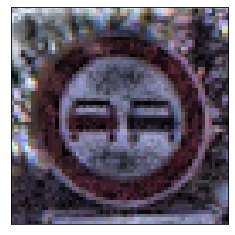

Original label:General caution, Prediction :General caution, confidence : 1.000


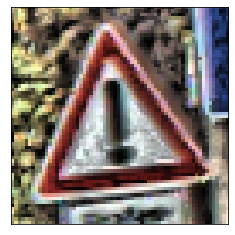

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 0.944


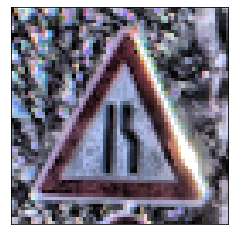

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


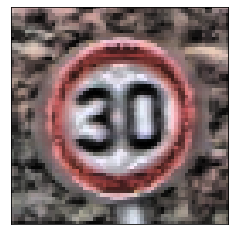

Original label:End no passing veh > 3.5 tons, Prediction :End no passing veh > 3.5 tons, confidence : 1.000


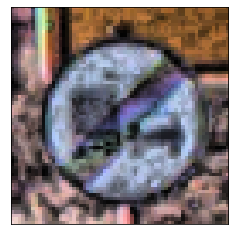

Original label:Keep right, Prediction :Keep right, confidence : 1.000


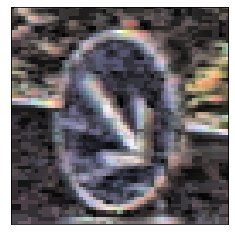

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


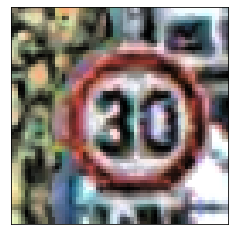

Original label:General caution, Prediction :General caution, confidence : 1.000


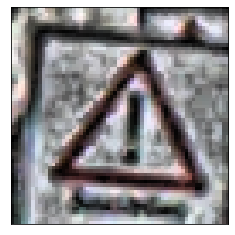

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


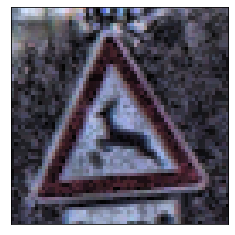

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.997


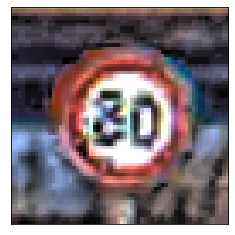

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 1.000


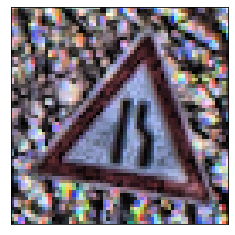

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


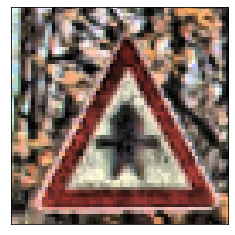

Original label:Priority road, Prediction :Priority road, confidence : 1.000


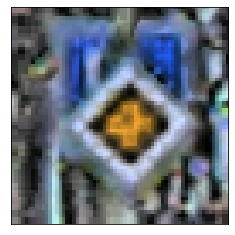

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


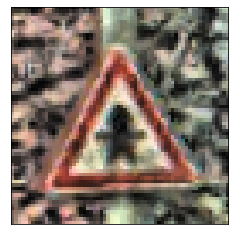

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


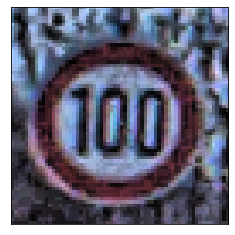

Original label:Yield, Prediction :Yield, confidence : 1.000


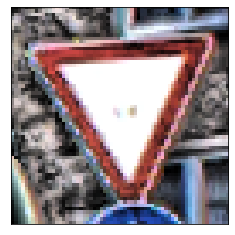

Original label:No passing, Prediction :No passing, confidence : 1.000


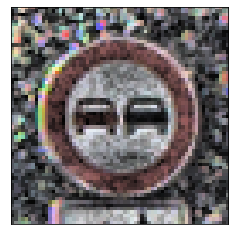

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


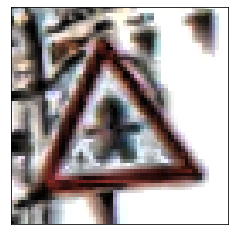

Original label:Priority road, Prediction :Priority road, confidence : 1.000


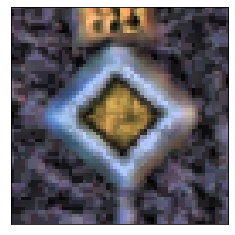

Original label:Stop, Prediction :Stop, confidence : 1.000


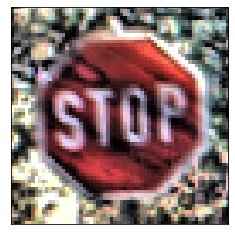

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


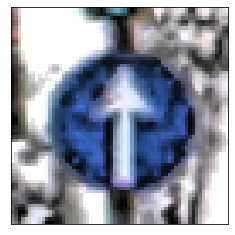

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


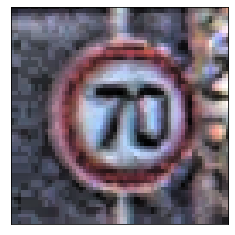

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


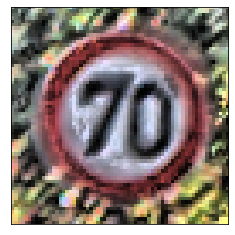

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


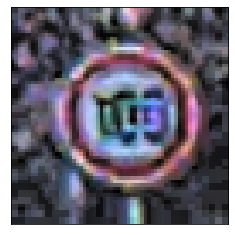

Original label:Yield, Prediction :Yield, confidence : 1.000


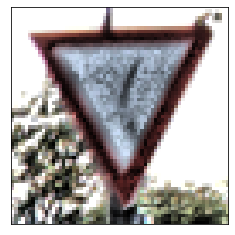

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


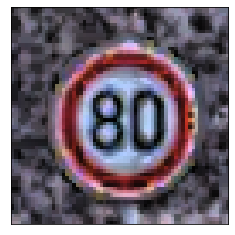

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 0.893


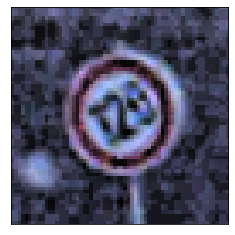

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


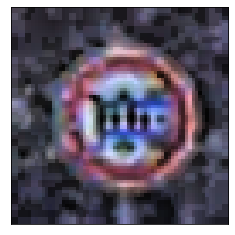

Original label:Priority road, Prediction :Priority road, confidence : 1.000


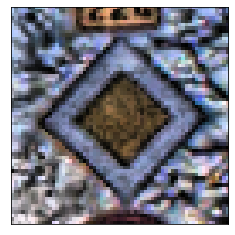

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


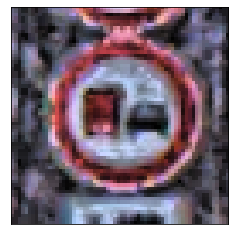

Original label:No passing, Prediction :No passing, confidence : 1.000


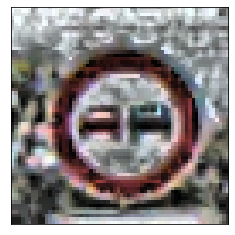

Original label:No vehicles, Prediction :No vehicles, confidence : 1.000


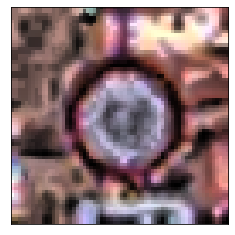

Original label:No vehicles, Prediction :No vehicles, confidence : 1.000


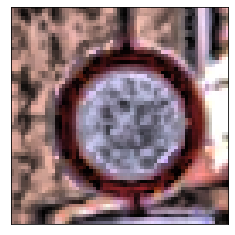

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


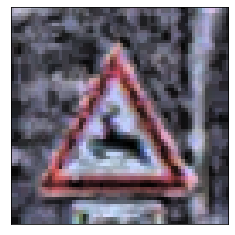

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


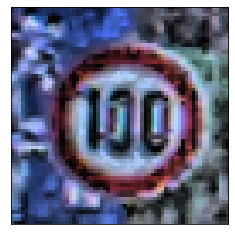

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


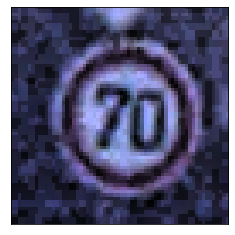

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


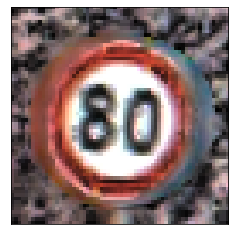

Original label:General caution, Prediction :General caution, confidence : 1.000


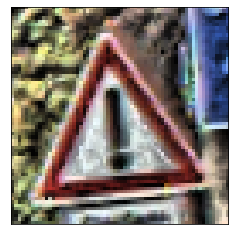

Original label:Keep right, Prediction :Keep right, confidence : 0.984


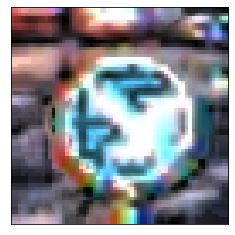

Original label:No vehicles, Prediction :No vehicles, confidence : 1.000


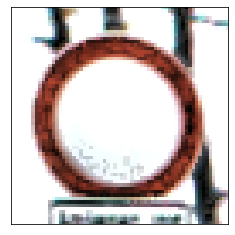

Original label:Yield, Prediction :Yield, confidence : 1.000


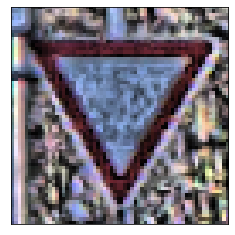

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


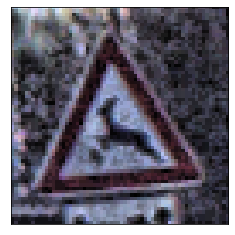

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.992


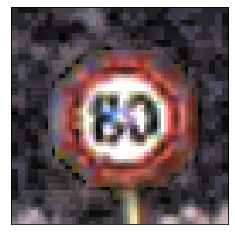

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.982


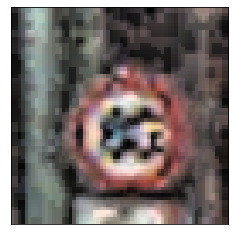

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


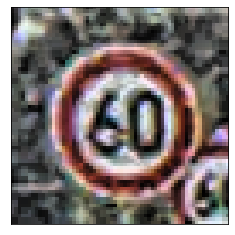

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


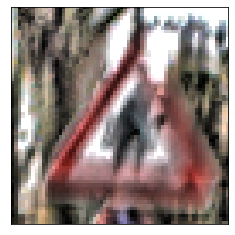

Original label:Keep right, Prediction :Keep right, confidence : 1.000


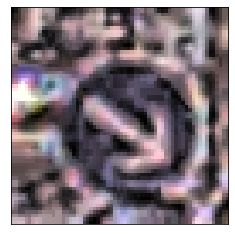

Original label:Yield, Prediction :Yield, confidence : 1.000


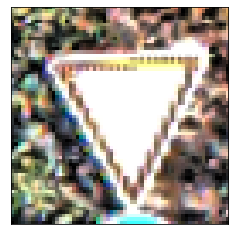

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


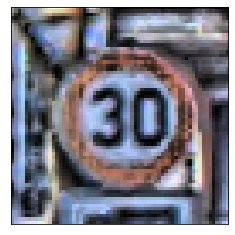

Original label:General caution, Prediction :General caution, confidence : 1.000


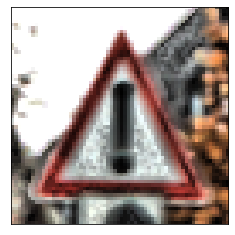

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


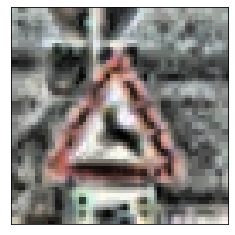

Original label:No vehicles, Prediction :No vehicles, confidence : 1.000


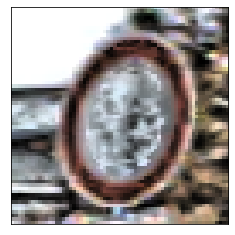

Original label:Bicycles crossing, Prediction :Bicycles crossing, confidence : 1.000


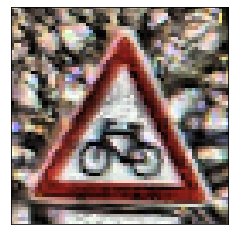

Original label:Yield, Prediction :Yield, confidence : 1.000


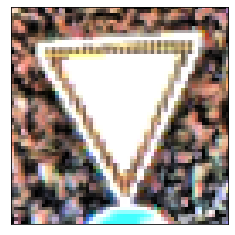

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


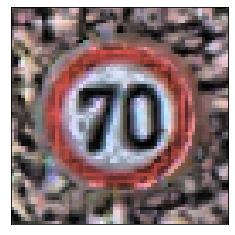

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


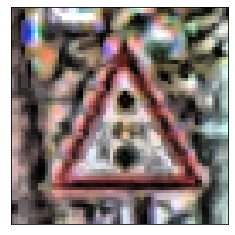

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


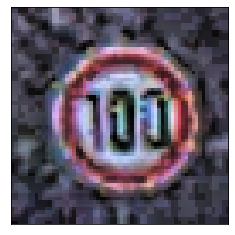

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


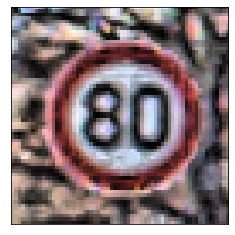

Original label:General caution, Prediction :General caution, confidence : 1.000


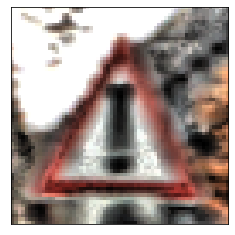

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


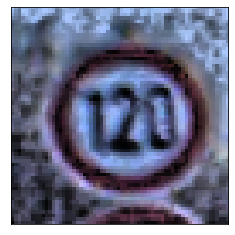

Original label:Stop, Prediction :Stop, confidence : 1.000


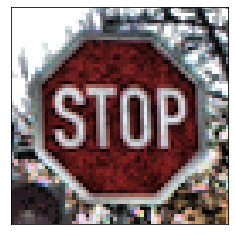

Original label:Bumpy road, Prediction :Bumpy road, confidence : 1.000


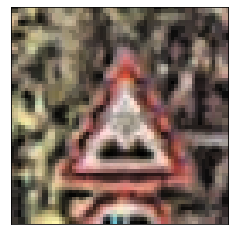

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


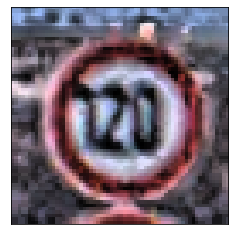

Original label:Stop, Prediction :Stop, confidence : 1.000


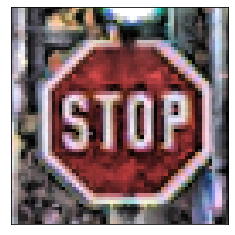

Original label:Traffic signals, Prediction :Traffic signals, confidence : 1.000


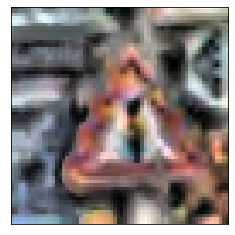

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


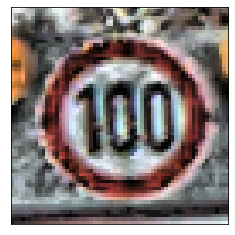

Original label:Yield, Prediction :Yield, confidence : 1.000


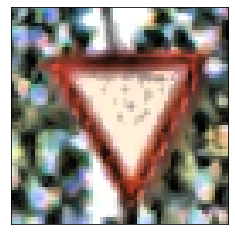

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 1.000


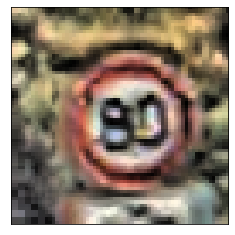

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


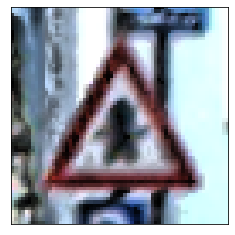

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


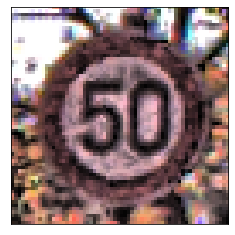

Original label:Roundabout mandatory, Prediction :Roundabout mandatory, confidence : 1.000


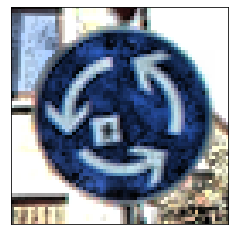

Original label:Veh > 3.5 tons prohibited, Prediction :Veh > 3.5 tons prohibited, confidence : 1.000


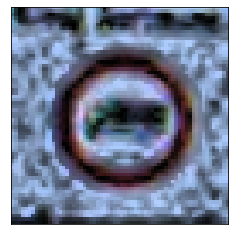

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


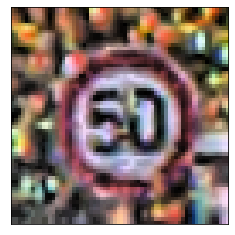

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


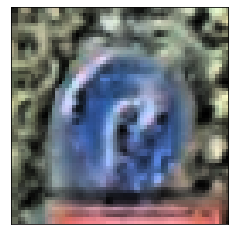

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


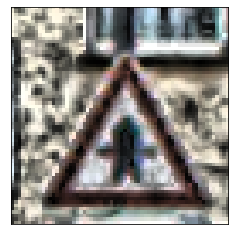

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


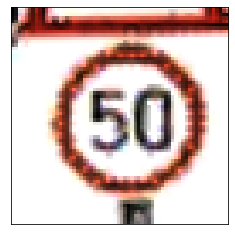

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


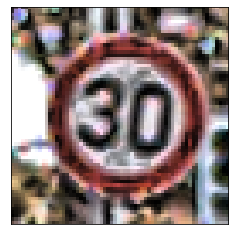

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


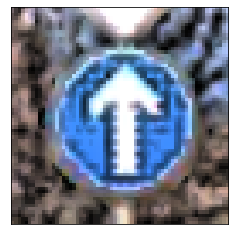

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


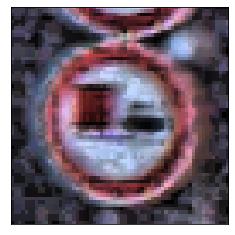

Original label:Yield, Prediction :Yield, confidence : 1.000


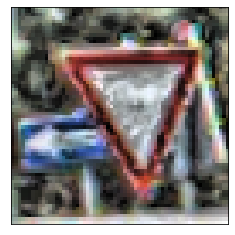

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 0.920


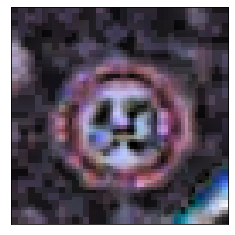

Original label:Go straight or left, Prediction :Go straight or left, confidence : 1.000


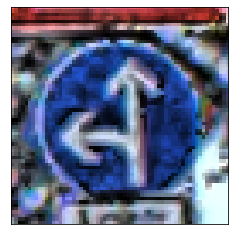

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


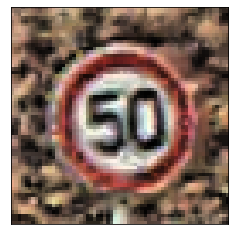

Original label:Priority road, Prediction :Priority road, confidence : 1.000


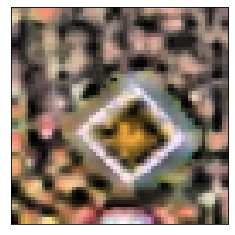

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


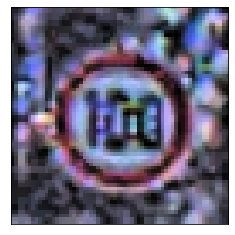

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


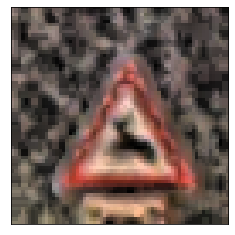

Original label:Pedestrians, Prediction :Pedestrians, confidence : 0.999


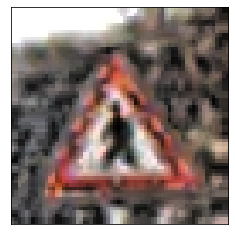

Original label:Right-of-way at intersection, Prediction :Right-of-way at intersection, confidence : 1.000


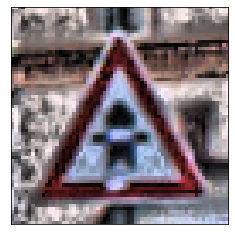

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.952


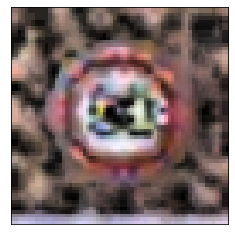

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


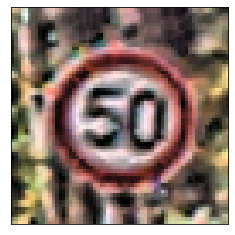

Original label:Road work, Prediction :Road work, confidence : 1.000


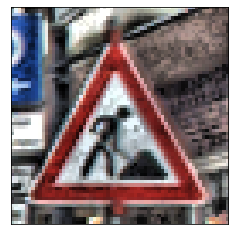

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


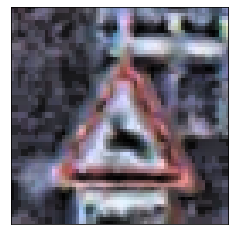

Original label:Priority road, Prediction :Priority road, confidence : 1.000


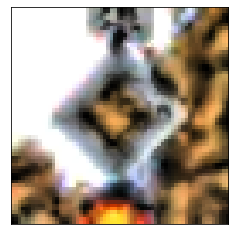

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


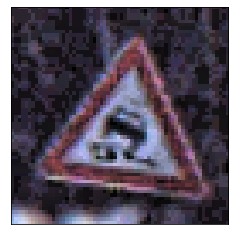

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


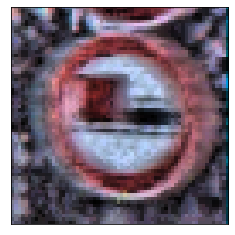

Original label:Go straight or left, Prediction :Go straight or left, confidence : 1.000


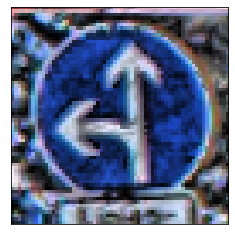

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


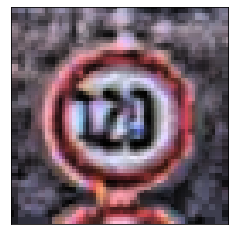

Original label:Slippery road, Prediction :Slippery road, confidence : 1.000


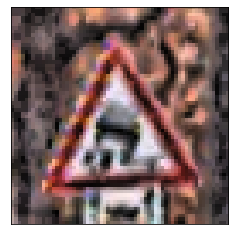

Original label:Road work, Prediction :Road work, confidence : 1.000


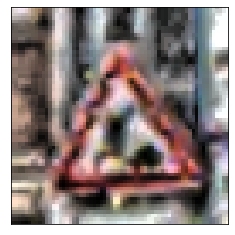

Original label:Road narrows on the right, Prediction :Road narrows on the right, confidence : 0.998


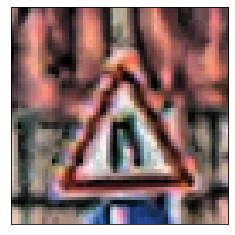

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


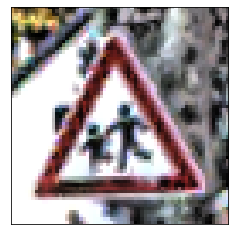

Original label:Road work, Prediction :Road work, confidence : 0.966


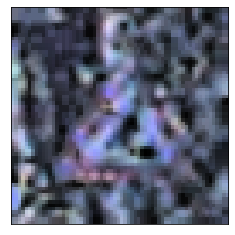

Original label:No passing, Prediction :No passing, confidence : 1.000


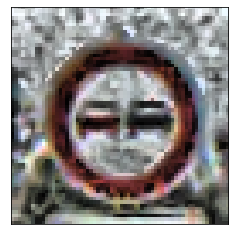

Original label:Road work, Prediction :Road work, confidence : 1.000


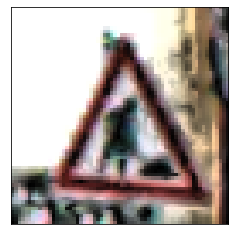

Original label:Road work, Prediction :Road work, confidence : 1.000


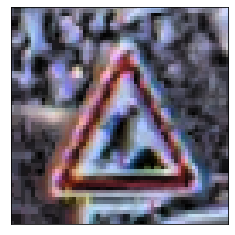

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


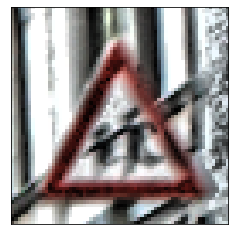

Original label:Dangerous curve left, Prediction :Dangerous curve left, confidence : 1.000


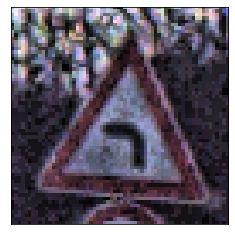

Original label:Road work, Prediction :Road work, confidence : 1.000


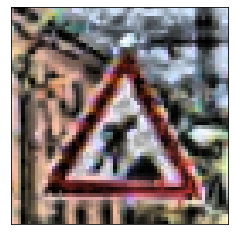

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 1.000


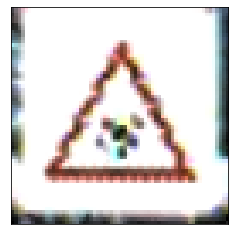

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


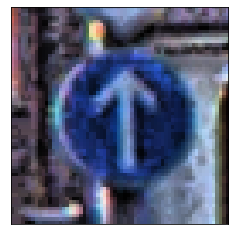

Original label:Speed limit (50km/h), Prediction :Speed limit (50km/h), confidence : 1.000


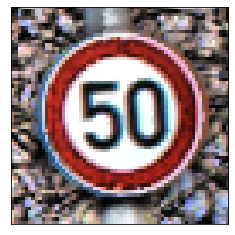

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


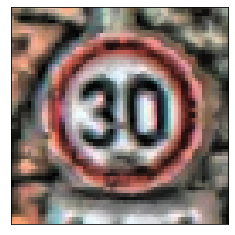

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


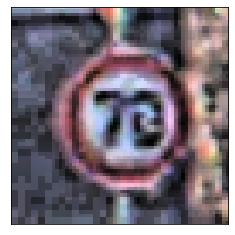

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


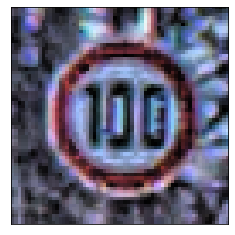

Original label:Speed limit (60km/h), Prediction :Speed limit (60km/h), confidence : 1.000


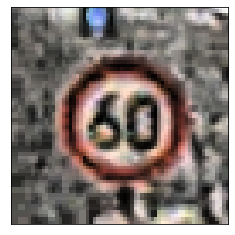

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


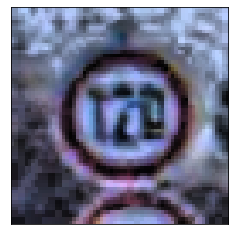

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


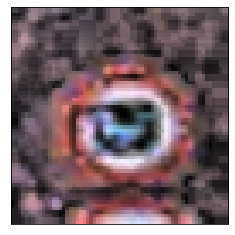

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


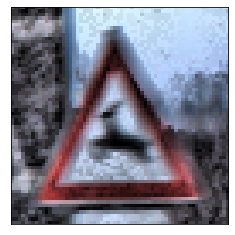

Original label:Keep right, Prediction :Keep right, confidence : 1.000


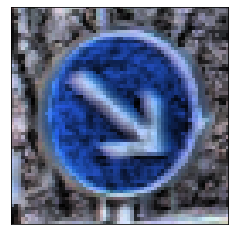

Original label:Wild animals crossing, Prediction :Wild animals crossing, confidence : 1.000


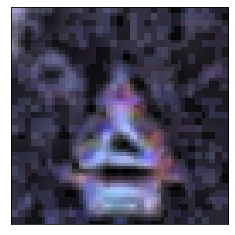

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


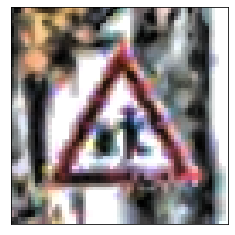

Original label:Stop, Prediction :Stop, confidence : 1.000


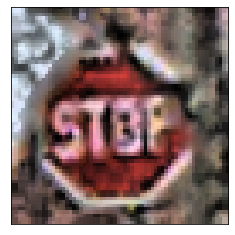

Original label:Speed limit (120km/h), Prediction :Speed limit (120km/h), confidence : 1.000


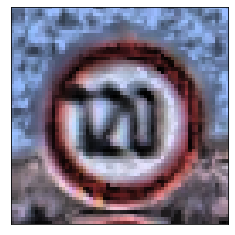

Original label:Keep right, Prediction :Keep right, confidence : 1.000


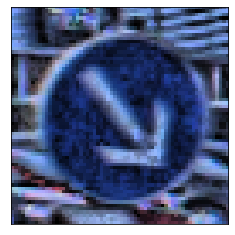

Original label:No passing, Prediction :No passing, confidence : 1.000


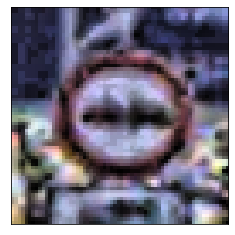

Original label:Ahead only, Prediction :Ahead only, confidence : 1.000


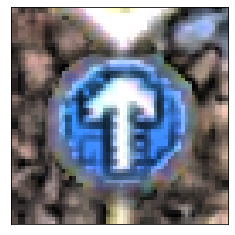

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


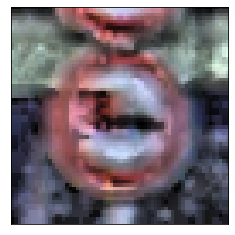

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 1.000


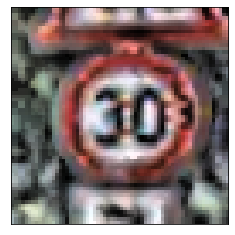

Original label:Children crossing, Prediction :Children crossing, confidence : 1.000


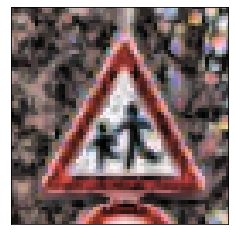

Original label:Speed limit (100km/h), Prediction :Speed limit (100km/h), confidence : 1.000


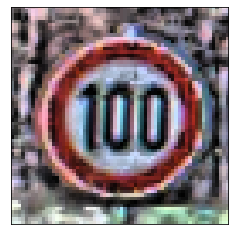

Original label:Speed limit (80km/h), Prediction :Speed limit (80km/h), confidence : 0.996


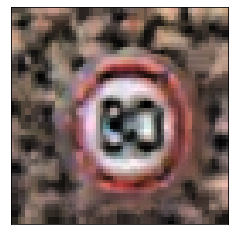

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


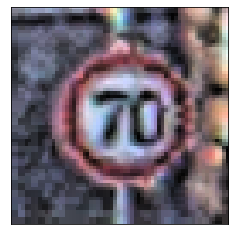

Original label:Priority road, Prediction :Priority road, confidence : 1.000


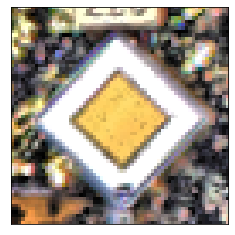

Original label:Road work, Prediction :Road work, confidence : 1.000


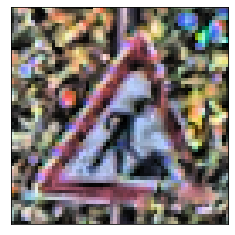

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 0.993


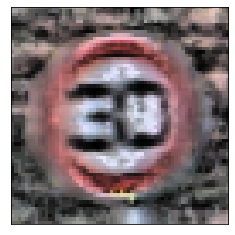

Original label:Priority road, Prediction :Priority road, confidence : 1.000


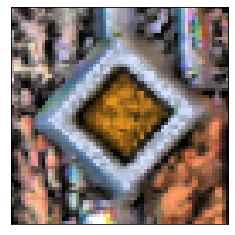

Original label:Speed limit (70km/h), Prediction :Speed limit (70km/h), confidence : 1.000


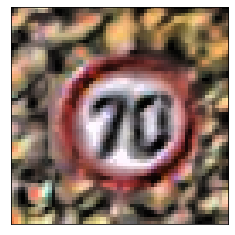

Original label:Beware of ice/snow, Prediction :Beware of ice/snow, confidence : 0.996


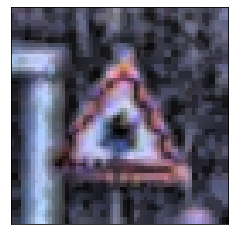

Original label:Road work, Prediction :Road work, confidence : 1.000


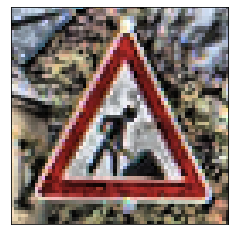

Original label:Turn right ahead, Prediction :Turn right ahead, confidence : 1.000


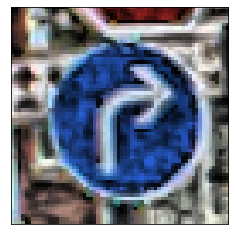

Original label:Speed limit (30km/h), Prediction :Speed limit (30km/h), confidence : 0.999


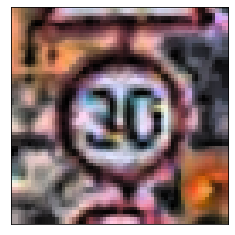

Original label:Pedestrians, Prediction :Pedestrians, confidence : 0.867


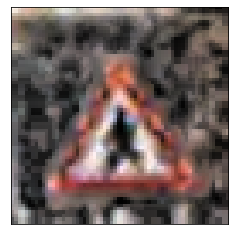

Original label:Yield, Prediction :Yield, confidence : 1.000


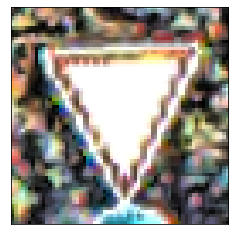

Original label:End of speed limit (80km/h), Prediction :End of speed limit (80km/h), confidence : 1.000


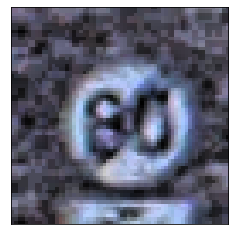

Original label:No passing veh over 3.5 tons, Prediction :No passing veh over 3.5 tons, confidence : 1.000


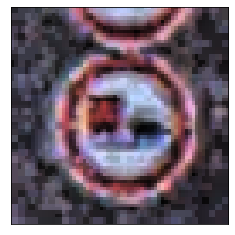

In [21]:
# Find the some images that were predicted correctly and who the images along with the predicted class
for i in range(500):
    pred_class = np.argmax(prob1[correct1[i]])
    pred_label = classes[pred_class]
    
    print('Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        list(classes.values())[test_labels.argmax(axis=1)[correct1[i]]],
        pred_label,
        prob1[correct1[i]][pred_class]))
    
    plt.imshow(test_img[correct1[i]])
    plt.xticks([]),plt.yticks([])
    plt.show()

In [22]:
errors1 = np.where(predictions1 != test_labels.argmax(axis=1))[0]
print("No of errors = {}/{}".format(len(errors1),12630))

No of errors = 319/12630


Original label:Priority road, Prediction :Yield, confidence : 1.000


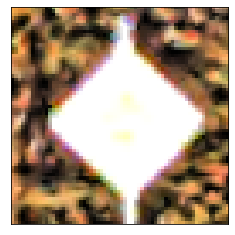

Original label:Road work, Prediction :Right-of-way at intersection, confidence : 0.691


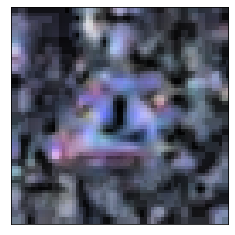

Original label:Speed limit (30km/h), Prediction :No vehicles, confidence : 0.995


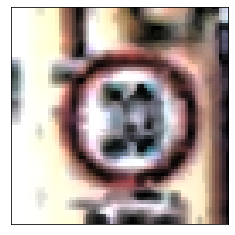

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


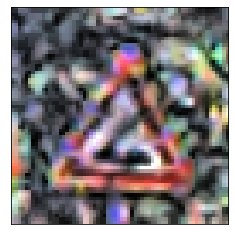

Original label:Right-of-way at intersection, Prediction :Road work, confidence : 0.360


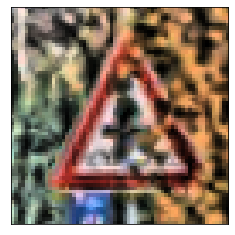

Original label:Bumpy road, Prediction :Road work, confidence : 1.000


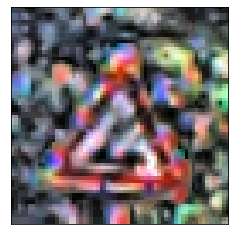

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.914


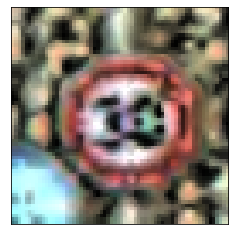

Original label:Ahead only, Prediction :Keep right, confidence : 0.950


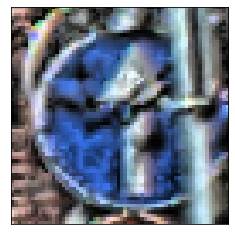

Original label:Speed limit (50km/h), Prediction :Speed limit (20km/h), confidence : 0.386


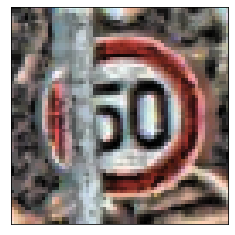

Original label:Priority road, Prediction :Slippery road, confidence : 0.454


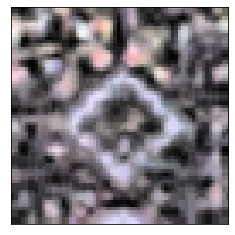

Original label:Pedestrians, Prediction :Road work, confidence : 0.896


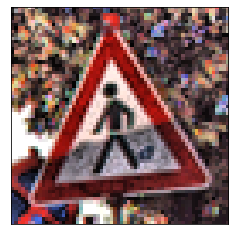

Original label:Traffic signals, Prediction :Beware of ice/snow, confidence : 0.904


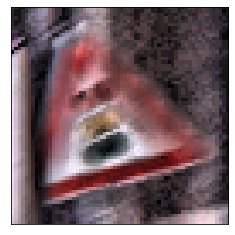

Original label:Road narrows on the right, Prediction :Pedestrians, confidence : 0.385


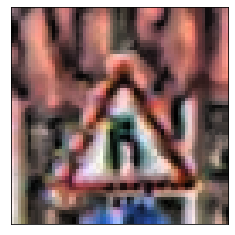

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.883


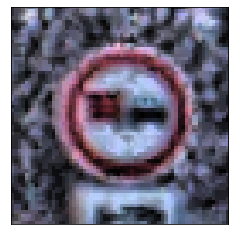

Original label:Speed limit (70km/h), Prediction :Speed limit (100km/h), confidence : 0.469


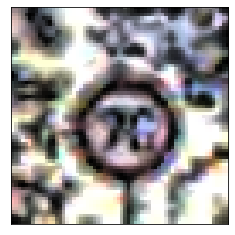

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.592


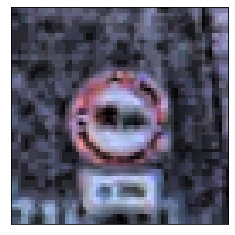

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.575


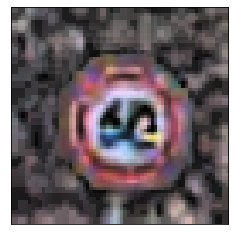

Original label:Speed limit (60km/h), Prediction :Speed limit (50km/h), confidence : 0.926


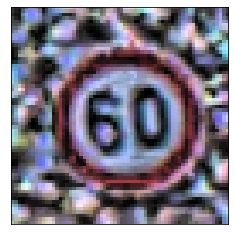

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.966


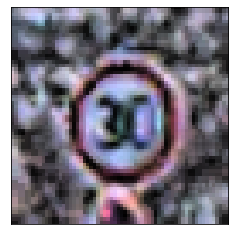

Original label:Priority road, Prediction :Yield, confidence : 1.000


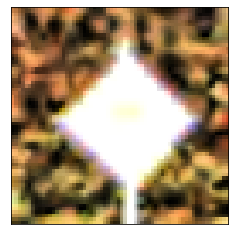

Original label:Speed limit (30km/h), Prediction :Speed limit (120km/h), confidence : 0.552


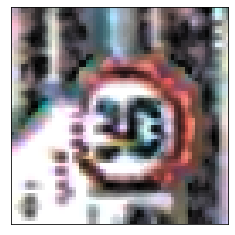

Original label:Roundabout mandatory, Prediction :Go straight or left, confidence : 0.987


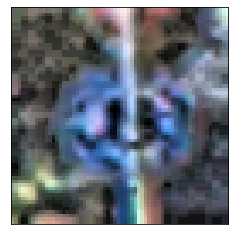

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.809


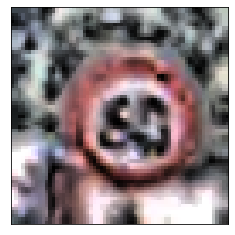

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.884


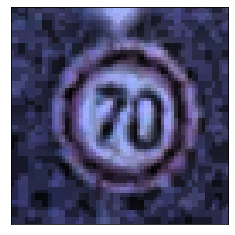

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.995


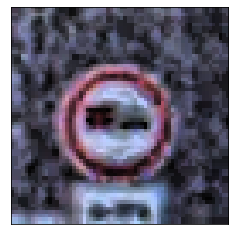

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.648


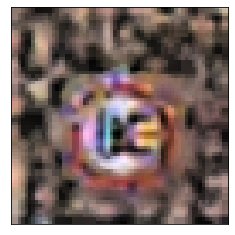

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.998


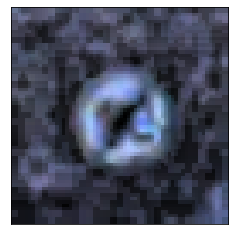

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.959


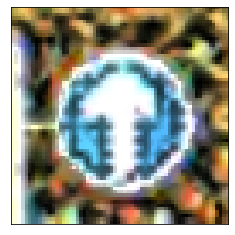

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.764


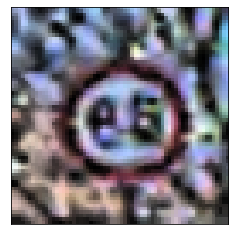

Original label:Bumpy road, Prediction :Bicycles crossing, confidence : 0.732


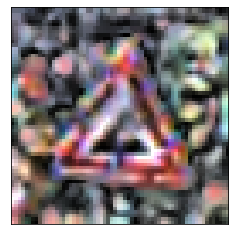

Original label:Priority road, Prediction :Yield, confidence : 0.605


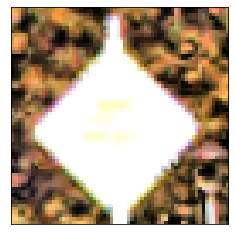

Original label:Bumpy road, Prediction :Bicycles crossing, confidence : 0.971


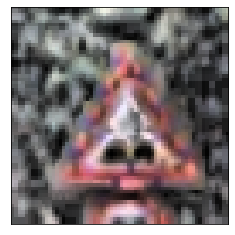

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.768


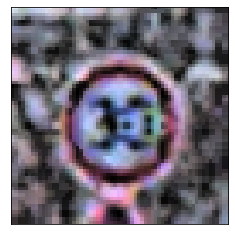

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.918


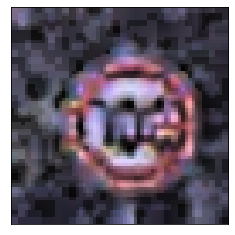

Original label:End no passing veh > 3.5 tons, Prediction :General caution, confidence : 0.683


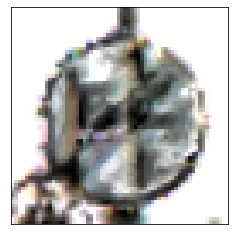

Original label:Priority road, Prediction :Yield, confidence : 0.996


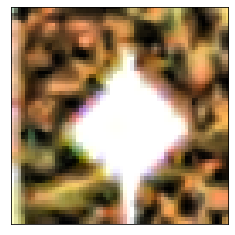

Original label:Bumpy road, Prediction :Road work, confidence : 0.994


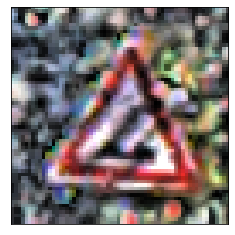

Original label:End no passing veh > 3.5 tons, Prediction :Right-of-way at intersection, confidence : 0.148


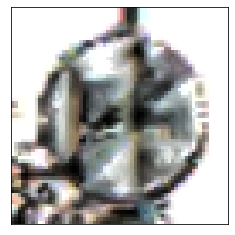

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.996


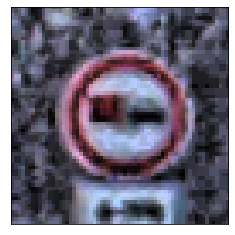

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.711


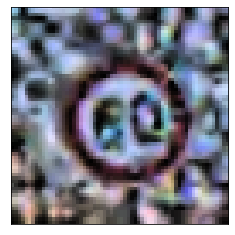

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.991


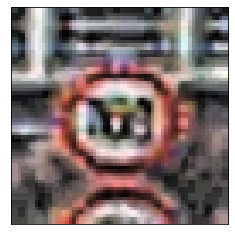

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.973


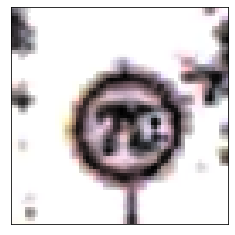

Original label:Road narrows on the right, Prediction :Pedestrians, confidence : 0.439


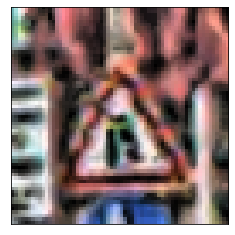

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.995


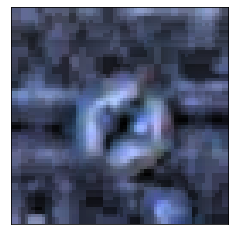

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.999


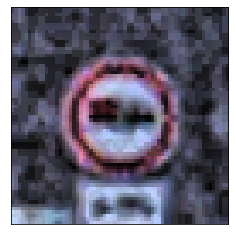

Original label:End no passing veh > 3.5 tons, Prediction :Ahead only, confidence : 0.254


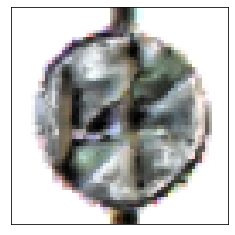

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.681


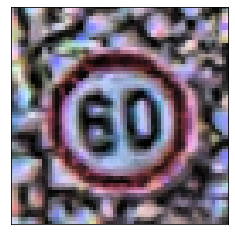

Original label:General caution, Prediction :Road work, confidence : 0.958


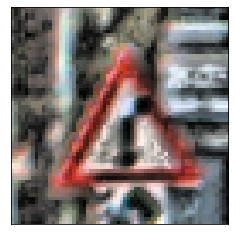

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 1.000


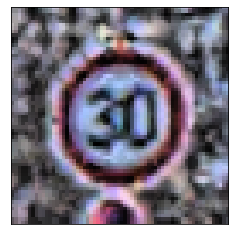

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.702


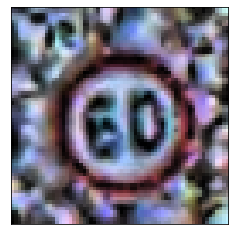

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.986


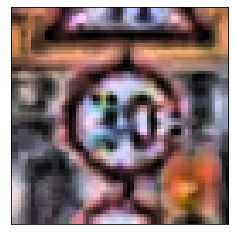

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.544


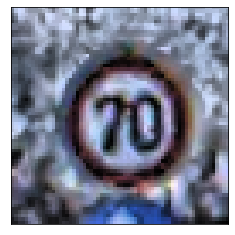

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.551


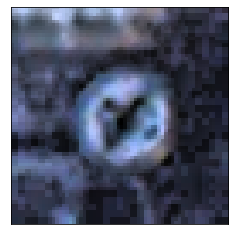

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.899


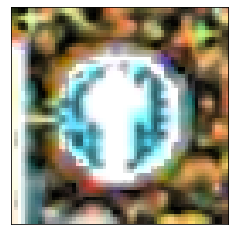

Original label:Right-of-way at intersection, Prediction :Road work, confidence : 0.578


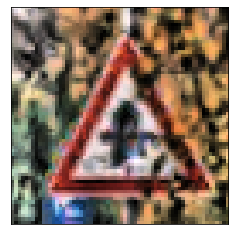

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.665


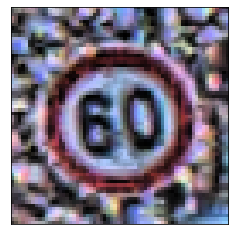

Original label:Priority road, Prediction :Keep right, confidence : 0.837


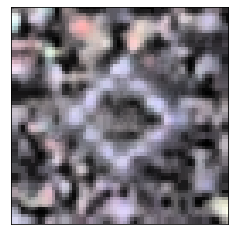

Original label:Right-of-way at intersection, Prediction :Pedestrians, confidence : 0.656


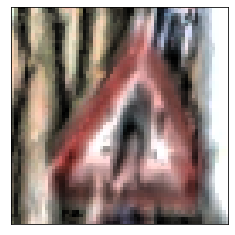

Original label:Pedestrians, Prediction :Road work, confidence : 0.527


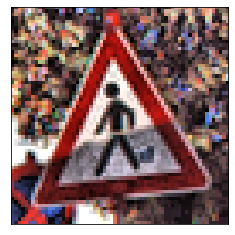

Original label:Speed limit (50km/h), Prediction :Speed limit (80km/h), confidence : 0.880


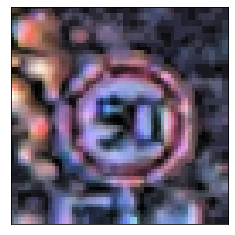

Original label:Speed limit (50km/h), Prediction :Speed limit (100km/h), confidence : 0.807


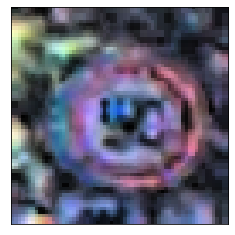

Original label:Bumpy road, Prediction :Road work, confidence : 0.998


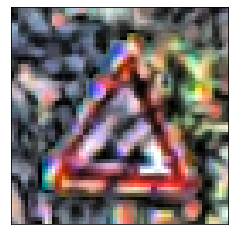

Original label:Ahead only, Prediction :No passing, confidence : 0.814


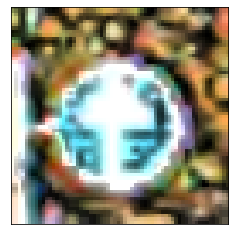

Original label:Turn right ahead, Prediction :Keep left, confidence : 0.999


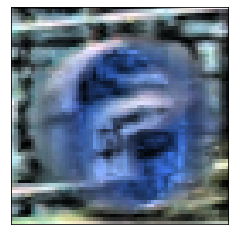

Original label:Speed limit (100km/h), Prediction :Speed limit (80km/h), confidence : 0.667


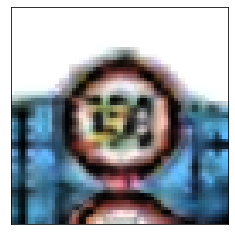

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.983


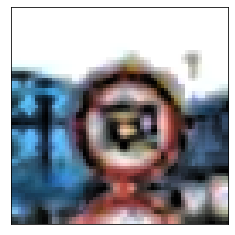

Original label:Speed limit (50km/h), Prediction :Speed limit (80km/h), confidence : 0.351


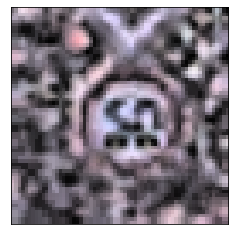

Original label:Children crossing, Prediction :Bicycles crossing, confidence : 0.918


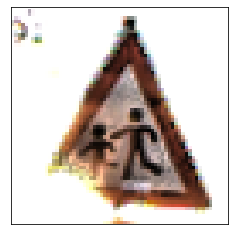

Original label:Ahead only, Prediction :No passing, confidence : 0.679


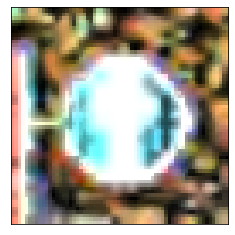

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.942


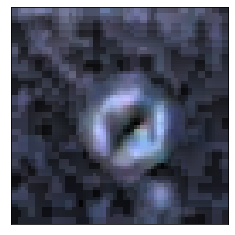

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.963


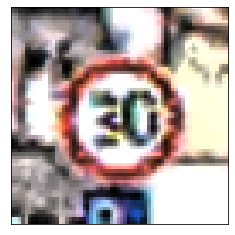

Original label:Ahead only, Prediction :No passing, confidence : 0.325


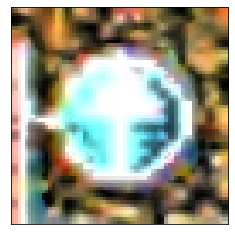

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.990


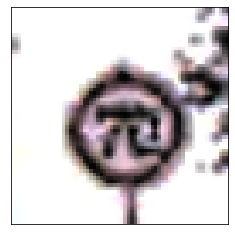

Original label:Pedestrians, Prediction :Road work, confidence : 0.995


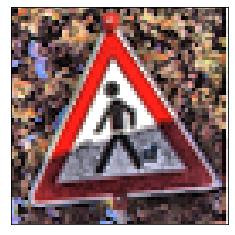

Original label:End of speed limit (80km/h), Prediction :Beware of ice/snow, confidence : 0.229


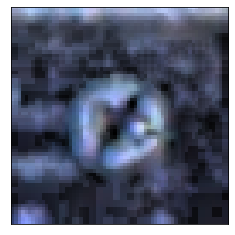

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.854


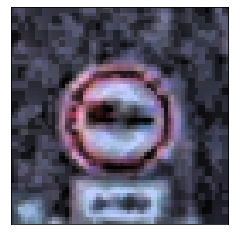

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.914


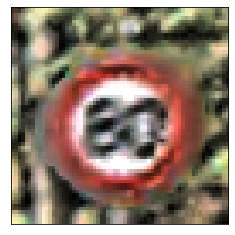

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.404


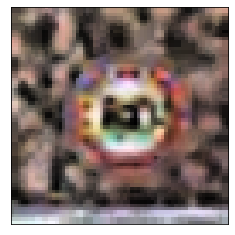

Original label:Speed limit (70km/h), Prediction :Speed limit (30km/h), confidence : 0.600


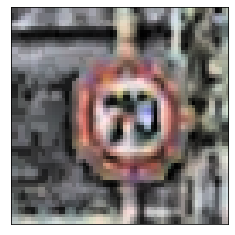

Original label:Roundabout mandatory, Prediction :Speed limit (100km/h), confidence : 0.831


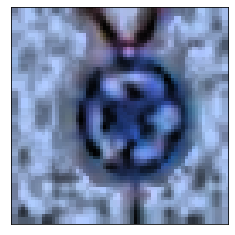

Original label:Bumpy road, Prediction :Bicycles crossing, confidence : 0.703


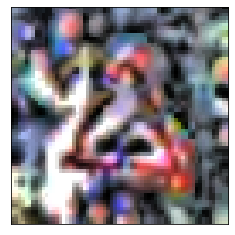

Original label:End of speed limit (80km/h), Prediction :Beware of ice/snow, confidence : 0.720


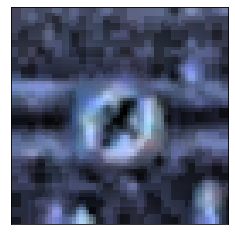

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.994


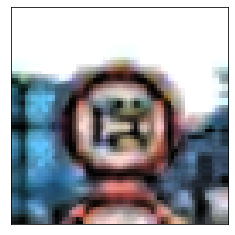

Original label:Speed limit (30km/h), Prediction :Speed limit (120km/h), confidence : 0.969


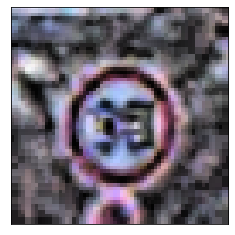

Original label:Priority road, Prediction :Yield, confidence : 0.825


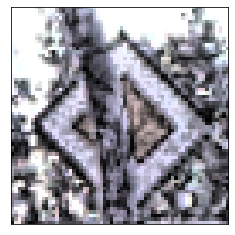

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.861


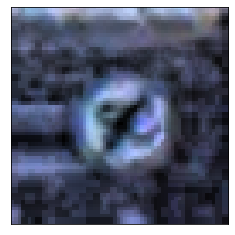

Original label:Right-of-way at intersection, Prediction :Beware of ice/snow, confidence : 0.681


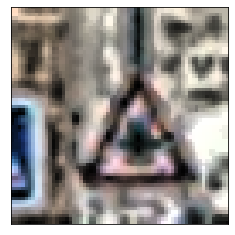

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.986


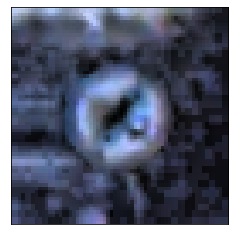

Original label:General caution, Prediction :Pedestrians, confidence : 0.742


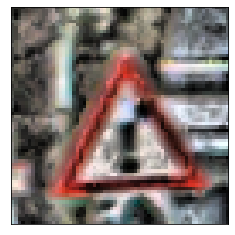

Original label:Speed limit (80km/h), Prediction :Speed limit (120km/h), confidence : 0.785


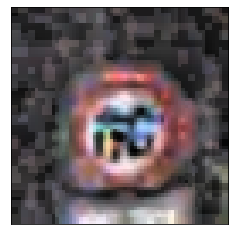

Original label:Speed limit (20km/h), Prediction :Speed limit (120km/h), confidence : 0.999


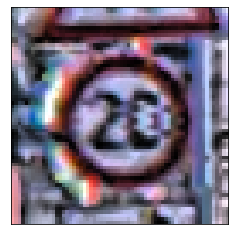

Original label:Bumpy road, Prediction :Road work, confidence : 0.743


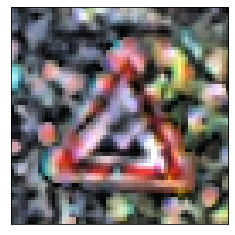

Original label:General caution, Prediction :Road work, confidence : 0.578


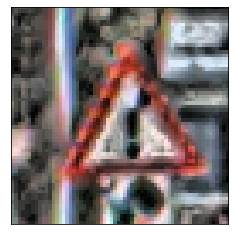

Original label:Speed limit (30km/h), Prediction :No passing, confidence : 0.436


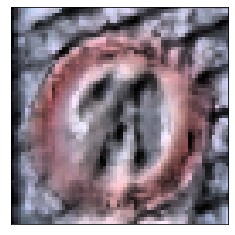

Original label:No passing veh over 3.5 tons, Prediction :Speed limit (120km/h), confidence : 0.481


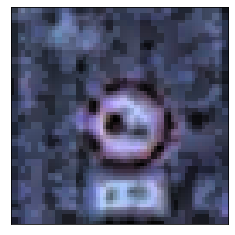

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.470


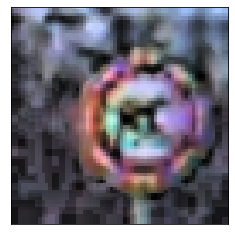

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.619


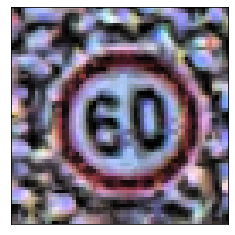

Original label:Turn right ahead, Prediction :Keep left, confidence : 0.333


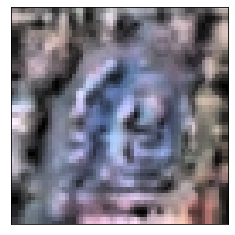

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.920


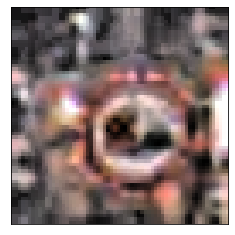

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.579


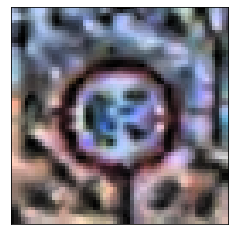

Original label:Speed limit (30km/h), Prediction :Speed limit (80km/h), confidence : 0.750


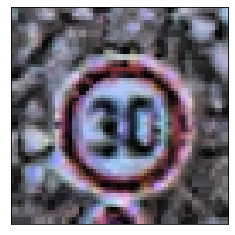

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.975


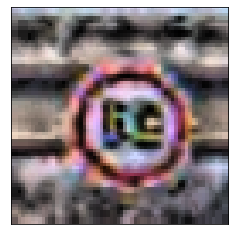

Original label:Priority road, Prediction :Yield, confidence : 1.000


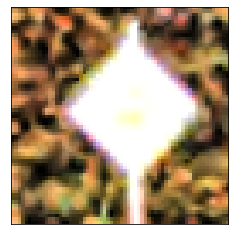

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.629


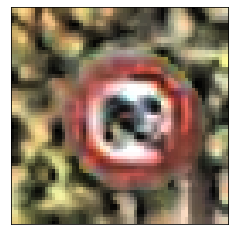

Original label:General caution, Prediction :Traffic signals, confidence : 1.000


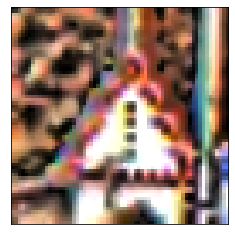

Original label:Speed limit (60km/h), Prediction :Speed limit (50km/h), confidence : 0.329


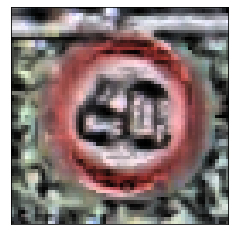

Original label:Keep right, Prediction :Go straight or right, confidence : 0.359


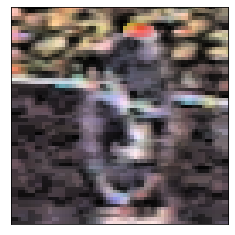

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.629


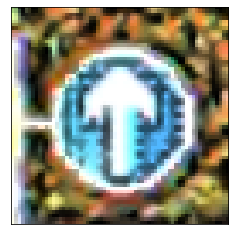

Original label:Speed limit (30km/h), Prediction :No vehicles, confidence : 0.486


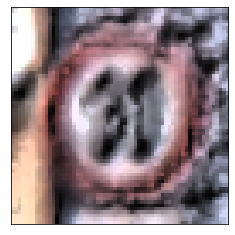

Original label:End no passing veh > 3.5 tons, Prediction :Road work, confidence : 0.173


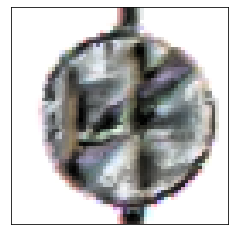

Original label:General caution, Prediction :Road work, confidence : 0.373


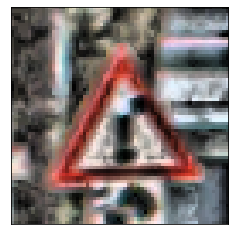

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.467


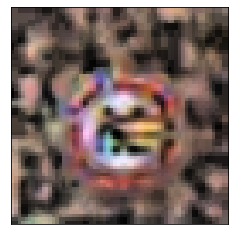

Original label:Speed limit (60km/h), Prediction :Speed limit (50km/h), confidence : 0.827


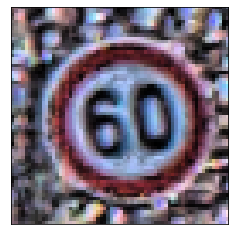

Original label:Turn right ahead, Prediction :Keep left, confidence : 0.950


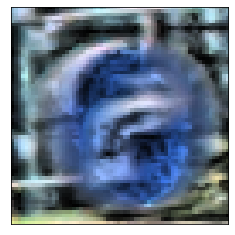

Original label:End no passing veh > 3.5 tons, Prediction :Yield, confidence : 0.201


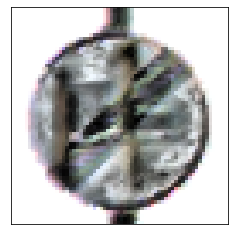

Original label:Speed limit (30km/h), Prediction :No vehicles, confidence : 0.642


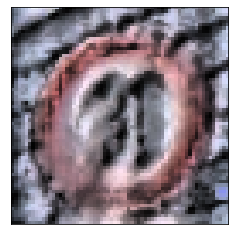

Original label:Speed limit (30km/h), Prediction :Speed limit (120km/h), confidence : 0.949


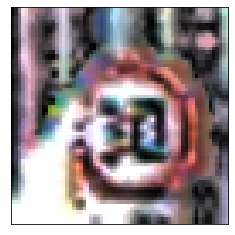

Original label:General caution, Prediction :Right-of-way at intersection, confidence : 0.427


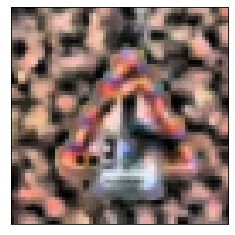

Original label:Priority road, Prediction :Yield, confidence : 0.997


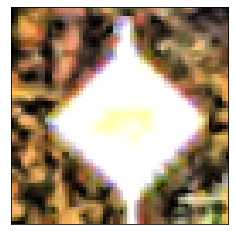

Original label:No vehicles, Prediction :No passing, confidence : 0.510


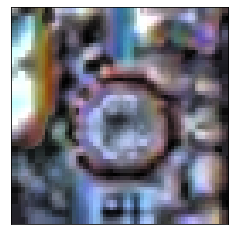

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 1.000


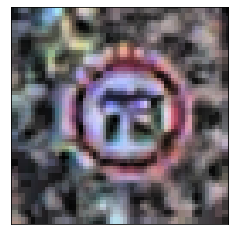

Original label:Speed limit (70km/h), Prediction :Speed limit (100km/h), confidence : 0.900


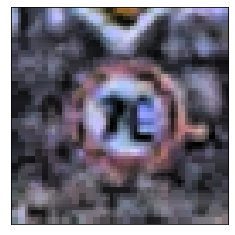

Original label:General caution, Prediction :Right-of-way at intersection, confidence : 0.368


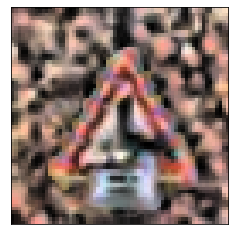

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.658


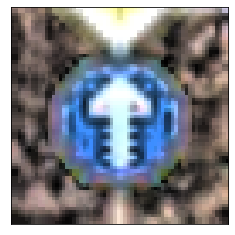

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.999


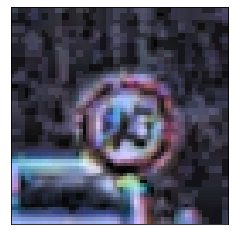

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.769


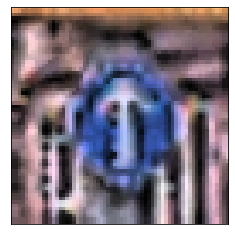

Original label:Pedestrians, Prediction :Road work, confidence : 0.622


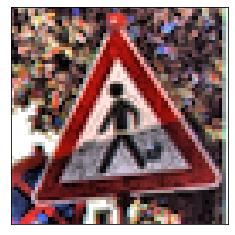

Original label:Speed limit (70km/h), Prediction :Speed limit (100km/h), confidence : 0.681


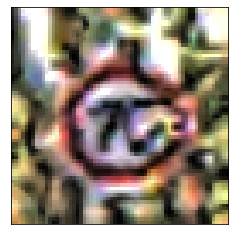

Original label:Speed limit (100km/h), Prediction :Speed limit (80km/h), confidence : 0.821


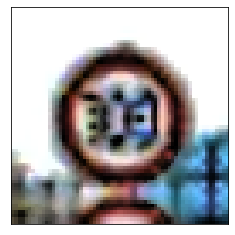

Original label:End no passing veh > 3.5 tons, Prediction :End of no passing, confidence : 0.861


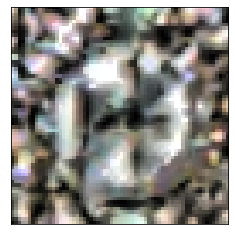

Original label:Speed limit (80km/h), Prediction :Speed limit (120km/h), confidence : 0.793


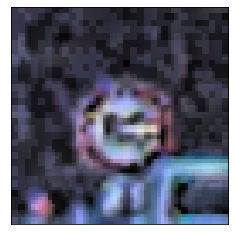

Original label:Priority road, Prediction :Yield, confidence : 0.998


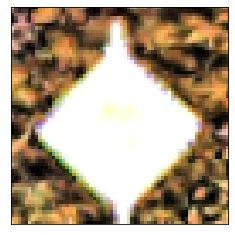

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 1.000


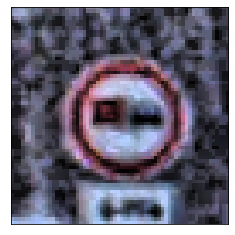

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.269


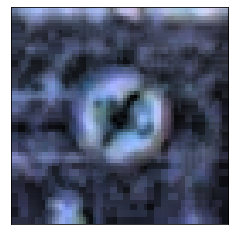

Original label:Speed limit (60km/h), Prediction :Speed limit (50km/h), confidence : 0.562


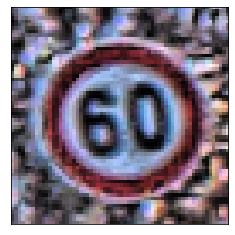

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.487


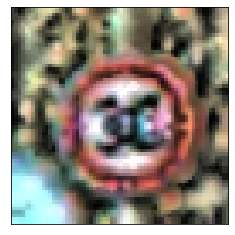

Original label:Right-of-way at intersection, Prediction :Pedestrians, confidence : 0.387


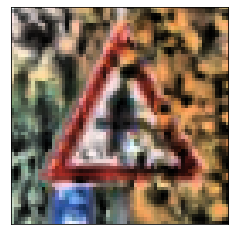

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.967


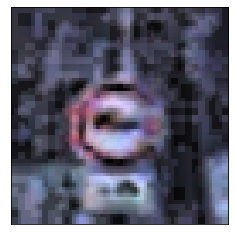

Original label:Right-of-way at intersection, Prediction :Beware of ice/snow, confidence : 0.920


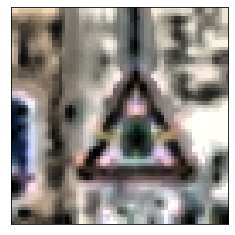

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.923


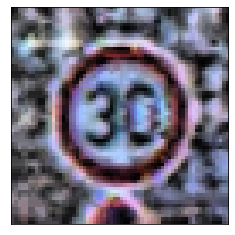

Original label:Traffic signals, Prediction :Dangerous curve right, confidence : 0.915


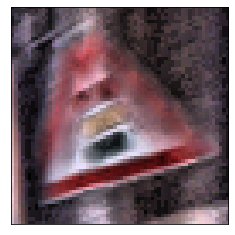

Original label:Bumpy road, Prediction :Road work, confidence : 0.999


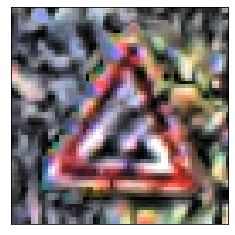

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.600


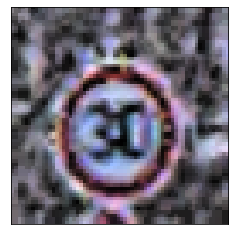

Original label:Speed limit (70km/h), Prediction :Keep left, confidence : 0.998


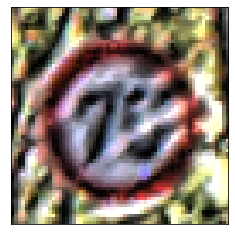

Original label:Speed limit (70km/h), Prediction :Speed limit (50km/h), confidence : 0.373


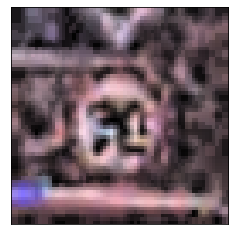

Original label:Speed limit (30km/h), Prediction :Speed limit (100km/h), confidence : 0.609


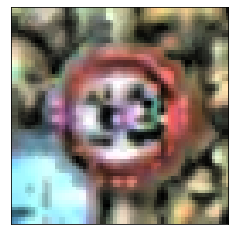

Original label:General caution, Prediction :Pedestrians, confidence : 0.370


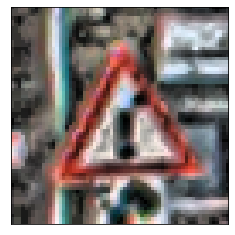

Original label:Priority road, Prediction :Yield, confidence : 1.000


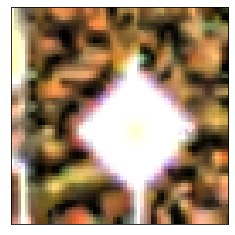

Original label:Bumpy road, Prediction :Road work, confidence : 0.869


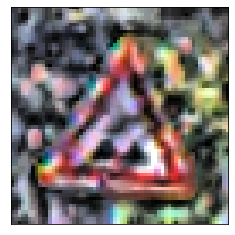

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.998


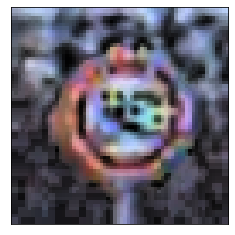

Original label:Speed limit (30km/h), Prediction :No vehicles, confidence : 0.945


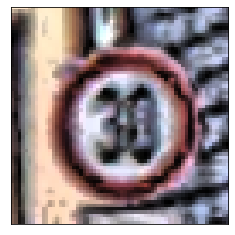

Original label:Priority road, Prediction :Yield, confidence : 0.988


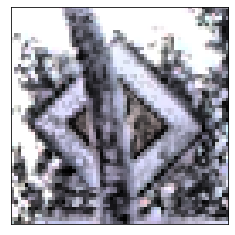

Original label:General caution, Prediction :Pedestrians, confidence : 0.556


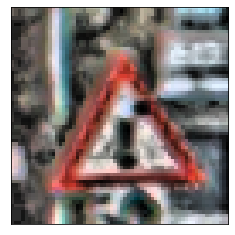

Original label:Speed limit (70km/h), Prediction :Speed limit (100km/h), confidence : 0.389


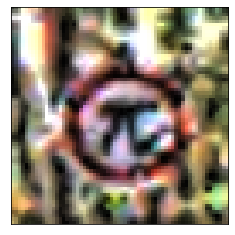

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.786


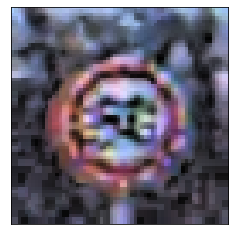

Original label:Priority road, Prediction :Yield, confidence : 1.000


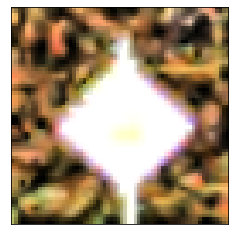

Original label:Speed limit (70km/h), Prediction :Speed limit (50km/h), confidence : 1.000


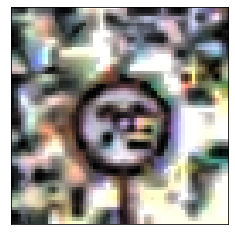

Original label:Road work, Prediction :Wild animals crossing, confidence : 0.870


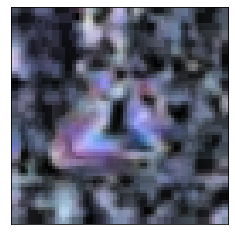

Original label:Traffic signals, Prediction :General caution, confidence : 0.613


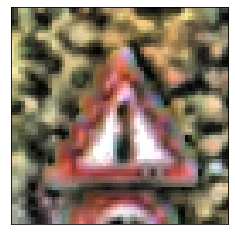

Original label:Beware of ice/snow, Prediction :Right-of-way at intersection, confidence : 0.996


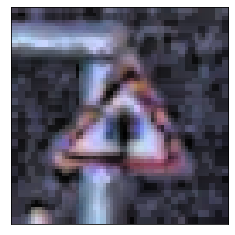

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.893


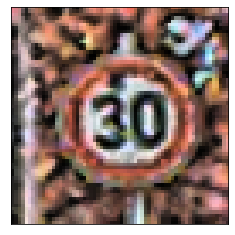

Original label:Stop, Prediction :No passing, confidence : 0.904


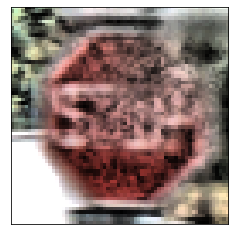

Original label:Priority road, Prediction :Yield, confidence : 0.997


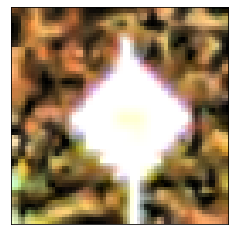

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.755


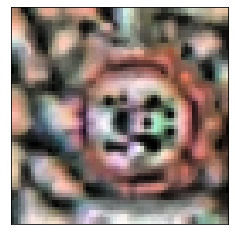

Original label:Traffic signals, Prediction :Beware of ice/snow, confidence : 0.848


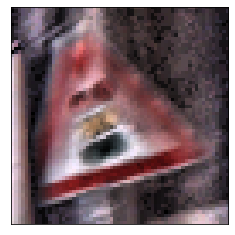

Original label:Bumpy road, Prediction :Bicycles crossing, confidence : 0.867


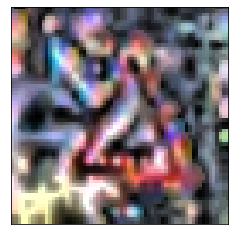

Original label:No passing, Prediction :Speed limit (50km/h), confidence : 0.910


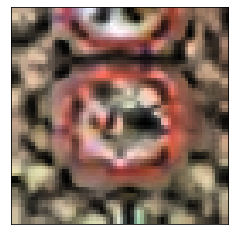

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.940


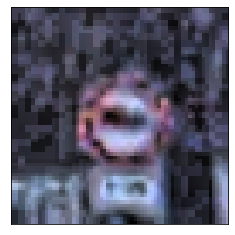

Original label:Children crossing, Prediction :Bicycles crossing, confidence : 0.599


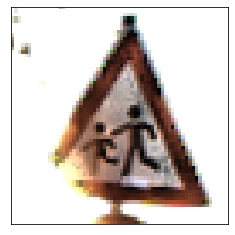

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.986


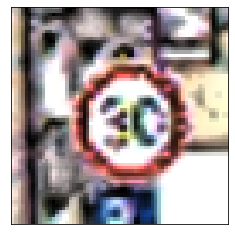

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.931


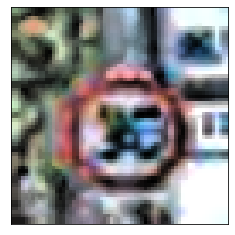

Original label:Priority road, Prediction :Yield, confidence : 1.000


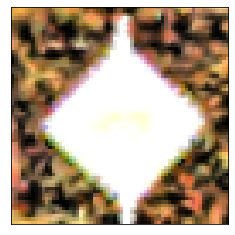

Original label:Speed limit (30km/h), Prediction :No vehicles, confidence : 0.969


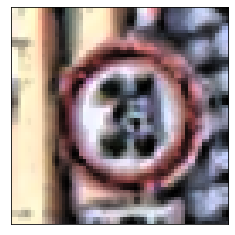

Original label:Roundabout mandatory, Prediction :Dangerous curve right, confidence : 0.420


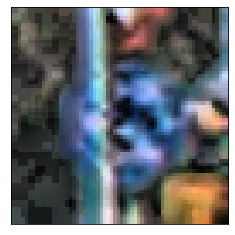

Original label:Speed limit (70km/h), Prediction :Speed limit (100km/h), confidence : 0.491


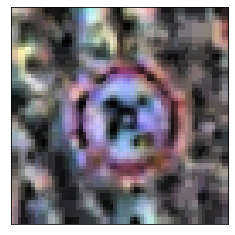

Original label:Road narrows on the right, Prediction :General caution, confidence : 0.408


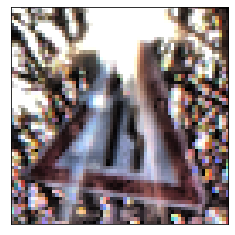

Original label:Priority road, Prediction :Yield, confidence : 0.999


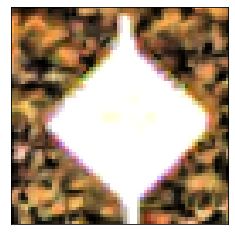

Original label:General caution, Prediction :Road work, confidence : 0.975


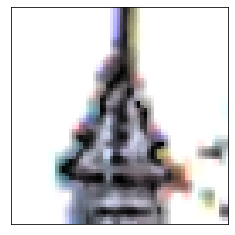

Original label:Speed limit (80km/h), Prediction :Speed limit (120km/h), confidence : 0.975


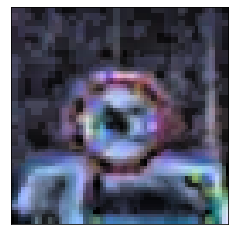

Original label:Traffic signals, Prediction :Right-of-way at intersection, confidence : 0.991


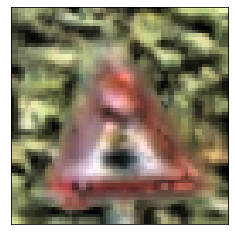

Original label:General caution, Prediction :Pedestrians, confidence : 0.386


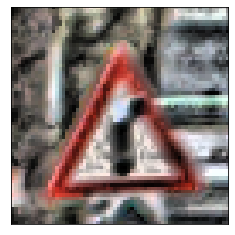

Original label:End no passing veh > 3.5 tons, Prediction :End of no passing, confidence : 0.880


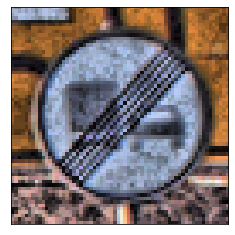

Original label:General caution, Prediction :Pedestrians, confidence : 0.556


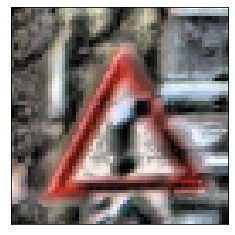

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.797


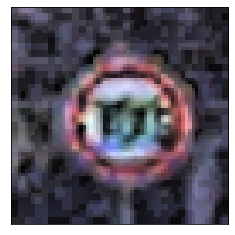

Original label:Speed limit (30km/h), Prediction :Speed limit (100km/h), confidence : 0.400


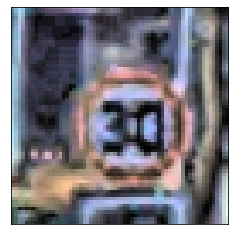

Original label:Priority road, Prediction :Yield, confidence : 0.889


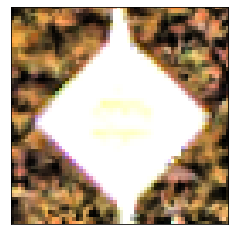

Original label:General caution, Prediction :Pedestrians, confidence : 0.350


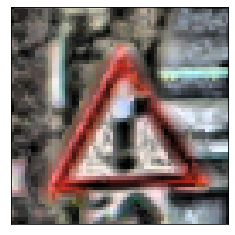

Original label:Speed limit (80km/h), Prediction :Speed limit (60km/h), confidence : 0.695


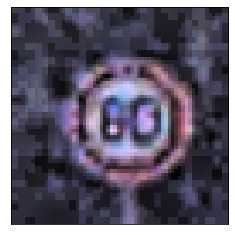

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.750


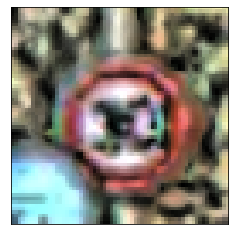

Original label:Speed limit (20km/h), Prediction :Speed limit (120km/h), confidence : 0.926


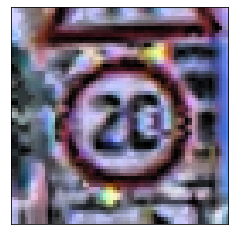

Original label:Double curve, Prediction :Wild animals crossing, confidence : 0.714


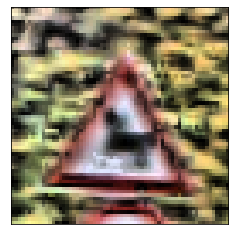

Original label:Priority road, Prediction :Yield, confidence : 0.214


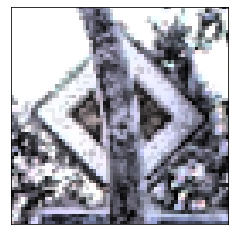

Original label:Priority road, Prediction :Yield, confidence : 1.000


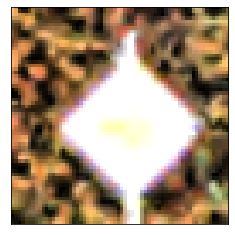

Original label:Priority road, Prediction :Speed limit (100km/h), confidence : 0.839


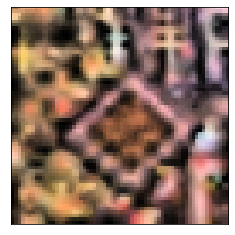

Original label:Speed limit (20km/h), Prediction :Speed limit (120km/h), confidence : 0.959


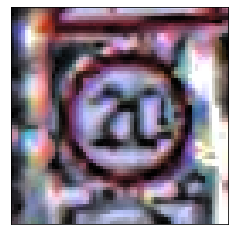

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.918


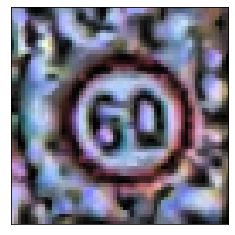

Original label:General caution, Prediction :Traffic signals, confidence : 0.395


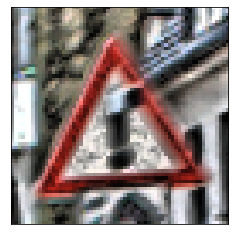

Original label:Speed limit (30km/h), Prediction :Speed limit (100km/h), confidence : 0.489


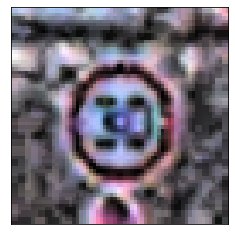

Original label:End no passing veh > 3.5 tons, Prediction :End of no passing, confidence : 0.704


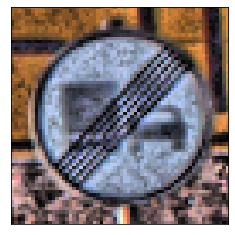

Original label:Ahead only, Prediction :Speed limit (60km/h), confidence : 0.416


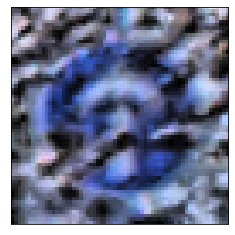

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.826


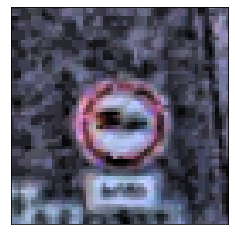

Original label:Speed limit (30km/h), Prediction :No vehicles, confidence : 0.956


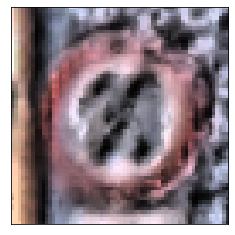

Original label:Priority road, Prediction :Yield, confidence : 1.000


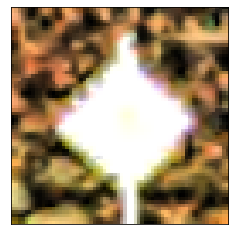

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.882


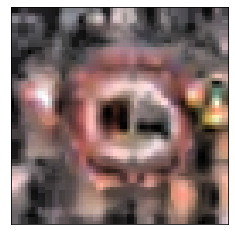

Original label:End no passing veh > 3.5 tons, Prediction :General caution, confidence : 0.479


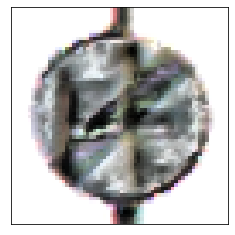

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.868


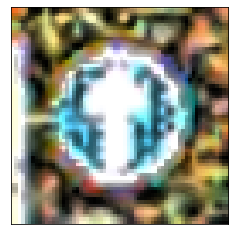

Original label:Roundabout mandatory, Prediction :Speed limit (100km/h), confidence : 0.436


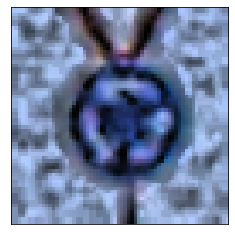

Original label:Speed limit (70km/h), Prediction :Speed limit (30km/h), confidence : 0.771


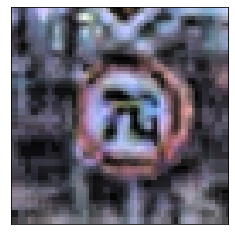

Original label:Roundabout mandatory, Prediction :No passing, confidence : 0.417


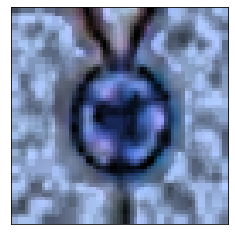

Original label:Priority road, Prediction :Yield, confidence : 0.999


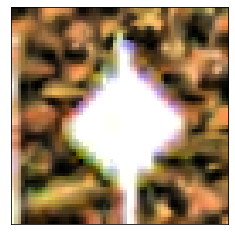

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.650


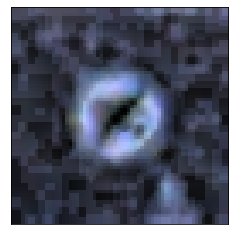

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.991


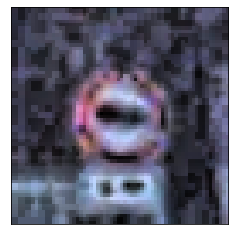

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.998


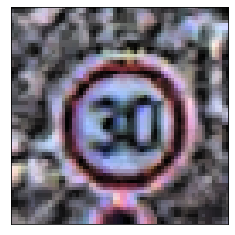

Original label:No passing veh over 3.5 tons, Prediction :Speed limit (120km/h), confidence : 0.994


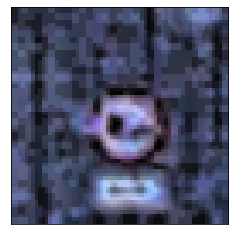

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 1.000


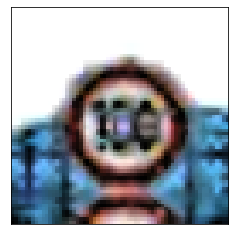

Original label:Priority road, Prediction :Yield, confidence : 0.562


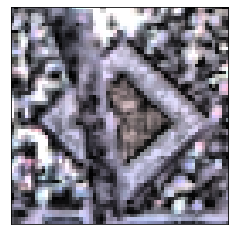

Original label:Priority road, Prediction :Yield, confidence : 1.000


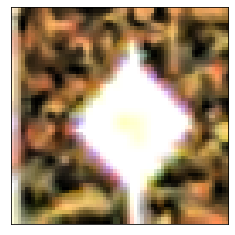

Original label:Speed limit (30km/h), Prediction :Speed limit (80km/h), confidence : 0.540


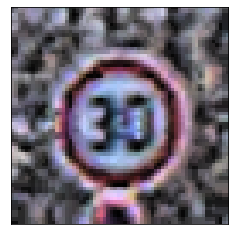

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.565


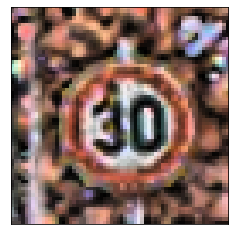

Original label:Speed limit (70km/h), Prediction :Speed limit (30km/h), confidence : 0.868


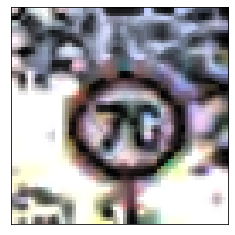

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.576


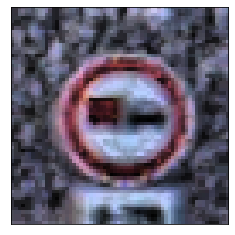

Original label:Ahead only, Prediction :No vehicles, confidence : 0.970


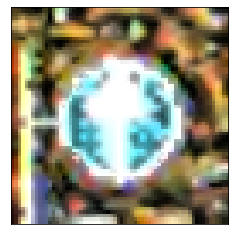

Original label:Roundabout mandatory, Prediction :Speed limit (100km/h), confidence : 0.752


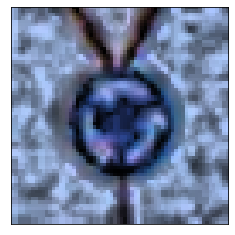

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.844


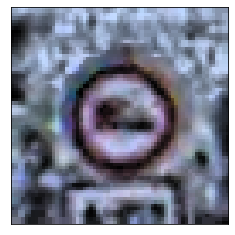

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.882


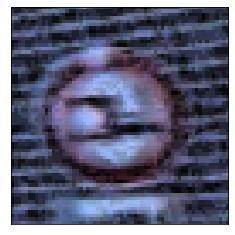

Original label:Priority road, Prediction :Yield, confidence : 0.986


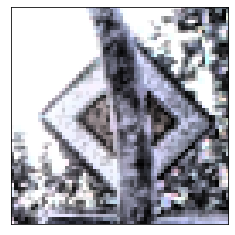

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.901


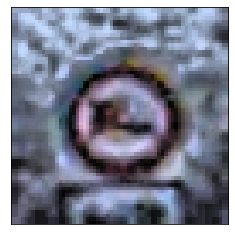

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.911


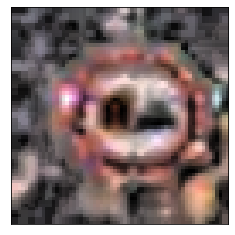

Original label:Speed limit (30km/h), Prediction :No vehicles, confidence : 0.957


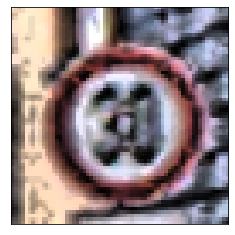

Original label:Speed limit (70km/h), Prediction :Keep left, confidence : 0.877


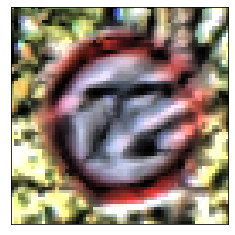

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.593


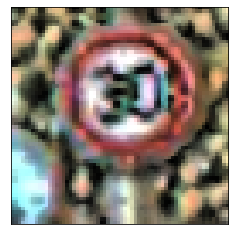

Original label:End no passing veh > 3.5 tons, Prediction :Bumpy road, confidence : 0.277


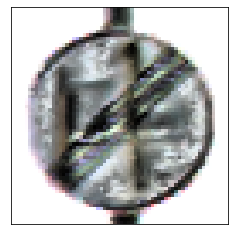

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.966


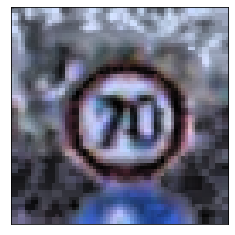

Original label:Speed limit (70km/h), Prediction :Speed limit (30km/h), confidence : 0.992


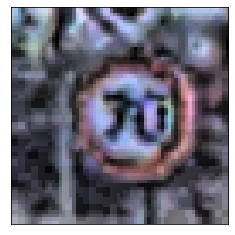

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 1.000


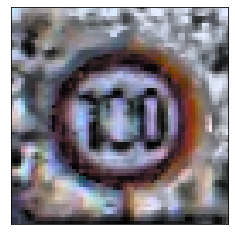

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.565


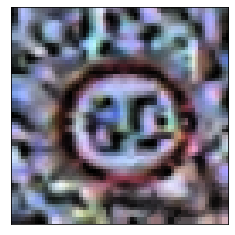

Original label:Speed limit (70km/h), Prediction :Speed limit (100km/h), confidence : 0.832


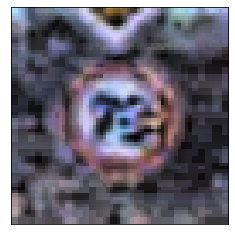

Original label:Speed limit (30km/h), Prediction :Speed limit (80km/h), confidence : 0.827


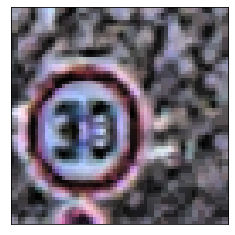

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.568


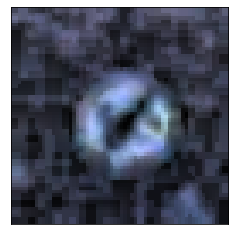

Original label:Priority road, Prediction :Yield, confidence : 1.000


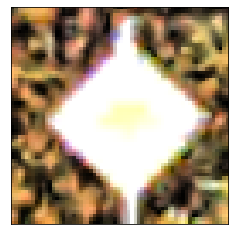

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.952


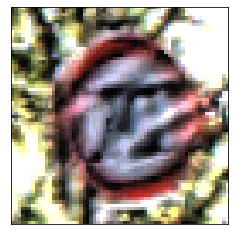

Original label:Road work, Prediction :Right-of-way at intersection, confidence : 0.950


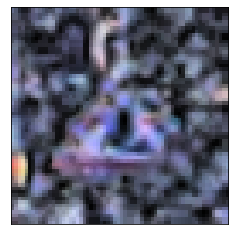

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 1.000


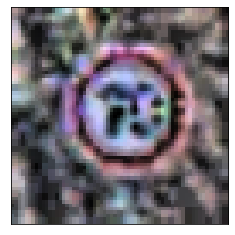

Original label:Speed limit (70km/h), Prediction :Speed limit (50km/h), confidence : 0.992


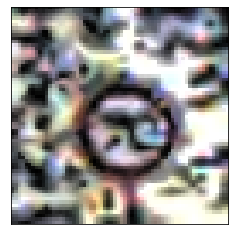

Original label:Stop, Prediction :Keep right, confidence : 0.251


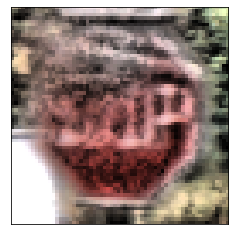

Original label:Right-of-way at intersection, Prediction :Children crossing, confidence : 0.503


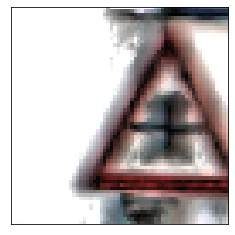

Original label:Priority road, Prediction :Yield, confidence : 0.981


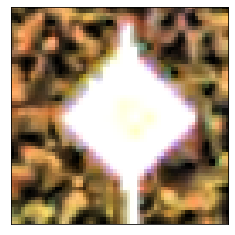

Original label:Ahead only, Prediction :Keep right, confidence : 0.986


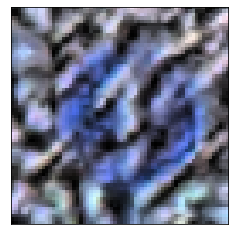

Original label:Ahead only, Prediction :Turn left ahead, confidence : 0.663


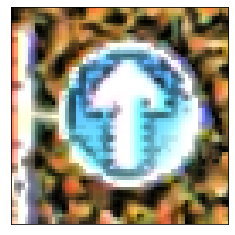

Original label:Traffic signals, Prediction :Beware of ice/snow, confidence : 0.577


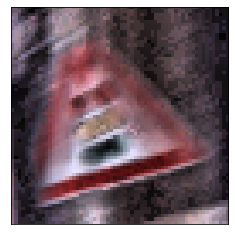

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.938


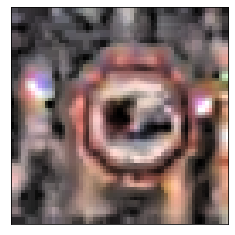

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.866


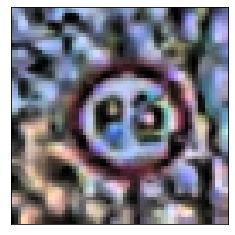

Original label:No entry, Prediction :Bicycles crossing, confidence : 0.211


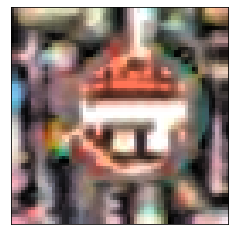

Original label:Speed limit (70km/h), Prediction :Road narrows on the right, confidence : 0.378


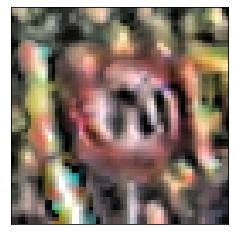

Original label:Speed limit (30km/h), Prediction :No vehicles, confidence : 0.537


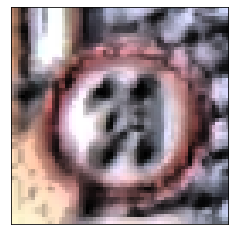

Original label:General caution, Prediction :Road work, confidence : 0.971


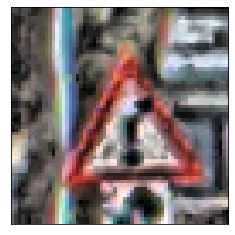

Original label:Speed limit (60km/h), Prediction :Speed limit (50km/h), confidence : 0.719


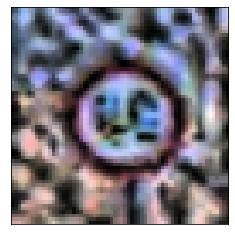

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.658


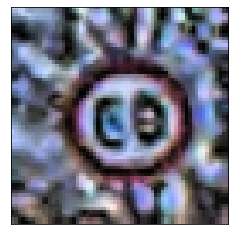

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.671


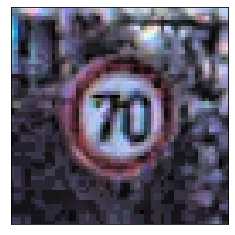

Original label:Ahead only, Prediction :Speed limit (50km/h), confidence : 0.315


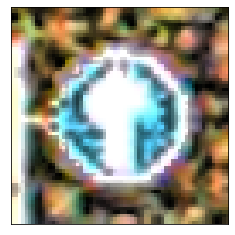

Original label:Go straight or left, Prediction :Bumpy road, confidence : 0.079


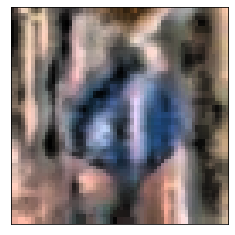

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.760


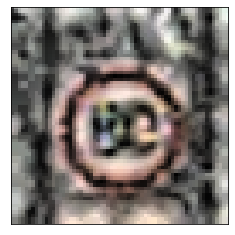

Original label:Roundabout mandatory, Prediction :Keep left, confidence : 0.232


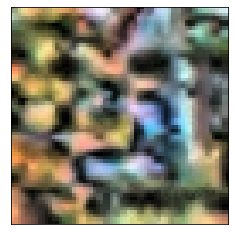

Original label:End of speed limit (80km/h), Prediction :Dangerous curve right, confidence : 0.973


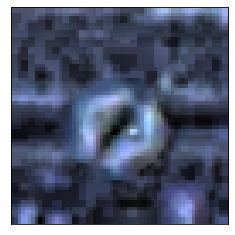

Original label:Speed limit (120km/h), Prediction :Keep right, confidence : 0.999


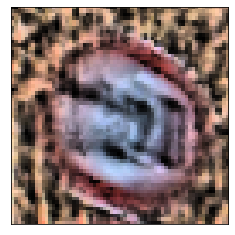

Original label:Speed limit (50km/h), Prediction :Speed limit (80km/h), confidence : 0.645


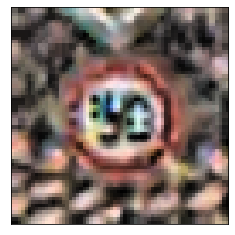

Original label:Priority road, Prediction :Yield, confidence : 0.833


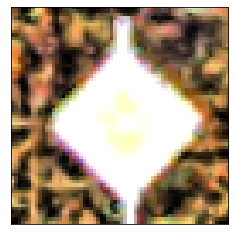

Original label:Speed limit (70km/h), Prediction :Speed limit (30km/h), confidence : 0.929


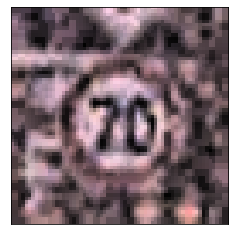

Original label:Ahead only, Prediction :Keep right, confidence : 0.908


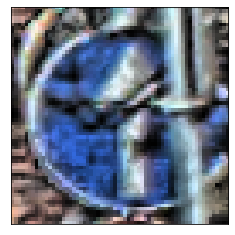

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.926


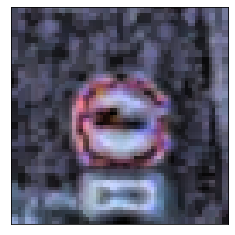

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.641


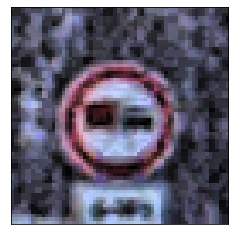

Original label:Speed limit (30km/h), Prediction :Speed limit (120km/h), confidence : 0.889


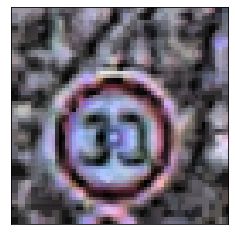

Original label:Priority road, Prediction :Yield, confidence : 1.000


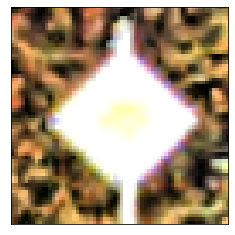

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.638


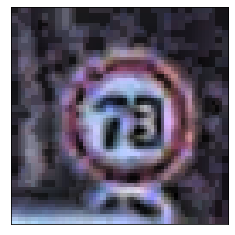

Original label:General caution, Prediction :Road work, confidence : 0.583


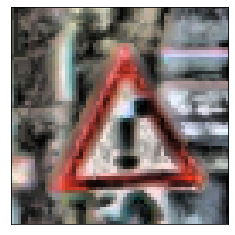

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.996


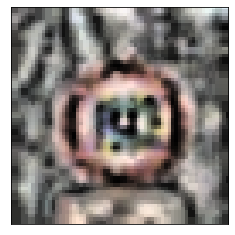

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.616


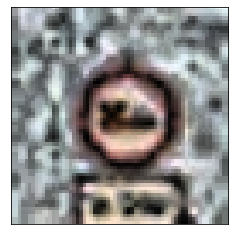

Original label:Priority road, Prediction :Keep right, confidence : 0.938


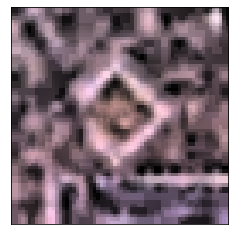

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.591


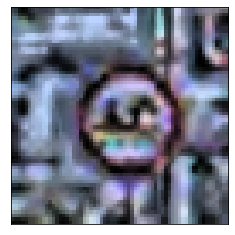

Original label:Priority road, Prediction :Keep right, confidence : 0.363


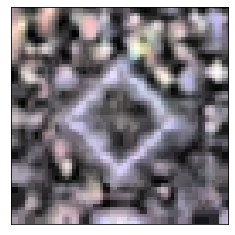

Original label:Speed limit (70km/h), Prediction :Speed limit (100km/h), confidence : 0.656


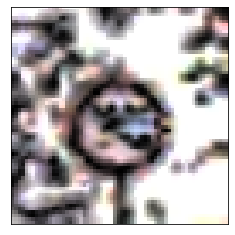

Original label:Speed limit (60km/h), Prediction :Speed limit (80km/h), confidence : 0.549


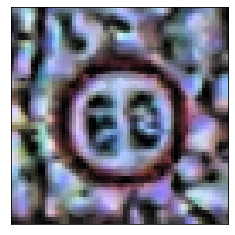

Original label:Pedestrians, Prediction :Road work, confidence : 0.985


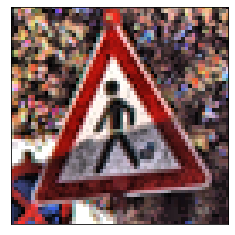

Original label:No vehicles, Prediction :End of no passing, confidence : 0.299


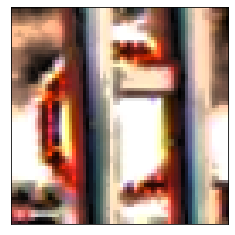

Original label:Speed limit (120km/h), Prediction :Keep right, confidence : 0.955


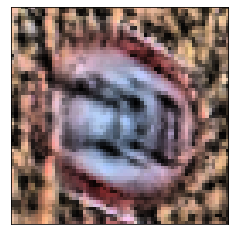

Original label:Priority road, Prediction :Yield, confidence : 1.000


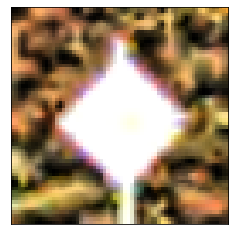

Original label:Speed limit (80km/h), Prediction :Speed limit (50km/h), confidence : 0.615


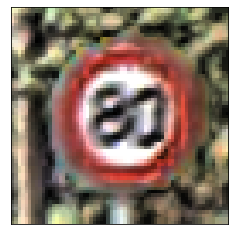

Original label:General caution, Prediction :Right-of-way at intersection, confidence : 0.209


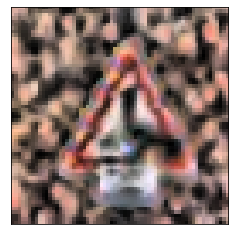

Original label:Priority road, Prediction :Yield, confidence : 1.000


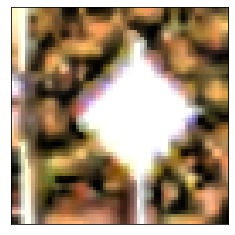

Original label:Speed limit (70km/h), Prediction :Keep left, confidence : 0.997


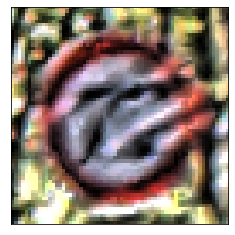

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.640


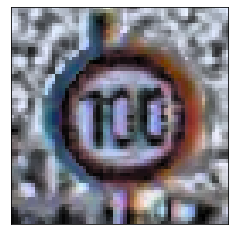

Original label:Priority road, Prediction :Yield, confidence : 0.548


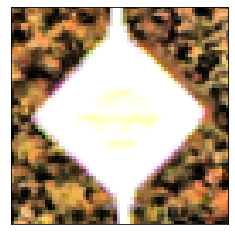

Original label:Speed limit (30km/h), Prediction :No vehicles, confidence : 0.945


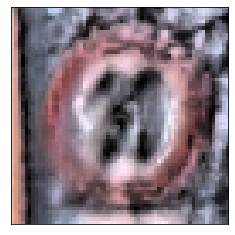

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.643


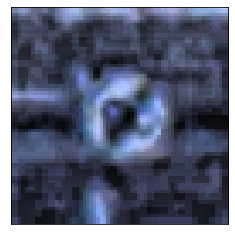

Original label:End no passing veh > 3.5 tons, Prediction :End of no passing, confidence : 0.636


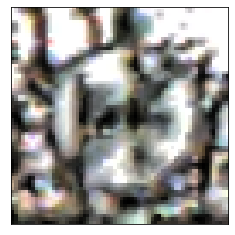

Original label:Bumpy road, Prediction :Bicycles crossing, confidence : 0.680


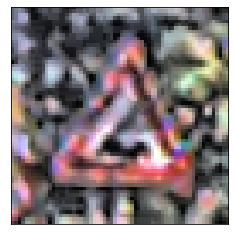

Original label:Priority road, Prediction :Yield, confidence : 0.600


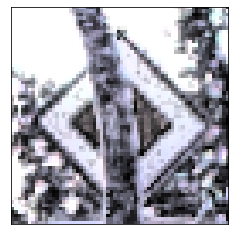

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.936


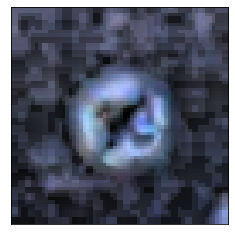

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.590


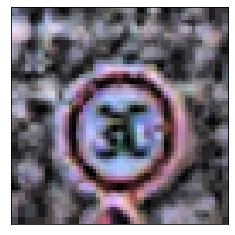

Original label:Speed limit (30km/h), Prediction :Speed limit (120km/h), confidence : 0.869


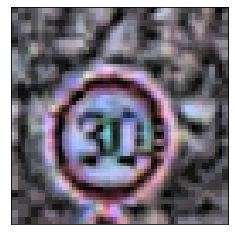

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.946


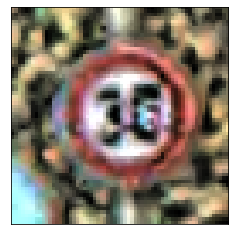

Original label:Priority road, Prediction :Yield, confidence : 1.000


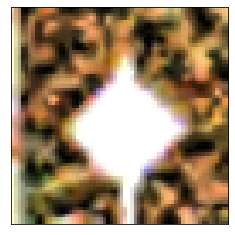

Original label:Priority road, Prediction :Yield, confidence : 0.815


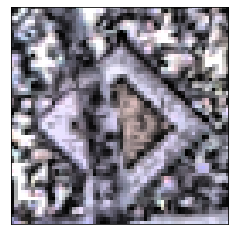

Original label:Beware of ice/snow, Prediction :Right-of-way at intersection, confidence : 0.917


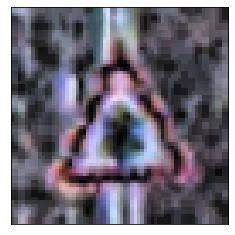

Original label:Speed limit (70km/h), Prediction :Speed limit (120km/h), confidence : 0.863


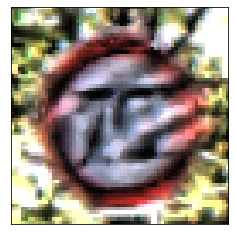

Original label:Speed limit (30km/h), Prediction :No vehicles, confidence : 0.791


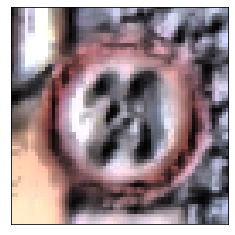

Original label:Speed limit (60km/h), Prediction :Speed limit (50km/h), confidence : 0.805


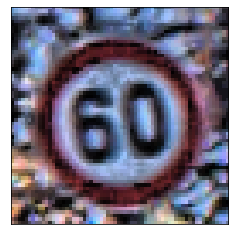

Original label:Speed limit (80km/h), Prediction :Speed limit (100km/h), confidence : 0.539


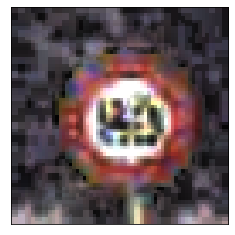

Original label:Speed limit (100km/h), Prediction :Speed limit (120km/h), confidence : 0.434


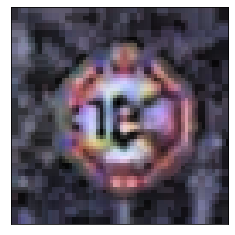

Original label:No passing veh over 3.5 tons, Prediction :No passing, confidence : 0.955


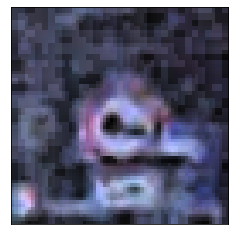

Original label:End of speed limit (80km/h), Prediction :End no passing veh > 3.5 tons, confidence : 0.795


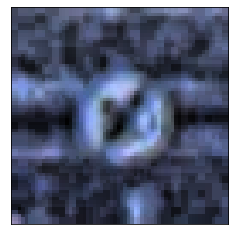

Original label:Speed limit (60km/h), Prediction :Speed limit (50km/h), confidence : 1.000


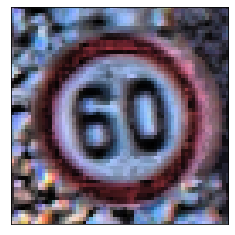

Original label:Traffic signals, Prediction :Road work, confidence : 0.901


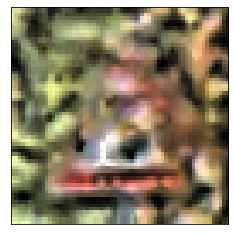

Original label:Speed limit (60km/h), Prediction :No passing, confidence : 0.989


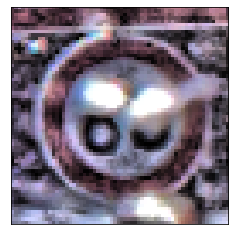

Original label:Speed limit (30km/h), Prediction :Speed limit (50km/h), confidence : 0.846


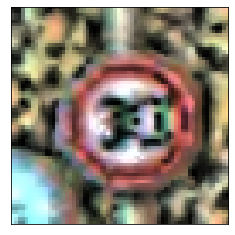

Original label:Yield, Prediction :Keep right, confidence : 0.329


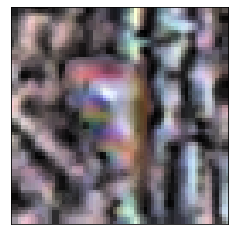

Original label:Speed limit (70km/h), Prediction :Speed limit (100km/h), confidence : 0.248


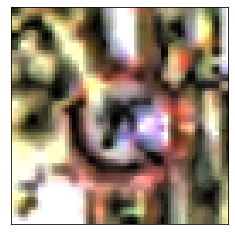

Original label:Speed limit (70km/h), Prediction :Road narrows on the right, confidence : 0.998


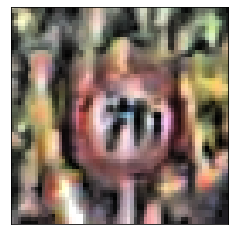

Original label:Traffic signals, Prediction :Beware of ice/snow, confidence : 0.706


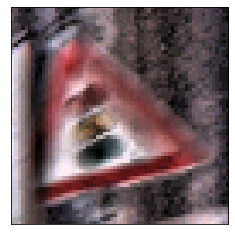

In [23]:
# Find the images that were predicted wrongly and who the images along with the predicted class

for i in range(len(errors1)):
    pred_class = np.argmax(prob1[errors1[i]])
    pred_label = classes[pred_class]
    
    print('Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        list(classes.values())[test_labels.argmax(axis=1)[errors1[i]]],
        pred_label,
        prob1[errors1[i]][pred_class]))
    
    plt.imshow(test_img[errors1[i]])
    plt.xticks([]),plt.yticks([])
    plt.show()

In [24]:
print(classification_report(test_labels.argmax(axis=1),prob1.argmax(axis=1), target_names=classes.values()))

                               precision    recall  f1-score   support

         Speed limit (20km/h)       0.98      0.95      0.97        60
         Speed limit (30km/h)       0.99      0.94      0.97       720
         Speed limit (50km/h)       0.96      0.99      0.97       750
         Speed limit (60km/h)       0.99      0.95      0.97       450
         Speed limit (70km/h)       1.00      0.95      0.98       660
         Speed limit (80km/h)       0.96      0.97      0.97       630
  End of speed limit (80km/h)       1.00      0.90      0.95       150
        Speed limit (100km/h)       0.94      0.98      0.96       450
        Speed limit (120km/h)       0.93      1.00      0.96       450
                   No passing       0.94      1.00      0.97       480
 No passing veh over 3.5 tons       1.00      0.96      0.98       660
 Right-of-way at intersection       0.98      0.98      0.98       420
                Priority road       1.00      0.95      0.97       690
     

# Build Model with Enhanced images but without applying Data Augmentation

In [15]:
tf.random.set_seed(41) # set.seed function helps reuse same set of random variables

# create the base pre-trained model
base_model = VGG19(weights="imagenet", include_top=False,input_tensor=Input(shape=(64, 64, 3)))

x = base_model.output
x = Flatten(name="flatten")(x)
x = Dense(4096, activation="relu")(x)
x = Dense(43, activation="softmax")(x)

modelAug = Model(inputs=base_model.input, outputs=x)

for layer in modelAug.layers[:12]:
   layer.trainable = False
for layer in modelAug.layers[12:]:
   layer.trainable = True
    
for layer in modelAug.layers:
    print(layer, layer.trainable)

<keras.engine.input_layer.InputLayer object at 0x0000024E74A73760> False
<keras.layers.convolutional.Conv2D object at 0x0000024E7510DBB0> False
<keras.layers.convolutional.Conv2D object at 0x0000024E753981F0> False
<keras.layers.pooling.MaxPooling2D object at 0x0000024E753F4A00> False
<keras.layers.convolutional.Conv2D object at 0x0000024E753F4070> False
<keras.layers.convolutional.Conv2D object at 0x0000024E753F42B0> False
<keras.layers.pooling.MaxPooling2D object at 0x0000024E7542AA30> False
<keras.layers.convolutional.Conv2D object at 0x0000024E7542A100> False
<keras.layers.convolutional.Conv2D object at 0x0000024E7542D550> False
<keras.layers.convolutional.Conv2D object at 0x0000024E7542AFD0> False
<keras.layers.convolutional.Conv2D object at 0x0000024E75548100> False
<keras.layers.pooling.MaxPooling2D object at 0x0000024E75548790> False
<keras.layers.convolutional.Conv2D object at 0x0000024E75548D60> True
<keras.layers.convolutional.Conv2D object at 0x0000024E75555310> True
<keras

In [16]:
opt = Adam(lr=1e-4)

modelAug.compile(optimizer=opt, loss='categorical_crossentropy',metrics=["accuracy"])
modelAug.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0     

C:\Users\Acer\anaconda3\envs\vip\lib\site-packages\keras\optimizer_v2\optimizer_v2.py:355: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(


In [18]:
from tensorflow.keras.callbacks import ModelCheckpoint
bs = 48
epoch = 40
# calculate the total number of images in each class and
# initialize a dictionary to store the class weights
classTotals = y_train1.sum(axis=0)
classWeight = dict()
# loop over all classes and calculate the class weight
for i in range(0, len(classTotals)):
    classWeight[i] = classTotals.max() / classTotals[i]
    
with tf.device('/cpu:0'):
    filepath = "modelAug/saved-model-{epoch:02d}-{val_loss:.4f}.hdf5"
    keras_callbacks   = [
        ModelCheckpoint(filepath, monitor='val_loss', save_best_only=True)]
    historys1 = modelAug.fit(X_train1, y_train1, batch_size=bs, steps_per_epoch=X_train1.shape[0] // bs, epochs=epoch, validation_data=(X_valid1, y_valid1), verbose = 1, callbacks=[keras_callbacks],class_weight=classWeight)
    modelAug.save("modelAug/saved-model.hdf5")

Epoch 1/40
694/694 [==============================] - 982s 1s/step - loss: 1.5563 - accuracy: 0.7944 - val_loss: 0.1613 - val_accuracy: 0.9498
Epoch 2/40
694/694 [==============================] - 961s 1s/step - loss: 0.2337 - accuracy: 0.9621 - val_loss: 0.0864 - val_accuracy: 0.9735
Epoch 3/40
694/694 [==============================] - 988s 1s/step - loss: 0.2055 - accuracy: 0.9711 - val_loss: 0.1177 - val_accuracy: 0.9600
Epoch 4/40
694/694 [==============================] - 1030s 1s/step - loss: 0.2297 - accuracy: 0.9716 - val_loss: 0.0851 - val_accuracy: 0.9816
Epoch 5/40
694/694 [==============================] - 1005s 1s/step - loss: 0.1380 - accuracy: 0.9821 - val_loss: 0.0367 - val_accuracy: 0.9879
Epoch 6/40
694/694 [==============================] - 954s 1s/step - loss: 0.1052 - accuracy: 0.9837 - val_loss: 0.0465 - val_accuracy: 0.9866
Epoch 7/40
694/694 [==============================] - 923s 1s/step - loss: 0.0409 - accuracy: 0.9930 - val_loss: 0.0301 - val_accuracy: 0.99

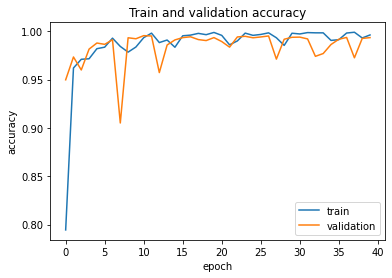

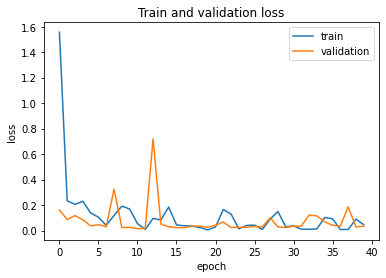

In [19]:
# accuracy plot 
plt.plot(historys1.history['accuracy'])
plt.plot(historys1.history['val_accuracy'])
plt.title('Train and validation accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='lower right')
plt.show()

# loss plot
plt.plot(historys1.history['loss'])
plt.plot(historys1.history['val_loss'])
plt.title('Train and validation loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper right')
plt.show()

In [15]:
modelAug = tf.keras.models.load_model('modelAug\saved-model-11-0.0149.hdf5')
loss, accuracy = modelAug.evaluate(test_img,test_labels)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

395/395 [==============================] - 27s 43ms/step - loss: 0.1270 - accuracy: 0.9687
Test accuracy : 0.9687252640724182
Test loss : 0.1270369440317154


# Hyperparameter tuning

# dropout:0.3, lr:1e-05, epoch:30

In [16]:
classTotals = y_train1.sum(axis=0)
classWeight = dict()
# loop over all classes and calculate the class weight
for i in range(0, len(classTotals)):
    classWeight[i] = classTotals.max() / classTotals[i]
    
print(classTotals)
print(classWeight)

[ 164. 1880. 1885. 1184. 1688. 1576.  369. 1232. 1195. 1271. 1705. 1116.
 1811. 1873.  659.  526.  356.  944. 1026.  172.  316.  286.  328.  430.
  224. 1265.  484.  203.  454.  232.  391.  654.  207.  597.  353. 1018.
  327.  169. 1777.  252.  309.  210.  209.]
{0: 11.493902, 1: 1.0026596, 2: 1.0, 3: 1.5920608, 4: 1.1167061, 5: 1.196066, 6: 5.1084013, 7: 1.5300325, 8: 1.5774058, 9: 1.4830842, 10: 1.1055719, 11: 1.6890681, 12: 1.0408614, 13: 1.0064068, 14: 2.8603945, 15: 3.58365, 16: 5.294944, 17: 1.996822, 18: 1.837232, 19: 10.959302, 20: 5.96519, 21: 6.590909, 22: 5.746951, 23: 4.383721, 24: 8.415178, 25: 1.4901186, 26: 3.894628, 27: 9.285714, 28: 4.1519823, 29: 8.125, 30: 4.820972, 31: 2.882263, 32: 9.10628, 33: 3.157454, 34: 5.3399434, 35: 1.8516699, 36: 5.764526, 37: 11.153846, 38: 1.0607766, 39: 7.480159, 40: 6.1003237, 41: 8.976191, 42: 9.019138}


In [19]:
tf.random.set_seed(5) # set.seed function helps reuse same set of random variables

# create the base pre-trained model
base_model = VGG19(weights="imagenet", include_top=False,input_tensor=Input(shape=(64, 64, 3)))

x = base_model.output
x = Flatten(name="flatten")(x)
x = Dense(4096, activation="relu")(x)
x = Dropout(0.3)(x)
x = Dense(43, activation="softmax")(x)

model1 = Model(inputs=base_model.input, outputs=x)

for layer in model1.layers[:12]:
   layer.trainable = False
for layer in model1.layers[12:]:
   layer.trainable = True

opt = Adam(lr=1e-5)

model1.compile(optimizer=opt, loss='categorical_crossentropy',metrics=["accuracy"])
model1.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0     

C:\Users\Acer\anaconda3\envs\vip\lib\site-packages\keras\optimizer_v2\optimizer_v2.py:355: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(


In [20]:
epoch = 30
bs = 48
filepath = "models/model1-{epoch:02d}-{val_loss:.4f}.hdf5"
keras_callbacks   = [
    ModelCheckpoint(filepath, monitor='val_loss', save_best_only=True)]
history2 = model1.fit(aug.flow(X_train1, y_train1, batch_size=bs), steps_per_epoch=X_train1.shape[0] // bs, 
                      epochs=epoch, validation_data=(X_valid1, y_valid1), verbose = 1, callbacks=[keras_callbacks], class_weight=classWeight)

Epoch 1/30
694/694 [==============================] - 70s 97ms/step - loss: 3.6673 - accuracy: 0.5237 - val_loss: 0.4415 - val_accuracy: 0.8489
Epoch 2/30
694/694 [==============================] - 65s 94ms/step - loss: 0.8949 - accuracy: 0.8513 - val_loss: 0.2397 - val_accuracy: 0.9242
Epoch 3/30
694/694 [==============================] - 65s 94ms/step - loss: 0.4806 - accuracy: 0.9153 - val_loss: 0.1494 - val_accuracy: 0.9514
Epoch 4/30
694/694 [==============================] - 65s 94ms/step - loss: 0.3415 - accuracy: 0.9391 - val_loss: 0.0986 - val_accuracy: 0.9677
Epoch 5/30
694/694 [==============================] - 65s 94ms/step - loss: 0.2718 - accuracy: 0.9506 - val_loss: 0.0802 - val_accuracy: 0.9728
Epoch 6/30
694/694 [==============================] - 65s 93ms/step - loss: 0.2040 - accuracy: 0.9602 - val_loss: 0.0725 - val_accuracy: 0.9764
Epoch 7/30
694/694 [==============================] - 65s 94ms/step - loss: 0.1696 - accuracy: 0.9675 - val_loss: 0.0767 - val_accuracy:

In [21]:
model1.save("models/model1.hdf5")

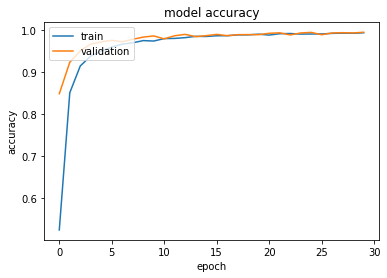

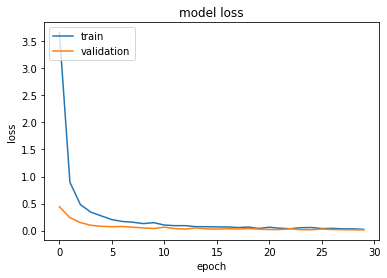

In [22]:
# accuracy plot 
plt.plot(history2.history['accuracy'])
plt.plot(history2.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# loss plot
plt.plot(history2.history['loss'])
plt.plot(history2.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [17]:
model1 = tf.keras.models.load_model('models/model1.hdf5')
loss, accuracy = model1.evaluate(test_img,test_labels)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

395/395 [==============================] - 21s 33ms/step - loss: 0.1269 - accuracy: 0.9697
Test accuracy : 0.9696753621101379
Test loss : 0.126854807138443


# dropout:0.3, lr:1e-05, epoch:40

In [24]:
tf.random.set_seed(5) # set.seed function helps reuse same set of random variables

# create the base pre-trained model
base_model = VGG19(weights="imagenet", include_top=False,input_tensor=Input(shape=(64, 64, 3)))

x = base_model.output
x = Flatten(name="flatten")(x)
x = Dense(4096, activation="relu")(x)
x = Dropout(0.3)(x)
x = Dense(43, activation="softmax")(x)

model2 = Model(inputs=base_model.input, outputs=x)

for layer in model2.layers[:12]:
   layer.trainable = False
for layer in model2.layers[12:]:
   layer.trainable = True

opt = Adam(lr=1e-5)

model2.compile(optimizer=opt, loss='categorical_crossentropy',metrics=["accuracy"])
model2.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0   

In [25]:
epoch = 40
bs = 48
filepath = "models/model2-{epoch:02d}-{val_loss:.4f}.hdf5"
keras_callbacks   = [
    ModelCheckpoint(filepath, monitor='val_loss', save_best_only=True)]
history3 = model2.fit(aug.flow(X_train1, y_train1, batch_size=bs), steps_per_epoch=X_train1.shape[0] // bs, 
                      epochs=epoch, validation_data=(X_valid1, y_valid1), verbose = 1, callbacks=[keras_callbacks],
                      class_weight=classWeight)
model2.save("models/model2.hdf5")

Epoch 1/40
694/694 [==============================] - 66s 94ms/step - loss: 3.7298 - accuracy: 0.5222 - val_loss: 0.4663 - val_accuracy: 0.8441
Epoch 2/40
694/694 [==============================] - 73s 104ms/step - loss: 0.9049 - accuracy: 0.8525 - val_loss: 0.2072 - val_accuracy: 0.9317
Epoch 3/40
694/694 [==============================] - 72s 104ms/step - loss: 0.5027 - accuracy: 0.9152 - val_loss: 0.1406 - val_accuracy: 0.9524
Epoch 4/40
694/694 [==============================] - 72s 104ms/step - loss: 0.3558 - accuracy: 0.9364 - val_loss: 0.1113 - val_accuracy: 0.9634
Epoch 5/40
694/694 [==============================] - 72s 104ms/step - loss: 0.2595 - accuracy: 0.9501 - val_loss: 0.1042 - val_accuracy: 0.9668
Epoch 6/40
694/694 [==============================] - 72s 104ms/step - loss: 0.2361 - accuracy: 0.9590 - val_loss: 0.0714 - val_accuracy: 0.9755
Epoch 7/40
694/694 [==============================] - 72s 104ms/step - loss: 0.1800 - accuracy: 0.9663 - val_loss: 0.0616 - val_acc

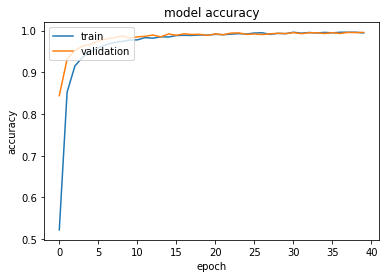

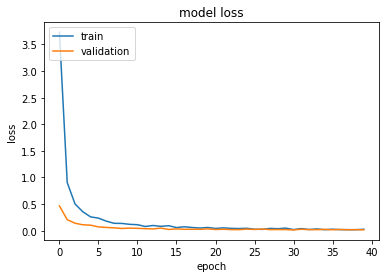

In [26]:
# accuracy plot 
plt.plot(history3.history['accuracy'])
plt.plot(history3.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# loss plot
plt.plot(history3.history['loss'])
plt.plot(history3.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [18]:
model2 = tf.keras.models.load_model('models/model2-31-0.0149.hdf5')
loss, accuracy = model2.evaluate(test_img,test_labels)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

395/395 [==============================] - 12s 31ms/step - loss: 0.1411 - accuracy: 0.9640
Test accuracy : 0.96397465467453
Test loss : 0.14107748866081238


# dropout：0.3，lr: 5e-06, epoch: 30

In [18]:
tf.random.set_seed(5) # set.seed function helps reuse same set of random variables

# create the base pre-trained model
base_model = VGG19(weights="imagenet", include_top=False,input_tensor=Input(shape=(64, 64, 3)))

x = base_model.output
x = Flatten(name="flatten")(x)
x = Dense(4096, activation="relu")(x)
x = Dropout(0.3)(x)
x = Dense(43, activation="softmax")(x)

model3 = Model(inputs=base_model.input, outputs=x)

for layer in model3.layers[:12]:
   layer.trainable = False
for layer in model3.layers[12:]:
   layer.trainable = True

opt = Adam(lr=5e-6)

model3.compile(optimizer=opt, loss='categorical_crossentropy',metrics=["accuracy"])
model3.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0     

C:\Users\Acer\anaconda3\envs\vip\lib\site-packages\keras\optimizer_v2\optimizer_v2.py:355: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(


In [19]:
epoch = 30
bs = 48
filepath = "models/model3-{epoch:02d}-{val_loss:.4f}.hdf5"
keras_callbacks   = [
    ModelCheckpoint(filepath, monitor='val_loss', save_best_only=True)]
history4 = model3.fit(aug.flow(X_train1, y_train1, batch_size=bs), steps_per_epoch=X_train1.shape[0] // bs, 
                      epochs=epoch, validation_data=(X_valid1, y_valid1), verbose = 1, callbacks=[keras_callbacks],
                      class_weight=classWeight)
model3.save("models/model3.hdf5")

Epoch 1/30
694/694 [==============================] - 73s 98ms/step - loss: 4.9477 - accuracy: 0.3856 - val_loss: 0.8052 - val_accuracy: 0.7326
Epoch 2/30
694/694 [==============================] - 65s 94ms/step - loss: 1.6516 - accuracy: 0.7454 - val_loss: 0.3782 - val_accuracy: 0.8779
Epoch 3/30
694/694 [==============================] - 65s 94ms/step - loss: 0.8800 - accuracy: 0.8520 - val_loss: 0.2445 - val_accuracy: 0.9172
Epoch 4/30
694/694 [==============================] - 65s 94ms/step - loss: 0.5980 - accuracy: 0.8972 - val_loss: 0.1760 - val_accuracy: 0.9398
Epoch 5/30
694/694 [==============================] - 65s 94ms/step - loss: 0.4559 - accuracy: 0.9208 - val_loss: 0.1345 - val_accuracy: 0.9541
Epoch 6/30
694/694 [==============================] - 65s 94ms/step - loss: 0.3356 - accuracy: 0.9376 - val_loss: 0.1239 - val_accuracy: 0.9587
Epoch 7/30
694/694 [==============================] - 65s 94ms/step - loss: 0.2934 - accuracy: 0.9462 - val_loss: 0.1021 - val_accuracy:

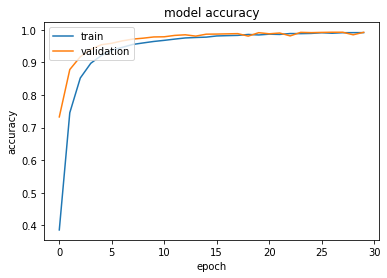

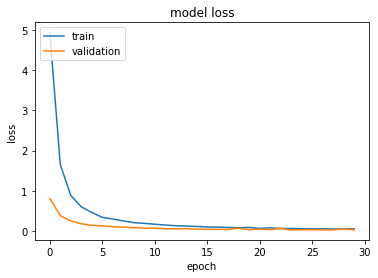

In [20]:
# accuracy plot 
plt.plot(history4.history['accuracy'])
plt.plot(history4.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# loss plot
plt.plot(history4.history['loss'])
plt.plot(history4.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [16]:
model3 = tf.keras.models.load_model('models/model3-24-0.0218.hdf5')
loss, accuracy = model3.evaluate(test_img,test_labels)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

395/395 [==============================] - 20s 34ms/step - loss: 0.1662 - accuracy: 0.9557
Test accuracy : 0.9556611180305481
Test loss : 0.16623155772686005


# dropout：0.3，lr: 5e-06, epoch: 40

In [19]:
tf.random.set_seed(5) # set.seed function helps reuse same set of random variables

# create the base pre-trained model
base_model = VGG19(weights="imagenet", include_top=False,input_tensor=Input(shape=(64, 64, 3)))

x = base_model.output
x = Flatten(name="flatten")(x)
x = Dense(4096, activation="relu")(x)
x = Dropout(0.3)(x)
x = Dense(43, activation="softmax")(x)

model4 = Model(inputs=base_model.input, outputs=x)

for layer in model4.layers[:12]:
   layer.trainable = False
for layer in model4.layers[12:]:
   layer.trainable = True

opt = Adam(lr=5e-6)

model4.compile(optimizer=opt, loss='categorical_crossentropy',metrics=["accuracy"])
model4.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0   

In [20]:
epoch = 40
bs = 48
filepath = "models/model4-{epoch:02d}-{val_loss:.4f}.hdf5"
keras_callbacks   = [
    ModelCheckpoint(filepath, monitor='val_loss', save_best_only=True)]
history5 = model4.fit(aug.flow(X_train1, y_train1, batch_size=bs), steps_per_epoch=X_train1.shape[0] // bs, 
                      epochs=epoch, validation_data=(X_valid1, y_valid1), verbose = 1, callbacks=[keras_callbacks],
                      class_weight=classWeight)
model4.save("models/model4.hdf5")

Epoch 1/40
694/694 [==============================] - 74s 99ms/step - loss: 5.0403 - accuracy: 0.3811 - val_loss: 0.7933 - val_accuracy: 0.7372
Epoch 2/40
694/694 [==============================] - 65s 94ms/step - loss: 1.7254 - accuracy: 0.7364 - val_loss: 0.3592 - val_accuracy: 0.8795
Epoch 3/40
694/694 [==============================] - 65s 94ms/step - loss: 0.9264 - accuracy: 0.8480 - val_loss: 0.2527 - val_accuracy: 0.9187
Epoch 4/40
694/694 [==============================] - 65s 94ms/step - loss: 0.5985 - accuracy: 0.8955 - val_loss: 0.1669 - val_accuracy: 0.9453
Epoch 5/40
694/694 [==============================] - 65s 94ms/step - loss: 0.4502 - accuracy: 0.9211 - val_loss: 0.1667 - val_accuracy: 0.9449
Epoch 6/40
694/694 [==============================] - 65s 94ms/step - loss: 0.3505 - accuracy: 0.9352 - val_loss: 0.1179 - val_accuracy: 0.9628
Epoch 7/40
694/694 [==============================] - 65s 93ms/step - loss: 0.2896 - accuracy: 0.9451 - val_loss: 0.0945 - val_accuracy:

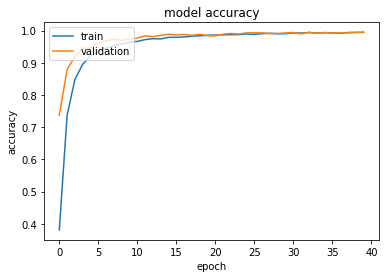

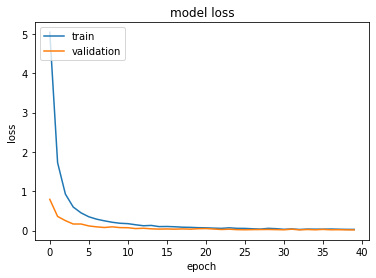

In [21]:
# accuracy plot 
plt.plot(history5.history['accuracy'])
plt.plot(history5.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# loss plot
plt.plot(history5.history['loss'])
plt.plot(history5.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [22]:
loss, accuracy = model4.evaluate(test_img,test_labels)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

395/395 [==============================] - 13s 33ms/step - loss: 0.1589 - accuracy: 0.9607
Test accuracy : 0.9607284069061279
Test loss : 0.15885621309280396


# dropout：0.5，lr: 1e-05, epoch: 30

In [23]:
tf.random.set_seed(5) # set.seed function helps reuse same set of random variables

# create the base pre-trained model
base_model = VGG19(weights="imagenet", include_top=False,input_tensor=Input(shape=(64, 64, 3)))

x = base_model.output
x = Flatten(name="flatten")(x)
x = Dense(4096, activation="relu")(x)
x = Dropout(0.5)(x)
x = Dense(43, activation="softmax")(x)

model5 = Model(inputs=base_model.input, outputs=x)

for layer in model5.layers[:12]:
   layer.trainable = False
for layer in model5.layers[12:]:
   layer.trainable = True

opt = Adam(lr=1e-5)

model5.compile(optimizer=opt, loss='categorical_crossentropy',metrics=["accuracy"])
model5.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0   

In [24]:
epoch = 30
bs = 48
filepath = "models/model5-{epoch:02d}-{val_loss:.4f}.hdf5"
keras_callbacks   = [
    ModelCheckpoint(filepath, monitor='val_loss', save_best_only=True)]
history6 = model5.fit(aug.flow(X_train1, y_train1, batch_size=bs), steps_per_epoch=X_train1.shape[0] // bs, 
                      epochs=epoch, validation_data=(X_valid1, y_valid1), verbose = 1, callbacks=[keras_callbacks],
                      class_weight=classWeight)
model5.save("models/model5.hdf5")

Epoch 1/30
694/694 [==============================] - 66s 94ms/step - loss: 4.2021 - accuracy: 0.4707 - val_loss: 0.5207 - val_accuracy: 0.8171
Epoch 2/30
694/694 [==============================] - 65s 94ms/step - loss: 1.0678 - accuracy: 0.8252 - val_loss: 0.2152 - val_accuracy: 0.9250
Epoch 3/30
694/694 [==============================] - 65s 94ms/step - loss: 0.5505 - accuracy: 0.9013 - val_loss: 0.1333 - val_accuracy: 0.9558
Epoch 4/30
694/694 [==============================] - 65s 94ms/step - loss: 0.3809 - accuracy: 0.9310 - val_loss: 0.1172 - val_accuracy: 0.9629
Epoch 5/30
694/694 [==============================] - 65s 94ms/step - loss: 0.2936 - accuracy: 0.9464 - val_loss: 0.0797 - val_accuracy: 0.9730
Epoch 6/30
694/694 [==============================] - 65s 94ms/step - loss: 0.2407 - accuracy: 0.9562 - val_loss: 0.0986 - val_accuracy: 0.9679
Epoch 7/30
694/694 [==============================] - 65s 94ms/step - loss: 0.1875 - accuracy: 0.9647 - val_loss: 0.0656 - val_accuracy:

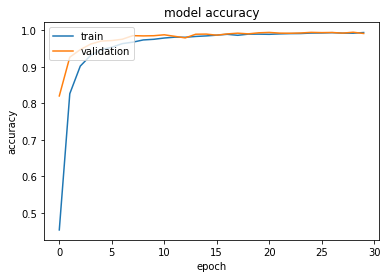

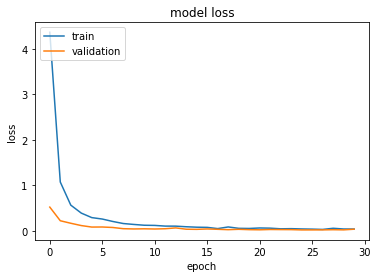

In [24]:
# accuracy plot 
plt.plot(history6.history['accuracy'])
plt.plot(history6.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# loss plot
plt.plot(history6.history['loss'])
plt.plot(history6.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [17]:
model5 = f.keras.models.load_model('models/model5-29-0.0199.hdf5')
loss, accuracy = model5.evaluate(test_img,test_labels)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

395/395 [==============================] - 16s 33ms/step - loss: 0.1244 - accuracy: 0.9661
Test accuracy : 0.9661124348640442
Test loss : 0.12440997362136841


# dropout：0.5，lr: 1e-05, epoch: 40

In [18]:
tf.random.set_seed(5) # set.seed function helps reuse same set of random variables

# create the base pre-trained model
base_model = VGG19(weights="imagenet", include_top=False,input_tensor=Input(shape=(64, 64, 3)))

x = base_model.output
x = Flatten(name="flatten")(x)
x = Dense(4096, activation="relu")(x)
x = Dropout(0.5)(x)
x = Dense(43, activation="softmax")(x)

model6 = Model(inputs=base_model.input, outputs=x)

for layer in model6.layers[:12]:
   layer.trainable = False
for layer in model6.layers[12:]:
   layer.trainable = True

opt = Adam(lr=1e-5)

model6.compile(optimizer=opt, loss='categorical_crossentropy',metrics=["accuracy"])
model6.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0     

C:\Users\Acer\anaconda3\envs\vip\lib\site-packages\keras\optimizer_v2\optimizer_v2.py:355: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(


In [19]:
epoch = 40
bs = 48
filepath = "models/model6-{epoch:02d}-{val_loss:.4f}.hdf5"
keras_callbacks   = [
    ModelCheckpoint(filepath, monitor='val_loss', save_best_only=True)]
history7 = model6.fit(aug.flow(X_train1, y_train1, batch_size=bs), steps_per_epoch=X_train1.shape[0] // bs, 
                      epochs=epoch, validation_data=(X_valid1, y_valid1), verbose = 1, callbacks=[keras_callbacks],
                      class_weight=classWeight)
model6.save("models/model6.hdf5")

Epoch 1/40
694/694 [==============================] - 71s 98ms/step - loss: 4.2006 - accuracy: 0.4764 - val_loss: 0.4839 - val_accuracy: 0.8370
Epoch 2/40
694/694 [==============================] - 65s 94ms/step - loss: 1.0430 - accuracy: 0.8315 - val_loss: 0.1991 - val_accuracy: 0.9362
Epoch 3/40
694/694 [==============================] - 66s 94ms/step - loss: 0.5698 - accuracy: 0.9042 - val_loss: 0.1717 - val_accuracy: 0.9415
Epoch 4/40
694/694 [==============================] - 66s 94ms/step - loss: 0.3922 - accuracy: 0.9315 - val_loss: 0.1239 - val_accuracy: 0.9585
Epoch 5/40
694/694 [==============================] - 66s 94ms/step - loss: 0.2974 - accuracy: 0.9478 - val_loss: 0.0958 - val_accuracy: 0.9679
Epoch 6/40
694/694 [==============================] - 66s 94ms/step - loss: 0.2193 - accuracy: 0.9583 - val_loss: 0.0684 - val_accuracy: 0.9776
Epoch 7/40
694/694 [==============================] - 66s 95ms/step - loss: 0.1966 - accuracy: 0.9629 - val_loss: 0.0678 - val_accuracy:

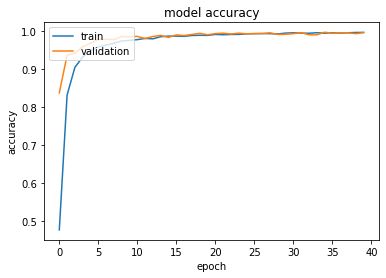

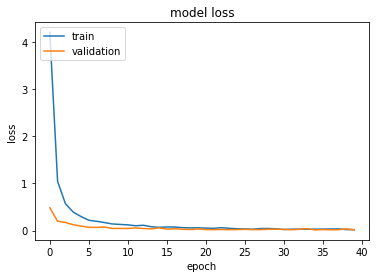

In [20]:
# accuracy plot 
plt.plot(history7.history['accuracy'])
plt.plot(history7.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# loss plot
plt.plot(history7.history['loss'])
plt.plot(history7.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [21]:
model6 = tf.keras.models.load_model('models/model6-35-0.0141.hdf5')
loss, accuracy = model6.evaluate(test_img,test_labels)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

395/395 [==============================] - 12s 31ms/step - loss: 0.1359 - accuracy: 0.9672
Test accuracy : 0.9672209024429321
Test loss : 0.13588537275791168


# dropout：0.5，lr: 5e-06, epoch: 30

In [17]:
tf.random.set_seed(5) # set.seed function helps reuse same set of random variables

# create the base pre-trained model
base_model = VGG19(weights="imagenet", include_top=False,input_tensor=Input(shape=(64, 64, 3)))

x = base_model.output
x = Flatten(name="flatten")(x)
x = Dense(4096, activation="relu")(x)
x = Dropout(0.5)(x)
x = Dense(43, activation="softmax")(x)

model7 = Model(inputs=base_model.input, outputs=x)

for layer in model7.layers[:12]:
   layer.trainable = False
for layer in model7.layers[12:]:
   layer.trainable = True

opt = Adam(lr=5e-6)

model7.compile(optimizer=opt, loss='categorical_crossentropy',metrics=["accuracy"])
model7.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0     

C:\Users\Acer\anaconda3\envs\vip\lib\site-packages\keras\optimizer_v2\optimizer_v2.py:355: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(


In [18]:
epoch = 30
bs = 48
filepath = "models/model7-{epoch:02d}-{val_loss:.4f}.hdf5"
keras_callbacks   = [
    ModelCheckpoint(filepath, monitor='val_loss', save_best_only=True)]
history8 = model7.fit(aug.flow(X_train1, y_train1, batch_size=bs), steps_per_epoch=X_train1.shape[0] // bs, 
                      epochs=epoch, validation_data=(X_valid1, y_valid1), verbose = 1, callbacks=[keras_callbacks],
                      class_weight=classWeight)
model7.save("models/model7.hdf5")

Epoch 1/30
694/694 [==============================] - 80s 99ms/step - loss: 5.7387 - accuracy: 0.3101 - val_loss: 0.9077 - val_accuracy: 0.7084
Epoch 2/30
694/694 [==============================] - 65s 94ms/step - loss: 2.1010 - accuracy: 0.6848 - val_loss: 0.4344 - val_accuracy: 0.8584
Epoch 3/30
694/694 [==============================] - 65s 94ms/step - loss: 1.0745 - accuracy: 0.8239 - val_loss: 0.2625 - val_accuracy: 0.9136
Epoch 4/30
694/694 [==============================] - 65s 93ms/step - loss: 0.7156 - accuracy: 0.8804 - val_loss: 0.1889 - val_accuracy: 0.9386
Epoch 5/30
694/694 [==============================] - 65s 93ms/step - loss: 0.5092 - accuracy: 0.9099 - val_loss: 0.1463 - val_accuracy: 0.9500
Epoch 6/30
694/694 [==============================] - 65s 93ms/step - loss: 0.4173 - accuracy: 0.9253 - val_loss: 0.1294 - val_accuracy: 0.9549
Epoch 7/30
694/694 [==============================] - 65s 93ms/step - loss: 0.3264 - accuracy: 0.9392 - val_loss: 0.1230 - val_accuracy:

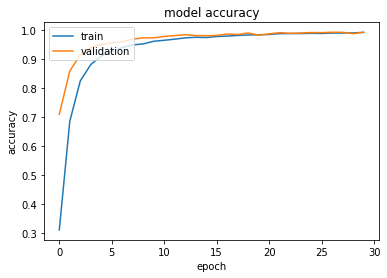

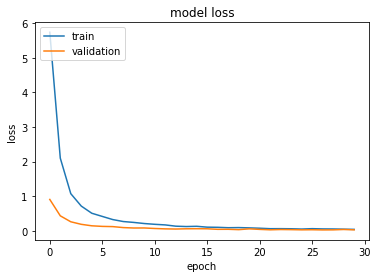

In [19]:
# accuracy plot 
plt.plot(history8.history['accuracy'])
plt.plot(history8.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# loss plot
plt.plot(history8.history['loss'])
plt.plot(history8.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [20]:
model7 = tf.keras.models.load_model('models/model7-27-0.0274.hdf5')
loss, accuracy = model7.evaluate(test_img,test_labels)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

395/395 [==============================] - 13s 33ms/step - loss: 0.1606 - accuracy: 0.9550
Test accuracy : 0.95502769947052
Test loss : 0.16061533987522125


# dropout：0.5，lr: 5e-06, epoch: 40

In [17]:
tf.random.set_seed(5) # set.seed function helps reuse same set of random variables

# create the base pre-trained model
base_model = VGG19(weights="imagenet", include_top=False,input_tensor=Input(shape=(64, 64, 3)))

x = base_model.output
x = Flatten(name="flatten")(x)
x = Dense(4096, activation="relu")(x)
x = Dropout(0.5)(x)
x = Dense(43, activation="softmax")(x)

model8 = Model(inputs=base_model.input, outputs=x)

for layer in model8.layers[:12]:
   layer.trainable = False
for layer in model8.layers[12:]:
   layer.trainable = True

opt = Adam(lr=5e-6)

model8.compile(optimizer=opt, loss='categorical_crossentropy',metrics=["accuracy"])
model8.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0     

C:\Users\Acer\anaconda3\envs\vip\lib\site-packages\keras\optimizer_v2\optimizer_v2.py:355: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(


In [18]:
epoch = 40
bs = 48
filepath = "models/model8-{epoch:02d}-{val_loss:.4f}.hdf5"
keras_callbacks   = [
    ModelCheckpoint(filepath, monitor='val_loss', save_best_only=True)]
history9 = model8.fit(aug.flow(X_train1, y_train1, batch_size=bs), steps_per_epoch=X_train1.shape[0] // bs, 
                      epochs=epoch, validation_data=(X_valid1, y_valid1), verbose = 1, callbacks=[keras_callbacks],
                      class_weight=classWeight)
model8.save("models/model8.hdf5")

Epoch 1/40
694/694 [==============================] - 77s 99ms/step - loss: 5.7864 - accuracy: 0.3107 - val_loss: 0.9402 - val_accuracy: 0.6833
Epoch 2/40
694/694 [==============================] - 65s 94ms/step - loss: 2.0773 - accuracy: 0.6907 - val_loss: 0.3999 - val_accuracy: 0.8699
Epoch 3/40
694/694 [==============================] - 65s 94ms/step - loss: 1.0662 - accuracy: 0.8264 - val_loss: 0.2613 - val_accuracy: 0.9131
Epoch 4/40
694/694 [==============================] - 65s 94ms/step - loss: 0.7176 - accuracy: 0.8791 - val_loss: 0.1750 - val_accuracy: 0.9429
Epoch 5/40
694/694 [==============================] - 65s 94ms/step - loss: 0.5177 - accuracy: 0.9090 - val_loss: 0.1512 - val_accuracy: 0.9492
Epoch 6/40
694/694 [==============================] - 65s 94ms/step - loss: 0.4004 - accuracy: 0.9275 - val_loss: 0.1284 - val_accuracy: 0.9572
Epoch 7/40
694/694 [==============================] - 65s 94ms/step - loss: 0.3466 - accuracy: 0.9368 - val_loss: 0.0973 - val_accuracy:

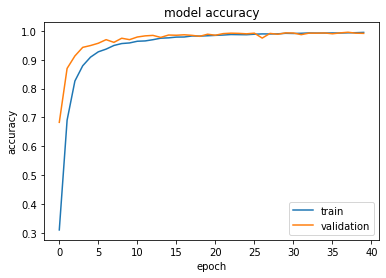

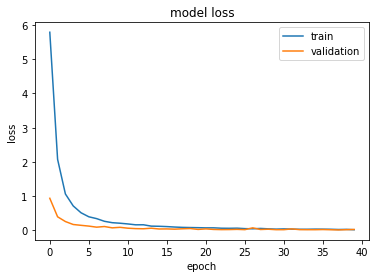

In [19]:
# accuracy plot 
plt.plot(history9.history['accuracy'])
plt.plot(history9.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='lower right')
plt.show()

# loss plot
plt.plot(history9.history['loss'])
plt.plot(history9.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper right')
plt.show()

In [20]:
model8 = tf.keras.models.load_model('models/model8-38-0.0170.hdf5')
loss, accuracy = model8.evaluate(test_img,test_labels)
print('Test accuracy :', accuracy)
print('Test loss :', loss)

395/395 [==============================] - 13s 33ms/step - loss: 0.1532 - accuracy: 0.9622
Test accuracy : 0.9621536135673523
Test loss : 0.15321359038352966
